# CZ4046 Assignment 1 Part 2

## Experiment 4

### Import required libraries

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

### Define grid

In [2]:
class Grid:
    def __init__(self, width, height, start):
        self.width = width
        self.height = height
        self.i = start[0]
        self.j = start[1]
        
    def set(self, rewards, actions):  
        self.rewards = rewards
        self.actions = actions 
    
    def set_state(self, s):
        self.i = s[0]
        self.j = s[1]
        
    def current_state(self):
        return (self.i, self.j)

    def is_terminal(self, s):
        return s not in self.actions
    
    def move(self, action):
        if action in self.actions[(self.i, self.j)]:
            if action == 'U':
                self.i -= 1
            elif action == 'D':
                self.i += 1
            elif action == 'R':
                self.j += 1
            elif action == 'L':
                self.j -= 1
        
        else:
            pass
        
        return self.rewards.get((self.i, self.j), 0)
    
    def undo_move(self, action):
        if action == 'U':
            self.i += 1
        elif action == 'D':
            self.i -= 1
        elif action == 'R':
            self.j -= 1
        elif action == 'L':
            self.j += 1
            
        assert(self.current_state() in self.all_states())
    
    def end_game(self):
        return (self.i, self.j) not in self.actions
    
    def all_states(self):
        return set(list(self.actions.keys()) + list(self.rewards.keys()))
    
def stand_grid():    
    grid = Grid(6, 6, (3, 2))
    rewards = {(0,0):1, (0,2):1, (0,5):1, (1,3):1, (2,4):1, (3,5):1, (1,1):-1, (2,2):-1, (3,3):-1}
    actions = {
        (0,0): ('D'),
        (0,2): ('R', 'D'),
        (0,3): ('R', 'D', 'L'),
        (0,4): ('R', 'L'),
        (0,5): ('D', 'L'),
        (1,0): ('U', 'R', 'D'),
        (1,1): ('R', 'D', 'L'),
        (1,2): ('U', 'R', 'D', 'L'),
        (1,3): ('U', 'D', 'L'),
        (1,5): ('U', 'D'),
        (2,0): ('U', 'R', 'D'),
        (2,1): ('U', 'R', 'D', 'L'),
        (2,2): ('U', 'R', 'D', 'L'),
        (2,3): ('U', 'R', 'D', 'L'),
        (2,4): ('R', 'D', 'L'),
        (2,5): ('U', 'D', 'L'),
        (3,0): ('U', 'R', 'D'),
        (3,1): ('U', 'R', 'L'),
        (3,2): ('U', 'R', 'L'),
        (3,3): ('U', 'R', 'L'),
        (3,4): ('U', 'R', 'D', 'L'),
        (3,5): ('U', 'D', 'L'),
        (4,0): ('U', 'D'),
        (4,4): ('U', 'R', 'D'),
        (4,5): ('U', 'D', 'L'),
        (5,0): ('U', 'R'),
        (5,1): ('R', 'L'),
        (5,2): ('R', 'L'),
        (5,3): ('R', 'L'),
        (5,4): ('U', 'R', 'L'),
        (5,5): ('U', 'L')           
    }
    grid.set(rewards, actions)
    return grid

def negative_grid(step_cost=-0.04):
    grid = stand_grid()
    grid.rewards.update({
        (0,3): step_cost,
        (0,4): step_cost,
        (1,0): step_cost,
        (1,2): step_cost,
        (1,5): step_cost,
        (2,0): step_cost,
        (2,1): step_cost,
        (2,3): step_cost,
        (2,5): step_cost,
        (3,0): step_cost,
        (3,1): step_cost,
        (3,2): step_cost,
        (3,4): step_cost,
        (4,0): step_cost,
        (4,4): step_cost,
        (4,5): step_cost,
        (5,0): step_cost,
        (5,1): step_cost,
        (5,2): step_cost,
        (5,3): step_cost,
        (5,4): step_cost,
        (5,5): step_cost,     
    })
    return grid

def start_game(agent, env):
    pass

### Print utility values

In [3]:
hist = []

def print_values(f, V, g):
    for i in range(g.width):
        
        if f == True:
            print("+----------+------------+------------+------------+------------+------------+")
        
        for j in range(g.height):
            v = V.get((i,j), 0)
            
            if f == True:
                print(f' {v:^9.5f} |', end = ' ')
                    
            hist.append(v)
        
        if f == True:        
            print ("")
    if f == True:
        print("+----------+------------+------------+------------+------------+------------+")

### Print policy

In [4]:
def print_policy(P, g):
    for i in range(g.width):
        print("+------+--------+--------+--------+--------+--------+")
        
        for j in range(g.height):
            a = P.get((i,j), ' ')
            print('   {}   |'.format(a), end = ' ')

        print ("")
    print("+------+--------+--------+--------+--------+--------+")

### Value Iteration

In [5]:
SMALL_ENOUGH = 10e-4
GAMMA = 0.99
ALL_POSSIBLE_ACTIONS = ('U', 'D', 'L', 'R')

In [6]:
if __name__ == '__main__':
    grid = negative_grid()

    policy = {}
    for s in grid.actions.keys():
        policy[s] = np.random.choice(ALL_POSSIBLE_ACTIONS)
    
    hist = []
    
    V = {}
    states = grid.all_states()
    
    for s in states:
        
        if s in grid.actions:
            V[s] = 0
        
        else:
            V[s] = 0

    iter_no = 0
    
    while True:
        iter_no = iter_no + 1
        print("Iteration " + str(iter_no) + " :: ")
        biggest_change = 0
        
        for s in states: 
            old_v = V[s]
            
            if s in policy: 
                new_v = float('-inf')
                
                for a in ALL_POSSIBLE_ACTIONS:
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]  
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    if v > new_v:
                        new_v = v
                
                V[s] = new_v
                biggest_change = max(biggest_change, np.abs(old_v - V[s]))
                
                print('Utilities:')
                print_values(True, V, grid)
                print('\n')
                                
        if biggest_change < SMALL_ENOUGH:
            break
               
    for s in policy.keys():
        best_a = None
        best_value = float('-inf')
        
        for a in ALL_POSSIBLE_ACTIONS:
            
            grid.set_state(s)
            r = grid.rewards.get(grid.current_state(), 0)    
            _ = grid.move(a)
            v_correct = V[grid.current_state()]      
            grid.set_state(s)
            
            if a == 'U':
                r_clockwise = grid.move('R')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('L')
                
            elif a == 'R':
                r_clockwise = grid.move('D')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('U')
                
            elif a == 'D':
                r_clockwise = grid.move('L')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('R')
                
            elif a == 'L':
                r_clockwise = grid.move('U')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('D')
                        
            v_anticlockwise = V[grid.current_state()] 
            v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
            
            if v > best_value:
                best_value = v
                best_a = a
        
        policy[s] = best_a
        
    print('Optimal Utilities:')
    print_values(True, V, grid)
    print('\n')
    print('Optimal Policy:')
    print_policy(policy, grid)
    print('\n')

Iteration 1 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   1.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------

 -0.04000  |  -0.05115  |  -0.07267  |  -1.00000  |   0.00000  |   0.99169  | 
+----------+------------+------------+------------+------------+------------+
 -0.04000  |   0.00000  |   0.00000  |   0.00000  |  -0.04000  |  -0.04396  | 
+----------+------------+------------+------------+------------+------------+
 -0.04396  |  -0.04000  |  -0.04000  |  -0.04831  |  -0.04396  |  -0.04000  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  1.00000  |   0.00000  |   1.00000  |   0.85100  |   0.63399  |   1.49816  | 
+----------+------------+------------+------------+------------+------------+
  0.71933  |  -0.32997  |   0.85100  |   1.00000  |   0.00000  |  -0.04000  | 
+----------+------------+------------+------------+------------+------------+
  0.52575  |  -0.04000  |  -0.32997  |   0.71933  |   0.00000  |  -0.04000  | 
+----------+------------+------------+-------

  0.14025  |  -0.07960  |  -0.08434  |   0.24674  |   0.37412  |  -0.07999  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  1.99000  |   0.00000  |   1.97525  |   1.80145  |   1.51227  |   2.48458  | 
+----------+------------+------------+------------+------------+------------+
  1.64046  |   0.33501  |   1.68453  |   1.94746  |   0.00000  |   1.13862  | 
+----------+------------+------------+------------+------------+------------+
  0.52575  |   0.33866  |   0.43889  |   1.70963  |   1.65449  |   1.36457  | 
+----------+------------+------------+------------+------------+------------+
  0.36737  |   0.29097  |   0.26649  |  -0.36408  |   0.74146  |   2.25232  | 
+----------+------------+------------+------------+------------+------------+
  0.24304  |   0.00000  |   0.00000  |   0.00000  |   0.53892  |   0.79442  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
  1.34482  |   1.08707  |   1.34114  |   2.66453  |   2.85745  |   2.55880  | 
+----------+------------+------------+------------+------------+------------+
  1.09027  |   0.29097  |   1.11894  |   0.68631  |   1.96099  |   3.44369  | 
+----------+------------+------------+------------+------------+------------+
  0.87162  |   0.00000  |   0.00000  |   0.00000  |   1.64510  |   1.98535  | 
+----------+------------+------------+------------+------------+------------+
  0.66968  |   0.05532  |   0.13872  |   0.24674  |   1.34856  |   0.61830  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  2.97010  |   0.00000  |   2.93829  |   2.75158  |   2.43868  |   3.45519  | 
+----------+------------+------------+------------+------------+------------+
  2.59403  |   1.20505  |   2.60640  |   2.889

  1.68253  |   0.00000  |   0.00000  |   0.00000  |   2.80087  |   3.16124  | 
+----------+------------+------------+------------+------------+------------+
  1.40849  |   0.50134  |   0.84038  |   1.07691  |   2.45589  |   1.72712  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  3.94040  |   0.00000  |   3.89042  |   3.69230  |   3.36716  |   4.41192  | 
+----------+------------+------------+------------+------------+------------+
  3.54721  |   2.11721  |   3.53920  |   3.82506  |   0.00000  |   3.31791  | 
+----------+------------+------------+------------+------------+------------+
  2.25523  |   1.96837  |   2.26170  |   3.68505  |   3.99857  |   3.68678  | 
+----------+------------+------------+------------+------------+------------+
  1.95700  |   1.03967  |   2.03370  |   1.81319  |   3.13315  |   3.44369  | 
+----------+------------+------------+-------

  4.90100  |   0.00000  |   4.83190  |   4.62363  |   4.28861  |   5.36681  | 
+----------+------------+------------+------------+------------+------------+
  3.54721  |   3.03349  |   4.46769  |   4.75981  |   0.00000  |   4.40193  | 
+----------+------------+------------+------------+------------+------------+
  3.18752  |   2.88361  |   3.18871  |   3.68505  |   5.09851  |   4.77903  | 
+----------+------------+------------+------------+------------+------------+
  2.86775  |   1.91403  |   2.96334  |   2.91302  |   4.25341  |   4.57104  | 
+----------+------------+------------+------------+------------+------------+
  2.56440  |   0.00000  |   0.00000  |   0.00000  |   3.91895  |   4.28120  | 
+----------+------------+------------+------------+------------+------------+
  2.24675  |   1.17479  |   1.80408  |   2.11829  |   3.55842  |   2.87782  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

  4.11956  |   3.80230  |   4.11531  |   4.75763  |   6.16893  |   5.84179  | 
+----------+------------+------------+------------+------------+------------+
  3.78589  |   2.82110  |   3.89305  |   3.98420  |   5.33435  |   5.65861  | 
+----------+------------+------------+------------+------------+------------+
  3.46617  |   0.00000  |   0.00000  |   0.00000  |   4.99662  |   5.36012  | 
+----------+------------+------------+------------+------------+------------+
  3.12287  |   1.97203  |   1.80408  |   3.19769  |   4.62869  |   3.98790  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  5.85199  |   0.00000  |   5.76297  |   5.54616  |   5.20170  |   5.36681  | 
+----------+------------+------------+------------+------------+------------+
  4.49308  |   3.94462  |   5.38874  |   5.69851  |   0.00000  |   5.45828  | 
+----------+------------+------------+-------

  4.00861  |   2.82378  |   2.84978  |   4.25907  |   4.62869  |   5.05826  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  6.79347  |   0.00000  |   6.68387  |   6.46547  |   6.11059  |   6.36924  | 
+----------+------------+------------+------------+------------+------------+
  5.43010  |   4.87177  |   6.33133  |   6.69471  |   0.00000  |   6.48538  | 
+----------+------------+------------+------------+------------+------------+
  5.04491  |   4.71552  |   5.05588  |   5.80438  |   7.20884  |   6.87455  | 
+----------+------------+------------+------------+------------+------------+
  4.69980  |   3.73163  |   4.83116  |   5.02493  |   6.38367  |   6.71500  | 
+----------+------------+------------+------------+------------+------------+
  4.36854  |   0.00000  |   0.00000  |   0.00000  |   6.04118  |   5.36012  | 
+----------+------------+------------+-------

  6.36031  |   5.82852  |   7.30981  |   7.69865  |   0.00000  |   7.48394  | 
+----------+------------+------------+------------+------------+------------+
  5.96365  |   5.62470  |   6.02235  |   6.82964  |   8.21985  |   7.87858  | 
+----------+------------+------------+------------+------------+------------+
  5.60768  |   4.63825  |   5.81560  |   6.03674  |   7.40295  |   7.74141  | 
+----------+------------+------------+------------+------------+------------+
  5.26625  |   0.00000  |   0.00000  |   0.00000  |   7.05551  |   6.40701  | 
+----------+------------+------------+------------+------------+------------+
  4.89342  |   3.69392  |   3.89744  |   5.29158  |   5.66703  |   6.09615  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   7.59541  |   7.41423  |   7.04197  |   7.37193  | 
+----------+------------+------------+-------

  6.51453  |   5.58198  |   5.81560  |   7.02057  |   8.39365  |   8.73912  | 
+----------+------------+------------+------------+------------+------------+
  6.16223  |   0.00000  |   0.00000  |   0.00000  |   8.04124  |   7.42399  | 
+----------+------------+------------+------------+------------+------------+
  5.77935  |   4.59012  |   4.92263  |   6.29461  |   6.67535  |   7.10418  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   8.50152  |   8.37902  |   7.99049  |   8.35425  | 
+----------+------------+------------+------------+------------+------------+
  7.28531  |   6.78036  |   8.27808  |   8.68714  |   0.00000  |   8.45481  | 
+----------+------------+------------+------------+------------+------------+
  6.87722  |   6.53639  |   6.97850  |   7.82993  |   9.20291  |   8.85479  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
  8.64828  |   0.00000  |   9.40438  |   9.32659  |   7.99049  |   9.31434  | 
+----------+------------+------------+------------+------------+------------+
  8.20194  |   6.78036  |   9.22640  |   9.65214  |   0.00000  |   9.39881  | 
+----------+------------+------------+------------+------------+------------+
  7.78388  |   7.44305  |   7.91574  |   8.80377  |  10.15879  |   9.80399  | 
+----------+------------+------------+------------+------------+------------+
  7.41673  |   6.53495  |   6.78691  |   7.97720  |   9.35681  |   9.70914  | 
+----------+------------+------------+------------+------------+------------+
  7.05417  |   0.00000  |   0.00000  |   0.00000  |   8.99951  |   8.41244  | 
+----------+------------+------------+------------+------------+------------+
  6.66925  |   5.55749  |   5.92001  |   7.26920  |   7.65514  |   8.08383  | 
+----------+------------+------------+---------

  7.05417  |   0.00000  |   0.00000  |   0.00000  |   8.99951  |   9.37342  | 
+----------+------------+------------+------------+------------+------------+
  6.66925  |   6.51677  |   6.88937  |   8.21649  |   8.60756  |   8.08383  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  9.56179  |   0.00000  |  10.30263  |   9.32659  |   8.92878  |  10.24993  | 
+----------+------------+------------+------------+------------+------------+
  9.10876  |   7.71543  |   9.22640  |  10.59182  |   0.00000  |   9.39881  | 
+----------+------------+------------+------------+------------+------------+
  8.68160  |   8.33906  |   7.91574  |   9.75106  |  11.08823  |  10.72694  | 
+----------+------------+------------+------------+------------+------------+
  8.30949  |   7.46876  |   7.73351  |   7.97720  |  10.29328  |  10.65229  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 10.46617  |   0.00000  |  10.30263  |  10.25263  |   9.84798  |  10.24993  | 
+----------+------------+------------+------------+------------+------------+
  9.10876  |   8.63005  |  10.15234  |  10.59182  |   0.00000  |  10.31670  | 
+----------+------------+------------+------------+------------+------------+
  8.68160  |   8.33906  |   8.83158  |   9.75106  |  11.08823  |  10.72694  | 
+----------+------------+------------+------------+------------+------------+
  8.30949  |   7.46876  |   8.65459  |   8.90738  |  10.29328  |  10.65229  | 
+----------+------------+------------+------------+------------+------------+
  7.93784  |   0.00000  |   0.00000  |   0.00000  |   9.93120  |   9.37342  | 
+----------+------------+------------+------------+------------+------------+
  7.55219  |   6.51677  |   6.88937  |   8.21649  |   9.53353  |   9.03620  | 
+----------+------------+------------+---------

  8.81102  |   0.00000  |   0.00000  |   0.00000  |   9.93120  |  10.30777  | 
+----------+------------+------------+------------+------------+------------+
  7.55219  |   7.45291  |   7.83155  |   9.13742  |   9.53353  |   9.96216  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 10.46617  |   0.00000  |  11.19466  |  11.15608  |   9.84798  |  11.16052  | 
+----------+------------+------------+------------+------------+------------+
 10.00535  |   8.63005  |  11.05545  |  11.50613  |   0.00000  |  10.31670  | 
+----------+------------+------------+------------+------------+------------+
  9.56928  |   9.22281  |   8.83158  |  10.67230  |  11.99197  |  11.62436  | 
+----------+------------+------------+------------+------------+------------+
  9.19107  |   8.37941  |   8.65459  |   9.81183  |  11.20385  |  11.56935  | 
+----------+------------+------------+-------

  8.42384  |   7.45291  |   8.74748  |  10.03281  |  10.43384  |   9.96216  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 11.36151  |   0.00000  |  11.19466  |  11.15608  |  10.74903  |  12.05373  | 
+----------+------------+------------+------------+------------+------------+
 10.89166  |   9.52335  |  11.05545  |  11.50613  |   0.00000  |  11.20920  | 
+----------+------------+------------+------------+------------+------------+
 10.44661  |   9.22281  |   9.72554  |  11.56812  |  11.99197  |  11.62436  | 
+----------+------------+------------+------------+------------+------------+
  9.19107  |   9.26670  |   9.55061  |   9.81183  |  11.20385  |  12.46104  | 
+----------+------------+------------+------------+------------+------------+
  8.81102  |   0.00000  |   0.00000  |   0.00000  |  10.83710  |  11.21627  | 
+----------+------------+------------+-------

  9.28292  |   8.36368  |   8.74748  |  10.03281  |  10.43384  |  10.86249  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 12.24790  |   0.00000  |  12.07889  |  12.03724  |  11.63487  |  12.05373  | 
+----------+------------+------------+------------+------------+------------+
 10.89166  |  10.39535  |  11.93591  |  12.39555  |   0.00000  |  12.07702  | 
+----------+------------+------------+------------+------------+------------+
 10.44661  |  10.09393  |  10.59779  |  11.56812  |  12.87072  |  12.49696  | 
+----------+------------+------------+------------+------------+------------+
 10.06104  |   9.26670  |  10.42218  |  10.69128  |  12.08922  |  12.46104  | 
+----------+------------+------------+------------+------------+------------+
  9.67292  |   0.00000  |   0.00000  |   0.00000  |  11.71795  |  11.21627  | 
+----------+------------+------------+-------

 11.76775  |  11.24634  |  12.79407  |  13.26067  |   0.00000  |  12.92083  | 
+----------+------------+------------+------------+------------+------------+
 11.31357  |  10.95246  |  11.44868  |  12.43921  |  13.72517  |  13.34544  | 
+----------+------------+------------+------------+------------+------------+
 10.91937  |  10.13107  |  11.26997  |  11.54640  |  12.95011  |  13.32807  | 
+----------+------------+------------+------------+------------+------------+
 10.52338  |   0.00000  |   0.00000  |   0.00000  |  12.57443  |  12.09963  | 
+----------+------------+------------+------------+------------+------------+
 10.12920  |   9.24930  |   9.63799  |  10.90342  |  11.30925  |  11.73791  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 13.12542  |   0.00000  |  12.95398  |  12.89674  |  12.50862  |  12.93550  | 
+----------+------------+------------+-------

 10.12920  |  10.11040  |  10.50383  |  11.74994  |  12.16044  |  11.73791  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 13.12542  |   0.00000  |  13.81877  |  13.73529  |  12.50862  |  13.80469  | 
+----------+------------+------------+------------+------------+------------+
 12.63373  |  11.24634  |  12.79407  |  14.10212  |   0.00000  |  12.92083  | 
+----------+------------+------------+------------+------------+------------+
 12.17025  |  11.79856  |  11.44868  |  13.28623  |  14.55599  |  14.17045  | 
+----------+------------+------------+------------+------------+------------+
 11.76619  |  10.97308  |  11.26997  |  11.54640  |  13.78719  |  14.17113  | 
+----------+------------+------------+------------+------------+------------+
 10.52338  |   0.00000  |   0.00000  |   0.00000  |  12.57443  |  12.95856  | 
+----------+------------+------------+-------

 12.63373  |  12.07668  |  13.63035  |  14.10212  |   0.00000  |  13.74132  | 
+----------+------------+------------+------------+------------+------------+
 12.17025  |  11.79856  |  12.27863  |  13.28623  |  14.55599  |  14.17045  | 
+----------+------------+------------+------------+------------+------------+
 11.76619  |  10.97308  |  12.09460  |  12.37789  |  13.78719  |  14.17113  | 
+----------+------------+------------+------------+------------+------------+
 11.36245  |   0.00000  |   0.00000  |   0.00000  |  13.40722  |  12.95856  | 
+----------+------------+------------+------------+------------+------------+
 10.96278  |  10.11040  |  10.50383  |  11.74994  |  12.16044  |  12.58912  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 13.99416  |   0.00000  |  13.81877  |  13.73529  |  13.37002  |  13.80469  | 
+----------+------------+------------+-------

 12.60167  |  11.79331  |  12.09460  |  12.37789  |  14.60201  |  14.99199  | 
+----------+------------+------------+------------+------------+------------+
 11.36245  |   0.00000  |   0.00000  |   0.00000  |  13.40722  |  13.79374  | 
+----------+------------+------------+------------+------------+------------+
 10.96278  |  10.94766  |  11.34571  |  12.57305  |  12.98809  |  12.58912  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 13.99416  |   0.00000  |  14.67232  |  14.55722  |  13.37002  |  14.66037  | 
+----------+------------+------------+------------+------------+------------+
 13.48971  |  12.07668  |  13.63035  |  14.92555  |   0.00000  |  13.74132  | 
+----------+------------+------------+------------+------------+------------+
 13.01676  |  12.63241  |  12.27863  |  14.10986  |  15.36454  |  14.97332  | 
+----------+------------+------------+-------

 14.33613  |  12.88995  |  14.44918  |  15.73847  |   0.00000  |  14.53965  | 
+----------+------------+------------+------------+------------+------------+
 13.85348  |  13.45477  |  13.09123  |  14.91187  |  16.15852  |  14.97332  | 
+----------+------------+------------+------------+------------+------------+
 13.42623  |  12.59302  |  12.89756  |  13.18708  |  15.40389  |  15.80208  | 
+----------+------------+------------+------------+------------+------------+
 12.19028  |   0.00000  |   0.00000  |   0.00000  |  14.21769  |  14.60679  | 
+----------+------------+------------+------------+------------+------------+
 11.78384  |  11.76177  |  12.16431  |  13.37384  |  13.79340  |  13.41679  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 14.85422  |   0.00000  |  15.51420  |  14.55722  |  14.21828  |  15.50182  | 
+----------+------------+------------+-------

 15.70568  |   0.00000  |  15.51420  |  15.36839  |  15.05266  |  16.32898  | 
+----------+------------+------------+------------+------------+------------+
 15.17364  |  13.69152  |  15.25681  |  16.54062  |   0.00000  |  15.32186  | 
+----------+------------+------------+------------+------------+------------+
 14.68104  |  13.45477  |  13.89169  |  15.69984  |  16.94032  |  15.76138  | 
+----------+------------+------------+------------+------------+------------+
 14.24098  |  13.37775  |  13.68562  |  13.98168  |  16.19401  |  16.60098  | 
+----------+------------+------------+------------+------------+------------+
 13.00725  |   0.00000  |   0.00000  |   0.00000  |  15.01350  |  15.40766  | 
+----------+------------+------------+------------+------------+------------+
 12.59276  |  11.76177  |  12.96062  |  14.15754  |  14.58272  |  14.22238  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 14.68104  |  14.26724  |  14.68117  |  16.47590  |  16.94032  |  16.53709  | 
+----------+------------+------------+------------+------------+------------+
 14.24098  |  13.37775  |  14.46150  |  14.76413  |  16.19401  |  17.38868  | 
+----------+------------+------------+------------+------------+------------+
 13.81429  |   0.00000  |   0.00000  |   0.00000  |  15.79735  |  16.19728  | 
+----------+------------+------------+------------+------------+------------+
 13.39041  |  12.55364  |  13.73897  |  14.15754  |  15.35954  |  15.01457  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 16.54862  |   0.00000  |  16.34462  |  16.16851  |  15.87298  |  17.14214  | 
+----------+------------+------------+------------+------------+------------+
 16.00245  |  14.48234  |  16.05357  |  16.54062  |   0.00000  |  16.09110  | 
+----------+------------+------------+-------

 14.61214  |   0.00000  |   0.00000  |   0.00000  |  16.56998  |  16.19728  | 
+----------+------------+------------+------------+------------+------------+
 14.17782  |  13.32688  |  13.73897  |  14.92795  |  15.35954  |  15.79528  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 16.54862  |   0.00000  |  17.16374  |  16.95756  |  16.67943  |  17.14214  | 
+----------+------------+------------+------------+------------+------------+
 16.00245  |  15.26267  |  16.83957  |  17.33197  |   0.00000  |  16.84879  | 
+----------+------------+------------+------------+------------+------------+
 15.49982  |  15.07050  |  15.46003  |  16.47590  |  17.71080  |  17.30145  | 
+----------+------------+------------+------------+------------+------------+
 15.04660  |  14.15036  |  15.22617  |  15.53527  |  16.97287  |  17.38868  | 
+----------+------------+------------+-------

 15.40121  |   0.00000  |   0.00000  |   0.00000  |  16.56998  |  16.97579  | 
+----------+------------+------------+------------+------------+------------+
 14.17782  |  14.08530  |  14.50325  |  15.68675  |  16.12502  |  15.79528  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 17.38314  |   0.00000  |  17.97169  |  17.73561  |  16.67943  |  17.94168  | 
+----------+------------+------------+------------+------------+------------+
 16.82269  |  15.26267  |  17.61489  |  18.11256  |   0.00000  |  16.84879  | 
+----------+------------+------------+------------+------------+------------+
 16.31003  |  15.86484  |  15.46003  |  17.24081  |  18.47032  |  18.05488  | 
+----------+------------+------------+------------+------------+------------+
 15.84345  |  14.91199  |  15.22617  |  16.29547  |  17.74070  |  18.16528  | 
+----------+------------+------------+-------

 17.63445  |  16.03261  |  17.61489  |  18.88247  |   0.00000  |  17.59553  | 
+----------+------------+------------+------------+------------+------------+
 17.11179  |  15.86484  |  16.22845  |  17.99489  |  19.21910  |  18.05488  | 
+----------+------------+------------+------------+------------+------------+
 16.63291  |  15.67547  |  15.98002  |  16.29547  |  18.49769  |  18.93093  | 
+----------+------------+------------+------------+------------+------------+
 15.40121  |   0.00000  |   0.00000  |   0.00000  |  17.33167  |  17.74334  | 
+----------+------------+------------+------------+------------+------------+
 14.95581  |  14.08530  |  15.25555  |  16.43462  |  16.87960  |  16.56494  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 18.20931  |   0.00000  |  18.76860  |  17.73561  |  17.47234  |  18.72799  | 
+----------+------------+------------+-------

 17.90533  |  16.65164  |  16.98667  |  18.73834  |  19.21910  |  18.79765  | 
+----------+------------+------------+------------+------------+------------+
 16.63291  |  16.45036  |  16.72328  |  17.04492  |  19.24400  |  19.68577  | 
+----------+------------+------------+------------+------------+------------+
 16.18271  |   0.00000  |   0.00000  |   0.00000  |  18.08260  |  18.50006  | 
+----------+------------+------------+------------+------------+------------+
 15.72563  |  14.83128  |  15.99682  |  17.17186  |  17.62349  |  17.32374  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 19.02721  |   0.00000  |  18.76860  |  18.50277  |  18.25209  |  19.50148  | 
+----------+------------+------------+------------+------------+------------+
 18.43781  |  16.79240  |  18.37962  |  18.88247  |   0.00000  |  18.33165  | 
+----------+------------+------------+-------

 17.90533  |  17.43205  |  17.73490  |  18.73834  |  19.95731  |  19.52991  | 
+----------+------------+------------+------------+------------+------------+
 17.41626  |  16.45036  |  17.45612  |  17.78379  |  19.24400  |  19.68577  | 
+----------+------------+------------+------------+------------+------------+
 16.95786  |   0.00000  |   0.00000  |   0.00000  |  18.82293  |  19.24611  | 
+----------+------------+------------+------------+------------+------------+
 16.48850  |  15.56607  |  16.72748  |  17.17186  |  18.35689  |  18.07183  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 19.83694  |   0.00000  |  19.55460  |  19.25915  |  19.01908  |  20.26249  | 
+----------+------------+------------+------------+------------+------------+
 18.43781  |  17.54225  |  19.13388  |  19.64178  |   0.00000  |  19.05736  | 
+----------+------------+------------+-------

 17.24386  |  16.29025  |  17.44780  |  17.89868  |  19.07992  |  18.80936  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 20.63857  |   0.00000  |  20.32980  |  20.00490  |  19.77367  |  21.01223  | 
+----------+------------+------------+------------+------------+------------+
 20.01973  |  18.28212  |  19.87777  |  20.39061  |   0.00000  |  19.78125  | 
+----------+------------+------------+------------+------------+------------+
 18.69084  |  18.20447  |  18.47309  |  20.19398  |  20.68510  |  20.25184  | 
+----------+------------+------------+------------+------------+------------+
 18.19200  |  17.21855  |  18.17868  |  18.51223  |  19.97977  |  21.16364  | 
+----------+------------+------------+------------+------------+------------+
 17.72572  |   0.00000  |   0.00000  |   0.00000  |  19.55281  |  19.98162  | 
+----------+------------+------------+-------

 18.48582  |   0.00000  |   0.00000  |   0.00000  |  20.27239  |  20.70675  | 
+----------+------------+------------+------------+------------+------------+
 17.99132  |  17.00413  |  17.44780  |  18.61524  |  19.79275  |  19.53648  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 21.43219  |   0.00000  |  21.09434  |  20.74014  |  20.51687  |  21.01223  | 
+----------+------------+------------+------------+------------+------------+
 20.01973  |  19.01205  |  20.61138  |  21.12905  |   0.00000  |  20.51837  | 
+----------+------------+------------+------------+------------+------------+
 19.46827  |  18.96868  |  19.20132  |  20.19398  |  21.40262  |  20.96442  | 
+----------+------------+------------+------------+------------+------------+
 18.95976  |  17.97864  |  18.89109  |  19.23040  |  20.70515  |  21.16364  | 
+----------+------------+------------+-------

 22.21786  |   0.00000  |  21.84833  |  21.48102  |  21.25088  |  21.75321  | 
+----------+------------+------------+------------+------------+------------+
 20.79844  |  19.73213  |  21.33483  |  21.85722  |   0.00000  |  21.25118  | 
+----------+------------+------------+------------+------------+------------+
 20.23762  |  19.72470  |  19.91967  |  20.90646  |  22.11015  |  21.66937  | 
+----------+------------+------------+------------+------------+------------+
 19.71952  |  18.73043  |  19.59354  |  19.93848  |  21.42037  |  21.88705  | 
+----------+------------+------------+------------+------------+------------+
 19.23806  |   0.00000  |   0.00000  |   0.00000  |  20.98186  |  20.70675  | 
+----------+------------+------------+------------+------------+------------+
 18.73076  |  17.70790  |  18.15793  |  19.32168  |  20.49556  |  20.25334  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 20.47134  |  19.47396  |  20.28641  |  20.63680  |  22.12575  |  22.60056  | 
+----------+------------+------------+------------+------------+------------+
 19.98244  |   0.00000  |   0.00000  |   0.00000  |  21.68155  |  21.42171  | 
+----------+------------+------------+------------+------------+------------+
 19.46221  |  18.40173  |  18.85804  |  20.01818  |  20.49556  |  20.96014  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 22.99569  |   0.00000  |  22.59348  |  22.21577  |  21.97657  |  22.48598  | 
+----------+------------+------------+------------+------------+------------+
 21.56907  |  20.44359  |  22.04965  |  22.57683  |   0.00000  |  21.97663  | 
+----------+------------+------------+------------+------------+------------+
 20.99898  |  20.47259  |  20.62940  |  21.609

 20.71909  |   0.00000  |   0.00000  |   0.00000  |  22.37170  |  22.12686  | 
+----------+------------+------------+------------+------------+------------+
 19.46221  |  19.08579  |  19.54829  |  20.70500  |  21.18864  |  21.65721  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 22.99569  |   0.00000  |  23.33016  |  22.94237  |  21.97657  |  23.21069  | 
+----------+------------+------------+------------+------------+------------+
 22.33184  |  20.44359  |  22.76692  |  23.28813  |   0.00000  |  22.69424  | 
+----------+------------+------------+------------+------------+------------+
 21.75250  |  21.21262  |  20.62940  |  22.30221  |  23.49675  |  23.05225  | 
+----------+------------+------------+------------+------------+------------+
 21.21536  |  20.20931  |  20.28641  |  21.32562  |  22.82154  |  23.30437  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 23.08769  |  21.15537  |  22.76692  |  23.28813  |   0.00000  |  22.69424  | 
+----------+------------+------------+------------+------------+------------+
 21.75250  |  21.21262  |  21.33937  |  22.98619  |  23.49675  |  23.05225  | 
+----------+------------+------------+------------+------------+------------+
 21.21536  |  20.93702  |  20.97274  |  21.32562  |  22.82154  |  23.99866  | 
+----------+------------+------------+------------+------------+------------+
 20.71909  |   0.00000  |   0.00000  |   0.00000  |  22.37170  |  22.82242  | 
+----------+------------+------------+------------+------------+------------+
 20.18577  |  19.08579  |  20.22892  |  21.38241  |  21.87224  |  21.65721  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 23.76573  |   0.00000  |  23.33016  |  22.942

 23.08769  |  21.15537  |  23.48381  |  23.99113  |   0.00000  |  23.40401  | 
+----------+------------+------------+------------+------------+------------+
 22.49900  |  21.94635  |  22.04750  |  22.98619  |  24.17607  |  23.73005  | 
+----------+------------+------------+------------+------------+------------+
 21.95229  |  20.93702  |  20.97274  |  22.00514  |  23.50791  |  23.99866  | 
+----------+------------+------------+------------+------------+------------+
 21.44860  |   0.00000  |   0.00000  |   0.00000  |  23.05248  |  22.82242  | 
+----------+------------+------------+------------+------------+------------+
 20.90195  |  19.76029  |  20.22892  |  21.38241  |  21.87224  |  22.34477  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 23.76573  |   0.00000  |  24.05846  |  23.66072  |  23.40400  |  23.92746  | 
+----------+------------+------------+-------

 22.17155  |   0.00000  |   0.00000  |   0.00000  |  23.72407  |  23.50855  | 
+----------+------------+------------+------------+------------+------------+
 20.90195  |  20.42688  |  20.90019  |  22.05059  |  22.54656  |  23.02301  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 24.52807  |   0.00000  |  24.77850  |  24.37088  |  23.40400  |  24.63636  | 
+----------+------------+------------+------------+------------+------------+
 23.83667  |  21.86624  |  24.19323  |  24.68583  |   0.00000  |  24.10599  | 
+----------+------------+------------+------------+------------+------------+
 23.23873  |  22.67422  |  22.04750  |  23.66108  |  24.84624  |  24.39889  | 
+----------+------------+------------+------------+------------+------------+
 22.68273  |  21.66040  |  21.67289  |  22.67548  |  24.18500  |  24.68356  | 
+----------+------------+------------+-------

 24.57828  |  22.57054  |  24.19323  |  25.37227  |   0.00000  |  24.10599  | 
+----------+------------+------------+------------+------------+------------+
 23.97138  |  22.67422  |  22.74823  |  24.32700  |  25.50741  |  24.39889  | 
+----------+------------+------------+------------+------------+------------+
 23.40633  |  22.37779  |  22.36585  |  22.67548  |  24.85297  |  25.35922  | 
+----------+------------+------------+------------+------------+------------+
 22.17155  |   0.00000  |   0.00000  |   0.00000  |  23.72407  |  24.18541  | 
+----------+------------+------------+------------+------------+------------+
 21.61142  |  20.42688  |  21.56231  |  22.70972  |  23.21175  |  23.02301  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 25.28279  |   0.00000  |  25.49036  |  24.37088  |  24.10599  |  25.33749  | 
+----------+------------+------------+-------

 23.40633  |  23.08830  |  23.05110  |  23.33679  |  25.51194  |  26.02580  | 
+----------+------------+------------+------------+------------+------------+
 22.88778  |   0.00000  |   0.00000  |   0.00000  |  24.38659  |  24.85313  | 
+----------+------------+------------+------------+------------+------------+
 22.31761  |  21.12077  |  22.21544  |  23.35994  |  23.86795  |  23.69208  | 
+----------+------------+------------+------------+------------+------------+


Iteration 31 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 26.02996  |   0.00000  |  25.49036  |  25.07294  |  24.80028  |  26.03093  | 
+----------+------------+------------+------------+------------+------------+
 25.31244  |  23.26722  |  24.89470  |  26.05048  |   0.00000  |  24.80028  | 
+----------+------------+------------+------------+------------+------------+
 24.69674  |  23.39522  |  23.44111  |  24.98407  |  26.15971  |  25.05893  | 
+----------+------------+---


Utilities:
+----------+------------+------------+------------+------------+------------+
 26.76966  |   0.00000  |  26.19413  |  25.76697  |  25.48695  |  26.71677  | 
+----------+------------+------------+------------+------------+------------+
 26.03916  |  23.95611  |  25.58821  |  26.05048  |   0.00000  |  25.48695  | 
+----------+------------+------------+------------+------------+------------+
 25.41478  |  24.10902  |  24.12607  |  25.63242  |  26.15971  |  25.71027  | 
+----------+------------+------------+------------+------------+------------+
 24.12279  |  23.79162  |  23.72853  |  23.98922  |  26.16206  |  26.68342  | 
+----------+------------+------------+------------+------------+------------+
 23.59703  |   0.00000  |   0.00000  |   0.00000  |  25.04019  |  25.51187  | 
+----------+------------+------------+------------+------------+------------+
 23.01822  |  21.81746  |  22.85973  |  24.00140  |  24.51532  |  24.35212  | 
+----------+------------+------------+--------

 23.71227  |  22.51028  |  22.85973  |  24.00140  |  24.51532  |  25.00328  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 27.50197  |   0.00000  |  26.88990  |  26.45306  |  26.16610  |  26.71677  | 
+----------+------------+------------+------------+------------+------------+
 26.03916  |  24.63723  |  26.27379  |  26.72052  |   0.00000  |  26.16610  | 
+----------+------------+------------+------------+------------+------------+
 25.41478  |  24.81553  |  24.80319  |  25.63242  |  26.80328  |  26.35307  | 
+----------+------------+------------+------------+------------+------------+
 24.83204  |  23.79162  |  24.39815  |  24.63290  |  26.16206  |  26.68342  | 
+----------+------------+------------+------------+------------+------------+
 24.29918  |   0.00000  |   0.00000  |   0.00000  |  25.68501  |  25.51187  | 
+----------+------------+------------+-------

 27.50197  |   0.00000  |  27.57776  |  27.13130  |  26.16610  |  27.39509  | 
+----------+------------+------------+------------+------------+------------+
 26.75852  |  24.63723  |  26.27379  |  27.38245  |   0.00000  |  26.16610  | 
+----------+------------+------------+------------+------------+------------+
 26.12555  |  25.51480  |  24.80319  |  26.27219  |  27.43825  |  26.98743  | 
+----------+------------+------------+------------+------------+------------+
 25.53409  |  24.48769  |  24.39815  |  24.63290  |  26.80347  |  27.33224  | 
+----------+------------+------------+------------+------------+------------+
 24.29918  |   0.00000  |   0.00000  |   0.00000  |  25.68501  |  26.16176  | 
+----------+------------+------------+------------+------------+------------+
 23.71227  |  23.19716  |  23.49534  |  24.63424  |  25.15399  |  25.00328  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 27.47059  |  25.31067  |  26.95153  |  28.03635  |   0.00000  |  26.83779  | 
+----------+------------+------------+------------+------------+------------+
 26.82910  |  25.51480  |  25.47253  |  26.90349  |  28.06630  |  26.98743  | 
+----------+------------+------------+------------+------------+------------+
 26.22900  |  25.17654  |  25.06005  |  25.26795  |  27.43631  |  27.97238  | 
+----------+------------+------------+------------+------------+------------+
 24.99424  |   0.00000  |   0.00000  |   0.00000  |  26.32118  |  26.80295  | 
+----------+------------+------------+------------+------------+------------+
 24.39947  |  23.19716  |  24.12239  |  25.25858  |  25.78409  |  25.64569  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 28.22695  |   0.00000  |  28.25778  |  27.13130  |  26.83779  |  28.06596  | 
+----------+------------+------------+-------

 28.94468  |   0.00000  |  28.25778  |  27.80176  |  27.50213  |  28.06596  | 
+----------+------------+------------+------------+------------+------------+
 27.47059  |  25.97648  |  27.62152  |  28.03635  |   0.00000  |  27.50213  | 
+----------+------------+------------+------------+------------+------------+
 26.82910  |  26.20688  |  26.13417  |  26.90349  |  28.06630  |  27.61471  | 
+----------+------------+------------+------------+------------+------------+
 26.22900  |  25.17654  |  25.71430  |  25.89453  |  27.43631  |  27.97238  | 
+----------+------------+------------+------------+------------+------------+
 25.68223  |   0.00000  |   0.00000  |   0.00000  |  26.94885  |  27.43555  | 
+----------+------------+------------+------------+------------+------------+
 25.07974  |  23.87742  |  24.12239  |  25.25858  |  26.40575  |  26.27948  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 25.07974  |  24.55088  |  24.74103  |  25.87456  |  26.40575  |  26.27948  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 28.94468  |   0.00000  |  28.93006  |  28.46457  |  27.50213  |  28.72948  | 
+----------+------------+------------+------------+------------+------------+
 28.17544  |  25.97648  |  27.62152  |  28.68269  |   0.00000  |  27.50213  | 
+----------+------------+------------+------------+------------+------------+
 27.52551  |  26.89184  |  26.13417  |  27.53063  |  28.68790  |  28.23533  | 
+----------+------------+------------+------------+------------+------------+
 26.91684  |  25.85824  |  25.71430  |  25.89453  |  28.06095  |  28.60410  | 
+----------+------------+------------+------------+------------+------------+
 26.36322  |   0.00000  |   0.00000  |   0.00000  |  26.94885  |  27.43555  | 
+----------+------------+------------+-------

 28.87316  |  26.63478  |  28.28386  |  29.32340  |   0.00000  |  28.15917  | 
+----------+------------+------------+------------+------------+------------+
 28.21486  |  26.89184  |  26.78864  |  28.16887  |  29.30483  |  28.23533  | 
+----------+------------+------------+------------+------------+------------+
 27.59769  |  26.53289  |  26.36139  |  26.51336  |  28.67768  |  29.22767  | 
+----------+------------+------------+------------+------------+------------+
 26.36322  |   0.00000  |   0.00000  |   0.00000  |  27.56833  |  28.05983  | 
+----------+------------+------------+------------+------------+------------+
 25.75310  |  24.55088  |  25.35137  |  26.48242  |  27.01927  |  26.90480  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 29.65523  |   0.00000  |  29.59467  |  28.46457  |  28.15917  |  29.38573  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 27.03729  |   0.00000  |   0.00000  |   0.00000  |  28.17991  |  28.67605  | 
+----------+------------+------------+------------+------------+------------+
 26.41963  |  25.21753  |  25.95365  |  26.48242  |  27.62491  |  27.52187  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 30.35868  |   0.00000  |  29.59467  |  29.11999  |  28.80901  |  30.03478  | 
+----------+------------+------------+------------+------------+------------+
 29.56381  |  27.28581  |  28.93884  |  29.32340  |   0.00000  |  28.80901  | 
+----------+------------+------------+------------+------------+------------+
 28.21486  |  27.56977  |  27.43769  |  28.80164  |  29.30483  |  28.85072  | 
+----------+------------+------------+------------+------------+------------+
 27.59769  |  26.53289  |  27.00290  |  27.126

 29.56381  |  27.92968  |  29.58655  |  29.95838  |   0.00000  |  29.45173  | 
+----------+------------+------------+------------+------------+------------+
 28.89722  |  28.24076  |  28.07974  |  28.80164  |  29.91701  |  29.46087  | 
+----------+------------+------------+------------+------------+------------+
 28.27164  |  27.20071  |  27.00290  |  27.73218  |  29.28701  |  29.84347  | 
+----------+------------+------------+------------+------------+------------+
 27.70452  |   0.00000  |   0.00000  |   0.00000  |  28.78406  |  28.67605  | 
+----------+------------+------------+------------+------------+------------+
 27.07939  |  25.87741  |  25.95365  |  27.08245  |  27.62491  |  28.13096  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 30.35868  |   0.00000  |  30.25173  |  29.76813  |  29.45173  |  30.03478  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Iteration 38 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 31.05509  |   0.00000  |  30.25173  |  29.76813  |  29.45173  |  30.67671  | 
+----------+------------+------------+------------+------------+------------+
 30.24749  |  27.92968  |  29.58655  |  30.58752  |   0.00000  |  29.45173  | 
+----------+------------+------------+------------+------------+------------+
 29.57267  |  28.24076  |  28.07974  |  29.42871  |  30.52434  |  29.46087  | 
+----------+------------+------------+------------+------------+------------+
 28.27164  |  27.86169  |  27.63751  |  27.73218  |  29.88925  |  30.45182  | 
+----------+------------+------------+------------+------------+------------+
 27.70452  |   0.00000  |   0.00000  |   0.00000  |  28.78406  |  29.28457  | 
+----------+------------+------------+------------+------------+------------+
 27.07939  |  25.87741  |  26

+----------+------------+------------+------------+------------+------------+
 30.24749  |  28.58263  |  30.22706  |  30.58752  |   0.00000  |  30.08739  | 
+----------+------------+------------+------------+------------+------------+
 29.57267  |  28.90490  |  28.71486  |  29.42871  |  30.52434  |  30.06573  | 
+----------+------------+------------+------------+------------+------------+
 28.93875  |  27.86169  |  28.26527  |  28.33121  |  29.88925  |  30.45182  | 
+----------+------------+------------+------------+------------+------------+
 28.36499  |   0.00000  |   0.00000  |   0.00000  |  29.38108  |  29.28457  | 
+----------+------------+------------+------------+------------+------------+
 27.73246  |  26.53060  |  26.54813  |  27.67502  |  28.22310  |  28.73244  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 31.74454  |   0.00000  |  30.90134  |  30.409

 30.92586  |  29.24988  |  30.86207  |  31.21076  |   0.00000  |  30.71609  | 
+----------+------------+------------+------------+------------+------------+
 30.24256  |  29.56486  |  29.34463  |  30.05000  |  31.12673  |  30.66528  | 
+----------+------------+------------+------------+------------+------------+
 29.60012  |  28.51588  |  28.88745  |  28.92358  |  30.48464  |  31.05304  | 
+----------+------------+------------+------------+------------+------------+
 29.01956  |   0.00000  |   0.00000  |   0.00000  |  29.97125  |  29.88574  | 
+----------+------------+------------+------------+------------+------------+
 28.37954  |  27.17717  |  27.13515  |  28.26046  |  29.39835  |  29.32662  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 32.42710  |   0.00000  |  31.54359  |  31.04289  |  30.71609  |  31.31160  | 
+----------+------------+------------+-------

 30.90786  |  30.22216  |  29.96967  |  30.66559  |  31.72413  |  31.25949  | 
+----------+------------+------------+------------+------------+------------+
 30.25684  |  29.16564  |  28.88745  |  29.50948  |  31.07342  |  31.64737  | 
+----------+------------+------------+------------+------------+------------+
 29.66929  |   0.00000  |   0.00000  |   0.00000  |  30.55481  |  30.47985  | 
+----------+------------+------------+------------+------------+------------+
 29.02160  |  27.81768  |  27.71505  |  28.83907  |  29.39835  |  29.91381  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 32.42710  |   0.00000  |  32.17858  |  31.66966  |  31.33789  |  31.93953  | 
+----------+------------+------------+------------+------------+------------+
 31.59966  |  29.24988  |  31.49216  |  31.82806  |   0.00000  |  31.33789  | 
+----------+------------+------------+-------

 30.31397  |   0.00000  |   0.00000  |   0.00000  |  31.13195  |  31.06715  | 
+----------+------------+------------+------------+------------+------------+
 29.02160  |  28.45301  |  28.28812  |  29.41108  |  29.97594  |  30.49427  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 33.10282  |   0.00000  |  32.80642  |  32.28948  |  31.33789  |  32.56057  | 
+----------+------------+------------+------------+------------+------------+
 32.26735  |  29.91466  |  32.11573  |  32.43940  |   0.00000  |  31.95287  | 
+----------+------------+------------+------------+------------+------------+
 31.56762  |  30.87453  |  29.96967  |  31.27551  |  32.31648  |  31.84837  | 
+----------+------------+------------+------------+------------+------------+
 30.90840  |  29.81236  |  29.50482  |  30.08909  |  31.65578  |  32.23506  | 
+----------+------------+------------+-------

 33.77180  |   0.00000  |  33.42717  |  32.90241  |  31.95287  |  33.17480  | 
+----------+------------+------------+------------+------------+------------+
 32.92854  |  30.57387  |  32.73257  |  33.04474  |   0.00000  |  31.95287  | 
+----------+------------+------------+------------+------------+------------+
 32.22118  |  31.52094  |  30.58851  |  31.87960  |  32.90372  |  32.43189  | 
+----------+------------+------------+------------+------------+------------+
 31.55406  |  30.45408  |  30.11635  |  30.66257  |  32.23190  |  32.81630  | 
+----------+------------+------------+------------+------------+------------+
 30.95298  |   0.00000  |   0.00000  |   0.00000  |  31.70287  |  31.64788  | 
+----------+------------+------------+------------+------------+------------+
 29.65865  |  29.08335  |  28.85463  |  29.97673  |  30.54714  |  31.06822  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 32.19347  |  31.08988  |  30.72162  |  31.23003  |  32.80193  |  33.39126  | 
+----------+------------+------------+------------+------------+------------+
 31.58592  |   0.00000  |   0.00000  |   0.00000  |  31.70287  |  32.22223  | 
+----------+------------+------------+------------+------------+------------+
 30.29022  |  29.70836  |  29.41478  |  30.53619  |  31.11212  |  31.06822  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 34.43408  |   0.00000  |  34.04095  |  33.50854  |  32.56111  |  33.78230  | 
+----------+------------+------------+------------+------------+------------+
 33.58317  |  31.22679  |  33.34265  |  33.64408  |   0.00000  |  32.56111  | 
+----------+------------+------------+------------+------------+------------+
 32.86834  |  32.16107  |  31.20085  |  32.47779  |  33.48580  |  33.01004  | 
+----------+------------+------------+-------

 30.91591  |  30.32766  |  29.96879  |  31.08965  |  31.67106  |  31.63586  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 35.08974  |   0.00000  |  34.64783  |  34.10793  |  33.16268  |  34.38313  | 
+----------+------------+------------+------------+------------+------------+
 34.23126  |  31.87327  |  33.94604  |  34.23739  |   0.00000  |  33.16268  | 
+----------+------------+------------+------------+------------+------------+
 33.50907  |  32.79486  |  31.80663  |  33.07006  |  34.06269  |  33.58280  | 
+----------+------------+------------+------------+------------+------------+
 32.82656  |  31.71946  |  31.32052  |  31.23003  |  33.36602  |  33.96012  | 
+----------+------------+------------+------------+------------+------------+
 32.21265  |   0.00000  |   0.00000  |   0.00000  |  32.26772  |  32.79039  | 
+----------+------------+------------+-------

 34.87287  |  32.51330  |  33.94604  |  34.82468  |   0.00000  |  33.75765  | 
+----------+------------+------------+------------+------------+------------+
 34.14340  |  33.42260  |  32.40589  |  33.65640  |  34.63433  |  34.15017  | 
+----------+------------+------------+------------+------------+------------+
 33.45362  |  32.34556  |  31.91306  |  31.79159  |  33.92427  |  34.52301  | 
+----------+------------+------------+------------+------------+------------+
 32.21265  |   0.00000  |   0.00000  |   0.00000  |  32.82664  |  33.35250  | 
+----------+------------+------------+------------+------------+------------+
 31.53553  |  30.94102  |  30.51682  |  31.63725  |  32.22411  |  32.19737  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 35.73884  |   0.00000  |  35.24790  |  34.70067  |  33.75765  |  34.97738  | 
+----------+------------+------------+-------

 32.14921  |  30.94102  |  31.05903  |  32.17912  |  32.77139  |  32.75291  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 36.38145  |   0.00000  |  35.84125  |  34.70067  |  34.34610  |  35.56511  | 
+----------+------------+------------+------------+------------+------------+
 35.50807  |  33.14697  |  34.54280  |  35.40596  |   0.00000  |  34.34610  | 
+----------+------------+------------+------------+------------+------------+
 34.77143  |  34.04419  |  32.99872  |  34.23682  |  35.20070  |  34.15017  | 
+----------+------------+------------+------------+------------+------------+
 34.07454  |  32.96631  |  32.49959  |  32.34737  |  34.47680  |  35.08006  | 
+----------+------------+------------+------------+------------+------------+
 32.83337  |   0.00000  |   0.00000  |   0.00000  |  33.37976  |  33.90872  | 
+----------+------------+------------+-------

 36.13693  |  33.77432  |  35.13301  |  35.40596  |   0.00000  |  34.92809  | 
+----------+------------+------------+------------+------------+------------+
 34.77143  |  34.04419  |  33.58516  |  34.81132  |  35.20070  |  34.71214  | 
+----------+------------+------------+------------+------------+------------+
 34.07454  |  32.96631  |  33.07996  |  32.89746  |  34.47680  |  35.08006  | 
+----------+------------+------------+------------+------------+------------+
 33.44805  |   0.00000  |   0.00000  |   0.00000  |  33.92718  |  34.45916  | 
+----------+------------+------------+------------+------------+------------+
 32.75693  |  31.54849  |  31.59555  |  32.17912  |  33.31302  |  33.30261  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 37.01764  |   0.00000  |  35.84125  |  35.28682  |  34.92809  |  36.14639  | 
+----------+------------+------------+-------

 32.75693  |  32.15009  |  31.59555  |  32.71538  |  33.31302  |  33.84660  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 37.01764  |   0.00000  |  36.42795  |  35.86647  |  34.92809  |  36.14639  | 
+----------+------------+------------+------------+------------+------------+
 36.13693  |  33.77432  |  35.71673  |  35.98124  |   0.00000  |  35.50370  | 
+----------+------------+------------+------------+------------+------------+
 35.39319  |  34.65959  |  33.58516  |  34.81132  |  35.76178  |  35.26871  | 
+----------+------------+------------+------------+------------+------------+
 34.68931  |  33.58108  |  33.07996  |  33.44194  |  35.02370  |  35.63136  | 
+----------+------------+------------+------------+------------+------------+
 34.05665  |   0.00000  |   0.00000  |   0.00000  |  34.46902  |  34.45916  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 37.64746  |   0.00000  |  37.00808  |  35.86647  |  35.50370  |  36.72130  | 
+----------+------------+------------+------------+------------+------------+
 36.75949  |  34.39540  |  35.71673  |  36.55053  |   0.00000  |  35.50370  | 
+----------+------------+------------+------------+------------+------------+
 36.00874  |  34.65959  |  34.16527  |  35.37992  |  36.31754  |  35.26871  | 
+----------+------------+------------+------------+------------+------------+
 35.29795  |  34.18976  |  33.65418  |  33.44194  |  35.56506  |  36.17703  | 
+----------+------------+------------+------------+------------+------------+
 34.05665  |   0.00000  |   0.00000  |   0.00000  |  34.46902  |  35.00393  | 
+----------+------------+------------+------------+------------+------------+
 33.35866  |  32.15009  |  32.12650  |  33.24613  |  33.84910  |  33.84660  | 
+----------+------------+------------+------------+-------

 33.95442  |  32.74578  |  32.65198  |  33.24613  |  34.37972  |  34.38499  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 38.27099  |   0.00000  |  37.00808  |  36.43968  |  36.07300  |  37.28991  | 
+----------+------------+------------+------------+------------+------------+
 37.37583  |  35.01028  |  36.29405  |  36.55053  |   0.00000  |  36.07300  | 
+----------+------------+------------+------------+------------+------------+
 36.00874  |  35.26885  |  34.73911  |  35.94263  |  36.31754  |  35.81989  | 
+----------+------------+------------+------------+------------+------------+
 35.29795  |  34.18976  |  34.22227  |  33.98089  |  35.56506  |  36.71715  | 
+----------+------------+------------+------------+------------+------------+
 34.65919  |   0.00000  |   0.00000  |   0.00000  |  35.00535  |  35.54313  | 
+----------+------------+------------+-------

 36.61814  |  35.87203  |  35.30675  |  35.94263  |  36.86798  |  36.36567  | 
+----------+------------+------------+------------+------------+------------+
 35.90051  |  34.79238  |  34.78431  |  34.51438  |  36.10095  |  36.71715  | 
+----------+------------+------------+------------+------------+------------+
 35.25572  |   0.00000  |   0.00000  |   0.00000  |  35.53625  |  35.54313  | 
+----------+------------+------------+------------+------------+------------+
 34.54424  |  33.33557  |  32.65198  |  33.77147  |  34.90495  |  34.91786  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 38.88828  |   0.00000  |  37.58173  |  37.00653  |  36.63606  |  37.28991  | 
+----------+------------+------------+------------+------------+------------+
 37.37583  |  35.61900  |  36.86502  |  37.11387  |   0.00000  |  36.63606  | 
+----------+------------+------------+-------

 35.12817  |  33.91948  |  33.17210  |  34.29147  |  34.90495  |  35.44532  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 38.88828  |   0.00000  |  38.14897  |  37.56709  |  36.63606  |  37.85228  | 
+----------+------------+------------+------------+------------+------------+
 37.98600  |  35.61900  |  37.42972  |  37.67128  |   0.00000  |  37.19294  | 
+----------+------------+------------+------------+------------+------------+
 37.22144  |  36.46917  |  35.86824  |  36.49948  |  37.41309  |  36.90607  | 
+----------+------------+------------+------------+------------+------------+
 36.49704  |  35.38898  |  34.78431  |  35.04247  |  36.63144  |  37.25179  | 
+----------+------------+------------+------------+------------+------------+
 35.84629  |   0.00000  |   0.00000  |   0.00000  |  36.06179  |  36.07684  | 
+----------+------------+------------+-------

 35.12817  |  33.91948  |  33.68692  |  34.80622  |  35.42488  |  35.44532  | 
+----------+------------+------------+------------+------------+------------+


Iteration 51 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 39.49939  |   0.00000  |  38.14897  |  37.56709  |  37.19294  |  38.40848  | 
+----------+------------+------------+------------+------------+------------+
 38.59008  |  36.22164  |  37.42972  |  38.22280  |   0.00000  |  37.19294  | 
+----------+------------+------------+------------+------------+------------+
 37.81871  |  36.46917  |  35.86824  |  37.05051  |  37.95287  |  36.90607  | 
+----------+------------+------------+------------+------------+------------+
 36.49704  |  35.97961  |  35.34036  |  35.04247  |  37.15659  |  37.78103  | 
+----------+------------+------------+------------+------------+------------+
 35.84629  |   0.00000  |   0.00000  |   0.00000  |  36.06179  |  36.60514  | 
+----------+------------+---

 36.43095  |   0.00000  |   0.00000  |   0.00000  |  36.58204  |  36.60514  | 
+----------+------------+------------+------------+------------+------------+
 35.70626  |  34.49757  |  33.68692  |  34.80622  |  35.42488  |  35.96742  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 39.49939  |   0.00000  |  38.70987  |  38.12142  |  37.74372  |  38.40848  | 
+----------+------------+------------+------------+------------+------------+
 38.59008  |  36.22164  |  37.98822  |  38.22280  |   0.00000  |  37.74372  | 
+----------+------------+------------+------------+------------+------------+
 37.81871  |  37.06034  |  36.42364  |  37.05051  |  37.95287  |  37.44110  | 
+----------+------------+------------+------------+------------+------------+
 37.08761  |  35.97961  |  35.34036  |  35.56522  |  37.15659  |  37.78103  | 
+----------+------------+------------+-------

 37.67227  |  36.56434  |  35.89046  |  35.56522  |  37.67646  |  38.30492  | 
+----------+------------+------------+------------+------------+------------+
 36.43095  |   0.00000  |   0.00000  |   0.00000  |  36.58204  |  37.12810  | 
+----------+------------+------------+------------+------------+------------+
 35.70626  |  35.06988  |  34.19654  |  35.31577  |  35.93957  |  35.96742  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 40.10440  |   0.00000  |  39.26452  |  38.12142  |  37.74372  |  38.95858  | 
+----------+------------+------------+------------+------------+------------+
 39.18811  |  36.81826  |  37.98822  |  38.76845  |   0.00000  |  37.74372  | 
+----------+------------+------------+------------+------------+------------+
 38.41001  |  37.64560  |  36.42364  |  37.59573  |  38.48732  |  37.97077  | 
+----------+------------+------------+-------

 39.18811  |  36.81826  |  38.54058  |  38.76845  |   0.00000  |  38.28846  | 
+----------+------------+------------+------------+------------+------------+
 38.41001  |  37.64560  |  36.97303  |  37.59573  |  38.48732  |  37.97077  | 
+----------+------------+------------+------------+------------+------------+
 37.67227  |  36.56434  |  35.89046  |  36.08269  |  37.67646  |  38.30492  | 
+----------+------------+------------+------------+------------+------------+
 37.00977  |   0.00000  |   0.00000  |   0.00000  |  37.09706  |  37.12810  | 
+----------+------------+------------+------------+------------+------------+
 36.27857  |  35.06988  |  34.19654  |  35.31577  |  35.93957  |  36.48425  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 40.10440  |   0.00000  |  39.26452  |  38.66959  |  38.28846  |  38.95858  | 
+----------+------------+------------+-------

 40.70336  |   0.00000  |  39.26452  |  38.66959  |  38.28846  |  39.50266  | 
+----------+------------+------------+------------+------------+------------+
 39.78016  |  37.40890  |  38.54058  |  39.30829  |   0.00000  |  38.28846  | 
+----------+------------+------------+------------+------------+------------+
 38.99539  |  37.64560  |  36.97303  |  38.13519  |  39.01645  |  37.97077  | 
+----------+------------+------------+------------+------------+------------+
 37.67227  |  37.14322  |  36.43470  |  36.08269  |  38.19110  |  38.82354  | 
+----------+------------+------------+------------+------------+------------+
 37.00977  |   0.00000  |   0.00000  |   0.00000  |  37.09706  |  37.64579  | 
+----------+------------+------------+------------+------------+------------+
 36.27857  |  35.06988  |  34.70100  |  35.82019  |  36.44907  |  36.48425  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 38.25109  |  37.14322  |  36.97312  |  36.59492  |  38.19110  |  38.82354  | 
+----------+------------+------------+------------+------------+------------+
 37.58279  |   0.00000  |   0.00000  |   0.00000  |  37.60689  |  38.15826  | 
+----------+------------+------------+------------+------------+------------+
 36.84516  |  35.63646  |  35.20039  |  35.82019  |  36.95345  |  36.99587  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 41.29632  |   0.00000  |  39.81297  |  39.21169  |  38.82722  |  40.04076  | 
+----------+------------+------------+------------+------------+------------+
 40.36629  |  37.99365  |  39.08688  |  39.30829  |   0.00000  |  38.82722  | 
+----------+------------+------------+------------+------------+------------+
 38.99539  |  38.22501  |  37.51647  |  38.668

 36.84516  |  36.19739  |  35.20039  |  36.31953  |  36.95345  |  37.50232  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 41.29632  |   0.00000  |  40.35532  |  39.74776  |  38.82722  |  40.04076  | 
+----------+------------+------------+------------+------------+------------+
 40.36629  |  37.99365  |  39.62717  |  39.84234  |   0.00000  |  39.36007  | 
+----------+------------+------------+------------+------------+------------+
 39.57492  |  38.79863  |  37.51647  |  38.66892  |  39.54026  |  39.01414  | 
+----------+------------+------------+------------+------------+------------+
 38.82411  |  37.71632  |  36.97312  |  37.11748  |  38.70056  |  39.33693  | 
+----------+------------+------------+------------+------------+------------+
 38.15009  |   0.00000  |   0.00000  |   0.00000  |  38.11159  |  38.15826  | 
+----------+------------+------------+-------

 38.71172  |   0.00000  |   0.00000  |   0.00000  |  38.11159  |  38.66556  | 
+----------+------------+------------+------------+------------+------------+
 37.40608  |  36.75270  |  35.69474  |  36.81384  |  37.45274  |  37.50232  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 41.88336  |   0.00000  |  40.89162  |  40.27788  |  39.36007  |  40.57297  | 
+----------+------------+------------+------------+------------+------------+
 40.94656  |  38.57254  |  40.16154  |  40.37066  |   0.00000  |  39.36007  | 
+----------+------------+------------+------------+------------+------------+
 40.14866  |  39.36650  |  38.05401  |  39.19697  |  40.05879  |  39.52788  | 
+----------+------------+------------+------------+------------+------------+
 39.39141  |  38.28368  |  37.50732  |  37.63851  |  39.20488  |  39.84514  | 
+----------+------------+------------+-------

 42.46453  |   0.00000  |  40.89162  |  40.27788  |  39.88708  |  41.09933  | 
+----------+------------+------------+------------+------------+------------+
 41.52103  |  39.14564  |  40.16154  |  40.89329  |   0.00000  |  39.88708  | 
+----------+------------+------------+------------+------------+------------+
 40.71666  |  39.36650  |  38.58572  |  39.71937  |  40.57204  |  39.52788  | 
+----------+------------+------------+------------+------------+------------+
 39.39141  |  38.84537  |  38.03619  |  37.63851  |  39.70412  |  40.34822  | 
+----------+------------+------------+------------+------------+------------+
 38.71172  |   0.00000  |   0.00000  |   0.00000  |  38.61120  |  39.16775  | 
+----------+------------+------------+------------+------------+------------+
 37.96140  |  36.75270  |  36.18412  |  37.30317  |  37.94701  |  38.00368  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 38.51116  |  37.30246  |  36.18412  |  37.30317  |  37.94701  |  38.49997  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 43.03988  |   0.00000  |  41.42194  |  40.80212  |  40.40831  |  41.09933  | 
+----------+------------+------------+------------+------------+------------+
 41.52103  |  39.71302  |  40.69003  |  40.89329  |   0.00000  |  40.40831  | 
+----------+------------+------------+------------+------------+------------+
 40.71666  |  39.92870  |  39.11166  |  39.71937  |  40.57204  |  40.03635  | 
+----------+------------+------------+------------+------------+------------+
 39.95303  |  38.84537  |  38.55938  |  38.15403  |  39.70412  |  40.34822  | 
+----------+------------+------------+------------+------------+------------+
 39.26772  |   0.00000  |   0.00000  |   0.00000  |  39.10578  |  39.16775  | 
+----------+------------+------------+-------

 41.27898  |  40.48528  |  39.11166  |  40.23618  |  41.08003  |  40.53959  | 
+----------+------------+------------+------------+------------+------------+
 40.50904  |  39.40144  |  38.55938  |  38.15403  |  40.19830  |  40.84621  | 
+----------+------------+------------+------------+------------+------------+
 39.26772  |   0.00000  |   0.00000  |   0.00000  |  39.10578  |  39.66487  | 
+----------+------------+------------+------------+------------+------------+
 38.51116  |  37.84673  |  36.66857  |  37.78757  |  38.43629  |  38.49997  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 43.03988  |   0.00000  |  41.94636  |  41.32054  |  40.40831  |  41.61993  | 
+----------+------------+------------+------------+------------+------------+
 42.08976  |  39.71302  |  40.69003  |  41.41028  |   0.00000  |  40.40831  | 
+----------+------------+------------+-------

 42.08976  |  40.27472  |  41.21272  |  41.41028  |   0.00000  |  40.92383  | 
+----------+------------+------------+------------+------------+------------+
 41.27898  |  40.48528  |  39.63190  |  40.23618  |  41.08003  |  40.53959  | 
+----------+------------+------------+------------+------------+------------+
 40.50904  |  39.40144  |  38.55938  |  38.66406  |  40.19830  |  40.84621  | 
+----------+------------+------------+------------+------------+------------+
 39.81817  |   0.00000  |   0.00000  |   0.00000  |  39.59535  |  39.66487  | 
+----------+------------+------------+------------+------------+------------+
 39.05542  |  37.84673  |  36.66857  |  37.78757  |  38.43629  |  38.99126  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 43.03988  |   0.00000  |  41.94636  |  41.32054  |  40.92383  |  41.61993  | 
+----------+------------+------------+-------

 39.81817  |   0.00000  |   0.00000  |   0.00000  |  39.59535  |  40.15696  | 
+----------+------------+------------+------------+------------+------------+
 39.05542  |  37.84673  |  37.19498  |  38.26707  |  38.92062  |  38.99126  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 43.60948  |   0.00000  |  42.46494  |  41.32054  |  40.92383  |  42.13482  | 
+----------+------------+------------+------------+------------+------------+
 42.65279  |  40.27472  |  41.21272  |  41.92167  |   0.00000  |  40.92383  | 
+----------+------------+------------+------------+------------+------------+
 41.83567  |  41.03629  |  39.63190  |  40.74742  |  41.58280  |  40.53959  | 
+----------+------------+------------+------------+------------+------------+
 41.05949  |  39.95195  |  39.07695  |  38.66406  |  40.68747  |  41.33915  | 
+----------+------------+------------+-------

 43.21020  |  40.83080  |  41.72967  |  42.42751  |   0.00000  |  41.43369  | 
+----------+------------+------------+------------+------------+------------+
 42.38680  |  41.58179  |  40.14649  |  41.25316  |  42.08037  |  41.03761  | 
+----------+------------+------------+------------+------------+------------+
 41.60443  |  40.49695  |  39.58896  |  39.16864  |  41.17167  |  41.82710  | 
+----------+------------+------------+------------+------------+------------+
 40.36311  |   0.00000  |   0.00000  |   0.00000  |  40.07996  |  40.64406  | 
+----------+------------+------------+------------+------------+------------+
 39.59424  |  38.38555  |  37.72596  |  38.74172  |  39.40005  |  39.47759  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 44.17339  |   0.00000  |  42.97775  |  41.83321  |  41.43369  |  42.64406  | 
+----------+------------+------------+-------

 44.73165  |   0.00000  |  42.97775  |  42.34019  |  41.93796  |  43.14771  | 
+----------+------------+------------+------------+------------+------------+
 43.76203  |  41.38132  |  42.24095  |  42.92786  |   0.00000  |  41.93796  | 
+----------+------------+------------+------------+------------+------------+
 42.93242  |  41.58179  |  40.65549  |  41.75344  |  42.57276  |  41.53047  | 
+----------+------------+------------+------------+------------+------------+
 42.14393  |  41.03651  |  40.09546  |  39.66781  |  41.65094  |  42.31007  | 
+----------+------------+------------+------------+------------+------------+
 40.90261  |   0.00000  |   0.00000  |   0.00000  |  40.55964  |  41.12623  | 
+----------+------------+------------+------------+------------+------------+
 40.12767  |  38.91898  |  38.25357  |  39.21155  |  39.87461  |  39.95898  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 42.93242  |  42.12184  |  40.65549  |  41.75344  |  42.57276  |  42.01818  | 
+----------+------------+------------+------------+------------+------------+
 42.14393  |  41.03651  |  40.09546  |  40.16162  |  41.65094  |  42.31007  | 
+----------+------------+------------+------------+------------+------------+
 41.43671  |   0.00000  |   0.00000  |   0.00000  |  41.03444  |  41.12623  | 
+----------+------------+------------+------------+------------+------------+
 40.12767  |  39.44708  |  38.25357  |  39.21155  |  39.87461  |  40.43550  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 44.73165  |   0.00000  |  43.48485  |  42.84154  |  41.93796  |  43.14771  | 
+----------+------------+------------+------------+------------+------------+
 43.76203  |  41.38132  |  42.74661  |  42.92786  |   0.00000  |  42.43671  | 
+----------+------------+------------+-------

 42.14393  |  41.03651  |  40.59652  |  40.16162  |  41.65094  |  42.78812  | 
+----------+------------+------------+------------+------------+------------+
 41.43671  |   0.00000  |   0.00000  |   0.00000  |  41.03444  |  41.60348  | 
+----------+------------+------------+------------+------------+------------+
 40.65577  |  39.44708  |  38.77629  |  39.67660  |  40.34434  |  40.43550  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 45.28434  |   0.00000  |  43.48485  |  42.84154  |  42.43671  |  43.64585  | 
+----------+------------+------------+------------+------------+------------+
 44.30834  |  41.92634  |  42.74661  |  42.92786  |   0.00000  |  42.43671  | 
+----------+------------+------------+------------+------------+------------+
 42.93242  |  42.12184  |  41.15897  |  42.24831  |  42.57276  |  42.01818  | 
+----------+------------+------------+-------

 45.28434  |   0.00000  |  43.98632  |  43.33733  |  42.43671  |  43.64585  | 
+----------+------------+------------+------------+------------+------------+
 44.30834  |  41.92634  |  43.24672  |  43.42276  |   0.00000  |  42.92998  | 
+----------+------------+------------+------------+------------+------------+
 43.47258  |  42.65649  |  41.15897  |  42.24831  |  43.06001  |  42.50078  | 
+----------+------------+------------+------------+------------+------------+
 42.67803  |  41.57067  |  40.59652  |  40.65012  |  42.12531  |  42.78812  | 
+----------+------------+------------+------------+------------+------------+
 41.96547  |   0.00000  |   0.00000  |   0.00000  |  41.50440  |  41.60348  | 
+----------+------------+------------+------------+------------+------------+
 40.65577  |  39.96989  |  38.77629  |  39.67660  |  40.34434  |  40.90716  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 45.83149  |   0.00000  |  44.48220  |  43.33733  |  42.92998  |  44.13852  | 
+----------+------------+------------+------------+------------+------------+
 44.84919  |  42.46591  |  43.24672  |  43.91227  |   0.00000  |  42.92998  | 
+----------+------------+------------+------------+------------+------------+
 44.00734  |  43.18579  |  41.65698  |  42.73781  |  43.54214  |  42.50078  | 
+----------+------------+------------+------------+------------+------------+
 43.20679  |  42.09949  |  41.09219  |  40.65012  |  42.59481  |  43.26128  | 
+----------+------------+------------+------------+------------+------------+
 41.96547  |   0.00000  |   0.00000  |   0.00000  |  41.50440  |  42.07587  | 
+----------+------------+------------+------------+------------+------------+
 41.17859  |  39.96989  |  39.29386  |  40.13691  |  40.80927  |  40.90716  | 
+----------+------------+------------+---------

 46.37318  |   0.00000  |  44.97258  |  43.82761  |  43.41784  |  44.62578  | 
+----------+------------+------------+------------+------------+------------+
 45.38463  |  43.00008  |  43.74134  |  44.39643  |   0.00000  |  43.41784  | 
+----------+------------+------------+------------+------------+------------+
 44.53675  |  43.70979  |  42.14958  |  43.22199  |  44.01921  |  42.97831  | 
+----------+------------+------------+------------+------------+------------+
 43.73026  |  42.62302  |  41.58252  |  41.13336  |  43.05949  |  43.72959  | 
+----------+------------+------------+------------+------------+------------+
 42.48894  |   0.00000  |   0.00000  |   0.00000  |  41.96954  |  42.54343  | 
+----------+------------+------------+------------+------------+------------+
 41.69618  |  40.99990  |  39.80627  |  40.59252  |  41.26946  |  41.37402  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 46.90945  |   0.00000  |  44.97258  |  44.31246  |  43.90035  |  45.10771  | 
+----------+------------+------------+------------+------------+------------+
 45.91472  |  43.52891  |  44.23053  |  44.39643  |   0.00000  |  43.90035  | 
+----------+------------+------------+------------+------------+------------+
 44.53675  |  43.70979  |  42.63683  |  43.70092  |  44.01921  |  43.45081  | 
+----------+------------+------------+------------+------------+------------+
 43.73026  |  42.62302  |  42.06757  |  41.61138  |  43.05949  |  44.19308  | 
+----------+------------+------------+------------+------------+------------+
 43.00717  |   0.00000  |   0.00000  |   0.00000  |  42.42990  |  43.00619  | 
+----------+------------+------------+------------+------------+------------+
 42.20859  |  40.99990  |  40.31356  |  41.04345  |  41.72491  |  41.83610  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 46.90945  |   0.00000  |  45.45750  |  44.79193  |  44.37758  |  45.10771  | 
+----------+------------+------------+------------+------------+------------+
 45.91472  |  44.05245  |  44.71436  |  44.87529  |   0.00000  |  44.37758  | 
+----------+------------+------------+------------+------------+------------+
 45.06087  |  44.22856  |  43.11879  |  43.70092  |  44.49123  |  43.91831  | 
+----------+------------+------------+------------+------------+------------+
 44.24849  |  43.14131  |  42.56137  |  42.08423  |  43.51938  |  44.19308  | 
+----------+------------+------------+------------+------------+------------+
 43.52023  |   0.00000  |   0.00000  |   0.00000  |  42.88552  |  43.00619  | 
+----------+------------+------------+------------+------------+------------+
 42.71588  |  41.50718  |  40.31356  |  41.04345  |  41.72491  |  42.29345  | 
+----------+------------+------------+------------+-------

 47.44035  |   0.00000  |  45.93703  |  45.26607  |  44.37758  |  45.58435  | 
+----------+------------+------------+------------+------------+------------+
 46.43951  |  44.05245  |  45.19287  |  45.34892  |   0.00000  |  44.84956  | 
+----------+------------+------------+------------+------------+------------+
 45.57974  |  44.74214  |  43.11879  |  44.17462  |  44.95826  |  44.38085  | 
+----------+------------+------------+------------+------------+------------+
 44.76155  |  43.65442  |  42.56137  |  42.55335  |  43.97451  |  44.65178  | 
+----------+------------+------------+------------+------------+------------+
 44.02815  |   0.00000  |   0.00000  |   0.00000  |  43.33644  |  43.46420  | 
+----------+------------+------------+------------+------------+------------+
 43.21810  |  42.00940  |  40.81577  |  41.48975  |  42.17569  |  42.74609  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 44.02815  |   0.00000  |   0.00000  |   0.00000  |  43.33644  |  43.91748  | 
+----------+------------+------------+------------+------------+------------+
 43.21810  |  42.00940  |  41.31297  |  41.93144  |  42.62180  |  42.74609  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 47.96595  |   0.00000  |  46.41124  |  45.26607  |  44.84956  |  46.05576  | 
+----------+------------+------------+------------+------------+------------+
 46.95905  |  44.57075  |  45.19287  |  45.81736  |   0.00000  |  44.84956  | 
+----------+------------+------------+------------+------------+------------+
 46.09343  |  44.74214  |  43.59551  |  44.64317  |  45.42032  |  44.38085  | 
+----------+------------+------------+------------+------------+------------+
 45.26947  |  44.16240  |  43.06383  |  42.553

 46.95905  |  45.08388  |  45.66612  |  45.81736  |   0.00000  |  45.31638  | 
+----------+------------+------------+------------+------------+------------+
 46.09343  |  45.25058  |  44.06705  |  44.64317  |  45.42032  |  44.83847  | 
+----------+------------+------------+------------+------------+------------+
 45.26947  |  44.16240  |  43.56258  |  43.01878  |  44.42493  |  45.10575  | 
+----------+------------+------------+------------+------------+------------+
 44.53099  |   0.00000  |   0.00000  |   0.00000  |  43.78268  |  44.36607  | 
+----------+------------+------------+------------+------------+------------+
 43.71529  |  42.50659  |  41.80519  |  41.93144  |  43.06331  |  43.19406  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 48.48629  |   0.00000  |  46.41124  |  45.73496  |  45.31638  |  46.52201  | 
+----------+------------+------------+-------

 45.77231  |  44.66530  |  44.05643  |  43.47932  |  44.87066  |  45.55500  | 
+----------+------------+------------+------------+------------+------------+
 45.02881  |   0.00000  |   0.00000  |   0.00000  |  44.22429  |  44.36607  | 
+----------+------------+------------+------------+------------+------------+
 44.20751  |  42.99882  |  41.80519  |  42.36856  |  43.50023  |  43.63740  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 49.00143  |   0.00000  |  46.88017  |  46.19864  |  45.77807  |  46.52201  | 
+----------+------------+------------+------------+------------+------------+
 47.47339  |  45.59187  |  46.13419  |  46.28066  |   0.00000  |  45.77807  | 
+----------+------------+------------+------------+------------+------------+
 46.60198  |  45.75394  |  44.53347  |  45.10660  |  45.87745  |  45.29121  | 
+----------+------------+------------+-------

 44.69481  |  43.48612  |  42.29249  |  42.80115  |  43.50023  |  44.07615  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 49.00143  |   0.00000  |  47.34390  |  46.65718  |  45.77807  |  46.98314  | 
+----------+------------+------------+------------+------------+------------+
 47.98259  |  45.59187  |  46.59711  |  46.73888  |   0.00000  |  46.23470  | 
+----------+------------+------------+------------+------------+------------+
 47.10545  |  46.25226  |  44.99482  |  45.56497  |  46.32970  |  45.73911  | 
+----------+------------+------------+------------+------------+------------+
 46.27013  |  45.16318  |  44.05643  |  43.93490  |  45.31174  |  45.99958  | 
+----------+------------+------------+------------+------------+------------+
 45.52164  |   0.00000  |   0.00000  |   0.00000  |  44.66129  |  44.81001  | 
+----------+------------+------------+-------

 46.76296  |  45.65607  |  44.54531  |  43.93490  |  45.74821  |  46.43952  | 
+----------+------------+------------+------------+------------+------------+
 45.52164  |   0.00000  |   0.00000  |   0.00000  |  44.66129  |  45.24933  | 
+----------+------------+------------+------------+------------+------------+
 44.69481  |  43.96854  |  42.77492  |  43.22925  |  43.93260  |  44.07615  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 49.51141  |   0.00000  |  47.80248  |  47.11071  |  46.23470  |  47.43921  | 
+----------+------------+------------+------------+------------+------------+
 48.48670  |  46.09478  |  46.59711  |  47.19275  |   0.00000  |  46.23470  | 
+----------+------------+------------+------------+------------+------------+
 47.60388  |  46.74561  |  44.99482  |  46.01832  |  46.77711  |  46.18222  | 
+----------+------------+------------+-------

 48.98576  |  46.59266  |  47.05503  |  47.19275  |   0.00000  |  46.68632  | 
+----------+------------+------------+------------+------------+------------+
 47.60388  |  46.74561  |  45.45121  |  46.46727  |  46.77711  |  46.18222  | 
+----------+------------+------------+------------+------------+------------+
 46.76296  |  45.65607  |  45.02926  |  44.38557  |  45.74821  |  46.87487  | 
+----------+------------+------------+------------+------------+------------+
 46.00955  |   0.00000  |   0.00000  |   0.00000  |  45.09373  |  45.68407  | 
+----------+------------+------------+------------+------------+------------+
 45.17724  |  43.96854  |  43.25252  |  43.65287  |  44.36046  |  44.51033  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 50.01630  |   0.00000  |  47.80248  |  47.11071  |  46.68632  |  47.89028  | 
+----------+------------+------------+-------

 47.25087  |  46.14403  |  45.50834  |  44.83180  |  46.18011  |  46.87487  | 
+----------+------------+------------+------------+------------+------------+
 46.49258  |   0.00000  |   0.00000  |   0.00000  |  45.52165  |  46.11426  | 
+----------+------------+------------+------------+------------+------------+
 45.65484  |  44.44614  |  43.72534  |  43.65287  |  44.78384  |  44.93999  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 50.51613  |   0.00000  |  48.25597  |  47.55926  |  47.13300  |  48.33641  | 
+----------+------------+------------+------------+------------+------------+
 49.47984  |  47.08557  |  47.50798  |  47.64221  |   0.00000  |  47.13300  | 
+----------+------------+------------+------------+------------+------------+
 48.09732  |  47.23401  |  45.90275  |  46.91176  |  47.21977  |  46.62062  | 
+----------+------------+------------+-------

 46.97078  |   0.00000  |   0.00000  |   0.00000  |  45.94507  |  46.11426  | 
+----------+------------+------------+------------+------------+------------+
 46.12767  |  44.91897  |  43.72534  |  44.07207  |  44.78384  |  45.36515  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 50.51613  |   0.00000  |  48.70443  |  48.00287  |  47.13300  |  48.33641  | 
+----------+------------+------------+------------+------------+------------+
 49.47984  |  47.08557  |  47.95598  |  48.08681  |   0.00000  |  47.57477  | 
+----------+------------+------------+------------+------------+------------+
 48.58584  |  47.71754  |  46.34943  |  46.91176  |  47.65776  |  47.05438  | 
+----------+------------+------------+------------+------------+------------+
 47.73390  |  46.62712  |  45.50834  |  45.27358  |  46.60747  |  47.30565  | 
+----------+------------+------------+-------

 48.21210  |  47.10537  |  45.98260  |  45.71064  |  47.03035  |  47.73191  | 
+----------+------------+------------+------------+------------+------------+
 47.44420  |   0.00000  |   0.00000  |   0.00000  |  46.36406  |  46.53995  | 
+----------+------------+------------+------------+------------+------------+
 46.12767  |  45.38707  |  44.19344  |  44.48687  |  45.20278  |  45.78586  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.01097  |   0.00000  |  49.14793  |  48.44157  |  47.57477  |  48.77764  | 
+----------+------------+------------+------------+------------+------------+
 49.96898  |  47.57354  |  48.39907  |  48.52651  |   0.00000  |  48.01170  | 
+----------+------------+------------+------------+------------+------------+
 49.06946  |  48.19623  |  46.34943  |  47.35146  |  48.09113  |  47.48353  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 51.50086  |   0.00000  |  49.14793  |  48.44157  |  48.01170  |  49.21404  | 
+----------+------------+------------+------------+------------+------------+
 50.45322  |  48.05664  |  48.39907  |  48.96136  |   0.00000  |  48.01170  | 
+----------+------------+------------+------------+------------+------------+
 49.54825  |  48.19623  |  46.79128  |  47.78636  |  48.51989  |  47.48353  | 
+----------+------------+------------+------------+------------+------------+
 48.68552  |  47.57884  |  46.45207  |  45.71064  |  47.44879  |  48.15370  | 
+----------+------------+------------+------------+------------+------------+
 47.44420  |   0.00000  |   0.00000  |   0.00000  |  46.36406  |  46.96117  | 
+----------+------------+------------+------------+------------+------------+
 46.59577  |  45.38707  |  44.65686  |  44.89733  |  45.61733  |  45.78586  | 
+----------+------------+------------+-------

 47.91288  |   0.00000  |   0.00000  |   0.00000  |  46.77864  |  46.96117  | 
+----------+------------+------------+------------+------------+------------+
 47.05918  |  45.85049  |  44.65686  |  44.89733  |  46.02753  |  46.20216  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.98585  |   0.00000  |  49.58653  |  48.87542  |  48.44383  |  49.21404  | 
+----------+------------+------------+------------+------------+------------+
 50.45322  |  48.53490  |  48.83731  |  48.96136  |   0.00000  |  48.44383  | 
+----------+------------+------------+------------+------------+------------+
 49.54825  |  48.67013  |  47.22834  |  47.78636  |  48.51989  |  47.90813  | 
+----------+------------+------------+------------+------------+------------+
 48.68552  |  47.57884  |  46.91680  |  46.14298  |  47.44879  |  48.15370  | 
+----------+------------+------------+-------

 50.93262  |  48.53490  |  49.27075  |  49.39140  |   0.00000  |  48.44383  | 
+----------+------------+------------+------------+------------+------------+
 50.02225  |  49.13929  |  47.22834  |  48.21647  |  48.94409  |  48.32819  | 
+----------+------------+------------+------------+------------+------------+
 49.15420  |  48.04758  |  46.91680  |  46.14298  |  47.86283  |  48.57105  | 
+----------+------------+------------+------------+------------+------------+
 48.37688  |   0.00000  |   0.00000  |   0.00000  |  46.77864  |  47.37797  | 
+----------+------------+------------+------------+------------+------------+
 47.05918  |  46.30927  |  45.11564  |  45.30348  |  46.02753  |  46.20216  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.98585  |   0.00000  |  50.02026  |  49.30446  |  48.44383  |  49.64565  | 
+----------+------------+------------+-------

 47.51797  |  46.30927  |  45.56984  |  45.70536  |  46.43342  |  46.61409  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 52.46600  |   0.00000  |  50.02026  |  49.30446  |  48.87123  |  50.07252  | 
+----------+------------+------------+------------+------------+------------+
 51.40723  |  49.00838  |  49.27075  |  49.39140  |   0.00000  |  48.87123  | 
+----------+------------+------------+------------+------------+------------+
 50.49152  |  49.13929  |  47.66065  |  48.64186  |  48.94409  |  48.32819  | 
+----------+------------+------------+------------+------------+------------+
 49.15420  |  48.51163  |  47.37685  |  46.57063  |  47.86283  |  48.98401  | 
+----------+------------+------------+------------+------------+------------+
 48.37688  |   0.00000  |   0.00000  |   0.00000  |  47.18886  |  47.79039  | 
+----------+------------+------------+-------

 50.49152  |  49.60376  |  48.08828  |  48.64186  |  49.36375  |  48.74376  | 
+----------+------------+------------+------------+------------+------------+
 49.61820  |  48.51163  |  47.37685  |  46.99364  |  48.27250  |  48.98401  | 
+----------+------------+------------+------------+------------+------------+
 48.83624  |   0.00000  |   0.00000  |   0.00000  |  47.59477  |  47.79039  | 
+----------+------------+------------+------------+------------+------------+
 47.97216  |  46.76346  |  45.56984  |  45.70536  |  46.43342  |  47.02169  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 52.46600  |   0.00000  |  50.44919  |  49.72876  |  49.29394  |  50.07252  | 
+----------+------------+------------+------------+------------+------------+
 51.40723  |  49.47713  |  49.69944  |  49.81669  |   0.00000  |  49.29394  | 
+----------+------------+------------+-------

 52.94134  |   0.00000  |  50.87338  |  49.72876  |  49.29394  |  50.49472  | 
+----------+------------+------------+------------+------------+------------+
 51.87709  |  49.47713  |  49.69944  |  50.23727  |   0.00000  |  49.29394  | 
+----------+------------+------------+------------+------------+------------+
 50.95609  |  50.06359  |  48.08828  |  49.06257  |  49.77892  |  49.15487  | 
+----------+------------+------------+------------+------------+------------+
 50.07756  |  48.97104  |  47.83226  |  46.99364  |  48.67785  |  49.39262  | 
+----------+------------+------------+------------+------------+------------+
 48.83624  |   0.00000  |   0.00000  |   0.00000  |  47.59477  |  48.19847  | 
+----------+------------+------------+------------+------------+------------+
 47.97216  |  47.21312  |  46.01949  |  46.10301  |  46.83503  |  47.02169  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 49.29100  |   0.00000  |   0.00000  |   0.00000  |  47.99639  |  48.60225  | 
+----------+------------+------------+------------+------------+------------+
 48.42181  |  47.21312  |  46.46465  |  46.10301  |  47.23241  |  47.42500  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 53.41192  |   0.00000  |  50.87338  |  50.14835  |  49.71202  |  50.91228  | 
+----------+------------+------------+------------+------------+------------+
 52.34225  |  49.94119  |  50.12344  |  50.23727  |   0.00000  |  49.71202  | 
+----------+------------+------------+------------+------------+------------+
 50.95609  |  50.06359  |  48.51125  |  49.47865  |  49.77892  |  49.15487  | 
+----------+------------+------------+------------+------------+------------+
 50.07756  |  48.97104  |  48.28307  |  47.412

 52.34225  |  49.94119  |  50.54280  |  50.65321  |   0.00000  |  50.12551  | 
+----------+------------+------------+------------+------------+------------+
 51.41601  |  50.51882  |  48.51125  |  49.47865  |  50.18962  |  49.56157  | 
+----------+------------+------------+------------+------------+------------+
 50.53232  |  49.42585  |  48.28307  |  47.82592  |  49.07891  |  49.79691  | 
+----------+------------+------------+------------+------------+------------+
 49.74121  |   0.00000  |   0.00000  |   0.00000  |  48.39376  |  48.60225  | 
+----------+------------+------------+------------+------------+------------+
 48.86697  |  47.65827  |  46.46465  |  46.49646  |  47.23241  |  47.82406  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 53.41192  |   0.00000  |  51.29287  |  50.56331  |  49.71202  |  50.91228  | 
+----------+------------+------------+-------

 51.41601  |  50.51882  |  48.92964  |  49.89015  |  50.18962  |  49.56157  | 
+----------+------------+------------+------------+------------+------------+
 50.53232  |  49.42585  |  48.72933  |  47.82592  |  49.07891  |  50.19692  | 
+----------+------------+------------+------------+------------+------------+
 49.74121  |   0.00000  |   0.00000  |   0.00000  |  48.39376  |  49.00176  | 
+----------+------------+------------+------------+------------+------------+
 48.86697  |  47.65827  |  46.90535  |  46.49646  |  47.62559  |  47.82406  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 53.87780  |   0.00000  |  51.29287  |  50.56331  |  50.12551  |  51.32527  | 
+----------+------------+------------+------------+------------+------------+
 52.80276  |  50.40060  |  50.54280  |  50.65321  |   0.00000  |  50.12551  | 
+----------+------------+------------+-------

 53.87780  |   0.00000  |  51.70771  |  50.97366  |  50.53446  |  51.32527  | 
+----------+------------+------------+------------+------------+------------+
 52.80276  |  50.85543  |  50.95756  |  51.06454  |   0.00000  |  50.53446  | 
+----------+------------+------------+------------+------------+------------+
 51.87134  |  50.96949  |  49.34349  |  49.89015  |  50.59590  |  49.96387  | 
+----------+------------+------------+------------+------------+------------+
 50.98253  |  49.87612  |  48.72933  |  48.23530  |  49.47572  |  50.19692  | 
+----------+------------+------------+------------+------------+------------+
 50.18693  |   0.00000  |   0.00000  |   0.00000  |  48.78692  |  49.00176  | 
+----------+------------+------------+------------+------------+------------+
 49.30768  |  48.09898  |  46.90535  |  46.88577  |  47.62559  |  48.21891  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 54.33903  |   0.00000  |  52.11796  |  51.37948  |  50.53446  |  51.73373  | 
+----------+------------+------------+------------+------------+------------+
 53.25867  |  50.85543  |  51.36778  |  51.47133  |   0.00000  |  50.53446  | 
+----------+------------+------------+------------+------------+------------+
 52.32211  |  51.41566  |  49.34349  |  50.29712  |  50.99779  |  50.36184  | 
+----------+------------+------------+------------+------------+------------+
 51.42825  |  50.32188  |  49.17110  |  48.64022  |  49.86831  |  50.59269  | 
+----------+------------+------------+------------+------------+------------+
 50.62818  |   0.00000  |   0.00000  |   0.00000  |  48.78692  |  49.39704  | 
+----------+------------+------------+------------+------------+------------+
 49.30768  |  48.53528  |  47.34165  |  47.27095  |  48.01461  |  48.60957  | 
+----------+------------+------------+-------

 52.76837  |  51.85737  |  49.75284  |  50.69961  |  51.39533  |  50.75550  | 
+----------+------------+------------+------------+------------+------------+
 51.86950  |  50.76319  |  49.60840  |  48.64022  |  50.25673  |  50.98426  | 
+----------+------------+------------+------------+------------+------------+
 51.06503  |   0.00000  |   0.00000  |   0.00000  |  49.17592  |  49.78813  | 
+----------+------------+------------+------------+------------+------------+
 49.74397  |  48.96721  |  47.77359  |  47.65205  |  48.39950  |  48.60957  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 54.79563  |   0.00000  |  52.52367  |  51.78081  |  50.93894  |  52.13770  | 
+----------+------------+------------+------------+------------+------------+
 53.71002  |  51.30570  |  51.77350  |  51.87362  |   0.00000  |  50.93894  | 
+----------+------------+------------+-------

 51.06503  |   0.00000  |   0.00000  |   0.00000  |  49.56077  |  50.17508  | 
+----------+------------+------------+------------+------------+------------+
 50.17591  |  49.39483  |  48.20120  |  48.02910  |  48.78030  |  48.99610  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 55.24768  |   0.00000  |  52.92489  |  52.17769  |  51.33897  |  52.53725  | 
+----------+------------+------------+------------+------------+------------+
 54.15685  |  51.75148  |  51.77350  |  52.27147  |   0.00000  |  51.33897  | 
+----------+------------+------------+------------+------------+------------+
 53.21017  |  52.29466  |  50.15776  |  51.09766  |  51.78857  |  51.14490  | 
+----------+------------+------------+------------+------------+------------+
 52.30635  |  51.20008  |  50.04129  |  49.04074  |  50.64101  |  51.37166  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 55.69520  |   0.00000  |  52.92489  |  52.17769  |  51.73462  |  52.93242  | 
+----------+------------+------------+------------+------------+------------+
 54.59921  |  52.19279  |  52.17479  |  52.27147  |   0.00000  |  51.73462  | 
+----------+------------+------------+------------+------------+------------+
 53.21017  |  52.29466  |  50.55827  |  51.49134  |  51.78857  |  51.14490  | 
+----------+------------+------------+------------+------------+------------+
 52.30635  |  51.20008  |  50.46982  |  49.43690  |  50.64101  |  51.75493  | 
+----------+------------+------------+------------+------------+------------+
 51.49750  |   0.00000  |   0.00000  |   0.00000  |  49.94153  |  50.55790  | 
+----------+------------+------------+------------+------------+------------+
 50.60352  |  49.39483  |  48.62454  |  48.40214  |  49.15705  |  49.37852  | 
+----------+------------+------------+------------+-------

 55.69520  |   0.00000  |  53.32167  |  52.57018  |  51.73462  |  52.93242  | 
+----------+------------+------------+------------+------------+------------+
 54.59921  |  52.19279  |  52.57168  |  52.66491  |   0.00000  |  51.73462  | 
+----------+------------+------------+------------+------------+------------+
 53.64756  |  52.72758  |  50.55827  |  51.49134  |  52.17753  |  51.53007  | 
+----------+------------+------------+------------+------------+------------+
 52.73882  |  51.63261  |  50.46982  |  49.82875  |  51.02119  |  51.75493  | 
+----------+------------+------------+------------+------------+------------+
 51.92565  |   0.00000  |   0.00000  |   0.00000  |  49.94153  |  50.55790  | 
+----------+------------+------------+------------+------------+------------+
 50.60352  |  49.81817  |  48.62454  |  48.40214  |  49.15705  |  49.37852  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 54.08057  |  52.72758  |  50.96135  |  51.88136  |  52.17753  |  51.53007  | 
+----------+------------+------------+------------+------------+------------+
 52.73882  |  52.06080  |  50.89471  |  49.82875  |  51.02119  |  52.13411  | 
+----------+------------+------------+------------+------------+------------+
 51.92565  |   0.00000  |   0.00000  |   0.00000  |  50.31822  |  50.93664  | 
+----------+------------+------------+------------+------------+------------+
 51.02686  |  49.81817  |  49.04365  |  48.77121  |  49.52978  |  49.75688  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 56.13825  |   0.00000  |  53.32167  |  52.57018  |  52.12593  |  53.32325  | 
+----------+------------+------------+------------+------------+------------+
 55.03716  |  52.62969  |  52.57168  |  52.66491  |   0.00000  |  52.12593  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 53.16697  |  52.06080  |  50.89471  |  50.21694  |  51.39730  |  52.13411  | 
+----------+------------+------------+------------+------------+------------+
 52.34952  |   0.00000  |   0.00000  |   0.00000  |  50.69089  |  50.93664  | 
+----------+------------+------------+------------+------------+------------+
 51.44597  |  50.23727  |  49.04365  |  48.77121  |  49.52978  |  50.13120  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 56.13825  |   0.00000  |  53.71421  |  52.95845  |  52.51295  |  53.32325  | 
+----------+------------+------------+------------+------------+------------+
 55.03716  |  53.06223  |  52.96434  |  53.05401  |   0.00000  |  52.51295  | 
+----------+------------+------------+------------+------------+------------+
 54.08057  |  53.15617  |  51.38173  |  51.881

 54.50925  |  53.58047  |  51.38173  |  52.26924  |  52.94323  |  52.28823  | 
+----------+------------+------------+------------+------------+------------+
 53.59084  |  52.48472  |  51.31752  |  50.21694  |  51.76939  |  52.50924  | 
+----------+------------+------------+------------+------------+------------+
 52.34952  |   0.00000  |   0.00000  |   0.00000  |  50.69089  |  51.31134  | 
+----------+------------+------------+------------+------------+------------+
 51.44597  |  50.65219  |  49.45856  |  49.13633  |  49.89852  |  50.13120  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 56.57687  |   0.00000  |  54.10283  |  53.34278  |  52.51295  |  53.70980  | 
+----------+------------+------------+------------+------------+------------+
 55.47072  |  53.06223  |  52.96434  |  53.43891  |   0.00000  |  52.51295  | 
+----------+------------+------------+-------

 57.01110  |   0.00000  |  54.48757  |  53.72326  |  52.89573  |  54.09211  | 
+----------+------------+------------+------------+------------+------------+
 55.89994  |  53.49044  |  53.73788  |  53.81988  |   0.00000  |  52.89573  | 
+----------+------------+------------+------------+------------+------------+
 54.93364  |  54.00053  |  51.79812  |  52.65301  |  53.32022  |  52.66145  | 
+----------+------------+------------+------------+------------+------------+
 54.01047  |  52.90440  |  51.73635  |  50.98470  |  52.13753  |  52.88037  | 
+----------+------------+------------+------------+------------+------------+
 53.18458  |   0.00000  |   0.00000  |   0.00000  |  51.05958  |  51.68204  | 
+----------+------------+------------+------------+------------+------------+
 51.86088  |  51.06295  |  49.86933  |  49.49755  |  50.26333  |  50.86789  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 54.01047  |  53.31988  |  52.15101  |  50.98470  |  52.13753  |  53.24757  | 
+----------+------------+------------+------------+------------+------------+
 53.18458  |   0.00000  |   0.00000  |   0.00000  |  51.42435  |  52.04879  | 
+----------+------------+------------+------------+------------+------------+
 52.27165  |  51.06295  |  50.27599  |  49.85493  |  50.62426  |  50.86789  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 57.44099  |   0.00000  |  54.48757  |  53.72326  |  53.27430  |  54.47023  | 
+----------+------------+------------+------------+------------+------------+
 56.32488  |  53.91436  |  53.73788  |  53.81988  |   0.00000  |  53.27430  | 
+----------+------------+------------+------------+------------+------------+
 55.35379  |  54.00053  |  52.21037  |  53.03288  |  53.32022  |  52.66145  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 57.86658  |   0.00000  |  54.86848  |  54.09994  |  53.64873  |  54.47023  | 
+----------+------------+------------+------------+------------+------------+
 56.32488  |  54.33405  |  54.11886  |  54.19704  |   0.00000  |  53.64873  | 
+----------+------------+------------+------------+------------+------------+
 55.35379  |  54.41639  |  52.61850  |  53.03288  |  53.69335  |  53.03080  | 
+----------+------------+------------+------------+------------+------------+
 54.42590  |  53.31988  |  52.56153  |  51.36334  |  52.50861  |  53.24757  | 
+----------+------------+------------+------------+------------+------------+
 53.59586  |   0.00000  |   0.00000  |   0.00000  |  51.79066  |  52.04879  | 
+----------+------------+------------+------------+------------+------------+
 52.67831  |  51.46961  |  50.27599  |  49.854

 57.86658  |   0.00000  |  54.86848  |  54.09994  |  53.64873  |  54.84420  | 
+----------+------------+------------+------------+------------+------------+
 56.74556  |  54.33405  |  54.11886  |  54.19704  |   0.00000  |  53.64873  | 
+----------+------------+------------+------------+------------+------------+
 55.76973  |  54.41639  |  52.61850  |  53.40893  |  54.06267  |  53.03080  | 
+----------+------------+------------+------------+------------+------------+
 54.42590  |  53.73121  |  52.56153  |  51.36334  |  52.87759  |  53.61093  | 
+----------+------------+------------+------------+------------+------------+
 53.59586  |   0.00000  |   0.00000  |   0.00000  |  51.79066  |  52.41218  | 
+----------+------------+------------+------------+------------+------------+
 52.67831  |  51.46961  |  50.67858  |  50.21191  |  50.98564  |  51.23036  | 
+----------+------------+------------+------------+------------+------------+


Iteration 87 :: 
Utilities:
+----------+------------+---



Utilities:
+----------+------------+------------+------------+------------+------------+
 57.86658  |   0.00000  |  55.24558  |  54.47287  |  54.01905  |  54.84420  | 
+----------+------------+------------+------------+------------+------------+
 56.74556  |  54.74954  |  54.49604  |  54.57043  |   0.00000  |  54.01905  | 
+----------+------------+------------+------------+------------+------------+
 55.76973  |  54.82809  |  53.02255  |  53.40893  |  54.06267  |  53.39634  | 
+----------+------------+------------+------------+------------+------------+
 54.83718  |  53.73121  |  52.96794  |  51.73834  |  52.87759  |  53.61093  | 
+----------+------------+------------+------------+------------+------------+
 54.00303  |   0.00000  |   0.00000  |   0.00000  |  52.15513  |  52.41218  | 
+----------+------------+------------+------------+------------+------------+
 53.08090  |  51.87220  |  50.67858  |  50.21191  |  50.98564  |  51.58983  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 57.16204  |  54.74954  |  54.49604  |  54.94009  |   0.00000  |  54.01905  | 
+----------+------------+------------+------------+------------+------------+
 56.18152  |  55.23567  |  53.02255  |  53.78122  |  54.42821  |  53.75811  | 
+----------+------------+------------+------------+------------+------------+
 55.24435  |  54.13842  |  52.96794  |  51.73834  |  53.24281  |  53.97052  | 
+----------+------------+------------+------------+------------+------------+
 54.00303  |   0.00000  |   0.00000  |   0.00000  |  52.15513  |  52.77202  | 
+----------+------------+------------+------------+------------+------------+
 53.08090  |  52.27077  |  51.07714  |  50.56738  |  51.34523  |  51.58983  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 58.28791  |   0.00000  |  55.61892  |  54.842

 55.64744  |  54.54156  |  53.37029  |  52.10959  |  53.60430  |  54.32640  | 
+----------+------------+------------+------------+------------+------------+
 54.40612  |   0.00000  |   0.00000  |   0.00000  |  52.51609  |  53.12818  | 
+----------+------------+------------+------------+------------+------------+
 53.47947  |  52.27077  |  51.47172  |  50.91999  |  51.70157  |  51.94601  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 58.70503  |   0.00000  |  55.98853  |  54.84207  |  54.38531  |  55.57988  | 
+----------+------------+------------+------------+------------+------------+
 57.57435  |  55.16087  |  54.86946  |  55.30606  |   0.00000  |  54.38531  | 
+----------+------------+------------+------------+------------+------------+
 56.58919  |  55.63918  |  53.42255  |  54.14978  |  54.79002  |  53.75811  | 
+----------+------------+------------+-------

 54.80519  |   0.00000  |   0.00000  |   0.00000  |  52.87339  |  53.48066  | 
+----------+------------+------------+------------+------------+------------+
 53.87405  |  52.66535  |  51.86236  |  51.26922  |  52.05437  |  52.29863  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 59.11798  |   0.00000  |  55.98853  |  55.20758  |  54.74755  |  55.94168  | 
+----------+------------+------------+------------+------------+------------+
 57.98254  |  55.56809  |  55.23914  |  55.30606  |   0.00000  |  54.74755  | 
+----------+------------+------------+------------+------------+------------+
 56.99278  |  55.63918  |  53.81856  |  54.51465  |  54.79002  |  54.11616  | 
+----------+------------+------------+------------+------------+------------+
 55.64744  |  54.94067  |  53.76861  |  52.47711  |  53.60430  |  54.67859  | 
+----------+------------+------------+-------

 56.04651  |  54.94067  |  54.16295  |  52.84095  |  53.96211  |  54.67859  | 
+----------+------------+------------+------------+------------+------------+
 55.20026  |   0.00000  |   0.00000  |   0.00000  |  53.22704  |  53.82951  | 
+----------+------------+------------+------------+------------+------------+
 54.26468  |  53.05598  |  52.24909  |  51.26922  |  52.40359  |  52.64763  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 59.52680  |   0.00000  |  56.35446  |  55.56945  |  55.10583  |  56.29951  | 
+----------+------------+------------+------------+------------+------------+
 57.98254  |  55.97124  |  55.60514  |  55.66838  |   0.00000  |  55.10583  | 
+----------+------------+------------+------------+------------+------------+
 56.99278  |  56.03865  |  54.21061  |  54.51465  |  55.14815  |  54.47052  | 
+----------+------------+------------+-------

 54.65141  |  53.44271  |  52.24909  |  51.61495  |  52.74924  |  52.99304  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 59.93153  |   0.00000  |  56.71673  |  55.92771  |  55.46017  |  56.29951  | 
+----------+------------+------------+------------+------------+------------+
 58.38665  |  56.37036  |  55.96749  |  56.02708  |   0.00000  |  55.46017  | 
+----------+------------+------------+------------+------------+------------+
 57.39234  |  56.43413  |  54.59874  |  54.87588  |  55.50263  |  54.82124  | 
+----------+------------+------------+------------+------------+------------+
 56.44158  |  55.33579  |  54.55335  |  53.20114  |  54.31627  |  55.02715  | 
+----------+------------+------------+------------+------------+------------+
 55.59138  |   0.00000  |   0.00000  |   0.00000  |  53.57709  |  54.17475  | 
+----------+------------+------------+-------

 58.78672  |  56.76549  |  56.32621  |  56.38221  |   0.00000  |  55.81062  | 
+----------+------------+------------+------------+------------+------------+
 57.78790  |  56.82565  |  54.98299  |  55.23349  |  55.85350  |  55.16837  | 
+----------+------------+------------+------------+------------+------------+
 56.83270  |  55.72695  |  54.93985  |  53.55772  |  54.66683  |  55.37210  | 
+----------+------------+------------+------------+------------+------------+
 55.97860  |   0.00000  |   0.00000  |   0.00000  |  53.92356  |  54.17475  | 
+----------+------------+------------+------------+------------+------------+
 55.03427  |  53.82557  |  52.63195  |  51.95716  |  52.74924  |  53.33489  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 60.33222  |   0.00000  |  57.07539  |  56.28239  |  55.81062  |  56.65342  | 
+----------+------------+------------+-------

 56.36193  |   0.00000  |   0.00000  |   0.00000  |  53.92356  |  54.51644  | 
+----------+------------+------------+------------+------------+------------+
 55.03427  |  54.20460  |  53.01098  |  52.29589  |  53.09137  |  53.33489  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 60.33222  |   0.00000  |  57.43047  |  56.63353  |  55.81062  |  57.00345  | 
+----------+------------+------------+------------+------------+------------+
 59.18279  |  56.76549  |  56.68136  |  56.73379  |   0.00000  |  55.81062  | 
+----------+------------+------------+------------+------------+------------+
 58.17951  |  57.21326  |  54.98299  |  55.58752  |  56.20080  |  55.51193  | 
+----------+------------+------------+------------+------------+------------+
 57.21992  |  56.11421  |  54.93985  |  53.55772  |  55.01382  |  55.71350  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 57.21992  |  56.11421  |  55.32248  |  53.91073  |  55.01382  |  56.05138  | 
+----------+------------+------------+------------+------------+------------+
 56.36193  |   0.00000  |   0.00000  |   0.00000  |  54.26651  |  54.85461  | 
+----------+------------+------------+------------+------------+------------+
 55.41330  |  54.20460  |  53.38622  |  52.63116  |  53.43002  |  53.67322  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 60.72890  |   0.00000  |  57.43047  |  56.63353  |  56.15724  |  57.34964  | 
+----------+------------+------------+------------+------------+------------+
 59.57489  |  57.15666  |  56.68136  |  56.73379  |   0.00000  |  56.15724  | 
+----------+------------+------------+------------+------------+------------+
 58.17951  |  57.21326  |  55.36340  |  55.938

 55.78854  |  54.57985  |  53.75771  |  52.63116  |  53.76520  |  54.00807  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.12161  |   0.00000  |  57.78200  |  56.98117  |  56.50005  |  57.69203  | 
+----------+------------+------------+------------+------------+------------+
 59.96308  |  57.54393  |  57.03296  |  57.08186  |   0.00000  |  56.50005  | 
+----------+------------+------------+------------+------------+------------+
 58.56720  |  57.59699  |  55.74001  |  56.28500  |  56.54458  |  55.85196  | 
+----------+------------+------------+------------+------------+------------+
 57.60325  |  56.49759  |  55.70128  |  54.26020  |  55.35729  |  56.38578  | 
+----------+------------+------------+------------+------------+------------+
 56.74144  |   0.00000  |   0.00000  |   0.00000  |  54.60596  |  55.18929  | 
+----------+------------+------------+-------

 58.95101  |  57.97689  |  56.11284  |  56.28500  |  56.88487  |  56.18851  | 
+----------+------------+------------+------------+------------+------------+
 57.98276  |  56.87714  |  55.70128  |  54.60618  |  55.69726  |  56.38578  | 
+----------+------------+------------+------------+------------+------------+
 57.11715  |   0.00000  |   0.00000  |   0.00000  |  54.94196  |  55.18929  | 
+----------+------------+------------+------------+------------+------------+
 56.16003  |  54.95134  |  53.75771  |  52.96301  |  53.76520  |  54.33947  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.12161  |   0.00000  |  58.13002  |  57.32533  |  56.83910  |  57.69203  | 
+----------+------------+------------+------------+------------+------------+
 59.96308  |  57.54393  |  57.38105  |  57.42645  |   0.00000  |  56.83910  | 
+----------+------------+------------+-------

 56.16003  |  55.31911  |  54.12548  |  53.31406  |  54.09698  |  54.66747  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.51039  |   0.00000  |  58.47458  |  57.66606  |  56.83910  |  58.03067  | 
+----------+------------+------------+------------+------------+------------+
 60.34738  |  57.92732  |  57.72566  |  57.76761  |   0.00000  |  57.17444  | 
+----------+------------+------------+------------+------------+------------+
 59.33099  |  58.35298  |  56.11284  |  56.62852  |  57.22170  |  56.52161  | 
+----------+------------+------------+------------+------------+------------+
 58.35847  |  57.25290  |  56.07629  |  54.94869  |  56.03378  |  56.71673  | 
+----------+------------+------------+------------+------------+------------+
 57.48911  |   0.00000  |   0.00000  |   0.00000  |  55.27454  |  55.52053  | 
+----------+------------+------------+-------

 60.72784  |  58.30687  |  58.06684  |  58.10536  |   0.00000  |  57.17444  | 
+----------+------------+------------+------------+------------+------------+
 59.70716  |  58.72532  |  56.48196  |  56.96861  |  57.55512  |  56.85131  | 
+----------+------------+------------+------------+------------+------------+
 58.73042  |  57.62489  |  56.44756  |  55.28777  |  56.36689  |  57.04428  | 
+----------+------------+------------+------------+------------+------------+
 57.85734  |   0.00000  |   0.00000  |   0.00000  |  55.27454  |  55.84836  | 
+----------+------------+------------+------------+------------+------------+
 56.52781  |  55.68321  |  54.48958  |  53.67193  |  54.42761  |  54.99232  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.89529  |   0.00000  |  58.81569  |  58.00340  |  57.17444  |  58.36560  | 
+----------+------------+------------+-------

 57.85734  |   0.00000  |   0.00000  |   0.00000  |  55.60375  |  56.17283  | 
+----------+------------+------------+------------+------------+------------+
 56.89190  |  55.68321  |  54.85004  |  53.67193  |  54.75593  |  54.99232  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 62.27634  |   0.00000  |  58.81569  |  58.00340  |  57.50609  |  58.69685  | 
+----------+------------+------------+------------+------------+------------+
 60.72784  |  58.68264  |  58.06684  |  58.10536  |   0.00000  |  57.50609  | 
+----------+------------+------------+------------+------------+------------+
 59.70716  |  58.72532  |  56.84738  |  56.96861  |  57.55512  |  56.85131  | 
+----------+------------+------------+------------+------------+------------+
 58.73042  |  57.62489  |  56.81511  |  55.28777  |  56.36689  |  57.04428  | 
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 62.27634  |   0.00000  |  59.15339  |  58.33736  |  57.50609  |  58.69685  | 
+----------+------------+------------+------------+------------+------------+
 61.10449  |  58.68264  |  58.40460  |  58.43974  |   0.00000  |  57.50609  | 
+----------+------------+------------+------------+------------+------------+
 60.07958  |  59.09393  |  56.84738  |  57.30529  |  57.88516  |  57.17763  | 
+----------+------------+------------+------------+------------+------------+
 59.09866  |  57.99317  |  56.81511  |  55.62345  |  56.69662  |  57.36846  | 
+----------+------------+------------+------------+------------+------------+
 58.22189  |   0.00000  |   0.00000  |   0.00000  |  55.60375  |  56.17283  | 
+----------+------------+------------+------------+------------+------------+
 56.89190  |  56.04366  |  54.85004  |  54.02827  |  54.75593  |  54.99232  | 
+----------+------------+------------+--------

 60.44826  |  59.45885  |  57.20914  |  57.63861  |  58.21185  |  57.50061  | 
+----------+------------+------------+------------+------------+------------+
 59.46321  |  58.35776  |  57.17899  |  55.62345  |  57.02301  |  57.68931  | 
+----------+------------+------------+------------+------------+------------+
 58.22189  |   0.00000  |   0.00000  |   0.00000  |  55.92960  |  56.49396  | 
+----------+------------+------------+------------+------------+------------+
 57.25236  |  56.40051  |  55.20689  |  54.38145  |  55.08113  |  55.31396  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 62.65357  |   0.00000  |  59.48773  |  58.66799  |  57.83411  |  59.02447  | 
+----------+------------+------------+------------+------------+------------+
 61.47738  |  59.05464  |  58.40460  |  58.77078  |   0.00000  |  57.83411  | 
+----------+------------+------------+-------

 59.46321  |  58.35776  |  57.53923  |  55.95577  |  57.02301  |  58.00686  | 
+----------+------------+------------+------------+------------+------------+
 58.58280  |   0.00000  |   0.00000  |   0.00000  |  56.25216  |  56.81180  | 
+----------+------------+------------+------------+------------+------------+
 57.60921  |  56.40051  |  55.56017  |  54.73118  |  55.40307  |  55.63233  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.02704  |   0.00000  |  59.48773  |  58.66799  |  58.15854  |  59.34850  | 
+----------+------------+------------+------------+------------+------------+
 61.84654  |  59.42292  |  58.73900  |  58.77078  |   0.00000  |  58.15854  | 
+----------+------------+------------+------------+------------+------------+
 60.44826  |  59.45885  |  57.56729  |  57.96859  |  58.21185  |  57.50061  | 
+----------+------------+------------+-------

 58.94009  |   0.00000  |   0.00000  |   0.00000  |  56.57143  |  56.81180  | 
+----------+------------+------------+------------+------------+------------+
 57.60921  |  56.75380  |  55.56017  |  54.73118  |  55.40307  |  55.94745  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.02704  |   0.00000  |  59.81873  |  58.99532  |  58.15854  |  59.34850  | 
+----------+------------+------------+------------+------------+------------+
 61.84654  |  59.42292  |  59.07005  |  59.09851  |   0.00000  |  58.47940  | 
+----------+------------+------------+------------+------------+------------+
 60.81327  |  59.82013  |  57.56729  |  57.96859  |  58.53524  |  57.82028  | 
+----------+------------+------------+------------+------------+------------+
 59.82412  |  58.71871  |  57.53923  |  56.28477  |  57.34609  |  58.00686  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 58.94009  |   0.00000  |   0.00000  |   0.00000  |  56.57143  |  57.12637  | 
+----------+------------+------------+------------+------------+------------+
 57.96249  |  56.75380  |  55.90992  |  55.07743  |  55.72176  |  55.94745  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.39677  |   0.00000  |  59.81873  |  58.99532  |  58.47940  |  59.66897  | 
+----------+------------+------------+------------+------------+------------+
 62.21201  |  59.78752  |  59.07005  |  59.09851  |   0.00000  |  58.47940  | 
+----------+------------+------------+------------+------------+------------+
 61.17462  |  59.82013  |  57.92186  |  58.29528  |  58.85535  |  57.82028  | 
+----------+------------+------------+------------+------------+------------+
 59.82412  |  59.07605  |  57.89586  |  56.284

 62.21201  |  59.78752  |  59.39781  |  59.42298  |   0.00000  |  58.47940  | 
+----------+------------+------------+------------+------------+------------+
 61.17462  |  60.17779  |  57.92186  |  58.29528  |  58.85535  |  58.13669  | 
+----------+------------+------------+------------+------------+------------+
 60.18141  |  59.07605  |  57.89586  |  56.61047  |  57.66589  |  58.32115  | 
+----------+------------+------------+------------+------------+------------+
 59.29382  |   0.00000  |   0.00000  |   0.00000  |  56.88747  |  57.12637  | 
+----------+------------+------------+------------+------------+------------+
 57.96249  |  57.10355  |  55.90992  |  55.07743  |  55.72176  |  56.25934  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.39677  |   0.00000  |  60.14642  |  59.31938  |  58.47940  |  59.66897  | 
+----------+------------+------------+-------

 58.31224  |  57.44980  |  56.25617  |  55.42022  |  56.03722  |  56.56803  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.76280  |   0.00000  |  60.47085  |  59.64020  |  58.79675  |  59.98593  | 
+----------+------------+------------+------------+------------+------------+
 62.57382  |  60.14848  |  59.72228  |  59.74420  |   0.00000  |  59.11062  | 
+----------+------------+------------+------------+------------+------------+
 61.53236  |  60.53188  |  58.27288  |  58.61869  |  59.17222  |  58.44986  | 
+----------+------------+------------+------------+------------+------------+
 60.53514  |  59.42981  |  58.24893  |  56.93291  |  57.98246  |  58.63222  | 
+----------+------------+------------+------------+------------+------------+
 59.64401  |   0.00000  |   0.00000  |   0.00000  |  57.20030  |  57.43772  | 
+----------+------------+------------+-------

 62.93202  |  60.50582  |  59.72228  |  60.06222  |   0.00000  |  59.11062  | 
+----------+------------+------------+------------+------------+------------+
 61.88652  |  60.53188  |  58.62040  |  58.93888  |  59.48588  |  58.44986  | 
+----------+------------+------------+------------+------------+------------+
 60.88533  |  59.78004  |  58.59847  |  56.93291  |  58.29583  |  58.94010  | 
+----------+------------+------------+------------+------------+------------+
 59.64401  |   0.00000  |   0.00000  |   0.00000  |  57.20030  |  57.74588  | 
+----------+------------+------------+------------+------------+------------+
 58.65849  |  57.44980  |  56.59896  |  55.75958  |  56.34948  |  56.56803  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.12517  |   0.00000  |  60.79203  |  59.64020  |  59.11062  |  60.29942  | 
+----------+------------+------------+-------

 64.48392  |   0.00000  |  60.79203  |  59.95783  |  59.42104  |  60.29942  | 
+----------+------------+------------+------------+------------+------------+
 62.93202  |  60.85960  |  60.04352  |  60.06222  |   0.00000  |  59.42104  | 
+----------+------------+------------+------------+------------+------------+
 61.88652  |  60.88242  |  58.96444  |  58.93888  |  59.48588  |  58.75984  | 
+----------+------------+------------+------------+------------+------------+
 60.88533  |  59.78004  |  58.94452  |  57.25213  |  58.29583  |  58.94010  | 
+----------+------------+------------+------------+------------+------------+
 59.99069  |   0.00000  |   0.00000  |   0.00000  |  57.50997  |  58.05088  | 
+----------+------------+------------+------------+------------+------------+
 59.00128  |  57.79259  |  56.59896  |  55.75958  |  56.65857  |  56.87357  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 62.23714  |  60.88242  |  58.96444  |  59.25586  |  59.79637  |  58.75984  | 
+----------+------------+------------+------------+------------+------------+
 60.88533  |  60.12676  |  58.94452  |  57.25213  |  58.60602  |  59.24482  | 
+----------+------------+------------+------------+------------+------------+
 59.99069  |   0.00000  |   0.00000  |   0.00000  |  57.50997  |  58.05088  | 
+----------+------------+------------+------------+------------+------------+
 59.00128  |  57.79259  |  56.93832  |  56.09555  |  56.65857  |  56.87357  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.48392  |   0.00000  |  60.79203  |  59.95783  |  59.42104  |  60.60947  | 
+----------+------------+------------+------------+------------+------------+
 63.28663  |  60.85960  |  60.04352  |  60.377

 63.28663  |  61.20983  |  60.36156  |  60.37707  |   0.00000  |  59.72806  | 
+----------+------------+------------+------------+------------+------------+
 62.23714  |  61.22946  |  59.30504  |  59.25586  |  59.79637  |  59.06665  | 
+----------+------------+------------+------------+------------+------------+
 61.23201  |  60.12676  |  59.28710  |  57.56815  |  58.60602  |  59.24482  | 
+----------+------------+------------+------------+------------+------------+
 60.33391  |   0.00000  |   0.00000  |   0.00000  |  57.81649  |  58.05088  | 
+----------+------------+------------+------------+------------+------------+
 59.34065  |  58.13195  |  56.93832  |  56.09555  |  56.65857  |  57.17598  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.83908  |   0.00000  |  61.11001  |  60.27228  |  59.72806  |  60.60947  | 
+----------+------------+------------+-------

 61.57523  |  60.47002  |  59.28710  |  57.88100  |  58.91307  |  59.54642  | 
+----------+------------+------------+------------+------------+------------+
 60.67370  |   0.00000  |   0.00000  |   0.00000  |  57.81649  |  58.35277  | 
+----------+------------+------------+------------+------------+------------+
 59.34065  |  58.46792  |  57.27429  |  56.42816  |  56.96454  |  57.47530  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.83908  |   0.00000  |  61.42481  |  60.58359  |  59.72806  |  60.91611  | 
+----------+------------+------------+------------+------------+------------+
 63.63770  |  61.20983  |  60.67641  |  60.68877  |   0.00000  |  59.72806  | 
+----------+------------+------------+------------+------------+------------+
 62.58425  |  61.57303  |  59.30504  |  59.56968  |  60.10372  |  59.37032  | 
+----------+------------+------------+-------

 62.92790  |  61.91317  |  59.64223  |  59.88035  |  60.40797  |  59.67090  | 
+----------+------------+------------+------------+------------+------------+
 61.91502  |  60.80984  |  59.62626  |  57.88100  |  59.21702  |  59.84493  | 
+----------+------------+------------+------------+------------+------------+
 60.67370  |   0.00000  |   0.00000  |   0.00000  |  58.11991  |  58.65156  | 
+----------+------------+------------+------------+------------+------------+
 59.67661  |  58.80053  |  57.60690  |  56.75744  |  57.26741  |  57.47530  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.19069  |   0.00000  |  61.73647  |  60.89180  |  60.03172  |  61.21940  | 
+----------+------------+------------+------------+------------+------------+
 63.98526  |  61.55656  |  60.67641  |  60.99736  |   0.00000  |  60.03172  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 62.92790  |  61.91317  |  59.97605  |  60.18793  |  60.40797  |  59.67090  | 
+----------+------------+------------+------------+------------+------------+
 61.91502  |  61.14627  |  59.96202  |  58.19073  |  59.21702  |  60.14038  | 
+----------+------------+------------+------------+------------+------------+
 61.01008  |   0.00000  |   0.00000  |   0.00000  |  58.42025  |  58.94729  | 
+----------+------------+------------+------------+------------+------------+
 60.00922  |  58.80053  |  57.93618  |  57.08343  |  57.56721  |  57.77156  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.53878  |   0.00000  |  61.73647  |  60.89180  |  60.33204  |  61.51935  | 
+----------+------------+------------+------------+------------+------------+
 64.32934  |  61.89983  |  60.98812  |  60.997

 61.34311  |   0.00000  |   0.00000  |   0.00000  |  58.71756  |  58.94729  | 
+----------+------------+------------+------------+------------+------------+
 60.00922  |  59.12981  |  57.93618  |  57.08343  |  57.56721  |  58.06479  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.53878  |   0.00000  |  62.04502  |  61.19693  |  60.33204  |  61.51935  | 
+----------+------------+------------+------------+------------+------------+
 64.32934  |  61.89983  |  61.29672  |  61.30287  |   0.00000  |  60.62907  | 
+----------+------------+------------+------------+------------+------------+
 63.26810  |  62.24990  |  59.97605  |  60.18793  |  60.70913  |  59.96840  | 
+----------+------------+------------+------------+------------+------------+
 62.25140  |  61.14627  |  59.96202  |  58.49735  |  59.51789  |  60.14038  | 
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.88339  |   0.00000  |  62.04502  |  61.19693  |  60.62907  |  61.81602  | 
+----------+------------+------------+------------+------------+------------+
 64.66998  |  62.23966  |  61.29672  |  61.30287  |   0.00000  |  60.62907  | 
+----------+------------+------------+------------+------------+------------+
 63.26810  |  62.24990  |  60.30654  |  60.49242  |  60.70913  |  59.96840  | 
+----------+------------+------------+------------+------------+------------+
 62.25140  |  61.14627  |  60.29443  |  58.49735  |  59.51789  |  60.43282  | 
+----------+------------+------------+------------+------------+------------+
 61.34311  |   0.00000  |   0.00000  |   0.00000  |  58.71756  |  59.24000  | 
+----------+------------+------------+------------+------------+------------+
 60.33851  |  59.12981  |  58.26217  |  57.40616  |  57.86398  |  58.06479  | 
+----------+------------+------------+--------

 60.33851  |  59.45580  |  58.26217  |  57.40616  |  57.86398  |  58.35503  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.88339  |   0.00000  |  62.35049  |  61.49901  |  60.62907  |  61.81602  | 
+----------+------------+------------+------------+------------+------------+
 64.66998  |  62.23966  |  61.60224  |  61.60533  |   0.00000  |  60.62907  | 
+----------+------------+------------+------------+------------+------------+
 63.60491  |  62.58327  |  60.30654  |  60.49242  |  61.00726  |  60.26287  | 
+----------+------------+------------+------------+------------+------------+
 62.58443  |  61.47933  |  60.29443  |  58.80090  |  59.81572  |  60.43282  | 
+----------+------------+------------+------------+------------+------------+
 61.67280  |   0.00000  |   0.00000  |   0.00000  |  59.01185  |  59.24000  | 
+----------+------------+------------+-------

 62.58443  |  61.80906  |  60.62352  |  58.80090  |  60.11054  |  60.72226  | 
+----------+------------+------------+------------+------------+------------+
 61.67280  |   0.00000  |   0.00000  |   0.00000  |  59.01185  |  59.52972  | 
+----------+------------+------------+------------+------------+------------+
 60.66450  |  59.45580  |  58.58490  |  57.72566  |  58.15774  |  58.35503  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.22456  |   0.00000  |  62.35049  |  61.49901  |  60.92285  |  62.10944  | 
+----------+------------+------------+------------+------------+------------+
 65.00721  |  62.57609  |  61.60224  |  61.90476  |   0.00000  |  60.92285  | 
+----------+------------+------------+------------+------------+------------+
 63.93834  |  62.58327  |  60.63372  |  60.79387  |  61.30236  |  60.26287  | 
+----------+------------+------------+-------

 61.99920  |   0.00000  |   0.00000  |   0.00000  |  59.30316  |  59.81648  | 
+----------+------------+------------+------------+------------+------------+
 60.98723  |  59.77853  |  58.90441  |  57.72566  |  58.44853  |  58.64231  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.56231  |   0.00000  |  62.65291  |  61.79808  |  61.21340  |  62.39964  | 
+----------+------------+------------+------------+------------+------------+
 65.00721  |  62.90916  |  61.90471  |  61.90476  |   0.00000  |  61.21340  | 
+----------+------------+------------+------------+------------+------------+
 63.93834  |  62.91330  |  60.95763  |  61.09231  |  61.30236  |  60.55434  | 
+----------+------------+------------+------------+------------+------------+
 62.91412  |  61.80906  |  60.94931  |  59.10142  |  60.11054  |  60.72226  | 
+----------+------------+------------+-------

 63.24052  |  62.13550  |  61.27185  |  59.39893  |  60.40238  |  61.00874  | 
+----------+------------+------------+------------+------------+------------+
 62.32233  |   0.00000  |   0.00000  |   0.00000  |  59.59153  |  59.81648  | 
+----------+------------+------------+------------+------------+------------+
 61.30673  |  60.09803  |  58.90441  |  58.04197  |  58.44853  |  58.92665  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.89669  |   0.00000  |  62.95231  |  62.09416  |  61.50076  |  62.39964  | 
+----------+------------+------------+------------+------------+------------+
 65.34107  |  63.23890  |  62.20415  |  62.20121  |   0.00000  |  61.50076  | 
+----------+------------+------------+------------+------------+------------+
 64.26844  |  63.24003  |  61.27830  |  61.09231  |  61.59449  |  60.84283  | 
+----------+------------+------------+-------

 66.89669  |   0.00000  |  63.24872  |  62.38728  |  61.50076  |  62.68665  | 
+----------+------------+------------+------------+------------+------------+
 65.67160  |  63.23890  |  62.20415  |  62.49470  |   0.00000  |  61.50076  | 
+----------+------------+------------+------------+------------+------------+
 64.59524  |  63.56349  |  61.27830  |  61.38777  |  61.88367  |  61.12838  | 
+----------+------------+------------+------------+------------+------------+
 63.56365  |  62.45867  |  61.27185  |  59.39893  |  60.69127  |  61.29229  | 
+----------+------------+------------+------------+------------+------------+
 62.64223  |   0.00000  |   0.00000  |   0.00000  |  59.59153  |  60.10031  | 
+----------+------------+------------+------------+------------+------------+
 61.30673  |  60.41434  |  59.22071  |  58.35511  |  58.73638  |  58.92665  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 62.64223  |   0.00000  |   0.00000  |   0.00000  |  59.87698  |  60.38125  | 
+----------+------------+------------+------------+------------+------------+
 61.62304  |  60.41434  |  59.53386  |  58.66513  |  59.02132  |  59.20809  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 67.22772  |   0.00000  |  63.54217  |  62.38728  |  61.78498  |  62.97052  | 
+----------+------------+------------+------------+------------+------------+
 65.99881  |  63.56534  |  62.50061  |  62.78526  |   0.00000  |  61.78498  | 
+----------+------------+------------+------------+------------+------------+
 64.91878  |  63.88372  |  61.59576  |  61.68027  |  62.16992  |  61.12838  | 
+----------+------------+------------+------------+------------+------------+
 63.88355  |  62.77861  |  61.59116  |  59.693

 62.95894  |   0.00000  |   0.00000  |   0.00000  |  60.15954  |  60.38125  | 
+----------+------------+------------+------------+------------+------------+
 61.93618  |  60.72748  |  59.53386  |  58.66513  |  59.30338  |  59.48666  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 67.55545  |   0.00000  |  63.54217  |  62.67748  |  62.06608  |  62.97052  | 
+----------+------------+------------+------------+------------+------------+
 65.99881  |  63.88852  |  62.79410  |  62.78526  |   0.00000  |  62.06608  | 
+----------+------------+------------+------------+------------+------------+
 64.91878  |  63.88372  |  61.91005  |  61.68027  |  62.16992  |  61.41101  | 
+----------+------------+------------+------------+------------+------------+
 63.88355  |  62.77861  |  61.90728  |  59.98504  |  60.97724  |  61.57295  | 
+----------+------------+------------+-------

 61.93618  |  61.03750  |  59.84387  |  58.97204  |  59.30338  |  59.48666  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 67.55545  |   0.00000  |  63.83269  |  62.96479  |  62.06608  |  63.25127  | 
+----------+------------+------------+------------+------------+------------+
 66.32276  |  63.88852  |  63.08468  |  63.07302  |   0.00000  |  62.06608  | 
+----------+------------+------------+------------+------------+------------+
 65.23907  |  64.20075  |  61.91005  |  61.96984  |  62.45328  |  61.69076  | 
+----------+------------+------------+------------+------------+------------+
 64.20026  |  63.09535  |  61.90728  |  60.27371  |  61.26032  |  61.85074  | 
+----------+------------+------------+------------+------------+------------+
 63.27247  |   0.00000  |   0.00000  |   0.00000  |  60.15954  |  60.65931  | 
+----------+------------+------------+-------

 66.64347  |  64.20846  |  63.08468  |  63.07302  |   0.00000  |  62.34409  | 
+----------+------------+------------+------------+------------+------------+
 65.55617  |  64.20075  |  62.22120  |  62.25660  |  62.45328  |  61.69076  | 
+----------+------------+------------+------------+------------+------------+
 64.20026  |  63.40892  |  62.22023  |  60.27371  |  61.26032  |  62.12569  | 
+----------+------------+------------+------------+------------+------------+
 63.27247  |   0.00000  |   0.00000  |   0.00000  |  60.43924  |  60.93454  | 
+----------+------------+------------+------------+------------+------------+
 62.24619  |  61.03750  |  60.15078  |  59.27588  |  59.58259  |  59.76239  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 67.87989  |   0.00000  |  63.83269  |  62.96479  |  62.34409  |  63.52895  | 
+----------+------------+------------+-------

 64.51379  |  63.71935  |  62.53006  |  60.55954  |  61.81794  |  62.39783  | 
+----------+------------+------------+------------+------------+------------+
 63.58287  |   0.00000  |   0.00000  |   0.00000  |  60.71611  |  61.20696  | 
+----------+------------+------------+------------+------------+------------+
 62.55311  |  61.34441  |  60.45463  |  59.57669  |  59.85897  |  60.03531  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.20109  |   0.00000  |  64.12031  |  63.24943  |  62.61906  |  63.80358  | 
+----------+------------+------------+------------+------------+------------+
 66.96096  |  64.52521  |  63.37256  |  63.64443  |   0.00000  |  62.61906  | 
+----------+------------+------------+------------+------------+------------+
 65.87009  |  64.51461  |  62.52925  |  62.54215  |  63.01163  |  61.96767  | 
+----------+------------+------------+-------

 66.96096  |  64.83879  |  63.65762  |  63.64443  |   0.00000  |  62.89101  | 
+----------+------------+------------+------------+------------+------------+
 65.87009  |  64.82532  |  62.83424  |  62.54215  |  63.01163  |  62.24188  | 
+----------+------------+------------+------------+------------+------------+
 64.82419  |  63.71935  |  62.83679  |  60.84383  |  61.81794  |  62.39783  | 
+----------+------------+------------+------------+------------+------------+
 63.89017  |   0.00000  |   0.00000  |   0.00000  |  60.99019  |  61.47660  | 
+----------+------------+------------+------------+------------+------------+
 62.85695  |  61.64825  |  60.45463  |  59.57669  |  60.13256  |  60.30545  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.51908  |   0.00000  |  64.40508  |  63.53131  |  62.89101  |  63.80358  | 
+----------+------------+------------+-------

 65.13149  |  64.02668  |  63.14046  |  61.12553  |  62.09281  |  62.66721  | 
+----------+------------+------------+------------+------------+------------+
 64.19439  |   0.00000  |   0.00000  |   0.00000  |  61.26171  |  61.47660  | 
+----------+------------+------------+------------+------------+------------+
 63.15775  |  61.94906  |  60.75543  |  59.87449  |  60.13256  |  60.57283  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.83389  |   0.00000  |  64.68703  |  63.81041  |  63.15998  |  64.07520  | 
+----------+------------+------------+------------+------------+------------+
 67.27529  |  65.14923  |  63.93985  |  63.92612  |   0.00000  |  63.15998  | 
+----------+------------+------------+------------+------------+------------+
 66.18087  |  65.13293  |  63.13617  |  62.82513  |  63.28685  |  62.51345  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 67.58647  |  65.14923  |  63.93985  |  64.20502  |   0.00000  |  63.15998  | 
+----------+------------+------------+------------+------------+------------+
 66.48855  |  65.43747  |  63.13617  |  63.10537  |  63.55944  |  62.78237  | 
+----------+------------+------------+------------+------------+------------+
 65.43571  |  64.33094  |  63.14046  |  61.12553  |  62.36506  |  62.93387  | 
+----------+------------+------------+------------+------------+------------+
 64.49557  |   0.00000  |   0.00000  |   0.00000  |  61.26171  |  61.74353  | 
+----------+------------+------------+------------+------------+------------+
 63.15775  |  62.24685  |  61.05323  |  60.16931  |  60.40356  |  60.57283  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.83389  |   0.00000  |  64.96619  |  64.086

 65.73689  |  64.63216  |  63.44129  |  61.40450  |  62.63471  |  63.19785  | 
+----------+------------+------------+------------+------------+------------+
 64.49557  |   0.00000  |   0.00000  |   0.00000  |  61.53065  |  62.00777  | 
+----------+------------+------------+------------+------------+------------+
 63.45555  |  62.54167  |  61.34805  |  60.46118  |  60.67195  |  60.83754  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 69.14555  |   0.00000  |  65.24466  |  64.36365  |  63.42600  |  64.60954  | 
+----------+------------+------------+------------+------------+------------+
 67.89454  |  65.45657  |  64.24032  |  64.49785  |   0.00000  |  63.42600  | 
+----------+------------+------------+------------+------------+------------+
 66.79315  |  65.73896  |  63.43717  |  63.38304  |  63.82946  |  63.04869  | 
+----------+------------+------------+-------

 69.45410  |   0.00000  |  65.24466  |  64.36365  |  63.68910  |  64.87232  | 
+----------+------------+------------+------------+------------+------------+
 68.19953  |  65.76083  |  64.54110  |  64.49785  |   0.00000  |  63.68910  | 
+----------+------------+------------+------------+------------+------------+
 66.79315  |  65.73896  |  63.73551  |  63.67123  |  63.82946  |  63.04869  | 
+----------+------------+------------+------------+------------+------------+
 65.73689  |  64.63216  |  63.73917  |  61.68090  |  62.63471  |  63.45919  | 
+----------+------------+------------+------------+------------+------------+
 64.79374  |   0.00000  |   0.00000  |   0.00000  |  61.79700  |  62.26937  | 
+----------+------------+------------+------------+------------+------------+
 63.75037  |  62.54167  |  61.63992  |  60.46118  |  60.93774  |  61.09959  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 69.75956  |   0.00000  |  65.52256  |  64.64028  |  63.94932  |  65.13222  | 
+----------+------------+------------+------------+------------+------------+
 68.19953  |  66.06205  |  64.83913  |  64.79201  |   0.00000  |  63.94932  | 
+----------+------------+------------+------------+------------+------------+
 67.09470  |  66.03743  |  64.03090  |  63.96005  |  64.09820  |  63.31346  | 
+----------+------------+------------+------------+------------+------------+
 66.03506  |  64.93036  |  64.03408  |  61.96507  |  62.90180  |  63.45919  | 
+----------+------------+------------+------------+------------+------------+
 65.08893  |   0.00000  |   0.00000  |   0.00000  |  62.06079  |  62.52836  | 
+----------+------------+------------+------------+------------+------------+
 64.04224  |  62.83355  |  61.92887  |  60.75013  |  61.20096  |  61.35904  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 66.33025  |  65.22558  |  64.03408  |  61.96507  |  63.16840  |  63.71802  | 
+----------+------------+------------+------------+------------+------------+
 65.38117  |   0.00000  |   0.00000  |   0.00000  |  62.06079  |  62.52836  | 
+----------+------------+------------+------------+------------+------------+
 64.04224  |  63.12250  |  61.92887  |  61.03619  |  61.20096  |  61.35904  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 69.75956  |   0.00000  |  65.79968  |  64.91605  |  63.94932  |  65.13222  | 
+----------+------------+------------+------------+------------+------------+
 68.50147  |  66.06205  |  65.13437  |  65.08402  |   0.00000  |  63.94932  | 
+----------+------------+------------+------------+------------+------------+
 67.39324  |  66.33292  |  64.03090  |  63.96005  |  64.36585  |  63.57682  | 
+----------+------------+------------+-------

 65.38117  |   0.00000  |   0.00000  |   0.00000  |  62.32370  |  62.78502  | 
+----------+------------+------------+------------+------------+------------+
 64.33119  |  63.12250  |  62.21493  |  61.31939  |  61.46293  |  61.61590  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.06196  |   0.00000  |  65.79968  |  64.91605  |  64.20668  |  65.38927  | 
+----------+------------+------------+------------+------------+------------+
 68.80038  |  66.36026  |  65.13437  |  65.37354  |   0.00000  |  64.20668  | 
+----------+------------+------------+------------+------------+------------+
 67.68879  |  66.33292  |  64.32335  |  64.24678  |  64.63229  |  63.57682  | 
+----------+------------+------------+------------+------------+------------+
 66.62249  |  65.51785  |  64.32605  |  62.24941  |  63.43392  |  63.97449  | 
+----------+------------+------------+-------

 66.62249  |  65.51785  |  64.61509  |  62.53168  |  63.43392  |  63.97449  | 
+----------+------------+------------+------------+------------+------------+
 65.67048  |   0.00000  |   0.00000  |   0.00000  |  62.58543  |  62.78502  | 
+----------+------------+------------+------------+------------+------------+
 64.61726  |  63.40856  |  62.21493  |  61.31939  |  61.46293  |  61.87054  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.36134  |   0.00000  |  66.07582  |  65.19072  |  64.46122  |  65.38927  | 
+----------+------------+------------+------------+------------+------------+
 68.80038  |  66.65549  |  65.42685  |  65.37354  |   0.00000  |  64.46122  | 
+----------+------------+------------+------------+------------+------------+
 67.68879  |  66.62546  |  64.61290  |  64.24678  |  64.63229  |  63.83871  | 
+----------+------------+------------+-------

 70.36134  |   0.00000  |  66.07582  |  65.19072  |  64.46122  |  65.64350  | 
+----------+------------+------------+------------+------------+------------+
 69.09631  |  66.65549  |  65.42685  |  65.37354  |   0.00000  |  64.46122  | 
+----------+------------+------------+------------+------------+------------+
 67.98139  |  66.62546  |  64.61290  |  64.53112  |  64.89739  |  63.83871  | 
+----------+------------+------------+------------+------------+------------+
 66.62249  |  65.80720  |  64.61509  |  62.53168  |  63.69806  |  64.22874  | 
+----------+------------+------------+------------+------------+------------+
 65.67048  |   0.00000  |   0.00000  |   0.00000  |  62.58543  |  63.03947  | 
+----------+------------+------------+------------+------------+------------+
 64.61726  |  63.40856  |  62.49814  |  61.59976  |  61.72346  |  61.87054  | 
+----------+------------+------------+------------+------------+------------+


Iteration 122 :: 
Utilities:
+----------+------------+--

 65.95690  |   0.00000  |   0.00000  |   0.00000  |  62.84573  |  63.03947  | 
+----------+------------+------------+------------+------------+------------+
 64.90046  |  63.69176  |  62.49814  |  61.59976  |  61.72346  |  62.12307  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.65773  |   0.00000  |  66.35081  |  65.46411  |  64.71297  |  65.64350  | 
+----------+------------+------------+------------+------------+------------+
 69.09631  |  66.94777  |  65.71656  |  65.66052  |   0.00000  |  64.71297  | 
+----------+------------+------------+------------+------------+------------+
 67.98139  |  66.91507  |  64.89957  |  64.53112  |  64.89739  |  64.09904  | 
+----------+------------+------------+------------+------------+------------+
 66.91180  |  65.80720  |  64.90125  |  62.81165  |  63.69806  |  64.22874  | 
+----------+------------+------------+-------

 66.24046  |   0.00000  |   0.00000  |   0.00000  |  63.10448  |  63.29179  | 
+----------+------------+------------+------------+------------+------------+
 65.18083  |  63.97213  |  62.77851  |  61.87733  |  61.98238  |  62.37354  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.65773  |   0.00000  |  66.62451  |  65.73611  |  64.96196  |  65.89494  | 
+----------+------------+------------+------------+------------+------------+
 69.38928  |  67.23712  |  66.00351  |  65.94495  |   0.00000  |  64.96196  | 
+----------+------------+------------+------------+------------+------------+
 68.27106  |  67.20178  |  65.18338  |  64.81303  |  65.16103  |  64.35772  | 
+----------+------------+------------+------------+------------+------------+
 67.19822  |  66.09365  |  64.90125  |  63.08925  |  63.96069  |  64.48085  | 
+----------+------------+------------+-------

 67.48178  |  66.37724  |  65.18455  |  63.08925  |  64.22173  |  64.73091  | 
+----------+------------+------------+------------+------------+------------+
 66.24046  |   0.00000  |   0.00000  |   0.00000  |  63.10448  |  63.54207  | 
+----------+------------+------------+------------+------------+------------+
 65.18083  |  64.24970  |  63.05607  |  62.15212  |  62.23958  |  62.37354  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.95115  |   0.00000  |  66.89679  |  66.00659  |  64.96196  |  66.14363  | 
+----------+------------+------------+------------+------------+------------+
 69.67933  |  67.23712  |  66.00351  |  66.22682  |   0.00000  |  64.96196  | 
+----------+------------+------------+------------+------------+------------+
 68.55784  |  67.48563  |  65.18338  |  65.09250  |  65.42310  |  64.61469  | 
+----------+------------+------------+-------

 69.96647  |  67.52358  |  66.28773  |  66.22682  |   0.00000  |  65.20822  | 
+----------+------------+------------+------------+------------+------------+
 68.55784  |  67.48563  |  65.46437  |  65.36950  |  65.42310  |  64.61469  | 
+----------+------------+------------+------------+------------+------------+
 67.48178  |  66.37724  |  65.46502  |  63.36448  |  64.22173  |  64.97898  | 
+----------+------------+------------+------------+------------+------------+
 66.52118  |   0.00000  |   0.00000  |   0.00000  |  63.36162  |  63.79035  | 
+----------+------------+------------+------------+------------+------------+
 65.45840  |  64.24970  |  63.33086  |  62.15212  |  62.49504  |  62.62202  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 71.24164  |   0.00000  |  66.89679  |  66.00659  |  65.20822  |  66.38959  | 
+----------+------------+------------+-------

 71.24164  |   0.00000  |  67.16752  |  66.27544  |  65.20822  |  66.38959  | 
+----------+------------+------------+------------+------------+------------+
 69.96647  |  67.52358  |  66.56923  |  66.50612  |   0.00000  |  65.45178  | 
+----------+------------+------------+------------+------------+------------+
 68.84174  |  67.76664  |  65.46437  |  65.36950  |  65.68353  |  64.86989  | 
+----------+------------+------------+------------+------------+------------+
 67.76250  |  66.65799  |  65.46502  |  63.63731  |  64.48110  |  64.97898  | 
+----------+------------+------------+------------+------------+------------+
 66.79909  |   0.00000  |   0.00000  |   0.00000  |  63.61708  |  63.79035  | 
+----------+------------+------------+------------+------------+------------+
 65.73319  |  64.52449  |  63.33086  |  62.42416  |  62.49504  |  62.86854  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 67.76250  |  66.65799  |  65.74268  |  63.63731  |  64.48110  |  65.22511  | 
+----------+------------+------------+------------+------------+------------+
 66.79909  |   0.00000  |   0.00000  |   0.00000  |  63.61708  |  64.03669  | 
+----------+------------+------------+------------+------------+------------+
 65.73319  |  64.52449  |  63.60291  |  62.69349  |  62.74870  |  62.86854  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 71.52922  |   0.00000  |  67.16752  |  66.27544  |  65.45178  |  66.63285  | 
+----------+------------+------------+------------+------------+------------+
 70.25073  |  67.80717  |  66.56923  |  66.50612  |   0.00000  |  65.45178  | 
+----------+------------+------------+------------+------------+------------+
 68.84174  |  67.76664  |  65.74257  |  65.64403  |  65.68353  |  64.86989  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 70.25073  |  67.80717  |  66.84802  |  66.78286  |   0.00000  |  65.69267  | 
+----------+------------+------------+------------+------------+------------+
 69.12281  |  68.04483  |  65.74257  |  65.64403  |  65.94224  |  65.12326  | 
+----------+------------+------------+------------+------------+------------+
 68.04041  |  66.93594  |  65.74268  |  63.90773  |  64.73874  |  65.22511  | 
+----------+------------+------------+------------+------------+------------+
 67.07423  |   0.00000  |   0.00000  |   0.00000  |  63.87080  |  64.03669  | 
+----------+------------+------------+------------+------------+------------+
 65.73319  |  64.79653  |  63.60291  |  62.69349  |  62.74870  |  63.11317  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 71.52922  |   0.00000  |  67.43662  |  66.542

 68.31555  |  67.21110  |  66.01757  |  64.17574  |  64.99458  |  65.46932  | 
+----------+------------+------------+------------+------------+------------+
 67.34661  |   0.00000  |   0.00000  |   0.00000  |  63.87080  |  64.28113  | 
+----------+------------+------------+------------+------------+------------+
 66.00523  |  65.06586  |  63.87223  |  62.96012  |  63.00053  |  63.35591  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 71.81393  |   0.00000  |  67.70398  |  66.80791  |  65.69267  |  66.87344  | 
+----------+------------+------------+------------+------------+------------+
 70.53216  |  68.08793  |  67.12412  |  67.05704  |   0.00000  |  65.69267  | 
+----------+------------+------------+------------+------------+------------+
 69.40107  |  68.32025  |  66.01799  |  65.91609  |  66.19915  |  65.37476  | 
+----------+------------+------------+-------

 72.09579  |   0.00000  |  67.70398  |  66.80791  |  65.93091  |  67.11140  | 
+----------+------------+------------+------------+------------+------------+
 70.81077  |  68.36588  |  67.12412  |  67.05704  |   0.00000  |  65.93091  | 
+----------+------------+------------+------------+------------+------------+
 69.67654  |  68.32025  |  66.29066  |  66.18567  |  66.45421  |  65.37476  | 
+----------+------------+------------+------------+------------+------------+
 68.31555  |  67.48352  |  66.28971  |  64.17574  |  65.24858  |  65.71165  | 
+----------+------------+------------+------------+------------+------------+
 67.34661  |   0.00000  |   0.00000  |   0.00000  |  64.12275  |  64.52368  | 
+----------+------------+------------+------------+------------+------------+
 66.27455  |  65.06586  |  64.13886  |  63.22408  |  63.25050  |  63.35591  | 
+----------+------------+------------+------------+------------+------------+


Iteration 128 :: 
Utilities:
+----------+------------+--

 68.58793  |  67.75321  |  66.55913  |  64.44134  |  65.24858  |  65.95211  | 
+----------+------------+------------+------------+------------+------------+
 67.61627  |   0.00000  |   0.00000  |   0.00000  |  64.37287  |  64.76438  | 
+----------+------------+------------+------------+------------+------------+
 66.54118  |  65.33248  |  64.40282  |  63.48540  |  63.49858  |  63.59679  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.37483  |   0.00000  |  67.96953  |  67.07139  |  66.16655  |  67.34674  | 
+----------+------------+------------+------------+------------+------------+
 71.08660  |  68.64105  |  67.39754  |  67.32866  |   0.00000  |  66.16655  | 
+----------+------------+------------+------------+------------+------------+
 69.94926  |  68.59291  |  66.56062  |  66.45277  |  66.45421  |  65.62435  | 
+----------+------------+------------+-------

 67.88323  |   0.00000  |   0.00000  |   0.00000  |  64.62113  |  65.00324  | 
+----------+------------+------------+------------+------------+------------+
 66.80514  |  65.59645  |  64.66414  |  63.48540  |  63.74474  |  63.83583  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.65108  |   0.00000  |  68.23321  |  67.33295  |  66.39960  |  67.57951  | 
+----------+------------+------------+------------+------------+------------+
 71.35967  |  68.91347  |  67.66830  |  67.59774  |   0.00000  |  66.39960  | 
+----------+------------+------------+------------+------------+------------+
 69.94926  |  68.86285  |  66.82789  |  66.71740  |  66.70737  |  65.87198  | 
+----------+------------+------------+------------+------------+------------+
 68.85759  |  67.75321  |  66.82585  |  64.70452  |  65.50068  |  66.19072  | 
+----------+------------+------------+-------

 71.35967  |  68.91347  |  67.66830  |  67.86428  |   0.00000  |  66.39960  | 
+----------+------------+------------+------------+------------+------------+
 70.21925  |  69.13008  |  66.82789  |  66.71740  |  66.95858  |  66.11764  | 
+----------+------------+------------+------------+------------+------------+
 69.12455  |  68.02020  |  66.82585  |  64.70452  |  65.75086  |  66.19072  | 
+----------+------------+------------+------------+------------+------------+
 68.14752  |   0.00000  |   0.00000  |   0.00000  |  64.62113  |  65.00324  | 
+----------+------------+------------+------------+------------+------------+
 66.80514  |  65.85777  |  64.66414  |  63.74411  |  63.74474  |  63.83583  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.65108  |   0.00000  |  68.49495  |  67.59253  |  66.39960  |  67.57951  | 
+----------+------------+------------+-------

 68.14752  |   0.00000  |   0.00000  |   0.00000  |  64.86749  |  65.00324  | 
+----------+------------+------------+------------+------------+------------+
 67.06647  |  65.85777  |  64.66414  |  63.74411  |  63.74474  |  64.07304  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.65108  |   0.00000  |  68.49495  |  67.59253  |  66.64040  |  67.57951  | 
+----------+------------+------------+------------+------------+------------+
 71.35967  |  69.18317  |  67.93643  |  67.86428  |   0.00000  |  66.63009  | 
+----------+------------+------------+------------+------------+------------+
 70.21925  |  69.13008  |  67.09249  |  66.71740  |  66.95858  |  66.11764  | 
+----------+------------+------------+------------+------------+------------+
 69.12455  |  68.02020  |  67.08991  |  64.96528  |  65.75086  |  66.19072  | 
+----------+------------+------------+-------

 67.32518  |  66.11648  |  64.92285  |  64.00024  |  63.98895  |  64.30841  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.92457  |   0.00000  |  68.75471  |  67.85009  |  66.64040  |  67.81074  | 
+----------+------------+------------+------------+------------+------------+
 71.63000  |  69.18317  |  68.20194  |  68.12829  |   0.00000  |  66.85886  | 
+----------+------------+------------+------------+------------+------------+
 70.48655  |  69.39465  |  67.35445  |  66.97957  |  67.21063  |  66.36351  | 
+----------+------------+------------+------------+------------+------------+
 69.38884  |  68.28452  |  67.08991  |  65.22363  |  65.99908  |  66.42748  | 
+----------+------------+------------+------------+------------+------------+
 68.40917  |   0.00000  |   0.00000  |   0.00000  |  65.11194  |  65.24025  | 
+----------+------------+------------+-------

 67.32518  |  66.11648  |  65.17898  |  64.00024  |  64.23121  |  64.30841  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.19533  |   0.00000  |  68.75471  |  67.85009  |  66.89207  |  68.04169  | 
+----------+------------+------------+------------+------------+------------+
 71.89764  |  69.45017  |  68.20194  |  68.12829  |   0.00000  |  66.85886  | 
+----------+------------+------------+------------+------------+------------+
 70.48655  |  69.39465  |  67.35445  |  67.23955  |  67.21063  |  66.36351  | 
+----------+------------+------------+------------+------------+------------+
 69.38884  |  68.28452  |  67.35133  |  65.22363  |  65.99908  |  66.67013  | 
+----------+------------+------------+------------+------------+------------+
 68.40917  |   0.00000  |   0.00000  |   0.00000  |  65.11194  |  65.47543  | 
+----------+------------+------------+-------

 70.75117  |  69.65656  |  67.61380  |  67.23955  |  67.46616  |  66.61257  | 
+----------+------------+------------+------------+------------+------------+
 69.65049  |  68.54620  |  67.35133  |  65.48009  |  66.24830  |  66.67013  | 
+----------+------------+------------+------------+------------+------------+
 68.66821  |   0.00000  |   0.00000  |   0.00000  |  65.35680  |  65.47543  | 
+----------+------------+------------+------------+------------+------------+
 67.58130  |  66.37260  |  65.17898  |  64.25380  |  64.23121  |  64.54196  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.19533  |   0.00000  |  69.01244  |  68.10560  |  67.14427  |  68.04169  | 
+----------+------------+------------+------------+------------+------------+
 71.89764  |  69.71449  |  68.46485  |  68.38981  |   0.00000  |  67.08707  | 
+----------+------------+------------+-------

 71.01314  |  69.91586  |  67.87056  |  67.49765  |  67.72083  |  66.86121  | 
+----------+------------+------------+------------+------------+------------+
 69.90953  |  68.80526  |  67.86636  |  65.73508  |  66.50042  |  66.91608  | 
+----------+------------+------------+------------+------------+------------+
 68.92465  |   0.00000  |   0.00000  |   0.00000  |  65.60445  |  65.95817  | 
+----------+------------+------------+------------+------------+------------+
 67.83486  |  66.62617  |  65.43254  |  64.50482  |  64.71781  |  64.77891  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.72874  |   0.00000  |  69.26810  |  68.35903  |  67.39492  |  68.27242  | 
+----------+------------+------------+------------+------------+------------+
 72.16259  |  69.97618  |  68.72519  |  68.64889  |   0.00000  |  67.31500  | 
+----------+------------+------------+-------

 72.42490  |  69.97618  |  68.98297  |  68.90549  |   0.00000  |  67.31500  | 
+----------+------------+------------+------------+------------+------------+
 71.27249  |  70.17257  |  67.87056  |  67.75347  |  67.97353  |  67.10829  | 
+----------+------------+------------+------------+------------+------------+
 70.16597  |  69.06174  |  67.86636  |  65.98794  |  66.75174  |  67.16231  | 
+----------+------------+------------+------------+------------+------------+
 69.17853  |   0.00000  |   0.00000  |   0.00000  |  65.60445  |  65.95817  | 
+----------+------------+------------+------------+------------+------------+
 67.83486  |  66.87719  |  65.68357  |  64.75334  |  64.71781  |  65.01905  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.72874  |   0.00000  |  69.52167  |  68.61035  |  67.39492  |  68.50283  | 
+----------+------------+------------+-------

 69.17853  |   0.00000  |   0.00000  |   0.00000  |  65.85208  |  66.20176  | 
+----------+------------+------------+------------+------------+------------+
 68.08589  |  66.87719  |  65.93208  |  64.75334  |  64.96231  |  65.01905  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.99145  |   0.00000  |  69.52167  |  68.61035  |  67.64359  |  68.73273  | 
+----------+------------+------------+------------+------------+------------+
 72.42490  |  70.23525  |  68.98297  |  68.90549  |   0.00000  |  67.54261  | 
+----------+------------+------------+------------+------------+------------+
 71.27249  |  70.17257  |  68.12476  |  68.00688  |  67.97353  |  67.10829  | 
+----------+------------+------------+------------+------------+------------+
 70.16597  |  69.06174  |  68.12002  |  65.98794  |  66.75174  |  67.16231  | 
+----------+------------+------------+-------

 73.99145  |   0.00000  |  69.77312  |  68.85954  |  67.64359  |  68.73273  | 
+----------+------------+------------+------------+------------+------------+
 72.68459  |  70.23525  |  68.98297  |  69.15961  |   0.00000  |  67.54261  | 
+----------+------------+------------+------------+------------+------------+
 71.52925  |  70.42671  |  68.12476  |  68.00688  |  68.22394  |  67.35340  | 
+----------+------------+------------+------------+------------+------------+
 70.41985  |  69.31564  |  68.12002  |  65.98794  |  67.00116  |  67.40725  | 
+----------+------------+------------+------------+------------+------------+
 69.17853  |   0.00000  |   0.00000  |   0.00000  |  65.85208  |  66.20176  | 
+----------+------------+------------+------------+------------+------------+
 68.08589  |  67.12571  |  65.93208  |  64.99937  |  64.96231  |  65.01905  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 69.42987  |   0.00000  |   0.00000  |   0.00000  |  66.09825  |  66.44425  | 
+----------+------------+------------+------------+------------+------------+
 68.33440  |  67.37174  |  66.17811  |  65.24294  |  65.20548  |  65.25995  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.25154  |   0.00000  |  70.02244  |  69.10658  |  67.89019  |  68.96199  | 
+----------+------------+------------+------------+------------+------------+
 72.94167  |  70.49173  |  69.23821  |  69.41128  |   0.00000  |  67.76976  | 
+----------+------------+------------+------------+------------+------------+
 71.78345  |  70.67830  |  68.37642  |  68.25785  |  68.47197  |  67.59639  | 
+----------+------------+------------+------------+------------+------------+
 70.67119  |  69.56701  |  68.37114  |  66.23844  |  67.24835  |  67.65032  | 
+----------+------------+------------+-------

 70.67119  |  69.56701  |  68.37114  |  66.48655  |  67.24835  |  67.65032  | 
+----------+------------+------------+------------+------------+------------+
 69.67870  |   0.00000  |   0.00000  |   0.00000  |  66.34240  |  66.44425  | 
+----------+------------+------------+------------+------------+------------+
 68.58043  |  67.37174  |  66.17811  |  65.24294  |  65.20548  |  65.49992  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.25154  |   0.00000  |  70.02244  |  69.10658  |  68.13467  |  68.96199  | 
+----------+------------+------------+------------+------------+------------+
 72.94167  |  70.74564  |  69.49093  |  69.41128  |   0.00000  |  67.99631  | 
+----------+------------+------------+------------+------------+------------+
 71.78345  |  70.67830  |  68.62556  |  68.25785  |  68.47197  |  67.59639  | 
+----------+------------+------------+-------

 68.82401  |  67.61531  |  66.42168  |  65.48407  |  65.44672  |  65.73819  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.50902  |   0.00000  |  70.26959  |  69.35146  |  68.13467  |  69.19047  | 
+----------+------------+------------+------------+------------+------------+
 73.19619  |  70.74564  |  69.74117  |  69.66050  |   0.00000  |  68.22212  | 
+----------+------------+------------+------------+------------+------------+
 72.03510  |  70.92739  |  68.87222  |  68.50639  |  68.71761  |  67.83723  | 
+----------+------------+------------+------------+------------+------------+
 70.92001  |  69.81587  |  68.61975  |  66.73224  |  67.49321  |  67.89131  | 
+----------+------------+------------+------------+------------+------------+
 69.92503  |   0.00000  |   0.00000  |   0.00000  |  66.58433  |  66.68493  | 
+----------+------------+------------+-------

 71.16635  |  70.06223  |  68.86587  |  66.73224  |  67.73573  |  68.13015  | 
+----------+------------+------------+------------+------------+------------+
 69.92503  |   0.00000  |   0.00000  |   0.00000  |  66.58433  |  66.92357  | 
+----------+------------+------------+------------+------------+------------+
 68.82401  |  67.61531  |  66.66282  |  65.72280  |  65.68579  |  65.73819  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.76393  |   0.00000  |  70.51458  |  69.35146  |  68.37702  |  69.41803  | 
+----------+------------+------------+------------+------------+------------+
 73.44816  |  70.99701  |  69.74117  |  69.90730  |   0.00000  |  68.22212  | 
+----------+------------+------------+------------+------------+------------+
 72.28423  |  71.17398  |  68.87222  |  68.75251  |  68.96087  |  67.83723  | 
+----------+------------+------------+-------

 71.16635  |  70.06223  |  68.86587  |  66.97555  |  67.73573  |  68.13015  | 
+----------+------------+------------+------------+------------+------------+
 70.16891  |   0.00000  |   0.00000  |   0.00000  |  66.82398  |  66.92357  | 
+----------+------------+------------+------------+------------+------------+
 69.06514  |  67.85644  |  66.66282  |  65.72280  |  65.68579  |  65.97444  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.76393  |   0.00000  |  70.51458  |  69.59417  |  68.61723  |  69.41803  | 
+----------+------------+------------+------------+------------+------------+
 73.44816  |  70.99701  |  69.98893  |  69.90730  |   0.00000  |  68.44706  | 
+----------+------------+------------+------------+------------+------------+
 72.28423  |  71.17398  |  69.11641  |  68.75251  |  68.96087  |  68.07588  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 75.01629  |   0.00000  |  70.51458  |  69.59417  |  68.61723  |  69.64457  | 
+----------+------------+------------+------------+------------+------------+
 73.69761  |  71.24587  |  69.98893  |  70.15168  |   0.00000  |  68.44706  | 
+----------+------------+------------+------------+------------+------------+
 72.53087  |  71.17398  |  69.11641  |  68.99623  |  69.20176  |  68.07588  | 
+----------+------------+------------+------------+------------+------------+
 71.41023  |  70.30614  |  69.10954  |  66.97555  |  67.97590  |  68.36682  | 
+----------+------------+------------+------------+------------+------------+
 70.16891  |   0.00000  |   0.00000  |   0.00000  |  66.82398  |  67.16009  | 
+----------+------------+------------+------------+------------+------------+
 69.06514  |  67.85644  |  66.90154  |  65.95913  |  65.92262  |  65.97444  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+
 71.41023  |  70.30614  |  69.35076  |  67.21647  |  67.97590  |  68.36682  | 
+----------+------------+------------+------------+------------+------------+
 70.41034  |   0.00000  |   0.00000  |   0.00000  |  67.06134  |  67.39444  | 
+----------+------------+------------+------------+------------+------------+
 69.30386  |  68.09517  |  66.90154  |  65.95913  |  66.15719  |  66.20860  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 75.26613  |   0.00000  |  70.75740  |  69.83470  |  68.85529  |  69.64457  | 
+----------+------------+------------+------------+------------+------------+
 73.69761  |  71.49224  |  70.23424  |  70.15168  |   0.00000  |  68.67102  | 
+----------+------------+------------+------------+------------+------------+
 72.53087  |  71.41810  |  69.35817  |  68.996

 75.26613  |   0.00000  |  70.99803  |  70.07305  |  68.85529  |  69.86999  | 
+----------+------------+------------+------------+------------+------------+
 73.94457  |  71.49224  |  70.47712  |  70.39367  |   0.00000  |  68.67102  | 
+----------+------------+------------+------------+------------+------------+
 72.77505  |  71.65978  |  69.35817  |  69.23756  |  69.44029  |  68.54667  | 
+----------+------------+------------+------------+------------+------------+
 71.65166  |  70.54760  |  69.35076  |  67.45504  |  68.21375  |  68.60132  | 
+----------+------------+------------+------------+------------+------------+
 70.64937  |   0.00000  |   0.00000  |   0.00000  |  67.06134  |  67.39444  | 
+----------+------------+------------+------------+------------+------------+
 69.30386  |  68.33150  |  67.13788  |  66.19311  |  66.15719  |  66.20860  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 70.64937  |   0.00000  |   0.00000  |   0.00000  |  67.29641  |  67.62664  | 
+----------+------------+------------+------------+------------+------------+
 69.54020  |  68.33150  |  67.37185  |  66.42474  |  66.38950  |  66.44061  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 75.51347  |   0.00000  |  70.99803  |  70.07305  |  69.09120  |  70.09419  | 
+----------+------------+------------+------------+------------+------------+
 74.18906  |  71.73615  |  70.47712  |  70.39367  |   0.00000  |  68.89389  | 
+----------+------------+------------+------------+------------+------------+
 73.01678  |  71.65978  |  69.59751  |  69.47653  |  69.44029  |  68.54667  | 
+----------+------------+------------+------------+------------+------------+
 71.65166  |  70.78665  |  69.58958  |  67.45504  |  68.44929  |  68.83365  | 
+----------+------------+------------+-------

 74.18906  |  71.97762  |  70.71760  |  70.63329  |   0.00000  |  69.11559  | 
+----------+------------+------------+------------+------------+------------+
 73.01678  |  71.89905  |  69.83446  |  69.47653  |  69.67648  |  68.77880  | 
+----------+------------+------------+------------+------------+------------+
 71.89069  |  70.78665  |  69.82601  |  67.69126  |  68.44929  |  68.83365  | 
+----------+------------+------------+------------+------------+------------+
 70.88600  |   0.00000  |   0.00000  |   0.00000  |  67.52922  |  67.62664  | 
+----------+------------+------------+------------+------------+------------+
 69.77417  |  68.56548  |  67.37185  |  66.42474  |  66.38950  |  66.67048  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 75.75834  |   0.00000  |  71.23648  |  70.30922  |  69.32496  |  70.09419  | 
+----------+------------+------------+-------

 75.75834  |   0.00000  |  71.47275  |  70.54321  |  69.32496  |  70.31709  | 
+----------+------------+------------+------------+------------+------------+
 74.43110  |  71.97762  |  70.95569  |  70.87055  |   0.00000  |  69.33602  | 
+----------+------------+------------+------------+------------+------------+
 73.25610  |  72.13592  |  69.83446  |  69.71315  |  69.91035  |  69.00876  | 
+----------+------------+------------+------------+------------+------------+
 72.12732  |  71.02331  |  69.82601  |  67.92516  |  68.68252  |  69.06382  | 
+----------+------------+------------+------------+------------+------------+
 71.12026  |   0.00000  |   0.00000  |   0.00000  |  67.75976  |  67.85668  | 
+----------+------------+------------+------------+------------+------------+
 70.00581  |  68.79711  |  67.60348  |  66.65406  |  66.61957  |  66.89821  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 74.67073  |  72.21667  |  70.95569  |  71.10548  |   0.00000  |  69.33602  | 
+----------+------------+------------+------------+------------+------------+
 73.49303  |  72.37043  |  70.06904  |  69.94744  |  70.14193  |  69.00876  | 
+----------+------------+------------+------------+------------+------------+
 72.36158  |  71.25760  |  70.06007  |  67.92516  |  68.91348  |  69.29183  | 
+----------+------------+------------+------------+------------+------------+
 71.12026  |   0.00000  |   0.00000  |   0.00000  |  67.75976  |  68.08457  | 
+----------+------------+------------+------------+------------+------------+
 70.00581  |  69.02643  |  67.83280  |  66.88108  |  66.84741  |  66.89821  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.00075  |   0.00000  |  71.70683  |  70.54321  |  69.55657  |  70.53863  | 
+----------+------------+------------+-------

 76.24074  |   0.00000  |  71.70683  |  70.77503  |  69.78602  |  70.75874  | 
+----------+------------+------------+------------+------------+------------+
 74.90795  |  72.45334  |  71.19142  |  71.10548  |   0.00000  |  69.55513  | 
+----------+------------+------------+------------+------------+------------+
 73.49303  |  72.37043  |  70.30128  |  70.17942  |  70.14193  |  69.23657  | 
+----------+------------+------------+------------+------------+------------+
 72.36158  |  71.25760  |  70.29179  |  68.15675  |  68.91348  |  69.51769  | 
+----------+------------+------------+------------+------------+------------+
 71.35219  |   0.00000  |   0.00000  |   0.00000  |  67.98807  |  68.31032  | 
+----------+------------+------------+------------+------------+------------+
 70.23512  |  69.02643  |  68.05982  |  66.88108  |  67.07303  |  67.12380  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 74.90795  |  72.68763  |  71.42480  |  71.33809  |   0.00000  |  69.77283  | 
+----------+------------+------------+------------+------------+------------+
 73.72758  |  72.60259  |  70.53119  |  70.17942  |  70.37123  |  69.46222  | 
+----------+------------+------------+------------+------------+------------+
 72.59351  |  71.48955  |  70.52120  |  68.38606  |  69.14218  |  69.51769  | 
+----------+------------+------------+------------+------------+------------+
 71.58179  |   0.00000  |   0.00000  |   0.00000  |  68.21414  |  68.53393  | 
+----------+------------+------------+------------+------------+------------+
 70.46215  |  69.25345  |  68.28458  |  67.10583  |  67.29646  |  67.34726  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.47834  |   0.00000  |  71.93874  |  71.004

 72.82311  |  71.71918  |  70.74831  |  68.61311  |  69.36863  |  69.74140  | 
+----------+------------+------------+------------+------------+------------+
 71.80910  |   0.00000  |   0.00000  |   0.00000  |  68.43801  |  68.75541  | 
+----------+------------+------------+------------+------------+------------+
 70.68690  |  69.47820  |  68.28458  |  67.32834  |  67.51770  |  67.56860  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.71355  |   0.00000  |  72.16847  |  71.23216  |  70.23851  |  70.97735  | 
+----------+------------+------------+------------+------------+------------+
 75.14281  |  72.91959  |  71.65587  |  71.56841  |   0.00000  |  69.98909  | 
+----------+------------+------------+------------+------------+------------+
 73.95979  |  72.83243  |  70.75881  |  70.40911  |  70.59826  |  69.68573  | 
+----------+------------+------------+-------

 70.90940  |  69.70071  |  68.50708  |  67.54862  |  67.51770  |  67.78783  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.94642  |   0.00000  |  72.39604  |  71.45749  |  70.46156  |  71.19444  | 
+----------+------------+------------+------------+------------+------------+
 75.37531  |  73.14922  |  71.88464  |  71.79645  |   0.00000  |  70.20383  | 
+----------+------------+------------+------------+------------+------------+
 74.18968  |  73.05997  |  70.98416  |  70.63653  |  70.82305  |  69.90711  | 
+----------+------------+------------+------------+------------+------------+
 73.05042  |  71.94651  |  70.97315  |  68.83791  |  69.59286  |  69.96299  | 
+----------+------------+------------+------------+------------+------------+
 72.03413  |   0.00000  |   0.00000  |   0.00000  |  68.65969  |  68.75541  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 74.41726  |  73.28523  |  71.20725  |  70.86170  |  71.04562  |  70.12638  | 
+----------+------------+------------+------------+------------+------------+
 73.27545  |  72.17157  |  71.19574  |  69.06048  |  69.81487  |  70.18246  | 
+----------+------------+------------+------------+------------+------------+
 72.25691  |   0.00000  |   0.00000  |   0.00000  |  68.87919  |  68.97479  | 
+----------+------------+------------+------------+------------+------------+
 71.12969  |  69.92099  |  68.72736  |  67.76670  |  67.73678  |  68.00497  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.17695  |   0.00000  |  72.62145  |  71.68068  |  70.68249  |  71.40994  | 
+----------+------------+------------+------------+------------+------------+
 75.60549  |  73.37656  |  72.11114  |  72.022

 77.17695  |   0.00000  |  72.84471  |  71.90173  |  70.68249  |  71.62382  | 
+----------+------------+------------+------------+------------+------------+
 75.83337  |  73.37656  |  72.33538  |  72.24579  |   0.00000  |  70.41703  | 
+----------+------------+------------+------------+------------+------------+
 74.64258  |  73.50824  |  71.20725  |  71.08465  |  71.26599  |  70.34354  | 
+----------+------------+------------+------------+------------+------------+
 73.49823  |  72.39438  |  71.19574  |  69.06048  |  70.03471  |  70.39983  | 
+----------+------------+------------+------------+------------+------------+
 72.47747  |   0.00000  |   0.00000  |   0.00000  |  68.87919  |  69.19205  | 
+----------+------------+------------+------------+------------+------------+
 71.12969  |  70.13907  |  68.94544  |  67.98260  |  67.95372  |  68.00497  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 73.49823  |  72.39438  |  71.41611  |  69.28086  |  70.03471  |  70.61510  | 
+----------+------------+------------+------------+------------+------------+
 72.47747  |   0.00000  |   0.00000  |   0.00000  |  69.09654  |  69.40723  | 
+----------+------------+------------+------------+------------+------------+
 71.34776  |  70.13907  |  69.16134  |  67.98260  |  68.16852  |  68.22002  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.40518  |   0.00000  |  72.84471  |  71.90173  |  70.90131  |  71.83605  | 
+----------+------------+------------+------------+------------+------------+
 76.05897  |  73.60163  |  72.33538  |  72.24579  |   0.00000  |  70.62864  | 
+----------+------------+------------+------------+------------+------------+
 74.64258  |  73.50824  |  71.42811  |  71.30538  |  71.26599  |  70.34354  | 
+----------+------------+------------+-------

 76.05897  |  73.60163  |  72.55739  |  72.46713  |   0.00000  |  70.62864  | 
+----------+------------+------------+------------+------------+------------+
 74.86564  |  73.72903  |  71.42811  |  71.30538  |  71.48418  |  70.55860  | 
+----------+------------+------------+------------+------------+------------+
 73.71879  |  72.61496  |  71.41611  |  69.49904  |  70.25237  |  70.61510  | 
+----------+------------+------------+------------+------------+------------+
 72.69582  |   0.00000  |   0.00000  |   0.00000  |  69.09654  |  69.40723  | 
+----------+------------+------------+------------+------------+------------+
 71.34776  |  70.35496  |  69.16134  |  68.19633  |  68.16852  |  68.43299  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.40518  |   0.00000  |  73.06584  |  72.12066  |  70.90131  |  71.83605  | 
+----------+------------+------------+-------

 72.69582  |   0.00000  |   0.00000  |   0.00000  |  69.31175  |  69.62034  | 
+----------+------------+------------+------------+------------+------------+
 71.56366  |  70.35496  |  69.37508  |  68.40793  |  68.38121  |  68.43299  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.63113  |   0.00000  |  73.28485  |  72.12066  |  71.11803  |  72.04661  | 
+----------+------------+------------+------------+------------+------------+
 76.28231  |  73.82444  |  72.55739  |  72.68627  |   0.00000  |  70.83862  | 
+----------+------------+------------+------------+------------+------------+
 75.08646  |  73.94760  |  71.64676  |  71.52393  |  71.70020  |  70.55860  | 
+----------+------------+------------+------------+------------+------------+
 73.93714  |  72.83334  |  71.63427  |  69.49904  |  70.46788  |  70.82829  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 77.85482  |   0.00000  |  73.28485  |  72.33749  |  71.33266  |  72.25546  | 
+----------+------------+------------+------------+------------+------------+
 76.50343  |  74.04503  |  72.77719  |  72.68627  |   0.00000  |  71.04696  | 
+----------+------------+------------+------------+------------+------------+
 75.08646  |  73.94760  |  71.86323  |  71.74030  |  71.70020  |  70.77159  | 
+----------+------------+------------+------------+------------+------------+
 73.93714  |  72.83334  |  71.85026  |  69.71506  |  70.46788  |  70.82829  | 
+----------+------------+------------+------------+------------+------------+
 72.91199  |   0.00000  |   0.00000  |   0.00000  |  69.52483  |  69.83138  | 
+----------+------------+------------+------------+------------+------------+
 71.77740  |  70.56870  |  69.58668  |  68.40793  |  68.59180  |  68.64391  | 
+----------+------------+------------+---------

 71.77740  |  70.78030  |  69.58668  |  68.61742  |  68.59180  |  68.85279  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.85482  |   0.00000  |  73.50174  |  72.55221  |  71.33266  |  72.25546  | 
+----------+------------+------------+------------+------------+------------+
 76.50343  |  74.04503  |  72.99479  |  72.90323  |   0.00000  |  71.04696  | 
+----------+------------+------------+------------+------------+------------+
 75.30509  |  74.16399  |  71.86323  |  71.74030  |  71.91408  |  70.98251  | 
+----------+------------+------------+------------+------------+------------+
 74.15331  |  73.04953  |  71.85026  |  69.92894  |  70.68126  |  71.03942  | 
+----------+------------+------------+------------+------------+------------+
 73.12599  |   0.00000  |   0.00000  |   0.00000  |  69.73582  |  69.83138  | 
+----------+------------+------------+-------

 73.12599  |   0.00000  |   0.00000  |   0.00000  |  69.73582  |  70.04037  | 
+----------+------------+------------+------------+------------+------------+
 71.98900  |  70.78030  |  69.79616  |  68.61742  |  68.80032  |  68.85279  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.07627  |   0.00000  |  73.50174  |  72.55221  |  71.54522  |  72.46259  | 
+----------+------------+------------+------------+------------+------------+
 76.72232  |  74.26340  |  72.99479  |  72.90323  |   0.00000  |  71.25362  | 
+----------+------------+------------+------------+------------+------------+
 75.30509  |  74.16399  |  72.07754  |  71.95453  |  71.91408  |  70.98251  | 
+----------+------------+------------+------------+------------+------------+
 74.15331  |  73.04953  |  72.06408  |  69.92894  |  70.68126  |  71.24849  | 
+----------+------------+------------+-------

 76.72232  |  74.26340  |  73.21023  |  73.11804  |   0.00000  |  71.25362  | 
+----------+------------+------------+------------+------------+------------+
 75.52152  |  74.37821  |  72.07754  |  71.95453  |  72.12584  |  71.19138  | 
+----------+------------+------------+------------+------------+------------+
 74.36731  |  73.26356  |  72.06408  |  70.14069  |  70.89252  |  71.24849  | 
+----------+------------+------------+------------+------------+------------+
 73.33786  |   0.00000  |   0.00000  |   0.00000  |  69.73582  |  70.04037  | 
+----------+------------+------------+------------+------------+------------+
 71.98900  |  70.98979  |  69.79616  |  68.82481  |  68.80032  |  69.05963  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.07627  |   0.00000  |  73.71654  |  72.76485  |  71.54522  |  72.46259  | 
+----------+------------+------------+-------

 75.73579  |  74.59029  |  72.49974  |  72.16663  |  72.33550  |  71.39821  | 
+----------+------------+------------+------------+------------+------------+
 74.57918  |  73.47545  |  72.48533  |  70.35034  |  71.10169  |  71.45553  | 
+----------+------------+------------+------------+------------+------------+
 73.54761  |   0.00000  |   0.00000  |   0.00000  |  70.15155  |  70.24733  | 
+----------+------------+------------+------------+------------+------------+
 72.40587  |  71.19718  |  70.00355  |  69.03012  |  69.00678  |  69.26446  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.51256  |   0.00000  |  73.92925  |  72.97542  |  71.96417  |  72.66799  | 
+----------+------------+------------+------------+------------+------------+
 76.93903  |  74.69364  |  73.42352  |  73.33072  |   0.00000  |  71.66184  | 
+----------+------------+------------+-------

 73.75525  |   0.00000  |   0.00000  |   0.00000  |  70.35634  |  70.45227  | 
+----------+------------+------------+------------+------------+------------+
 72.61119  |  71.40249  |  70.20887  |  69.23339  |  69.21119  |  69.46729  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.51256  |   0.00000  |  74.13989  |  73.18394  |  72.17059  |  72.87163  | 
+----------+------------+------------+------------+------------+------------+
 77.15358  |  74.90553  |  73.63468  |  73.54128  |   0.00000  |  71.86337  | 
+----------+------------+------------+------------+------------+------------+
 75.94792  |  74.80026  |  72.70768  |  72.37662  |  72.54307  |  71.60302  | 
+----------+------------+------------+------------+------------+------------+
 74.78892  |  73.68522  |  72.48533  |  70.55790  |  71.30879  |  71.66055  | 
+----------+------------+------------+-------

 74.99657  |  73.89289  |  72.69280  |  70.55790  |  71.51383  |  71.86356  | 
+----------+------------+------------+------------+------------+------------+
 73.75525  |   0.00000  |   0.00000  |   0.00000  |  70.35634  |  70.65521  | 
+----------+------------+------------+------------+------------+------------+
 72.61119  |  71.40249  |  70.41213  |  69.43462  |  69.41359  |  69.46729  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.72743  |   0.00000  |  74.34847  |  73.18394  |  72.17059  |  73.07351  | 
+----------+------------+------------+------------+------------+------------+
 77.36598  |  74.90553  |  73.63468  |  73.74975  |   0.00000  |  71.86337  | 
+----------+------------+------------+------------+------------+------------+
 76.15792  |  74.80026  |  72.70768  |  72.58452  |  72.74857  |  71.60302  | 
+----------+------------+------------+-------

 73.96083  |   0.00000  |   0.00000  |   0.00000  |  70.55910  |  70.85616  | 
+----------+------------+------------+------------+------------+------------+
 72.81445  |  71.60576  |  70.61336  |  69.63384  |  69.61398  |  69.66813  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.94016  |   0.00000  |  74.55502  |  73.39043  |  72.37499  |  73.27362  | 
+----------+------------+------------+------------+------------+------------+
 77.57625  |  75.11530  |  73.84374  |  73.95614  |   0.00000  |  72.06317  | 
+----------+------------+------------+------------+------------+------------+
 76.36583  |  75.21390  |  72.91355  |  72.79035  |  72.95203  |  71.80583  | 
+----------+------------+------------+------------+------------+------------+
 75.20215  |  74.09849  |  72.89820  |  70.76339  |  71.71684  |  72.06458  | 
+----------+------------+------------+-------

 79.15075  |   0.00000  |  74.55502  |  73.59488  |  72.57740  |  73.47196  | 
+----------+------------+------------+------------+------------+------------+
 77.78442  |  75.32298  |  74.05071  |  74.16047  |   0.00000  |  72.26121  | 
+----------+------------+------------+------------+------------+------------+
 76.57165  |  75.21390  |  73.11735  |  72.99413  |  73.15347  |  72.00666  | 
+----------+------------+------------+------------+------------+------------+
 75.40566  |  74.30203  |  73.10154  |  70.96684  |  71.91783  |  72.26363  | 
+----------+------------+------------+------------+------------+------------+
 74.16434  |   0.00000  |   0.00000  |   0.00000  |  70.75985  |  71.05513  | 
+----------+------------+------------+------------+------------+------------+
 73.01568  |  71.80699  |  70.81258  |  69.83106  |  69.81238  |  69.86700  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 75.40566  |  74.50353  |  73.30285  |  71.16827  |  72.11682  |  72.46072  | 
+----------+------------+------------+------------+------------+------------+
 74.36583  |   0.00000  |   0.00000  |   0.00000  |  70.95860  |  71.25216  | 
+----------+------------+------------+------------+------------+------------+
 73.21490  |  72.00620  |  71.00980  |  70.02631  |  70.00882  |  70.06393  | 
+----------+------------+------------+------------+------------+------------+


Iteration 158 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 79.35925  |   0.00000  |  74.75954  |  73.79734  |  72.77782  |  73.66852  | 
+----------+------------+------------+------------+------------+------------+
 77.99051  |  75.52858  |  74.25561  |  74.36277  |   0.00000  |  72.45751  | 
+----------+------------+------------+------------+------------+------------+
 76.77542  |  75.41763  |  73.31912  |  73.19588  |  73.35290  |  72.20551  | 
+----------+------------+--

 73.41213  |  72.20343  |  71.20506  |  70.21962  |  70.20330  |  70.25891  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.56565  |   0.00000  |  74.96206  |  73.99780  |  72.97627  |  73.86330  | 
+----------+------------+------------+------------+------------+------------+
 78.19454  |  75.73213  |  74.45847  |  74.36277  |   0.00000  |  72.65205  | 
+----------+------------+------------+------------+------------+------------+
 76.97715  |  75.61931  |  73.51887  |  73.39562  |  73.35290  |  72.40240  | 
+----------+------------+------------+------------+------------+------------+
 75.60715  |  74.70302  |  73.50215  |  71.36768  |  72.31383  |  72.65588  | 
+----------+------------+------------+------------+------------+------------+
 74.56529  |   0.00000  |   0.00000  |   0.00000  |  71.15538  |  71.44724  | 
+----------+------------+------------+-------

 78.39653  |  75.93363  |  74.65931  |  74.56306  |   0.00000  |  72.84484  | 
+----------+------------+------------+------------+------------+------------+
 76.97715  |  75.81899  |  73.71662  |  73.59337  |  73.55034  |  72.59735  | 
+----------+------------+------------+------------+------------+------------+
 75.80661  |  74.90052  |  73.69945  |  71.56511  |  72.31383  |  72.84910  | 
+----------+------------+------------+------------+------------+------------+
 74.76276  |   0.00000  |   0.00000  |   0.00000  |  71.35021  |  71.64040  | 
+----------+------------+------------+------------+------------+------------+
 73.60738  |  72.39868  |  71.39836  |  70.41098  |  70.39585  |  70.45197  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.77000  |   0.00000  |  75.16258  |  74.19629  |  73.17276  |  74.05630  | 
+----------+------------+------------+-------

 74.95826  |   0.00000  |   0.00000  |   0.00000  |  71.54310  |  71.83166  | 
+----------+------------+------------+------------+------------+------------+
 73.80068  |  72.59198  |  71.58973  |  70.41098  |  70.58649  |  70.64313  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.97230  |   0.00000  |  75.36113  |  74.39282  |  73.36732  |  74.24753  | 
+----------+------------+------------+------------+------------+------------+
 78.59650  |  76.13313  |  74.85814  |  74.76135  |   0.00000  |  73.03587  | 
+----------+------------+------------+------------+------------+------------+
 77.17687  |  76.01666  |  73.91240  |  73.78915  |  73.74581  |  72.79038  | 
+----------+------------+------------+------------+------------+------------+
 76.00408  |  74.90052  |  73.89478  |  71.76057  |  72.50888  |  73.04042  | 
+----------+------------+------------+-------

 80.17257  |   0.00000  |  75.55772  |  74.58742  |  73.55996  |  74.43699  | 
+----------+------------+------------+------------+------------+------------+
 78.79446  |  76.33063  |  75.05498  |  74.95766  |   0.00000  |  73.22515  | 
+----------+------------+------------+------------+------------+------------+
 77.37458  |  76.21236  |  74.10621  |  73.98298  |  73.93934  |  72.98151  | 
+----------+------------+------------+------------+------------+------------+
 76.19958  |  75.09604  |  74.08816  |  71.95409  |  72.70198  |  73.04042  | 
+----------+------------+------------+------------+------------+------------+
 75.15180  |   0.00000  |   0.00000  |   0.00000  |  71.73407  |  72.02102  | 
+----------+------------+------------+------------+------------+------------+
 73.99205  |  72.78335  |  71.77918  |  70.60044  |  70.77524  |  70.83241  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 77.57032  |  76.40610  |  74.29809  |  73.98298  |  74.13093  |  73.17075  | 
+----------+------------+------------+------------+------------+------------+
 76.39312  |  75.28960  |  74.27960  |  72.14567  |  72.89317  |  73.22985  | 
+----------+------------+------------+------------+------------+------------+
 75.34341  |   0.00000  |   0.00000  |   0.00000  |  71.92314  |  72.20852  | 
+----------+------------+------------+------------+------------+------------+
 74.18150  |  72.97281  |  71.96674  |  70.78800  |  70.96210  |  71.01981  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.37085  |   0.00000  |  75.75238  |  74.78008  |  73.75070  |  74.62467  | 
+----------+------------+------------+------------+------------+------------+
 78.79446  |  76.52615  |  75.24986  |  75.15201  |   0.00000  |  73.41267  | 
+----------+------------+------------+-------

 74.36906  |  73.16037  |  71.96674  |  70.97368  |  71.14711  |  71.20535  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.56714  |   0.00000  |  75.94510  |  74.97085  |  73.93955  |  74.62467  | 
+----------+------------+------------+------------+------------+------------+
 78.99045  |  76.71972  |  75.44279  |  75.34443  |   0.00000  |  73.59845  | 
+----------+------------+------------+------------+------------+------------+
 77.76410  |  76.59790  |  74.48805  |  74.17487  |  74.32062  |  73.35811  | 
+----------+------------+------------+------------+------------+------------+
 76.58473  |  75.48123  |  74.46913  |  72.33534  |  73.08244  |  73.41741  | 
+----------+------------+------------+------------+------------+------------+
 75.53310  |   0.00000  |   0.00000  |   0.00000  |  72.11033  |  72.39415  | 
+----------+------------+------------+-------

 79.18448  |  76.91135  |  75.63379  |  75.53492  |   0.00000  |  73.78249  | 
+----------+------------+------------+------------+------------+------------+
 77.95595  |  76.78779  |  74.67612  |  74.36485  |  74.50841  |  73.54362  | 
+----------+------------+------------+------------+------------+------------+
 76.77442  |  75.67094  |  74.65677  |  72.52312  |  73.26984  |  73.60311  | 
+----------+------------+------------+------------+------------+------------+
 75.72090  |   0.00000  |   0.00000  |   0.00000  |  72.29565  |  72.39415  | 
+----------+------------+------------+------------+------------+------------+
 74.55475  |  73.34605  |  72.15242  |  71.15751  |  71.33027  |  71.38906  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.76147  |   0.00000  |  76.13592  |  75.15972  |  74.12653  |  74.81060  | 
+----------+------------+------------+-------

 79.37657  |  76.91135  |  75.82289  |  75.72352  |   0.00000  |  73.96479  | 
+----------+------------+------------+------------+------------+------------+
 78.14587  |  76.97577  |  74.67612  |  74.55293  |  74.69433  |  73.72729  | 
+----------+------------+------------+------------+------------+------------+
 76.96222  |  75.85876  |  74.65677  |  72.70902  |  73.45536  |  73.78697  | 
+----------+------------+------------+------------+------------+------------+
 75.90681  |   0.00000  |   0.00000  |   0.00000  |  72.47913  |  72.57795  | 
+----------+------------+------------+------------+------------+------------+
 74.55475  |  73.52988  |  72.33625  |  71.33950  |  71.33027  |  71.57095  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.76147  |   0.00000  |  76.32485  |  75.34672  |  74.12653  |  74.99477  | 
+----------+------------+------------+-------

 78.14587  |  76.97577  |  74.86230  |  74.73913  |  74.69433  |  73.72729  | 
+----------+------------+------------+------------+------------+------------+
 76.96222  |  76.04469  |  74.84252  |  72.70902  |  73.45536  |  73.96900  | 
+----------+------------+------------+------------+------------+------------+
 75.90681  |   0.00000  |   0.00000  |   0.00000  |  72.47913  |  72.75993  | 
+----------+------------+------------+------------+------------+------------+
 74.73857  |  73.52988  |  72.51824  |  71.51967  |  71.51161  |  71.57095  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.95385  |   0.00000  |  76.32485  |  75.34672  |  74.31166  |  75.17720  | 
+----------+------------+------------+------------+------------+------------+
 79.56674  |  77.10107  |  75.82289  |  75.72352  |   0.00000  |  73.96479  | 
+----------+------------+------------+-------

 74.92056  |  73.71187  |  72.51824  |  71.51967  |  71.51161  |  71.75104  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.95385  |   0.00000  |  76.51191  |  75.53187  |  74.49495  |  75.17720  | 
+----------+------------+------------+------------+------------+------------+
 79.56674  |  77.28889  |  76.01009  |  75.91023  |   0.00000  |  74.14537  | 
+----------+------------+------------+------------+------------+------------+
 78.33390  |  77.16188  |  75.04662  |  74.73913  |  74.87839  |  73.90913  | 
+----------+------------+------------+------------+------------+------------+
 77.14813  |  76.04469  |  75.02642  |  72.89307  |  73.63903  |  73.96900  | 
+----------+------------+------------+------------+------------+------------+
 76.09087  |   0.00000  |   0.00000  |   0.00000  |  72.66078  |  72.75993  | 
+----------+------------+------------+-------

 77.33219  |  76.22877  |  75.02642  |  72.89307  |  73.82088  |  74.14923  | 
+----------+------------+------------+------------+------------+------------+
 76.09087  |   0.00000  |   0.00000  |   0.00000  |  72.66078  |  72.94010  | 
+----------+------------+------------+------------+------------+------------+
 74.92056  |  73.89204  |  72.69841  |  71.69803  |  71.69114  |  71.75104  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.14432  |   0.00000  |  76.69711  |  75.53187  |  74.49495  |  75.35788  | 
+----------+------------+------------+------------+------------+------------+
 79.75501  |  77.28889  |  76.01009  |  76.09507  |   0.00000  |  74.14537  | 
+----------+------------+------------+------------+------------+------------+
 78.52005  |  77.34613  |  75.04662  |  74.92348  |  75.06062  |  74.08918  | 
+----------+------------+------------+-------

 81.33287  |   0.00000  |  76.69711  |  75.71518  |  74.67642  |  75.53684  | 
+----------+------------+------------+------------+------------+------------+
 79.94139  |  77.47483  |  76.19543  |  76.09507  |   0.00000  |  74.32422  | 
+----------+------------+------------+------------+------------+------------+
 78.52005  |  77.34613  |  75.22909  |  75.10598  |  75.06062  |  74.08918  | 
+----------+------------+------------+------------+------------+------------+
 77.33219  |  76.22877  |  75.20848  |  73.07528  |  73.82088  |  74.14923  | 
+----------+------------+------------+------------+------------+------------+
 76.27309  |   0.00000  |   0.00000  |   0.00000  |  72.84062  |  73.11848  | 
+----------+------------+------------+------------+------------+------------+
 75.10073  |  73.89204  |  72.87678  |  71.69803  |  71.86888  |  71.92933  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 77.51441  |  76.41101  |  75.38872  |  73.25567  |  74.00090  |  74.32767  | 
+----------+------------+------------+------------+------------+------------+
 76.45348  |   0.00000  |   0.00000  |   0.00000  |  73.01867  |  73.29509  | 
+----------+------------+------------+------------+------------+------------+
 75.27910  |  74.07040  |  73.05336  |  71.87462  |  72.04485  |  72.10586  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.51954  |   0.00000  |  76.88047  |  75.89667  |  74.85609  |  75.71408  | 
+----------+------------+------------+------------+------------+------------+
 79.94139  |  77.65891  |  76.37891  |  76.27807  |   0.00000  |  74.50137  | 
+----------+------------+------------+------------+------------+------------+
 78.70433  |  77.52853  |  75.40975  |  75.28666  |  75.24103  |  74.26743  | 
+----------+------------+------------+-------

 75.45568  |  74.24699  |  73.05336  |  72.04944  |  72.21907  |  72.28063  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.70435  |   0.00000  |  77.06201  |  76.07635  |  75.03398  |  75.71408  | 
+----------+------------+------------+------------+------------+------------+
 80.12591  |  77.84115  |  76.56056  |  76.45925  |   0.00000  |  74.67682  | 
+----------+------------+------------+------------+------------+------------+
 78.88677  |  77.70911  |  75.58859  |  75.28666  |  75.41963  |  74.44391  | 
+----------+------------+------------+------------+------------+------------+
 77.69480  |  76.59142  |  75.56716  |  73.43425  |  74.17913  |  74.50433  | 
+----------+------------+------------+------------+------------+------------+
 76.63207  |   0.00000  |   0.00000  |   0.00000  |  73.19494  |  73.46994  | 
+----------+------------+------------+-------

 76.80888  |   0.00000  |   0.00000  |   0.00000  |  73.36945  |  73.46994  | 
+----------+------------+------------+------------+------------+------------+
 75.63050  |  74.42180  |  73.22818  |  72.22251  |  72.21907  |  72.45367  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.70435  |   0.00000  |  77.24175  |  76.25425  |  75.03398  |  75.88960  | 
+----------+------------+------------+------------+------------+------------+
 80.30858  |  77.84115  |  76.74040  |  76.63861  |   0.00000  |  74.85058  | 
+----------+------------+------------+------------+------------+------------+
 79.06739  |  77.88788  |  75.76565  |  75.46554  |  75.59645  |  74.61864  | 
+----------+------------+------------+------------+------------+------------+
 77.87339  |  76.77004  |  75.56716  |  73.61106  |  74.35558  |  74.67924  | 
+----------+------------+------------+-------

 81.88730  |   0.00000  |  77.41970  |  76.43037  |  75.21009  |  76.06344  | 
+----------+------------+------------+------------+------------+------------+
 80.48943  |  78.02157  |  76.74040  |  76.81619  |   0.00000  |  74.85058  | 
+----------+------------+------------+------------+------------+------------+
 79.24620  |  78.06487  |  75.76565  |  75.64263  |  75.77151  |  74.79163  | 
+----------+------------+------------+------------+------------+------------+
 78.05020  |  76.94686  |  75.74382  |  73.61106  |  74.53027  |  74.85241  | 
+----------+------------+------------+------------+------------+------------+
 76.80888  |   0.00000  |   0.00000  |   0.00000  |  73.36945  |  73.64306  | 
+----------+------------+------------+------------+------------+------------+
 75.63050  |  74.59487  |  73.40125  |  72.39385  |  72.39154  |  72.45367  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 82.06843  |   0.00000  |  77.41970  |  76.43037  |  75.38445  |  76.06344  | 
+----------+------------+------------+------------+------------+------------+
 80.48943  |  78.20019  |  76.91843  |  76.81619  |   0.00000  |  75.02266  | 
+----------+------------+------------+------------+------------+------------+
 79.24620  |  78.06487  |  75.94094  |  75.64263  |  75.77151  |  74.79163  | 
+----------+------------+------------+------------+------------+------------+
 78.05020  |  76.94686  |  75.91870  |  73.78610  |  74.53027  |  74.85241  | 
+----------+------------+------------+------------+------------+------------+
 76.98391  |   0.00000  |   0.00000  |   0.00000  |  73.54222  |  73.81445  | 
+----------+------------+------------+------------+------------+------------+
 75.80357  |  74.59487  |  73.57259  |  72.39385  |  72.56230  |  72.62498  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 80.66847  |  78.20019  |  76.91843  |  76.99198  |   0.00000  |  75.02266  | 
+----------+------------+------------+------------+------------+------------+
 79.42322  |  78.24008  |  75.94094  |  75.81795  |  75.94482  |  74.96290  | 
+----------+------------+------------+------------+------------+------------+
 78.22523  |  77.12192  |  75.91870  |  73.78610  |  74.70322  |  75.02386  | 
+----------+------------+------------+------------+------------+------------+
 76.98391  |   0.00000  |   0.00000  |   0.00000  |  73.54222  |  73.81445  | 
+----------+------------+------------+------------+------------+------------+
 75.80357  |  74.76621  |  73.57259  |  72.56347  |  72.56230  |  72.62498  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.06843  |   0.00000  |  77.59588  |  76.60475  |  75.38445  |  76.23558  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 82.06843  |   0.00000  |  77.59588  |  76.60475  |  75.55708  |  76.23558  | 
+----------+------------+------------+------------+------------+------------+
 80.66847  |  78.37701  |  77.09469  |  76.99198  |   0.00000  |  75.19307  | 
+----------+------------+------------+------------+------------+------------+
 79.42322  |  78.24008  |  76.11447  |  75.81795  |  75.94482  |  74.96290  | 
+----------+------------+------------+------------+------------+------------+
 78.22523  |  77.12192  |  75.91870  |  73.95939  |  74.70322  |  75.02386  | 
+----------+------------+------------+------------+------------+------------+
 77.15720  |   0.00000  |   0.00000  |   0.00000  |  73.71326  |  73.81445  | 
+----------+------------+------------+------------+------------+------------+
 75.97491  |  74.76621  |  73.57259  |  72.56347  |  72.56230  |  72.79459  | 
+----------+------------+------------+------------+-------

 80.84572  |  78.37701  |  77.09469  |  77.16603  |   0.00000  |  75.19307  | 
+----------+------------+------------+------------+------------+------------+
 79.59848  |  78.24008  |  76.11447  |  75.99152  |  76.11639  |  74.96290  | 
+----------+------------+------------+------------+------------+------------+
 78.39852  |  77.29522  |  76.09184  |  73.95939  |  74.87444  |  75.19360  | 
+----------+------------+------------+------------+------------+------------+
 77.15720  |   0.00000  |   0.00000  |   0.00000  |  73.71326  |  73.98414  | 
+----------+------------+------------+------------+------------+------------+
 75.97491  |  74.76621  |  73.74221  |  72.73140  |  72.73135  |  72.79459  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.24775  |   0.00000  |  77.77030  |  76.60475  |  75.55708  |  76.40606  | 
+----------+------------+------------+-------

 81.02120  |  78.55207  |  77.26919  |  77.16603  |   0.00000  |  75.36182  | 
+----------+------------+------------+------------+------------+------------+
 79.59848  |  78.41354  |  76.28627  |  76.16336  |  76.11639  |  75.13246  | 
+----------+------------+------------+------------+------------+------------+
 78.39852  |  77.29522  |  76.26325  |  74.13095  |  74.87444  |  75.19360  | 
+----------+------------+------------+------------+------------+------------+
 77.32875  |   0.00000  |   0.00000  |   0.00000  |  73.88260  |  74.15214  | 
+----------+------------+------------+------------+------------+------------+
 76.14454  |  74.93584  |  73.91014  |  72.73140  |  72.89871  |  72.96251  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.42527  |   0.00000  |  77.77030  |  76.77738  |  75.72799  |  76.57487  | 
+----------+------------+------------+-------

 77.49859  |   0.00000  |   0.00000  |   0.00000  |  74.05025  |  74.15214  | 
+----------+------------+------------+------------+------------+------------+
 76.14454  |  75.10377  |  73.91014  |  72.89765  |  72.89871  |  73.12875  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.42527  |   0.00000  |  77.94299  |  76.94830  |  75.72799  |  76.57487  | 
+----------+------------+------------+------------+------------+------------+
 81.02120  |  78.55207  |  77.44194  |  77.33833  |   0.00000  |  75.52894  | 
+----------+------------+------------+------------+------------+------------+
 79.77198  |  78.58527  |  76.28627  |  76.16336  |  76.28625  |  75.30033  | 
+----------+------------+------------+------------+------------+------------+
 78.57007  |  77.46679  |  76.26325  |  74.30079  |  75.04395  |  75.36164  | 
+----------+------------+------------+-------

 77.49859  |   0.00000  |   0.00000  |   0.00000  |  74.05025  |  74.31846  | 
+----------+------------+------------+------------+------------+------------+
 76.31247  |  75.10377  |  74.07639  |  72.89765  |  73.06441  |  73.12875  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.60102  |   0.00000  |  77.94299  |  76.94830  |  75.89720  |  76.74203  | 
+----------+------------+------------+------------+------------+------------+
 81.19492  |  78.72538  |  77.44194  |  77.33833  |   0.00000  |  75.52894  | 
+----------+------------+------------+------------+------------+------------+
 79.77198  |  78.58527  |  76.45635  |  76.33348  |  76.28625  |  75.30033  | 
+----------+------------+------------+------------+------------+------------+
 78.57007  |  77.46679  |  76.43294  |  74.30079  |  75.04395  |  75.52802  | 
+----------+------------+------------+-------

 82.60102  |   0.00000  |  78.11395  |  77.11752  |  75.89720  |  76.74203  | 
+----------+------------+------------+------------+------------+------------+
 81.19492  |  78.72538  |  77.61296  |  77.50891  |   0.00000  |  75.52894  | 
+----------+------------+------------+------------+------------+------------+
 79.94374  |  78.75529  |  76.45635  |  76.33348  |  76.45442  |  75.46654  | 
+----------+------------+------------+------------+------------+------------+
 78.73991  |  77.63665  |  76.43294  |  74.46894  |  75.21176  |  75.52802  | 
+----------+------------+------------+------------+------------+------------+
 77.66673  |   0.00000  |   0.00000  |   0.00000  |  74.21622  |  74.31846  | 
+----------+------------+------------+------------+------------+------------+
 76.31247  |  75.27002  |  74.07639  |  73.06224  |  73.06441  |  73.29334  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 79.94374  |  78.75529  |  76.62473  |  76.50189  |  76.45442  |  75.46654  | 
+----------+------------+------------+------------+------------+------------+
 78.73991  |  77.63665  |  76.60094  |  74.46894  |  75.21176  |  75.52802  | 
+----------+------------+------------+------------+------------+------------+
 77.66673  |   0.00000  |   0.00000  |   0.00000  |  74.21622  |  74.48312  | 
+----------+------------+------------+------------+------------+------------+
 76.47872  |  75.27002  |  74.24098  |  73.06224  |  73.22845  |  73.29334  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.77501  |   0.00000  |  78.11395  |  77.11752  |  76.06472  |  76.90755  | 
+----------+------------+------------+------------+------------+------------+
 81.36690  |  78.89696  |  77.61296  |  77.50891  |   0.00000  |  75.69442  | 
+----------+------------+------------+-------

 81.36690  |  78.89696  |  77.61296  |  77.67779  |   0.00000  |  75.69442  | 
+----------+------------+------------+------------+------------+------------+
 80.11379  |  78.92360  |  76.62473  |  76.50189  |  76.62090  |  75.63108  | 
+----------+------------+------------+------------+------------+------------+
 78.90805  |  77.80481  |  76.60094  |  74.46894  |  75.37790  |  75.69273  | 
+----------+------------+------------+------------+------------+------------+
 77.83319  |   0.00000  |   0.00000  |   0.00000  |  74.21622  |  74.48312  | 
+----------+------------+------------+------------+------------+------------+
 76.47872  |  75.43461  |  74.24098  |  73.22518  |  73.22845  |  73.29334  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.77501  |   0.00000  |  78.28322  |  77.28504  |  76.06472  |  76.90755  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 82.94726  |   0.00000  |  78.28322  |  77.28504  |  76.23057  |  76.90755  | 
+----------+------------+------------+------------+------------+------------+
 81.36690  |  79.06682  |  77.78228  |  77.67779  |   0.00000  |  75.85828  | 
+----------+------------+------------+------------+------------+------------+
 80.11379  |  78.92360  |  76.79143  |  76.50189  |  76.62090  |  75.63108  | 
+----------+------------+------------+------------+------------+------------+
 78.90805  |  77.80481  |  76.76725  |  74.63541  |  75.37790  |  75.69273  | 
+----------+------------+------------+------------+------------+------------+
 77.83319  |   0.00000  |   0.00000  |   0.00000  |  74.38053  |  74.64615  | 
+----------+------------+------------+------------+------------+------------+
 76.64330  |  75.43461  |  74.24098  |  73.22518  |  73.39085  |  73.45629  | 
+----------+------------+------------+-------

 82.94726  |   0.00000  |  78.45079  |  77.45090  |  76.23057  |  77.07146  | 
+----------+------------+------------+------------+------------+------------+
 81.53717  |  79.06682  |  77.78228  |  77.84498  |   0.00000  |  75.85828  | 
+----------+------------+------------+------------+------------+------------+
 80.28214  |  79.09022  |  76.79143  |  76.66863  |  76.78572  |  75.79398  | 
+----------+------------+------------+------------+------------+------------+
 79.07451  |  77.97129  |  76.76725  |  74.63541  |  75.54238  |  75.85581  | 
+----------+------------+------------+------------+------------+------------+
 77.99798  |   0.00000  |   0.00000  |   0.00000  |  74.38053  |  74.64615  | 
+----------+------------+------------+------------+------------+------------+
 76.64330  |  75.59755  |  74.40392  |  73.38649  |  73.39085  |  73.45629  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 76.80624  |  75.59755  |  74.40392  |  73.38649  |  73.39085  |  73.61762  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.11778  |   0.00000  |  78.45079  |  77.45090  |  76.39476  |  77.07146  | 
+----------+------------+------------+------------+------------+------------+
 81.53717  |  79.23498  |  77.94990  |  77.84498  |   0.00000  |  76.02053  | 
+----------+------------+------------+------------+------------+------------+
 80.28214  |  79.09022  |  76.95646  |  76.66863  |  76.78572  |  75.79398  | 
+----------+------------+------------+------------+------------+------------+
 79.07451  |  77.97129  |  76.93191  |  74.80021  |  75.54238  |  75.85581  | 
+----------+------------+------------+------------+------------+------------+
 77.99798  |   0.00000  |   0.00000  |   0.00000  |  74.54321  |  74.64615  | 
+----------+------------+------------+-------

 80.44880  |  79.25519  |  76.95646  |  76.83370  |  76.94889  |  75.79398  | 
+----------+------------+------------+------------+------------+------------+
 79.23930  |  78.13610  |  76.93191  |  74.80021  |  75.70522  |  76.01726  | 
+----------+------------+------------+------------+------------+------------+
 77.99798  |   0.00000  |   0.00000  |   0.00000  |  74.54321  |  74.80755  | 
+----------+------------+------------+------------+------------+------------+
 76.80624  |  75.75886  |  74.56523  |  73.54619  |  73.55163  |  73.61762  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.11778  |   0.00000  |  78.61670  |  77.45090  |  76.39476  |  77.23375  | 
+----------+------------+------------+------------+------------+------------+
 81.70573  |  79.23498  |  77.94990  |  78.01050  |   0.00000  |  76.02053  | 
+----------+------------+------------+-------

 83.11778  |   0.00000  |  78.61670  |  77.61510  |  76.55732  |  77.23375  | 
+----------+------------+------------+------------+------------+------------+
 81.70573  |  79.40146  |  78.11585  |  78.01050  |   0.00000  |  76.18120  | 
+----------+------------+------------+------------+------------+------------+
 80.44880  |  79.25519  |  77.11984  |  76.83370  |  76.94889  |  75.95526  | 
+----------+------------+------------+------------+------------+------------+
 79.23930  |  78.13610  |  76.93191  |  74.96336  |  75.70522  |  76.01726  | 
+----------+------------+------------+------------+------------+------------+
 78.16113  |   0.00000  |   0.00000  |   0.00000  |  74.70426  |  74.80755  | 
+----------+------------+------------+------------+------------+------------+
 76.96756  |  75.75886  |  74.56523  |  73.54619  |  73.55163  |  73.77733  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 76.96756  |  75.75886  |  74.72493  |  73.70429  |  73.71080  |  73.77733  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.28661  |   0.00000  |  78.61670  |  77.61510  |  76.55732  |  77.39445  | 
+----------+------------+------------+------------+------------+------------+
 81.87260  |  79.40146  |  78.11585  |  78.01050  |   0.00000  |  76.18120  | 
+----------+------------+------------+------------+------------+------------+
 80.44880  |  79.25519  |  77.11984  |  76.99712  |  76.94889  |  75.95526  | 
+----------+------------+------------+------------+------------+------------+
 79.23930  |  78.29926  |  77.09491  |  74.96336  |  75.70522  |  76.17709  | 
+----------+------------+------------+------------+------------+------------+
 78.16113  |   0.00000  |   0.00000  |   0.00000  |  74.70426  |  74.96734  | 
+----------+------------+------------+-------

 80.61380  |  79.41850  |  77.28158  |  76.99712  |  77.11043  |  76.11493  | 
+----------+------------+------------+------------+------------+------------+
 79.40245  |  78.29926  |  77.09491  |  75.12489  |  75.86643  |  76.17709  | 
+----------+------------+------------+------------+------------+------------+
 78.32264  |   0.00000  |   0.00000  |   0.00000  |  74.86370  |  74.96734  | 
+----------+------------+------------+------------+------------+------------+
 77.12726  |  75.91856  |  74.72493  |  73.70429  |  73.71080  |  73.93546  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.28661  |   0.00000  |  78.78094  |  77.77766  |  76.71826  |  77.39445  | 
+----------+------------+------------+------------+------------+------------+
 81.87260  |  79.40146  |  78.28014  |  78.17436  |   0.00000  |  76.34028  | 
+----------+------------+------------+-------

 77.12726  |  76.07666  |  74.88304  |  73.86081  |  73.86838  |  74.09200  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.45374  |   0.00000  |  78.94356  |  77.93861  |  76.71826  |  77.55356  | 
+----------+------------+------------+------------+------------+------------+
 82.03781  |  79.56628  |  78.44278  |  78.33659  |   0.00000  |  76.49779  | 
+----------+------------+------------+------------+------------+------------+
 80.77714  |  79.58018  |  77.28158  |  77.15890  |  77.27036  |  76.27301  | 
+----------+------------+------------+------------+------------+------------+
 79.56396  |  78.46080  |  77.25629  |  75.28480  |  76.02603  |  76.33534  | 
+----------+------------+------------+------------+------------+------------+
 78.48254  |   0.00000  |   0.00000  |   0.00000  |  75.02155  |  75.12553  | 
+----------+------------+------------+-------

 80.93886  |  79.58018  |  77.44171  |  77.31907  |  77.42869  |  76.27301  | 
+----------+------------+------------+------------+------------+------------+
 79.72386  |  78.62071  |  77.41605  |  75.28480  |  76.18403  |  76.49200  | 
+----------+------------+------------+------------+------------+------------+
 78.48254  |   0.00000  |   0.00000  |   0.00000  |  75.02155  |  75.28215  | 
+----------+------------+------------+------------+------------+------------+
 77.28536  |  76.07666  |  75.03956  |  74.01577  |  74.02439  |  74.09200  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.61920  |   0.00000  |  79.10454  |  77.93861  |  76.87759  |  77.71110  | 
+----------+------------+------------+------------+------------+------------+
 82.20137  |  79.72945  |  78.44278  |  78.49719  |   0.00000  |  76.49779  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 83.78301  |   0.00000  |  79.10454  |  78.09794  |  77.03533  |  77.71110  | 
+----------+------------+------------+------------+------------+------------+
 82.20137  |  79.89098  |  78.60380  |  78.49719  |   0.00000  |  76.65376  | 
+----------+------------+------------+------------+------------+------------+
 80.93886  |  79.74024  |  77.60024  |  77.31907  |  77.42869  |  76.42951  | 
+----------+------------+------------+------------+------------+------------+
 79.72386  |  78.62071  |  77.57422  |  75.44311  |  76.18403  |  76.49200  | 
+----------+------------+------------+------------+------------+------------+
 78.64084  |   0.00000  |   0.00000  |   0.00000  |  75.17782  |  75.43720  | 
+----------+------------+------------+------------+------------+------------+
 77.44188  |  76.23318  |  75.19451  |  74.01577  |  74.17884  |  74.24698  | 
+----------+------------+------------+---------

 82.36329  |  79.89098  |  78.60380  |  78.65619  |   0.00000  |  76.65376  | 
+----------+------------+------------+------------+------------+------------+
 81.09895  |  79.89870  |  77.60024  |  77.47764  |  77.58544  |  76.42951  | 
+----------+------------+------------+------------+------------+------------+
 79.88216  |  78.77903  |  77.57422  |  75.44311  |  76.34045  |  76.64710  | 
+----------+------------+------------+------------+------------+------------+
 78.64084  |   0.00000  |   0.00000  |   0.00000  |  75.17782  |  75.43720  | 
+----------+------------+------------+------------+------------+------------+
 77.44188  |  76.23318  |  75.19451  |  74.16918  |  74.17884  |  74.24698  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.78301  |   0.00000  |  79.26392  |  78.09794  |  77.03533  |  77.86709  | 
+----------+------------+------------+-------

 81.09895  |  79.89870  |  77.75718  |  77.47764  |  77.58544  |  76.58445  | 
+----------+------------+------------+------------+------------+------------+
 79.88216  |  78.77903  |  77.73080  |  75.59984  |  76.34045  |  76.64710  | 
+----------+------------+------------+------------+------------+------------+
 78.79755  |   0.00000  |   0.00000  |   0.00000  |  75.33253  |  75.43720  | 
+----------+------------+------------+------------+------------+------------+
 77.59684  |  76.38814  |  75.19451  |  74.16918  |  74.33175  |  74.40042  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.94518  |   0.00000  |  79.26392  |  78.25569  |  77.19150  |  77.86709  | 
+----------+------------+------------+------------+------------+------------+
 82.36329  |  80.05090  |  78.76321  |  78.65619  |   0.00000  |  76.80818  | 
+----------+------------+------------+-------

 77.59684  |  76.54154  |  75.34792  |  74.32105  |  74.33175  |  74.40042  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.94518  |   0.00000  |  79.42171  |  78.41186  |  77.19150  |  78.02154  | 
+----------+------------+------------+------------+------------+------------+
 82.52359  |  80.05090  |  78.92102  |  78.81360  |   0.00000  |  76.80818  | 
+----------+------------+------------+------------+------------+------------+
 81.25745  |  80.05558  |  77.75718  |  77.63462  |  77.74062  |  76.73784  | 
+----------+------------+------------+------------+------------+------------+
 80.03887  |  78.93576  |  77.73080  |  75.59984  |  76.49532  |  76.80065  | 
+----------+------------+------------+------------+------------+------------+
 78.95270  |   0.00000  |   0.00000  |   0.00000  |  75.33253  |  75.59071  | 
+----------+------------+------------+-------

 78.95270  |   0.00000  |   0.00000  |   0.00000  |  75.48569  |  75.74268  | 
+----------+------------+------------+------------+------------+------------+
 77.75024  |  76.54154  |  75.49979  |  74.32105  |  74.48313  |  74.55232  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.10573  |   0.00000  |  79.42171  |  78.41186  |  77.34611  |  78.17445  | 
+----------+------------+------------+------------+------------+------------+
 82.52359  |  80.20922  |  78.92102  |  78.81360  |   0.00000  |  76.96108  | 
+----------+------------+------------+------------+------------+------------+
 81.25745  |  80.05558  |  77.91255  |  77.63462  |  77.74062  |  76.73784  | 
+----------+------------+------------+------------+------------+------------+
 80.03887  |  78.93576  |  77.88582  |  75.75501  |  76.49532  |  76.80065  | 
+----------+------------+------------+-------

 82.68229  |  80.20922  |  78.92102  |  78.96944  |   0.00000  |  76.96108  | 
+----------+------------+------------+------------+------------+------------+
 81.41436  |  80.21089  |  77.91255  |  77.79004  |  77.89424  |  76.88970  | 
+----------+------------+------------+------------+------------+------------+
 80.19402  |  79.09093  |  77.88582  |  75.75501  |  76.64863  |  76.95267  | 
+----------+------------+------------+------------+------------+------------+
 78.95270  |   0.00000  |   0.00000  |   0.00000  |  75.48569  |  75.74268  | 
+----------+------------+------------+------------+------------+------------+
 77.75024  |  76.69342  |  75.49979  |  74.47140  |  74.48313  |  74.55232  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.10573  |   0.00000  |  79.57793  |  78.56647  |  77.34611  |  78.17445  | 
+----------+------------+------------+-------

 81.41436  |  80.21089  |  78.06637  |  77.94390  |  77.89424  |  76.88970  | 
+----------+------------+------------+------------+------------+------------+
 80.19402  |  79.09093  |  78.03928  |  75.90862  |  76.64863  |  77.10317  | 
+----------+------------+------------+------------+------------+------------+
 79.10630  |   0.00000  |   0.00000  |   0.00000  |  75.63732  |  75.89314  | 
+----------+------------+------------+------------+------------+------------+
 77.90211  |  76.69342  |  75.65015  |  74.47140  |  74.63300  |  74.70271  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.26467  |   0.00000  |  79.57793  |  78.56647  |  77.49917  |  78.32586  | 
+----------+------------+------------+------------+------------+------------+
 82.83940  |  80.36596  |  79.07726  |  78.96944  |   0.00000  |  77.11246  | 
+----------+------------+------------+-------

 79.25836  |   0.00000  |   0.00000  |   0.00000  |  75.78744  |  75.89314  | 
+----------+------------+------------+------------+------------+------------+
 78.05247  |  76.84377  |  75.65015  |  74.62025  |  74.63300  |  74.85160  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.26467  |   0.00000  |  79.73258  |  78.71953  |  77.49917  |  78.32586  | 
+----------+------------+------------+------------+------------+------------+
 82.83940  |  80.36596  |  79.23194  |  79.12372  |   0.00000  |  77.26235  | 
+----------+------------+------------+------------+------------+------------+
 81.56970  |  80.36464  |  78.21865  |  77.94390  |  78.04634  |  77.04005  | 
+----------+------------+------------+------------+------------+------------+
 80.34762  |  79.24455  |  78.03928  |  76.06070  |  76.80041  |  77.10317  | 
+----------+------------+------------+-------

 82.99494  |  80.52113  |  79.23194  |  79.12372  |   0.00000  |  77.26235  | 
+----------+------------+------------+------------+------------+------------+
 81.56970  |  80.36464  |  78.21865  |  78.09622  |  78.04634  |  77.04005  | 
+----------+------------+------------+------------+------------+------------+
 80.34762  |  79.24455  |  78.19122  |  76.06070  |  76.80041  |  77.10317  | 
+----------+------------+------------+------------+------------+------------+
 79.25836  |   0.00000  |   0.00000  |   0.00000  |  75.78744  |  76.04209  | 
+----------+------------+------------+------------+------------+------------+
 78.05247  |  76.84377  |  75.79900  |  74.62025  |  74.78137  |  74.85160  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.42203  |   0.00000  |  79.73258  |  78.71953  |  77.65071  |  78.47576  | 
+----------+------------+------------+-------

 78.05247  |  76.99262  |  75.79900  |  74.76761  |  74.78137  |  74.99900  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.42203  |   0.00000  |  79.88569  |  78.87107  |  77.65071  |  78.47576  | 
+----------+------------+------------+------------+------------+------------+
 82.99494  |  80.52113  |  79.38507  |  79.27645  |   0.00000  |  77.41074  | 
+----------+------------+------------+------------+------------+------------+
 81.72349  |  80.51686  |  78.21865  |  78.09622  |  78.19691  |  77.18889  | 
+----------+------------+------------+------------+------------+------------+
 80.49968  |  79.39663  |  78.19122  |  76.21125  |  76.95067  |  77.25217  | 
+----------+------------+------------+------------+------------+------------+
 79.40891  |   0.00000  |   0.00000  |   0.00000  |  75.93606  |  76.04209  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 84.57780  |   0.00000  |  80.03727  |  79.02110  |  77.80073  |  78.62417  | 
+----------+------------+------------+------------+------------+------------+
 83.14892  |  80.67475  |  79.53666  |  79.42766  |   0.00000  |  77.41074  | 
+----------+------------+------------+------------+------------+------------+
 81.87574  |  80.66756  |  78.36941  |  78.24702  |  78.34598  |  77.33624  | 
+----------+------------+------------+------------+------------+------------+
 80.65023  |  79.54719  |  78.34163  |  76.36030  |  77.09943  |  77.39968  | 
+----------+------------+------------+------------+------------+------------+
 79.55794  |   0.00000  |   0.00000  |   0.00000  |  76.08319  |  76.18956  | 
+----------+------------+------------+------------+------------+------------+
 78.20132  |  77.13998  |  75.94636  |  74.91350  |  74.92825  |  75.14493  | 
+----------+------------+------------+---------

 80.79926  |  79.69624  |  78.49054  |  76.50786  |  77.24671  |  77.54572  | 
+----------+------------+------------+------------+------------+------------+
 79.70549  |   0.00000  |   0.00000  |   0.00000  |  76.08319  |  76.33555  | 
+----------+------------+------------+------------+------------+------------+
 78.34868  |  77.28587  |  76.09224  |  75.05793  |  75.07367  |  75.14493  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.73203  |   0.00000  |  80.18734  |  79.16962  |  77.94925  |  78.77111  | 
+----------+------------+------------+------------+------------+------------+
 83.30136  |  80.82683  |  79.68675  |  79.57736  |   0.00000  |  77.55767  | 
+----------+------------+------------+------------+------------+------------+
 82.02647  |  80.81675  |  78.51866  |  78.39631  |  78.49355  |  77.48213  | 
+----------+------------+------------+-------

 78.49457  |  77.43030  |  76.23667  |  75.20092  |  75.21763  |  75.28940  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.88471  |   0.00000  |  80.33591  |  79.16962  |  78.09629  |  78.91660  | 
+----------+------------+------------+------------+------------+------------+
 83.45228  |  80.97740  |  79.68675  |  79.72556  |   0.00000  |  77.70314  | 
+----------+------------+------------+------------+------------+------------+
 82.17569  |  80.96444  |  78.66641  |  78.54411  |  78.63965  |  77.62656  | 
+----------+------------+------------+------------+------------+------------+
 80.94681  |  79.84380  |  78.63796  |  76.50786  |  77.39251  |  77.69030  | 
+----------+------------+------------+------------+------------+------------+
 79.70549  |   0.00000  |   0.00000  |   0.00000  |  76.22885  |  76.48008  | 
+----------+------------+------------+-------

 78.63900  |  77.43030  |  76.23667  |  75.20092  |  75.21763  |  75.43242  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.88471  |   0.00000  |  80.33591  |  79.31666  |  78.24186  |  78.91660  | 
+----------+------------+------------+------------+------------+------------+
 83.45228  |  81.12645  |  79.83533  |  79.72556  |   0.00000  |  77.84717  | 
+----------+------------+------------+------------+------------+------------+
 82.17569  |  80.96444  |  78.81269  |  78.54411  |  78.63965  |  77.62656  | 
+----------+------------+------------+------------+------------+------------+
 80.94681  |  79.84380  |  78.78391  |  76.65395  |  77.39251  |  77.69030  | 
+----------+------------+------------+------------+------------+------------+
 79.85156  |   0.00000  |   0.00000  |   0.00000  |  76.37305  |  76.48008  | 
+----------+------------+------------+-------

 79.85156  |   0.00000  |   0.00000  |   0.00000  |  76.37305  |  76.62318  | 
+----------+------------+------------+------------+------------+------------+
 78.63900  |  77.43030  |  76.37966  |  75.34247  |  75.36016  |  75.43242  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.03586  |   0.00000  |  80.33591  |  79.31666  |  78.24186  |  79.06063  | 
+----------+------------+------------+------------+------------+------------+
 83.60170  |  81.12645  |  79.83533  |  79.72556  |   0.00000  |  77.84717  | 
+----------+------------+------------+------------+------------+------------+
 82.32342  |  80.96444  |  78.81269  |  78.69043  |  78.63965  |  77.62656  | 
+----------+------------+------------+------------+------------+------------+
 80.94681  |  79.98989  |  78.78391  |  76.65395  |  77.53686  |  77.83343  | 
+----------+------------+------------+-------

 83.60170  |  81.12645  |  79.98242  |  79.87228  |   0.00000  |  77.98976  | 
+----------+------------+------------+------------+------------+------------+
 82.32342  |  81.11066  |  78.95751  |  78.69043  |  78.78429  |  77.76954  | 
+----------+------------+------------+------------+------------+------------+
 81.09288  |  79.98989  |  78.78391  |  76.79857  |  77.53686  |  77.83343  | 
+----------+------------+------------+------------+------------+------------+
 79.99617  |   0.00000  |   0.00000  |   0.00000  |  76.51582  |  76.62318  | 
+----------+------------+------------+------------+------------+------------+
 78.78198  |  77.57328  |  76.37966  |  75.34247  |  75.36016  |  75.57402  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.03586  |   0.00000  |  80.48299  |  79.46224  |  78.38598  |  79.06063  | 
+----------+------------+------------+-------

 78.78198  |  77.57328  |  76.52121  |  75.48261  |  75.50126  |  75.57402  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.18550  |   0.00000  |  80.48299  |  79.46224  |  78.38598  |  79.20323  | 
+----------+------------+------------+------------+------------+------------+
 83.74961  |  81.27402  |  79.98242  |  79.87228  |   0.00000  |  77.98976  | 
+----------+------------+------------+------------+------------+------------+
 82.46967  |  81.11066  |  78.95751  |  78.83529  |  78.78429  |  77.76954  | 
+----------+------------+------------+------------+------------+------------+
 81.09288  |  80.13451  |  78.92839  |  76.79857  |  77.67976  |  77.97513  | 
+----------+------------+------------+------------+------------+------------+
 79.99617  |   0.00000  |   0.00000  |   0.00000  |  76.51582  |  76.76484  | 
+----------+------------+------------+-------

 80.13933  |   0.00000  |   0.00000  |   0.00000  |  76.65715  |  76.76484  | 
+----------+------------+------------+------------+------------+------------+
 78.78198  |  77.71484  |  76.52121  |  75.48261  |  75.50126  |  75.71420  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.18550  |   0.00000  |  80.62861  |  79.60635  |  78.38598  |  79.20323  | 
+----------+------------+------------+------------+------------+------------+
 83.74961  |  81.27402  |  80.12805  |  80.01753  |   0.00000  |  78.13093  | 
+----------+------------+------------+------------+------------+------------+
 82.46967  |  81.25542  |  78.95751  |  78.83529  |  78.92749  |  77.91109  | 
+----------+------------+------------+------------+------------+------------+
 81.23749  |  80.13451  |  78.92839  |  76.94175  |  77.67976  |  77.97513  | 
+----------+------------+------------+-------

 81.23749  |  80.13451  |  79.07143  |  76.94175  |  77.67976  |  77.97513  | 
+----------+------------+------------+------------+------------+------------+
 80.13933  |   0.00000  |   0.00000  |   0.00000  |  76.65715  |  76.90508  | 
+----------+------------+------------+------------+------------+------------+
 78.92354  |  77.71484  |  76.66135  |  75.48261  |  75.64095  |  75.71420  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.33365  |   0.00000  |  80.62861  |  79.60635  |  78.52866  |  79.34442  | 
+----------+------------+------------+------------+------------+------------+
 83.89605  |  81.42011  |  80.12805  |  80.01753  |   0.00000  |  78.13093  | 
+----------+------------+------------+------------+------------+------------+
 82.46967  |  81.25542  |  79.10088  |  78.97869  |  78.92749  |  77.91109  | 
+----------+------------+------------+-------

 82.61446  |  81.39873  |  79.10088  |  78.97869  |  79.06925  |  78.05123  | 
+----------+------------+------------+------------+------------+------------+
 81.38065  |  80.27769  |  79.07143  |  76.94175  |  77.82123  |  78.11542  | 
+----------+------------+------------+------------+------------+------------+
 80.13933  |   0.00000  |   0.00000  |   0.00000  |  76.65715  |  76.90508  | 
+----------+------------+------------+------------+------------+------------+
 78.92354  |  77.85498  |  76.66135  |  75.62135  |  75.64095  |  75.71420  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.33365  |   0.00000  |  80.77276  |  79.74903  |  78.52866  |  79.34442  | 
+----------+------------+------------+------------+------------+------------+
 83.89605  |  81.42011  |  80.12805  |  80.16133  |   0.00000  |  78.13093  | 
+----------+------------+------------+-------

 81.52238  |  80.41944  |  79.21304  |  77.08350  |  77.96129  |  78.25431  | 
+----------+------------+------------+------------+------------+------------+
 80.28106  |   0.00000  |   0.00000  |   0.00000  |  76.79708  |  77.04393  | 
+----------+------------+------------+------------+------------+------------+
 79.06368  |  77.85498  |  76.80009  |  75.75870  |  75.77924  |  75.85299  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.48031  |   0.00000  |  80.91548  |  79.74903  |  78.66991  |  79.48420  | 
+----------+------------+------------+------------+------------+------------+
 84.04102  |  81.56474  |  80.27222  |  80.30370  |   0.00000  |  78.27070  | 
+----------+------------+------------+------------+------------+------------+
 82.75780  |  81.39873  |  79.24282  |  79.12067  |  79.20959  |  78.05123  | 
+----------+------------+------------+-------

 85.62551  |   0.00000  |  80.91548  |  79.89028  |  78.80974  |  79.48420  | 
+----------+------------+------------+------------+------------+------------+
 84.04102  |  81.70792  |  80.41494  |  80.30370  |   0.00000  |  78.40908  | 
+----------+------------+------------+------------+------------+------------+
 82.75780  |  81.54061  |  79.38333  |  79.12067  |  79.20959  |  78.18997  | 
+----------+------------+------------+------------+------------+------------+
 81.52238  |  80.41944  |  79.35324  |  77.22383  |  77.96129  |  78.25431  | 
+----------+------------+------------+------------+------------+------------+
 80.42138  |   0.00000  |   0.00000  |   0.00000  |  76.93560  |  77.18138  | 
+----------+------------+------------+------------+------------+------------+
 79.20241  |  77.99372  |  76.93744  |  75.75870  |  75.91615  |  75.99038  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 80.56029  |   0.00000  |   0.00000  |   0.00000  |  76.93560  |  77.18138  | 
+----------+------------+------------+------------+------------+------------+
 79.20241  |  78.13107  |  76.93744  |  75.89468  |  75.91615  |  75.99038  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.62551  |   0.00000  |  81.05677  |  80.03012  |  78.80974  |  79.62258  | 
+----------+------------+------------+------------+------------+------------+
 84.18455  |  81.70792  |  80.55624  |  80.44463  |   0.00000  |  78.40908  | 
+----------+------------+------------+------------+------------+------------+
 82.89970  |  81.68107  |  79.38333  |  79.26123  |  79.34854  |  78.32733  | 
+----------+------------+------------+------------+------------+------------+
 81.66270  |  80.55977  |  79.35324  |  77.36276  |  78.09995  |  78.39180  | 
+----------+------------+------------+-------

 80.56029  |   0.00000  |   0.00000  |   0.00000  |  77.07274  |  77.18138  | 
+----------+------------+------------+------------+------------+------------+
 79.33976  |  78.13107  |  76.93744  |  75.89468  |  76.05170  |  76.12640  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.76925  |   0.00000  |  81.05677  |  80.03012  |  78.94819  |  79.62258  | 
+----------+------------+------------+------------+------------+------------+
 84.18455  |  81.84967  |  80.55624  |  80.44463  |   0.00000  |  78.54609  | 
+----------+------------+------------+------------+------------+------------+
 82.89970  |  81.68107  |  79.52244  |  79.26123  |  79.34854  |  78.32733  | 
+----------+------------+------------+------------+------------+------------+
 81.66270  |  80.55977  |  79.49203  |  77.36276  |  78.09995  |  78.39180  | 
+----------+------------+------------+-------

 79.33976  |  78.13107  |  77.07342  |  76.02929  |  76.05170  |  76.12640  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.76925  |   0.00000  |  81.19665  |  80.03012  |  78.94819  |  79.75959  | 
+----------+------------+------------+------------+------------+------------+
 84.32663  |  81.84967  |  80.55624  |  80.58416  |   0.00000  |  78.54609  | 
+----------+------------+------------+------------+------------+------------+
 83.04019  |  81.82012  |  79.52244  |  79.40038  |  79.48609  |  78.32733  | 
+----------+------------+------------+------------+------------+------------+
 81.80161  |  80.69870  |  79.49203  |  77.36276  |  78.23722  |  78.52793  | 
+----------+------------+------------+------------+------------+------------+
 80.56029  |   0.00000  |   0.00000  |   0.00000  |  77.07274  |  77.31747  | 
+----------+------------+------------+-------

 84.32663  |  81.99000  |  80.69613  |  80.58416  |   0.00000  |  78.68172  | 
+----------+------------+------------+------------+------------+------------+
 83.04019  |  81.82012  |  79.66016  |  79.40038  |  79.48609  |  78.46331  | 
+----------+------------+------------+------------+------------+------------+
 81.80161  |  80.69870  |  79.49203  |  77.50029  |  78.23722  |  78.52793  | 
+----------+------------+------------+------------+------------+------------+
 80.69781  |   0.00000  |   0.00000  |   0.00000  |  77.20851  |  77.31747  | 
+----------+------------+------------+------------+------------+------------+
 79.47574  |  78.26704  |  77.07342  |  76.02929  |  76.05170  |  76.26107  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.76925  |   0.00000  |  81.19665  |  80.16856  |  79.08524  |  79.75959  | 
+----------+------------+------------+-------

 85.91156  |   0.00000  |  81.19665  |  80.16856  |  79.08524  |  79.89524  | 
+----------+------------+------------+------------+------------+------------+
 84.46730  |  81.99000  |  80.69613  |  80.72230  |   0.00000  |  78.68172  | 
+----------+------------+------------+------------+------------+------------+
 83.17927  |  81.82012  |  79.66016  |  79.53814  |  79.62227  |  78.46331  | 
+----------+------------+------------+------------+------------+------------+
 81.93913  |  80.83624  |  79.62944  |  77.50029  |  78.37312  |  78.66269  | 
+----------+------------+------------+------------+------------+------------+
 80.69781  |   0.00000  |   0.00000  |   0.00000  |  77.20851  |  77.45219  | 
+----------+------------+------------+------------+------------+------------+
 79.47574  |  78.26704  |  77.20804  |  76.16256  |  76.18588  |  76.26107  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 81.93913  |  80.83624  |  79.62944  |  77.63646  |  78.37312  |  78.66269  | 
+----------+------------+------------+------------+------------+------------+
 80.83396  |   0.00000  |   0.00000  |   0.00000  |  77.34292  |  77.45219  | 
+----------+------------+------------+------------+------------+------------+
 79.61036  |  78.40166  |  77.20804  |  76.16256  |  76.18588  |  76.39438  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.91156  |   0.00000  |  81.33514  |  80.30562  |  79.22093  |  79.89524  | 
+----------+------------+------------+------------+------------+------------+
 84.46730  |  81.99000  |  80.83462  |  80.72230  |   0.00000  |  78.81601  | 
+----------+------------+------------+------------+------------+------------+
 83.17927  |  81.95778  |  79.79651  |  79.53814  |  79.62227  |  78.59793  | 
+----------+------------+------------+-------

 81.93913  |  80.83624  |  79.76547  |  77.63646  |  78.37312  |  78.79611  | 
+----------+------------+------------+------------+------------+------------+
 80.83396  |   0.00000  |   0.00000  |   0.00000  |  77.34292  |  77.58557  | 
+----------+------------+------------+------------+------------+------------+
 79.61036  |  78.40166  |  77.34131  |  76.29450  |  76.31873  |  76.39438  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.05244  |   0.00000  |  81.33514  |  80.30562  |  79.22093  |  80.02953  | 
+----------+------------+------------+------------+------------+------------+
 84.60656  |  82.12893  |  80.83462  |  80.72230  |   0.00000  |  78.81601  | 
+----------+------------+------------+------------+------------+------------+
 83.17927  |  81.95778  |  79.79651  |  79.67452  |  79.62227  |  78.59793  | 
+----------+------------+------------+-------

 80.96874  |   0.00000  |   0.00000  |   0.00000  |  77.34292  |  77.58557  | 
+----------+------------+------------+------------+------------+------------+
 79.61036  |  78.53493  |  77.34131  |  76.29450  |  76.31873  |  76.39438  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.05244  |   0.00000  |  81.47223  |  80.44131  |  79.22093  |  80.02953  | 
+----------+------------+------------+------------+------------+------------+
 84.60656  |  82.12893  |  80.97172  |  80.85905  |   0.00000  |  78.81601  | 
+----------+------------+------------+------------+------------+------------+
 83.31697  |  82.09407  |  79.79651  |  79.67452  |  79.75708  |  78.73121  | 
+----------+------------+------------+------------+------------+------------+
 82.07528  |  80.97240  |  79.76547  |  77.77126  |  78.50766  |  78.79611  | 
+----------+------------+------------+-------

 86.19192  |   0.00000  |  81.47223  |  80.44131  |  79.35526  |  80.16248  | 
+----------+------------+------------+------------+------------+------------+
 84.60656  |  82.26647  |  80.97172  |  80.85905  |   0.00000  |  78.94896  | 
+----------+------------+------------+------------+------------+------------+
 83.31697  |  82.09407  |  79.93148  |  79.80954  |  79.75708  |  78.73121  | 
+----------+------------+------------+------------+------------+------------+
 82.07528  |  80.97240  |  79.90014  |  77.77126  |  78.50766  |  78.79611  | 
+----------+------------+------------+------------+------------+------------+
 80.96874  |   0.00000  |   0.00000  |   0.00000  |  77.47598  |  77.71761  | 
+----------+------------+------------+------------+------------+------------+
 79.74363  |  78.53493  |  77.47325  |  76.29450  |  76.45025  |  76.52637  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 83.45328  |  82.22899  |  79.93148  |  79.80954  |  79.89055  |  78.86315  | 
+----------+------------+------------+------------+------------+------------+
 82.21006  |  81.10720  |  79.90014  |  77.90471  |  78.64085  |  78.92819  | 
+----------+------------+------------+------------+------------+------------+
 81.10218  |   0.00000  |   0.00000  |   0.00000  |  77.47598  |  77.71761  | 
+----------+------------+------------+------------+------------+------------+
 79.74363  |  78.66687  |  77.47325  |  76.42512  |  76.45025  |  76.65703  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.19192  |   0.00000  |  81.60796  |  80.57564  |  79.35526  |  80.16248  | 
+----------+------------+------------+------------+------------+------------+
 84.74443  |  82.26647  |  81.10745  |  80.99444  |   0.00000  |  78.94896  | 
+----------+------------+------------+-------

 83.58823  |  82.36257  |  80.06511  |  79.94320  |  80.02268  |  78.99378  | 
+----------+------------+------------+------------+------------+------------+
 82.34350  |  81.24065  |  80.03346  |  78.03683  |  78.77272  |  79.05895  | 
+----------+------------+------------+------------+------------+------------+
 81.23429  |   0.00000  |   0.00000  |   0.00000  |  77.73814  |  77.84833  | 
+----------+------------+------------+------------+------------+------------+
 79.87557  |  78.79749  |  77.60386  |  76.55443  |  76.58045  |  76.78639  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.33000  |   0.00000  |  81.74233  |  80.70863  |  79.48825  |  80.29411  | 
+----------+------------+------------+------------+------------+------------+
 84.88092  |  82.40264  |  81.24183  |  81.12847  |   0.00000  |  79.21089  | 
+----------+------------+------------+-------

 81.36507  |   0.00000  |   0.00000  |   0.00000  |  77.73814  |  77.97775  | 
+----------+------------+------------+------------+------------+------------+
 80.00619  |  78.92680  |  77.73318  |  76.68245  |  76.70935  |  76.78639  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.46670  |   0.00000  |  81.87536  |  80.84029  |  79.61991  |  80.42442  | 
+----------+------------+------------+------------+------------+------------+
 85.01604  |  82.53744  |  81.37486  |  81.26116  |   0.00000  |  79.21089  | 
+----------+------------+------------+------------+------------+------------+
 83.72184  |  82.49481  |  80.19741  |  80.07554  |  80.15349  |  79.12310  | 
+----------+------------+------------+------------+------------+------------+
 82.47561  |  81.37277  |  80.16545  |  78.16763  |  78.90326  |  79.18841  | 
+----------+------------+------------+-------

 86.60203  |   0.00000  |  82.00705  |  80.97064  |  79.75025  |  80.55343  | 
+----------+------------+------------+------------+------------+------------+
 85.14982  |  82.67090  |  81.50656  |  81.39253  |   0.00000  |  79.33990  | 
+----------+------------+------------+------------+------------+------------+
 83.85410  |  82.62572  |  80.32838  |  80.20654  |  80.28300  |  79.25112  | 
+----------+------------+------------+------------+------------+------------+
 82.60639  |  81.50357  |  80.29613  |  78.16763  |  79.03250  |  79.31657  | 
+----------+------------+------------+------------+------------+------------+
 81.49454  |   0.00000  |   0.00000  |   0.00000  |  77.86726  |  78.10587  | 
+----------+------------+------------+------------+------------+------------+
 80.13550  |  79.05482  |  77.86120  |  76.80919  |  76.83696  |  76.91446  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 81.49454  |   0.00000  |   0.00000  |   0.00000  |  77.99508  |  78.23272  | 
+----------+------------+------------+------------+------------+------------+
 80.26352  |  79.05482  |  77.98794  |  76.93467  |  76.96330  |  77.04124  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.73601  |   0.00000  |  82.00705  |  80.97064  |  79.87929  |  80.68116  | 
+----------+------------+------------+------------+------------+------------+
 85.28225  |  82.80302  |  81.50656  |  81.39253  |   0.00000  |  79.46762  | 
+----------+------------+------------+------------+------------+------------+
 83.98505  |  82.62572  |  80.45804  |  80.33624  |  80.28300  |  79.25112  | 
+----------+------------+------------+------------+------------+------------+
 82.60639  |  81.63306  |  80.42549  |  78.29712  |  79.03250  |  79.44345  | 
+----------+------------+------------+-------

 85.28225  |  82.93382  |  81.63694  |  81.52258  |   0.00000  |  79.59407  | 
+----------+------------+------------+------------+------------+------------+
 83.98505  |  82.75533  |  80.58640  |  80.33624  |  80.41120  |  79.37787  | 
+----------+------------+------------+------------+------------+------------+
 82.73586  |  81.63306  |  80.42549  |  78.42531  |  79.16045  |  79.44345  | 
+----------+------------+------------+------------+------------+------------+
 81.62272  |   0.00000  |   0.00000  |   0.00000  |  78.12163  |  78.23272  | 
+----------+------------+------------+------------+------------+------------+
 80.39026  |  79.18156  |  77.98794  |  76.93467  |  76.96330  |  77.16676  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.73601  |   0.00000  |  82.13743  |  81.09968  |  80.00704  |  80.68116  | 
+----------+------------+------------+-------

 86.86865  |   0.00000  |  82.26651  |  81.22743  |  80.00704  |  80.80761  | 
+----------+------------+------------+------------+------------+------------+
 85.41336  |  82.93382  |  81.76602  |  81.65133  |   0.00000  |  79.71925  | 
+----------+------------+------------+------------+------------+------------+
 84.11468  |  82.88364  |  80.58640  |  80.46464  |  80.53813  |  79.50335  | 
+----------+------------+------------+------------+------------+------------+
 82.86404  |  81.76125  |  80.55356  |  78.55222  |  79.28712  |  79.56906  | 
+----------+------------+------------+------------+------------+------------+
 81.74962  |   0.00000  |   0.00000  |   0.00000  |  78.24691  |  78.35829  | 
+----------+------------+------------+------------+------------+------------+
 80.51573  |  79.30703  |  78.11341  |  77.05888  |  77.08837  |  77.29102  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 85.54316  |  83.06331  |  81.76602  |  81.77879  |   0.00000  |  79.71925  | 
+----------+------------+------------+------------+------------+------------+
 84.24302  |  83.01067  |  80.71348  |  80.59176  |  80.66379  |  79.50335  | 
+----------+------------+------------+------------+------------+------------+
 82.99094  |  81.88817  |  80.68035  |  78.55222  |  79.41252  |  79.69341  | 
+----------+------------+------------+------------+------------+------------+
 81.74962  |   0.00000  |   0.00000  |   0.00000  |  78.24691  |  78.48261  | 
+----------+------------+------------+------------+------------+------------+
 80.51573  |  79.30703  |  78.23763  |  77.18186  |  77.21219  |  77.29102  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.99997  |   0.00000  |  82.39430  |  81.22743  |  80.13352  |  80.93280  | 
+----------+------------+------------+-------

 83.11657  |  82.01381  |  80.80587  |  78.67787  |  79.53667  |  79.81653  | 
+----------+------------+------------+------------+------------+------------+
 81.87525  |   0.00000  |   0.00000  |   0.00000  |  78.37094  |  78.60569  | 
+----------+------------+------------+------------+------------+------------+
 80.63995  |  79.43125  |  78.36060  |  77.30360  |  77.33478  |  77.41404  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.12997  |   0.00000  |  82.52081  |  81.35390  |  80.25873  |  81.05674  | 
+----------+------------+------------+------------+------------+------------+
 85.67167  |  83.19151  |  81.89381  |  81.90498  |   0.00000  |  79.84319  | 
+----------+------------+------------+------------+------------+------------+
 84.37007  |  83.01067  |  80.83929  |  80.71761  |  80.78819  |  79.62758  | 
+----------+------------+------------+-------

 84.37007  |  83.13643  |  80.96384  |  80.71761  |  80.78819  |  79.75056  | 
+----------+------------+------------+------------+------------+------------+
 83.11657  |  82.01381  |  80.80587  |  78.80226  |  79.53667  |  79.81653  | 
+----------+------------+------------+------------+------------+------------+
 81.99962  |   0.00000  |   0.00000  |   0.00000  |  78.49373  |  78.60569  | 
+----------+------------+------------+------------+------------+------------+
 80.76292  |  79.55423  |  78.36060  |  77.30360  |  77.33478  |  77.53584  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.12997  |   0.00000  |  82.52081  |  81.47911  |  80.38268  |  81.05674  | 
+----------+------------+------------+------------+------------+------------+
 85.67167  |  83.31842  |  82.02033  |  81.90498  |   0.00000  |  79.96589  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 80.76292  |  79.67597  |  78.48235  |  77.42413  |  77.45613  |  77.53584  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.25867  |   0.00000  |  82.64605  |  81.60307  |  80.38268  |  81.17944  | 
+----------+------------+------------+------------+------------+------------+
 85.79888  |  83.31842  |  82.14557  |  82.02991  |   0.00000  |  79.96589  | 
+----------+------------+------------+------------+------------+------------+
 84.49586  |  83.26093  |  80.96384  |  80.84220  |  80.91135  |  79.87231  | 
+----------+------------+------------+------------+------------+------------+
 83.24094  |  82.13820  |  80.93014  |  78.92540  |  79.65957  |  79.93841  | 
+----------+------------+------------+------------+------------+------------+
 82.12275  |   0.00000  |   0.00000  |   0.000

 85.92483  |  83.44407  |  82.26957  |  82.15358  |   0.00000  |  80.08736  | 
+----------+------------+------------+------------+------------+------------+
 84.62038  |  83.38418  |  81.08715  |  80.96554  |  81.03327  |  79.99285  | 
+----------+------------+------------+------------+------------+------------+
 83.36407  |  82.26134  |  81.05316  |  78.92540  |  79.78125  |  80.05907  | 
+----------+------------+------------+------------+------------+------------+
 82.24465  |   0.00000  |   0.00000  |   0.00000  |  78.61529  |  78.84816  | 
+----------+------------+------------+------------+------------+------------+
 80.88467  |  79.79650  |  78.60288  |  77.54346  |  77.57628  |  77.65641  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.38608  |   0.00000  |  82.77004  |  81.72578  |  80.50540  |  81.30091  | 
+----------+------------+------------+-------

 81.00520  |  79.91582  |  78.72220  |  77.66158  |  77.69522  |  77.77578  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.51222  |   0.00000  |  82.89280  |  81.72578  |  80.62689  |  81.42118  | 
+----------+------------+------------+------------+------------+------------+
 86.04951  |  83.56846  |  82.26957  |  82.27603  |   0.00000  |  80.20762  | 
+----------+------------+------------+------------+------------+------------+
 84.74367  |  83.50620  |  81.20922  |  81.08765  |  81.15398  |  80.11218  | 
+----------+------------+------------+------------+------------+------------+
 83.48597  |  82.38325  |  81.17496  |  79.04731  |  79.90171  |  80.17853  | 
+----------+------------+------------+------------+------------+------------+
 82.24465  |   0.00000  |   0.00000  |   0.00000  |  78.73563  |  78.96758  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 87.63710  |   0.00000  |  82.89280  |  81.84727  |  80.74716  |  81.54024  | 
+----------+------------+------------+------------+------------+------------+
 86.04951  |  83.69161  |  82.39232  |  82.27603  |   0.00000  |  80.32668  | 
+----------+------------+------------+------------+------------+------------+
 84.74367  |  83.50620  |  81.33007  |  81.20853  |  81.15398  |  80.11218  | 
+----------+------------+------------+------------+------------+------------+
 83.48597  |  82.38325  |  81.29553  |  79.16801  |  79.90171  |  80.17853  | 
+----------+------------+------------+------------+------------+------------+
 82.36533  |   0.00000  |   0.00000  |   0.00000  |  78.85477  |  79.08581  | 
+----------+------------+------------+------------+------------+------------+
 81.12452  |  79.91582  |  78.84033  |  77.66158  |  77.81298  |  77.89395  | 
+----------+------------+------------+---------

 82.48480  |   0.00000  |   0.00000  |   0.00000  |  78.97272  |  79.08581  | 
+----------+------------+------------+------------+------------+------------+
 81.24265  |  80.03395  |  78.84033  |  77.77853  |  77.81298  |  78.01095  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.63710  |   0.00000  |  83.01432  |  81.96755  |  80.86624  |  81.54024  | 
+----------+------------+------------+------------+------------+------------+
 86.17295  |  83.69161  |  82.51385  |  82.39724  |   0.00000  |  80.44455  | 
+----------+------------+------------+------------+------------+------------+
 84.86571  |  83.62701  |  81.44972  |  81.20853  |  81.27348  |  80.23032  | 
+----------+------------+------------+------------+------------+------------+
 83.60665  |  82.50394  |  81.29553  |  79.28749  |  80.02097  |  80.29679  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 87.76073  |   0.00000  |  83.13463  |  82.08662  |  80.86624  |  81.65811  | 
+----------+------------+------------+------------+------------+------------+
 86.29516  |  83.81352  |  82.63416  |  82.51725  |   0.00000  |  80.44455  | 
+----------+------------+------------+------------+------------+------------+
 84.98654  |  83.74660  |  81.44972  |  81.32821  |  81.39178  |  80.34728  | 
+----------+------------+------------+------------+------------+------------+
 83.72612  |  82.62343  |  81.41490  |  79.40578  |  80.13903  |  80.41387  | 
+----------+------------+------------+------------+------------+------------+
 82.60308  |   0.00000  |   0.00000  |   0.00000  |  78.97272  |  79.20285  | 
+----------+------------+------------+------------+------------+------------+
 81.24265  |  80.15090  |  78.95728  |  77.89431  |  77.92955  |  78.12677  | 
+----------+------------+------------+---------

 85.10616  |  83.74660  |  81.56816  |  81.44669  |  81.50890  |  80.34728  | 
+----------+------------+------------+------------+------------+------------+
 83.72612  |  82.74172  |  81.53308  |  79.40578  |  80.25591  |  80.52978  | 
+----------+------------+------------+------------+------------+------------+
 82.60308  |   0.00000  |   0.00000  |   0.00000  |  79.08949  |  79.31873  | 
+----------+------------+------------+------------+------------+------------+
 81.35960  |  80.15090  |  79.07305  |  78.00893  |  78.04497  |  78.12677  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.88312  |   0.00000  |  83.13463  |  82.08662  |  80.98412  |  81.77480  | 
+----------+------------+------------+------------+------------+------------+
 86.41614  |  83.93421  |  82.63416  |  82.63605  |   0.00000  |  80.56124  | 
+----------+------------+------------+-------

 83.84440  |  82.74172  |  81.65007  |  79.52289  |  80.25591  |  80.52978  | 
+----------+------------+------------+------------+------------+------------+
 82.72017  |   0.00000  |   0.00000  |   0.00000  |  79.20510  |  79.43344  | 
+----------+------------+------------+------------+------------+------------+
 81.47538  |  80.26668  |  79.18768  |  78.00893  |  78.15922  |  78.24143  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.00429  |   0.00000  |  83.25374  |  82.20450  |  81.10082  |  81.89033  | 
+----------+------------+------------+------------+------------+------------+
 86.41614  |  84.05370  |  82.75327  |  82.63605  |   0.00000  |  80.67677  | 
+----------+------------+------------+------------+------------+------------+
 85.10616  |  83.86500  |  81.68543  |  81.44669  |  81.50890  |  80.46306  | 
+----------+------------+------------+-------

 81.59000  |  80.38130  |  79.18768  |  78.12241  |  78.15922  |  78.35495  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.00429  |   0.00000  |  83.37165  |  82.32121  |  81.21636  |  81.89033  | 
+----------+------------+------------+------------+------------+------------+
 86.53591  |  84.17200  |  82.87118  |  82.75367  |   0.00000  |  80.79114  | 
+----------+------------+------------+------------+------------+------------+
 85.22459  |  83.98221  |  81.80152  |  81.56399  |  81.62485  |  80.57769  | 
+----------+------------+------------+------------+------------+------------+
 83.96149  |  82.85883  |  81.65007  |  79.63883  |  80.37163  |  80.64453  | 
+----------+------------+------------+------------+------------+------------+
 82.83609  |   0.00000  |   0.00000  |   0.00000  |  79.31954  |  79.43344  | 
+----------+------------+------------+-------

 84.07741  |  82.97476  |  81.76590  |  79.75361  |  80.48618  |  80.75813  | 
+----------+------------+------------+------------+------------+------------+
 82.95086  |   0.00000  |   0.00000  |   0.00000  |  79.31954  |  79.54701  | 
+----------+------------+------------+------------+------------+------------+
 81.59000  |  80.49478  |  79.30115  |  78.23475  |  78.27234  |  78.46734  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.12424  |   0.00000  |  83.48839  |  82.43675  |  81.21636  |  82.00470  | 
+----------+------------+------------+------------+------------+------------+
 86.65448  |  84.17200  |  82.98792  |  82.87011  |   0.00000  |  80.79114  | 
+----------+------------+------------+------------+------------+------------+
 85.34182  |  84.09825  |  81.80152  |  81.68012  |  81.73964  |  80.69118  | 
+----------+------------+------------+-------

 86.77187  |  84.28911  |  82.98792  |  82.98538  |   0.00000  |  80.90437  | 
+----------+------------+------------+------------+------------+------------+
 85.45789  |  84.21314  |  81.91645  |  81.79508  |  81.85329  |  80.80353  | 
+----------+------------+------------+------------+------------+------------+
 84.19218  |  83.08954  |  81.88056  |  79.75361  |  80.59959  |  80.87060  | 
+----------+------------+------------+------------+------------+------------+
 82.95086  |   0.00000  |   0.00000  |   0.00000  |  79.43285  |  79.65945  | 
+----------+------------+------------+------------+------------+------------+
 81.70347  |  80.60712  |  79.41349  |  78.34596  |  78.38432  |  78.46734  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.24300  |   0.00000  |  83.60396  |  82.55113  |  81.33074  |  82.11794  | 
+----------+------------+------------+-------

 84.19218  |  83.20317  |  81.99408  |  79.86724  |  80.71187  |  80.98194  | 
+----------+------------+------------+------------+------------+------------+
 83.06448  |   0.00000  |   0.00000  |   0.00000  |  79.54502  |  79.77076  | 
+----------+------------+------------+------------+------------+------------+
 81.81581  |  80.60712  |  79.52471  |  78.45607  |  78.49518  |  78.57860  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.36057  |   0.00000  |  83.60396  |  82.55113  |  81.44398  |  82.23003  | 
+----------+------------+------------+------------+------------+------------+
 86.88809  |  84.40505  |  83.10349  |  82.98538  |   0.00000  |  81.01647  | 
+----------+------------+------------+------------+------------+------------+
 85.57280  |  84.21314  |  82.03023  |  81.90889  |  81.96579  |  80.80353  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 84.30579  |  83.20317  |  82.10647  |  79.97973  |  80.71187  |  80.98194  | 
+----------+------------+------------+------------+------------+------------+
 83.17696  |   0.00000  |   0.00000  |   0.00000  |  79.65606  |  79.77076  | 
+----------+------------+------------+------------+------------+------------+
 81.92703  |  80.71833  |  79.52471  |  78.45607  |  78.49518  |  78.68874  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.47697  |   0.00000  |  83.71837  |  82.66437  |  81.55609  |  82.23003  | 
+----------+------------+------------+------------+------------+------------+
 86.88809  |  84.51983  |  83.21791  |  83.09951  |   0.00000  |  81.12745  | 
+----------+------------+------------+------------+------------+------------+
 85.57280  |  84.32687  |  82.14287  |  81.908

Utilities:
+----------+------------+------------+------------+------------+------------+
 88.47697  |   0.00000  |  83.83164  |  82.77647  |  81.55609  |  82.34101  | 
+----------+------------+------------+------------+------------+------------+
 87.00314  |  84.51983  |  83.33118  |  83.21249  |   0.00000  |  81.12745  | 
+----------+------------+------------+------------+------------+------------+
 85.68655  |  84.43946  |  82.14287  |  82.02157  |  82.07717  |  81.02486  | 
+----------+------------+------------+------------+------------+------------+
 84.41828  |  83.31566  |  82.10647  |  80.09110  |  80.82303  |  81.09217  | 
+----------+------------+------------+------------+------------+------------+
 83.28831  |   0.00000  |   0.00000  |   0.00000  |  79.65606  |  79.88095  | 
+----------+------------+------------+------------+------------+------------+
 81.92703  |  80.82844  |  79.63481  |  78.56507  |  78.60494  |  78.79779  | 
+----------+------------+------------+---------

 84.52963  |  83.42703  |  82.21773  |  80.20136  |  80.93307  |  81.20130  | 
+----------+------------+------------+------------+------------+------------+
 83.39855  |   0.00000  |   0.00000  |   0.00000  |  79.87484  |  79.99005  | 
+----------+------------+------------+------------+------------+------------+
 82.03713  |  80.93744  |  79.74381  |  78.67299  |  78.71360  |  78.90574  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.59220  |   0.00000  |  83.94378  |  82.88746  |  81.66707  |  82.45088  | 
+----------+------------+------------+------------+------------+------------+
 87.11704  |  84.63346  |  83.44332  |  83.32434  |   0.00000  |  81.34609  | 
+----------+------------+------------+------------+------------+------------+
 85.79917  |  84.55093  |  82.25438  |  82.13312  |  82.18744  |  81.13388  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 88.70627  |   0.00000  |  84.05480  |  82.99733  |  81.77694  |  82.55965  | 
+----------+------------+------------+------------+------------+------------+
 87.22981  |  84.74595  |  83.55433  |  83.43508  |   0.00000  |  81.34609  | 
+----------+------------+------------+------------+------------+------------+
 85.91067  |  84.66129  |  82.36478  |  82.24355  |  82.29661  |  81.24180  | 
+----------+------------+------------+------------+------------+------------+
 84.63987  |  83.53729  |  82.32788  |  80.31051  |  81.04201  |  81.30933  | 
+----------+------------+------------+------------+------------+------------+
 83.50769  |   0.00000  |   0.00000  |   0.00000  |  79.87484  |  80.09805  | 
+----------+------------+------------+------------+------------+------------+
 82.14614  |  81.04535  |  79.85173  |  78.77982  |  78.82117  |  79.01262  | 
+----------+------------+------------+-------

 86.02105  |  84.77054  |  82.47408  |  82.35288  |  82.40468  |  81.34864  | 
+----------+------------+------------+------------+------------+------------+
 84.74901  |  83.64644  |  82.43692  |  80.31051  |  81.14987  |  81.41629  | 
+----------+------------+------------+------------+------------+------------+
 83.61574  |   0.00000  |   0.00000  |   0.00000  |  79.98259  |  80.20498  | 
+----------+------------+------------+------------+------------+------------+
 82.25405  |  81.15219  |  79.95856  |  78.88559  |  78.92766  |  79.01262  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.81921  |   0.00000  |  84.16470  |  83.10611  |  81.88572  |  82.66734  | 
+----------+------------+------------+------------+------------+------------+
 87.34144  |  84.85732  |  83.66424  |  83.54470  |   0.00000  |  81.45377  | 
+----------+------------+------------+-------

 83.61574  |   0.00000  |   0.00000  |   0.00000  |  80.08926  |  80.31083  | 
+----------+------------+------------+------------+------------+------------+
 82.36088  |  81.25795  |  80.06433  |  78.99029  |  79.03309  |  79.11843  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.93102  |   0.00000  |  84.27351  |  83.21380  |  81.99341  |  82.77395  | 
+----------+------------+------------+------------+------------+------------+
 87.45196  |  84.96758  |  83.66424  |  83.65323  |   0.00000  |  81.56038  | 
+----------+------------+------------+------------+------------+------------+
 86.13032  |  84.87870  |  82.58228  |  82.46111  |  82.51167  |  81.45442  | 
+----------+------------+------------+------------+------------+------------+
 84.85706  |  83.75450  |  82.54488  |  80.41857  |  81.25664  |  81.52217  | 
+----------+------------+------------+-------

 89.04171  |   0.00000  |  84.38123  |  83.21380  |  82.10002  |  82.87949  | 
+----------+------------+------------+------------+------------+------------+
 87.56137  |  85.07673  |  83.77305  |  83.76068  |   0.00000  |  81.66592  | 
+----------+------------+------------+------------+------------+------------+
 86.23850  |  84.98578  |  82.68940  |  82.56827  |  82.61760  |  81.55913  | 
+----------+------------+------------+------------+------------+------------+
 84.96403  |  83.86148  |  82.65176  |  80.52555  |  81.36235  |  81.62700  | 
+----------+------------+------------+------------+------------+------------+
 83.72271  |   0.00000  |   0.00000  |   0.00000  |  80.19487  |  80.41563  | 
+----------+------------+------------+------------+------------+------------+
 82.46665  |  81.36266  |  80.16904  |  79.09396  |  79.13747  |  79.22318  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 85.06993  |  83.96739  |  82.75757  |  80.63146  |  81.46700  |  81.73078  | 
+----------+------------+------------+------------+------------+------------+
 83.82861  |   0.00000  |   0.00000  |   0.00000  |  80.29942  |  80.51937  | 
+----------+------------+------------+------------+------------+------------+
 82.57136  |  81.36266  |  80.27270  |  79.19658  |  79.24080  |  79.32688  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.15129  |   0.00000  |  84.48787  |  83.32041  |  82.20557  |  82.98397  | 
+----------+------------+------------+------------+------------+------------+
 87.66969  |  85.18480  |  83.88077  |  83.86705  |   0.00000  |  81.77041  | 
+----------+------------+------------+------------+------------+------------+
 86.34560  |  85.09178  |  82.79545  |  82.67435  |  82.72246  |  81.55913  | 
+----------+------------+------------+-------

 82.67502  |  81.46632  |  80.37532  |  79.29818  |  79.34310  |  79.42955  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.25978  |   0.00000  |  84.59345  |  83.42595  |  82.31006  |  83.08742  | 
+----------+------------+------------+------------+------------+------------+
 87.77693  |  85.29178  |  83.98741  |  83.97235  |   0.00000  |  81.87385  | 
+----------+------------+------------+------------+------------+------------+
 86.45163  |  85.09178  |  82.90044  |  82.77937  |  82.82627  |  81.66280  | 
+----------+------------+------------+------------+------------+------------+
 85.17477  |  84.07224  |  82.86232  |  80.73632  |  81.57060  |  81.83352  | 
+----------+------------+------------+------------+------------+------------+
 83.93345  |   0.00000  |   0.00000  |   0.00000  |  80.40292  |  80.62209  | 
+----------+------------+------------+-------

 87.88310  |  85.39769  |  84.09298  |  84.07661  |   0.00000  |  81.97626  | 
+----------+------------+------------+------------+------------+------------+
 86.55660  |  85.19673  |  83.00438  |  82.88334  |  82.92905  |  81.76544  | 
+----------+------------+------------+------------+------------+------------+
 85.17477  |  84.17604  |  82.96602  |  80.84012  |  81.67317  |  81.93524  | 
+----------+------------+------------+------------+------------+------------+
 84.03724  |   0.00000  |   0.00000  |   0.00000  |  80.50539  |  80.72377  | 
+----------+------------+------------+------------+------------+------------+
 82.77764  |  81.56895  |  80.47692  |  79.39876  |  79.44438  |  79.53118  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.36718  |   0.00000  |  84.59345  |  83.53044  |  82.41350  |  83.18983  | 
+----------+------------+------------+-------

 82.87924  |  81.67055  |  80.47692  |  79.39876  |  79.54464  |  79.63181  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.47351  |   0.00000  |  84.69797  |  83.63389  |  82.51591  |  83.18983  | 
+----------+------------+------------+------------+------------+------------+
 87.88310  |  85.50255  |  84.19750  |  84.07661  |   0.00000  |  82.07764  | 
+----------+------------+------------+------------+------------+------------+
 86.55660  |  85.30063  |  83.10728  |  82.88334  |  82.92905  |  81.86705  | 
+----------+------------+------------+------------+------------+------------+
 85.27856  |  84.17604  |  83.06868  |  80.94288  |  81.67317  |  81.93524  | 
+----------+------------+------------+------------+------------+------------+
 84.13999  |   0.00000  |   0.00000  |   0.00000  |  80.60684  |  80.82444  | 
+----------+------------+------------+-------

 86.66052  |  85.40348  |  83.10728  |  82.98627  |  83.03080  |  81.96764  | 
+----------+------------+------------+------------+------------+------------+
 85.38131  |  84.27881  |  83.06868  |  80.94288  |  81.77471  |  82.03593  | 
+----------+------------+------------+------------+------------+------------+
 84.24172  |   0.00000  |   0.00000  |   0.00000  |  80.60684  |  80.82444  | 
+----------+------------+------------+------------+------------+------------+
 82.87924  |  81.77113  |  80.57750  |  79.49834  |  79.54464  |  79.63181  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.47351  |   0.00000  |  84.80144  |  83.73630  |  82.51591  |  83.29121  | 
+----------+------------+------------+------------+------------+------------+
 87.98820  |  85.50255  |  84.30098  |  84.17982  |   0.00000  |  82.07764  | 
+----------+------------+------------+-------

 89.57877  |   0.00000  |  84.80144  |  83.73630  |  82.61730  |  83.39158  | 
+----------+------------+------------+------------+------------+------------+
 88.09225  |  85.60635  |  84.30098  |  84.17982  |   0.00000  |  82.17801  | 
+----------+------------+------------+------------+------------+------------+
 86.76340  |  85.40348  |  83.20916  |  83.08817  |  83.03080  |  81.96764  | 
+----------+------------+------------+------------+------------+------------+
 85.38131  |  84.38054  |  83.17032  |  81.04462  |  81.77471  |  82.13562  | 
+----------+------------+------------+------------+------------+------------+
 84.24172  |   0.00000  |   0.00000  |   0.00000  |  80.70727  |  80.92410  | 
+----------+------------+------------+------------+------------+------------+
 82.97983  |  81.77113  |  80.67708  |  79.59692  |  79.64390  |  79.73142  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 85.48303  |  84.38054  |  83.27094  |  81.14534  |  81.87524  |  82.13562  | 
+----------+------------+------------+------------+------------+------------+
 84.34242  |   0.00000  |   0.00000  |   0.00000  |  80.80669  |  80.92410  | 
+----------+------------+------------+------------+------------+------------+
 83.07940  |  81.87070  |  80.67708  |  79.59692  |  79.64390  |  79.83004  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.68299  |   0.00000  |  84.90388  |  83.83769  |  82.71767  |  83.39158  | 
+----------+------------+------------+------------+------------+------------+
 88.09225  |  85.70912  |  84.40342  |  84.28200  |   0.00000  |  82.27738  | 
+----------+------------+------------+------------+------------+------------+
 86.76340  |  85.50531  |  83.31001  |  83.08817  |  83.13153  |  82.06722  | 
+----------+------------+------------+-------

 84.44212  |   0.00000  |   0.00000  |   0.00000  |  80.90512  |  81.02276  | 
+----------+------------+------------+------------+------------+------------+
 83.17798  |  81.96929  |  80.77566  |  79.69451  |  79.74217  |  79.92768  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.68299  |   0.00000  |  85.00530  |  83.93806  |  82.71767  |  83.49095  | 
+----------+------------+------------+------------+------------+------------+
 88.19526  |  85.70912  |  84.50484  |  84.38316  |   0.00000  |  82.37575  | 
+----------+------------+------------+------------+------------+------------+
 86.86525  |  85.60612  |  83.40985  |  83.18906  |  83.23125  |  82.16581  | 
+----------+------------+------------+------------+------------+------------+
 85.58374  |  84.48126  |  83.27094  |  81.24506  |  81.97476  |  82.23431  | 
+----------+------------+------------+-------

 83.17798  |  81.96929  |  80.87325  |  79.69451  |  79.83945  |  79.92768  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.78616  |   0.00000  |  85.00530  |  83.93806  |  82.81704  |  83.58932  | 
+----------+------------+------------+------------+------------+------------+
 88.29724  |  85.81086  |  84.50484  |  84.38316  |   0.00000  |  82.37575  | 
+----------+------------+------------+------------+------------+------------+
 86.86525  |  85.60612  |  83.40985  |  83.28893  |  83.23125  |  82.16581  | 
+----------+------------+------------+------------+------------+------------+
 85.58374  |  84.48126  |  83.37056  |  81.24506  |  81.97476  |  82.33202  | 
+----------+------------+------------+------------+------------+------------+
 84.44212  |   0.00000  |   0.00000  |   0.00000  |  80.90512  |  81.12044  | 
+----------+------------+------------+-------

 84.54083  |   0.00000  |   0.00000  |   0.00000  |  81.00257  |  81.12044  | 
+----------+------------+------------+------------+------------+------------+
 83.27558  |  82.06688  |  80.87325  |  79.79113  |  79.93577  |  80.02433  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.88830  |   0.00000  |  85.10570  |  84.03743  |  82.91542  |  83.58932  | 
+----------+------------+------------+------------+------------+------------+
 88.29724  |  85.91158  |  84.60524  |  84.48330  |   0.00000  |  82.47314  | 
+----------+------------+------------+------------+------------+------------+
 86.96608  |  85.70593  |  83.50870  |  83.28893  |  83.32998  |  82.26341  | 
+----------+------------+------------+------------+------------+------------+
 85.68344  |  84.58098  |  83.46918  |  81.34377  |  82.07328  |  82.33202  | 
+----------+------------+------------+-------

 89.88830  |   0.00000  |  85.20510  |  84.13580  |  82.91542  |  83.68671  | 
+----------+------------+------------+------------+------------+------------+
 88.39820  |  85.91158  |  84.70463  |  84.58245  |   0.00000  |  82.56956  | 
+----------+------------+------------+------------+------------+------------+
 87.06591  |  85.80473  |  83.50870  |  83.38780  |  83.42772  |  82.36004  | 
+----------+------------+------------+------------+------------+------------+
 85.78215  |  84.67969  |  83.46918  |  81.44150  |  82.17082  |  82.42875  | 
+----------+------------+------------+------------+------------+------------+
 84.63855  |   0.00000  |   0.00000  |   0.00000  |  81.09904  |  81.21714  | 
+----------+------------+------------+------------+------------+------------+
 83.27558  |  82.16350  |  80.96987  |  79.88678  |  79.93577  |  80.12002  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 83.37220  |  82.25915  |  81.06553  |  79.98148  |  80.03112  |  80.12002  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.98941  |   0.00000  |  85.30350  |  84.13580  |  83.01281  |  83.78313  | 
+----------+------------+------------+------------+------------+------------+
 88.49815  |  86.01129  |  84.70463  |  84.68060  |   0.00000  |  82.56956  | 
+----------+------------+------------+------------+------------+------------+
 87.16473  |  85.90255  |  83.60656  |  83.48569  |  83.52448  |  82.45570  | 
+----------+------------+------------+------------+------------+------------+
 85.87986  |  84.77742  |  83.56681  |  81.44150  |  82.26739  |  82.52451  | 
+----------+------------+------------+------------+------------+------------+
 84.63855  |   0.00000  |   0.00000  |   0.00000  |  81.09904  |  81.31287  | 
+----------+------------+------------+-------

 85.87986  |  84.77742  |  83.66347  |  81.53825  |  82.26739  |  82.52451  | 
+----------+------------+------------+------------+------------+------------+
 84.73528  |   0.00000  |   0.00000  |   0.00000  |  81.19455  |  81.40765  | 
+----------+------------+------------+------------+------------+------------+
 83.46785  |  82.25915  |  81.16022  |  79.98148  |  80.12551  |  80.21476  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.08952  |   0.00000  |  85.30350  |  84.23319  |  83.10923  |  83.87858  | 
+----------+------------+------------+------------+------------+------------+
 88.59711  |  86.11001  |  84.80304  |  84.68060  |   0.00000  |  82.66501  | 
+----------+------------+------------+------------+------------+------------+
 87.16473  |  85.90255  |  83.70343  |  83.58260  |  83.52448  |  82.45570  | 
+----------+------------+------------+-------

 83.46785  |  82.35385  |  81.16022  |  80.07523  |  80.12551  |  80.21476  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.08952  |   0.00000  |  85.40092  |  84.32961  |  83.10923  |  83.87858  | 
+----------+------------+------------+------------+------------+------------+
 88.59711  |  86.11001  |  84.90046  |  84.77777  |   0.00000  |  82.66501  | 
+----------+------------+------------+------------+------------+------------+
 87.26257  |  85.99939  |  83.70343  |  83.58260  |  83.62028  |  82.55041  | 
+----------+------------+------------+------------+------------+------------+
 85.97660  |  84.87417  |  83.66347  |  81.63404  |  82.36299  |  82.61932  | 
+----------+------------+------------+------------+------------+------------+
 84.83106  |   0.00000  |   0.00000  |   0.00000  |  81.19455  |  81.40765  | 
+----------+------------+------------+-------

 83.56255  |  82.35385  |  81.25397  |  80.16804  |  80.21897  |  80.30854  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.18862  |   0.00000  |  85.40092  |  84.32961  |  83.20468  |  83.97308  | 
+----------+------------+------------+------------+------------+------------+
 88.69507  |  86.20774  |  84.90046  |  84.77777  |   0.00000  |  82.75951  | 
+----------+------------+------------+------------+------------+------------+
 87.35943  |  85.99939  |  83.79934  |  83.67854  |  83.71511  |  82.55041  | 
+----------+------------+------------+------------+------------+------------+
 85.97660  |  84.96995  |  83.75916  |  81.63404  |  82.45763  |  82.71317  | 
+----------+------------+------------+------------+------------+------------+
 84.83106  |   0.00000  |   0.00000  |   0.00000  |  81.28911  |  81.50148  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 86.07238  |  84.96995  |  83.85390  |  81.72886  |  82.45763  |  82.80609  | 
+----------+------------+------------+------------+------------+------------+
 84.92587  |   0.00000  |   0.00000  |   0.00000  |  81.38271  |  81.59437  | 
+----------+------------+------------+------------+------------+------------+
 83.65629  |  82.44760  |  81.34678  |  80.25993  |  80.31148  |  80.40139  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.28674  |   0.00000  |  85.49736  |  84.42507  |  83.29918  |  84.06663  | 
+----------+------------+------------+------------+------------+------------+
 88.79205  |  86.30449  |  84.99690  |  84.87397  |   0.00000  |  82.85306  | 
+----------+------------+------------+------------+------------+------------+
 87.35943  |  86.09526  |  83.89430  |  83.773

 83.74911  |  82.54041  |  81.34678  |  80.25993  |  80.31148  |  80.49331  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.38387  |   0.00000  |  85.59284  |  84.51957  |  83.39273  |  84.06663  | 
+----------+------------+------------+------------+------------+------------+
 88.79205  |  86.40028  |  85.09238  |  84.96921  |   0.00000  |  82.94568  | 
+----------+------------+------------+------------+------------+------------+
 87.45532  |  86.19017  |  83.98830  |  83.77352  |  83.80900  |  82.73699  | 
+----------+------------+------------+------------+------------+------------+
 86.16719  |  85.06478  |  83.94768  |  81.82274  |  82.55133  |  82.80609  | 
+----------+------------+------------+------------+------------+------------+
 85.01974  |   0.00000  |   0.00000  |   0.00000  |  81.47538  |  81.59437  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.38387  |   0.00000  |  85.68737  |  84.61312  |  83.39273  |  84.15925  | 
+----------+------------+------------+------------+------------+------------+
 88.88807  |  86.40028  |  85.18691  |  85.06349  |   0.00000  |  82.94568  | 
+----------+------------+------------+------------+------------+------------+
 87.55025  |  86.28413  |  83.98830  |  83.86754  |  83.90195  |  82.82888  | 
+----------+------------+------------+------------+------------+------------+
 86.26106  |  85.15866  |  83.94768  |  81.91568  |  82.64409  |  82.89808  | 
+----------+------------+------------+------------+------------+------------+
 85.11267  |   0.00000  |   0.00000  |   0.00000  |  81.47538  |  81.68633  | 
+----------+------------+------------+------------+------------+------------+
 83.74911  |  82.63229  |  81.43867  |  80.350

 85.11267  |   0.00000  |   0.00000  |   0.00000  |  81.56713  |  81.77737  | 
+----------+------------+------------+------------+------------+------------+
 83.84099  |  82.63229  |  81.52963  |  80.44095  |  80.49375  |  80.58431  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.48003  |   0.00000  |  85.68737  |  84.61312  |  83.48535  |  84.25094  | 
+----------+------------+------------+------------+------------+------------+
 88.98312  |  86.49510  |  85.18691  |  85.06349  |   0.00000  |  83.03737  | 
+----------+------------+------------+------------+------------+------------+
 87.64423  |  86.28413  |  84.08136  |  83.96063  |  83.90195  |  82.82888  | 
+----------+------------+------------+------------+------------+------------+
 86.26106  |  85.25159  |  84.04053  |  81.91568  |  82.64409  |  82.98915  | 
+----------+------------+------------+-------

 87.64423  |  86.37716  |  84.17349  |  83.96063  |  83.99397  |  82.91985  | 
+----------+------------+------------+------------+------------+------------+
 86.35399  |  85.25159  |  84.04053  |  82.00769  |  82.73592  |  82.98915  | 
+----------+------------+------------+------------+------------+------------+
 85.20466  |   0.00000  |   0.00000  |   0.00000  |  81.65796  |  81.77737  | 
+----------+------------+------------+------------+------------+------------+
 83.93195  |  82.72326  |  81.52963  |  80.44095  |  80.49375  |  80.67440  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.48003  |   0.00000  |  85.78095  |  84.70574  |  83.57704  |  84.25094  | 
+----------+------------+------------+------------+------------+------------+
 88.98312  |  86.49510  |  85.28049  |  85.15683  |   0.00000  |  83.12814  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.57523  |   0.00000  |  85.78095  |  84.70574  |  83.57704  |  84.34172  | 
+----------+------------+------------+------------+------------+------------+
 89.07722  |  86.58898  |  85.28049  |  85.24924  |   0.00000  |  83.12814  | 
+----------+------------+------------+------------+------------+------------+
 87.73728  |  86.37716  |  84.17349  |  84.05279  |  84.08507  |  82.91985  | 
+----------+------------+------------+------------+------------+------------+
 86.35399  |  85.34360  |  84.13245  |  82.00769  |  82.82684  |  83.07930  | 
+----------+------------+------------+------------+------------+------------+
 85.20466  |   0.00000  |   0.00000  |   0.00000  |  81.65796  |  81.86750  | 
+----------+------------+------------+------------+------------+------------+
 83.93195  |  82.72326  |  81.61969  |  80.53010  |  80.58352  |  80.67440  | 
+----------+------------+------------+------------+-------

 84.02201  |  82.81331  |  81.61969  |  80.53010  |  80.58352  |  80.76360  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.57523  |   0.00000  |  85.87360  |  84.79743  |  83.66782  |  84.34172  | 
+----------+------------+------------+------------+------------+------------+
 89.07722  |  86.68192  |  85.37314  |  85.24924  |   0.00000  |  83.21801  | 
+----------+------------+------------+------------+------------+------------+
 87.73728  |  86.46925  |  84.26470  |  84.05279  |  84.08507  |  83.00991  | 
+----------+------------+------------+------------+------------+------------+
 86.44598  |  85.34360  |  84.13245  |  82.09878  |  82.82684  |  83.07930  | 
+----------+------------+------------+------------+------------+------------+
 85.29574  |   0.00000  |   0.00000  |   0.00000  |  81.74788  |  81.86750  | 
+----------+------------+------------+-------

 86.53706  |  85.43469  |  84.22345  |  82.09878  |  82.91684  |  83.16856  | 
+----------+------------+------------+------------+------------+------------+
 85.29574  |   0.00000  |   0.00000  |   0.00000  |  81.74788  |  81.95673  | 
+----------+------------+------------+------------+------------+------------+
 84.02201  |  82.90247  |  81.70884  |  80.61836  |  80.67239  |  80.76360  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.66948  |   0.00000  |  85.96531  |  84.88821  |  83.66782  |  84.43158  | 
+----------+------------+------------+------------+------------+------------+
 89.17038  |  86.68192  |  85.37314  |  85.34073  |   0.00000  |  83.21801  | 
+----------+------------+------------+------------+------------+------------+
 87.82939  |  86.56042  |  84.26470  |  84.14403  |  84.17526  |  83.09908  | 
+----------+------------+------------+-------

 90.76278  |   0.00000  |  85.96531  |  84.88821  |  83.75769  |  84.52055  | 
+----------+------------+------------+------------+------------+------------+
 89.26261  |  86.77393  |  85.46485  |  85.34073  |   0.00000  |  83.30698  | 
+----------+------------+------------+------------+------------+------------+
 87.82939  |  86.56042  |  84.35500  |  84.23435  |  84.17526  |  83.09908  | 
+----------+------------+------------+------------+------------+------------+
 86.53706  |  85.52487  |  84.31354  |  82.18896  |  82.91684  |  83.25692  | 
+----------+------------+------------+------------+------------+------------+
 85.38591  |   0.00000  |   0.00000  |   0.00000  |  81.83690  |  82.04507  | 
+----------+------------+------------+------------+------------+------------+
 84.11116  |  82.90247  |  81.79711  |  80.70574  |  80.76038  |  80.85189  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 86.62723  |  85.52487  |  84.40273  |  82.27824  |  83.00595  |  83.34440  | 
+----------+------------+------------+------------+------------+------------+
 85.47518  |   0.00000  |   0.00000  |   0.00000  |  81.92503  |  82.13252  | 
+----------+------------+------------+------------+------------+------------+
 84.19943  |  82.99073  |  81.88449  |  80.79225  |  80.84748  |  80.93931  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.85516  |   0.00000  |  86.05612  |  84.97807  |  83.84666  |  84.60863  | 
+----------+------------+------------+------------+------------+------------+
 89.35392  |  86.86503  |  85.55566  |  85.43130  |   0.00000  |  83.39506  | 
+----------+------------+------------+------------+------------+------------+
 87.92058  |  86.65068  |  84.44439  |  84.32377  |  84.26455  |  83.18735  | 
+----------+------------+------------+-------

 84.28681  |  83.07811  |  81.97099  |  80.79225  |  80.93371  |  81.02585  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.94660  |   0.00000  |  86.14601  |  85.06704  |  83.93474  |  84.69583  | 
+----------+------------+------------+------------+------------+------------+
 89.44431  |  86.95521  |  85.64555  |  85.52096  |   0.00000  |  83.48226  | 
+----------+------------+------------+------------+------------+------------+
 88.01086  |  86.74004  |  84.53289  |  84.41230  |  84.35294  |  83.27474  | 
+----------+------------+------------+------------+------------+------------+
 86.71650  |  85.61415  |  84.49103  |  82.36662  |  83.09416  |  83.43101  | 
+----------+------------+------------+------------+------------+------------+
 85.56355  |   0.00000  |   0.00000  |   0.00000  |  82.01227  |  82.21910  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 88.10024  |  86.82850  |  84.62051  |  84.49994  |  84.44045  |  83.36125  | 
+----------+------------+------------+------------+------------+------------+
 86.80487  |  85.70253  |  84.57845  |  82.45412  |  83.18149  |  83.43101  | 
+----------+------------+------------+------------+------------+------------+
 85.65104  |   0.00000  |   0.00000  |   0.00000  |  82.09865  |  82.30482  | 
+----------+------------+------------+------------+------------+------------+
 84.37331  |  83.16462  |  82.05663  |  80.87789  |  81.01908  |  81.11153  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.03714  |   0.00000  |  86.23500  |  85.15512  |  84.02194  |  84.78216  | 
+----------+------------+------------+------------+------------+------------+
 89.53380  |  87.04448  |  85.73454  |  85.609

 85.73765  |   0.00000  |   0.00000  |   0.00000  |  82.18416  |  82.38967  | 
+----------+------------+------------+------------+------------+------------+
 84.45896  |  83.25026  |  82.14142  |  80.96268  |  81.10360  |  81.19634  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.12677  |   0.00000  |  86.32311  |  85.24232  |  84.10826  |  84.86762  | 
+----------+------------+------------+------------+------------+------------+
 89.53380  |  87.13287  |  85.82265  |  85.69761  |   0.00000  |  83.65405  | 
+----------+------------+------------+------------+------------+------------+
 88.18872  |  86.91608  |  84.70724  |  84.49994  |  84.52709  |  83.44690  | 
+----------+------------+------------+------------+------------+------------+
 86.89236  |  85.79003  |  84.66499  |  82.54075  |  83.26795  |  83.51675  | 
+----------+------------+------------+-------

 91.21550  |   0.00000  |  86.41033  |  85.32865  |  84.19373  |  84.86762  | 
+----------+------------+------------+------------+------------+------------+
 89.62240  |  87.22037  |  85.90987  |  85.78461  |   0.00000  |  83.73866  | 
+----------+------------+------------+------------+------------+------------+
 88.27632  |  87.00278  |  84.79312  |  84.58671  |  84.61285  |  83.53169  | 
+----------+------------+------------+------------+------------+------------+
 86.97897  |  85.87665  |  84.75066  |  82.62651  |  83.35355  |  83.60163  | 
+----------+------------+------------+------------+------------+------------+
 85.82340  |   0.00000  |   0.00000  |   0.00000  |  82.26882  |  82.47368  | 
+----------+------------+------------+------------+------------+------------+
 84.54374  |  83.33505  |  82.14142  |  81.04661  |  81.18727  |  81.28032  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 88.36304  |  87.08862  |  84.87813  |  84.67260  |  84.69776  |  83.61564  | 
+----------+------------+------------+------------+------------+------------+
 87.06472  |  85.96241  |  84.83548  |  82.71141  |  83.43829  |  83.68566  | 
+----------+------------+------------+------------+------------+------------+
 85.90829  |   0.00000  |   0.00000  |   0.00000  |  82.35263  |  82.47368  | 
+----------+------------+------------+------------+------------+------------+
 84.62768  |  83.41898  |  82.22536  |  81.12971  |  81.18727  |  81.36345  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.30334  |   0.00000  |  86.49668  |  85.41411  |  84.27834  |  84.95223  | 
+----------+------------+------------+------------+------------+------------+
 89.71011  |  87.30700  |  85.99622  |  85.87074  |   0.00000  |  83.82242  | 
+----------+------------+------------+-------

 84.71078  |  83.50208  |  82.30845  |  81.21198  |  81.27011  |  81.44575  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.30334  |   0.00000  |  86.58217  |  85.49872  |  84.36210  |  85.03599  | 
+----------+------------+------------+------------+------------+------------+
 89.79694  |  87.39276  |  86.08171  |  85.95601  |   0.00000  |  83.90534  | 
+----------+------------+------------+------------+------------+------------+
 88.44889  |  87.17360  |  84.96229  |  84.75764  |  84.78183  |  83.69874  | 
+----------+------------+------------+------------+------------+------------+
 87.14961  |  86.04731  |  84.91945  |  82.79546  |  83.52218  |  83.76886  | 
+----------+------------+------------+------------+------------+------------+
 85.99234  |   0.00000  |   0.00000  |   0.00000  |  82.43560  |  82.55685  | 
+----------+------------+------------+-------

 88.53389  |  87.25773  |  84.96229  |  84.84183  |  84.86505  |  83.78102  | 
+----------+------------+------------+------------+------------+------------+
 87.23366  |  86.13136  |  84.91945  |  82.79546  |  83.60523  |  83.85122  | 
+----------+------------+------------+------------+------------+------------+
 85.99234  |   0.00000  |   0.00000  |   0.00000  |  82.43560  |  82.63919  | 
+----------+------------+------------+------------+------------+------------+
 84.71078  |  83.58435  |  82.39072  |  81.29342  |  81.35211  |  81.44575  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.39031  |   0.00000  |  86.66680  |  85.58248  |  84.36210  |  85.11891  | 
+----------+------------+------------+------------+------------+------------+
 89.88291  |  87.39276  |  86.08171  |  86.04043  |   0.00000  |  83.90534  | 
+----------+------------+------------+-------

 91.47641  |   0.00000  |  86.66680  |  85.58248  |  84.44502  |  85.20101  | 
+----------+------------+------------+------------+------------+------------+
 89.96801  |  87.47766  |  86.16634  |  86.04043  |   0.00000  |  83.98744  | 
+----------+------------+------------+------------+------------+------------+
 88.53389  |  87.25773  |  85.04561  |  84.92518  |  84.86505  |  83.78102  | 
+----------+------------+------------+------------+------------+------------+
 87.23366  |  86.13136  |  85.00258  |  82.87867  |  83.60523  |  83.93275  | 
+----------+------------+------------+------------+------------+------------+
 86.07554  |   0.00000  |   0.00000  |   0.00000  |  82.51774  |  82.72070  | 
+----------+------------+------------+------------+------------+------------+
 84.79304  |  83.58435  |  82.47217  |  81.29342  |  81.43330  |  81.52722  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 86.15791  |   0.00000  |   0.00000  |   0.00000  |  82.59907  |  82.72070  | 
+----------+------------+------------+------------+------------+------------+
 84.87449  |  83.66579  |  82.47217  |  81.37405  |  81.43330  |  81.60789  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.47641  |   0.00000  |  86.75059  |  85.66541  |  84.52712  |  85.20101  | 
+----------+------------+------------+------------+------------+------------+
 89.96801  |  87.47766  |  86.25013  |  86.12400  |   0.00000  |  84.06871  | 
+----------+------------+------------+------------+------------+------------+
 88.61803  |  87.34101  |  85.12810  |  84.92518  |  84.94744  |  83.86247  | 
+----------+------------+------------+------------+------------+------------+
 87.31686  |  86.21458  |  85.00258  |  82.96105  |  83.68745  |  83.93275  | 
+----------+------------+------------+-------

 90.05226  |  87.56171  |  86.25013  |  86.20674  |   0.00000  |  84.06871  | 
+----------+------------+------------+------------+------------+------------+
 88.70134  |  87.34101  |  85.12810  |  85.00769  |  85.02900  |  83.86247  | 
+----------+------------+------------+------------+------------+------------+
 87.39923  |  86.29696  |  85.08488  |  82.96105  |  83.76885  |  84.01348  | 
+----------+------------+------------+------------+------------+------------+
 86.15791  |   0.00000  |   0.00000  |   0.00000  |  82.59907  |  82.80140  | 
+----------+------------+------------+------------+------------+------------+
 84.87449  |  83.66579  |  82.55280  |  81.45388  |  81.51367  |  81.60789  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.56164  |   0.00000  |  86.83354  |  85.66541  |  84.52712  |  85.28228  | 
+----------+------------+------------+-------

 87.39923  |  86.37851  |  85.16636  |  83.04261  |  83.84943  |  84.09339  | 
+----------+------------+------------+------------+------------+------------+
 86.23945  |   0.00000  |   0.00000  |   0.00000  |  82.67957  |  82.88129  | 
+----------+------------+------------+------------+------------+------------+
 84.95512  |  83.74642  |  82.63262  |  81.53290  |  81.59324  |  81.68774  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.64603  |   0.00000  |  86.83354  |  85.74751  |  84.60839  |  85.36275  | 
+----------+------------+------------+------------+------------+------------+
 90.13568  |  87.64493  |  86.33308  |  86.28865  |   0.00000  |  84.14917  | 
+----------+------------+------------+------------+------------+------------+
 88.78381  |  87.42347  |  85.20977  |  85.08938  |  85.10975  |  83.94311  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.13568  |  87.72731  |  86.41520  |  86.28865  |   0.00000  |  84.22883  | 
+----------+------------+------------+------------+------------+------------+
 88.78381  |  87.50510  |  85.29061  |  85.08938  |  85.10975  |  84.02294  | 
+----------+------------+------------+------------+------------+------------+
 87.48077  |  86.37851  |  85.24702  |  83.12335  |  83.84943  |  84.09339  | 
+----------+------------+------------+------------+------------+------------+
 86.32019  |   0.00000  |   0.00000  |   0.00000  |  82.75928  |  82.96038  | 
+----------+------------+------------+------------+------------+------------+
 85.03494  |  83.82625  |  82.63262  |  81.53290  |  81.67202  |  81.76680  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.72957  |   0.00000  |  86.91566  |  85.828

 86.40011  |   0.00000  |   0.00000  |   0.00000  |  82.75928  |  82.96038  | 
+----------+------------+------------+------------+------------+------------+
 85.03494  |  83.90527  |  82.71164  |  81.61114  |  81.67202  |  81.76680  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.72957  |   0.00000  |  86.99696  |  85.90924  |  84.68886  |  85.44240  | 
+----------+------------+------------+------------+------------+------------+
 90.21825  |  87.72731  |  86.49650  |  86.36974  |   0.00000  |  84.22883  | 
+----------+------------+------------+------------+------------+------------+
 88.86546  |  87.58591  |  85.29061  |  85.17025  |  85.18969  |  84.10197  | 
+----------+------------+------------+------------+------------+------------+
 87.56150  |  86.45925  |  85.24702  |  83.20328  |  83.92921  |  84.17251  | 
+----------+------------+------------+-------

 88.94629  |  87.58591  |  85.37065  |  85.25031  |  85.18969  |  84.10197  | 
+----------+------------+------------+------------+------------+------------+
 87.56150  |  86.53918  |  85.32688  |  83.20328  |  83.92921  |  84.25083  | 
+----------+------------+------------+------------+------------+------------+
 86.40011  |   0.00000  |   0.00000  |   0.00000  |  82.83818  |  83.03868  | 
+----------+------------+------------+------------+------------+------------+
 85.11397  |  83.90527  |  82.78988  |  81.68859  |  81.75000  |  81.84506  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.81227  |   0.00000  |  86.99696  |  85.90924  |  84.76851  |  85.52126  | 
+----------+------------+------------+------------+------------+------------+
 90.30000  |  87.80886  |  86.49650  |  86.36974  |   0.00000  |  84.30769  | 
+----------+------------+------------+-------

 85.19220  |  83.98351  |  82.86733  |  81.68859  |  81.82721  |  81.92255  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.89415  |   0.00000  |  87.07744  |  85.98890  |  84.84737  |  85.59934  | 
+----------+------------+------------+------------+------------+------------+
 90.38094  |  87.88961  |  86.57698  |  86.45002  |   0.00000  |  84.38576  | 
+----------+------------+------------+------------+------------+------------+
 88.94629  |  87.66592  |  85.44989  |  85.32957  |  85.26884  |  84.18021  | 
+----------+------------+------------+------------+------------+------------+
 87.64143  |  86.53918  |  85.40593  |  83.28242  |  84.00819  |  84.32837  | 
+----------+------------+------------+------------+------------+------------+
 86.47923  |   0.00000  |   0.00000  |   0.00000  |  82.91630  |  83.11620  | 
+----------+------------+------------+-------

 90.38094  |  87.88961  |  86.65666  |  86.52950  |   0.00000  |  84.46306  | 
+----------+------------+------------+------------+------------+------------+
 89.02631  |  87.74512  |  85.52833  |  85.32957  |  85.34719  |  84.25767  | 
+----------+------------+------------+------------+------------+------------+
 87.72055  |  86.61832  |  85.40593  |  83.36076  |  84.08639  |  84.32837  | 
+----------+------------+------------+------------+------------+------------+
 86.55757  |   0.00000  |   0.00000  |   0.00000  |  82.99363  |  83.11620  | 
+----------+------------+------------+------------+------------+------------+
 85.26965  |  84.06096  |  82.86733  |  81.76527  |  81.82721  |  81.99926  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.89415  |   0.00000  |  87.15712  |  86.06776  |  84.92545  |  85.59934  | 
+----------+------------+------------+-------

 85.26965  |  84.06096  |  82.94401  |  81.84118  |  81.90365  |  81.99926  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.97521  |   0.00000  |  87.23600  |  86.06776  |  84.92545  |  85.67663  | 
+----------+------------+------------+------------+------------+------------+
 90.46106  |  87.96954  |  86.65666  |  86.60818  |   0.00000  |  84.46306  | 
+----------+------------+------------+------------+------------+------------+
 89.10553  |  87.82354  |  85.52833  |  85.40804  |  85.42475  |  84.25767  | 
+----------+------------+------------+------------+------------+------------+
 87.79889  |  86.69666  |  85.48420  |  83.36076  |  84.16380  |  84.40514  | 
+----------+------------+------------+------------+------------+------------+
 86.55757  |   0.00000  |   0.00000  |   0.00000  |  82.99363  |  83.19294  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 87.79889  |  86.69666  |  85.56168  |  83.43832  |  84.16380  |  84.40514  | 
+----------+------------+------------+------------+------------+------------+
 86.63512  |   0.00000  |   0.00000  |   0.00000  |  83.07020  |  83.26892  | 
+----------+------------+------------+------------+------------+------------+
 85.34633  |  84.13764  |  83.01992  |  81.84118  |  81.97932  |  82.07520  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.05545  |   0.00000  |  87.23600  |  86.14583  |  85.00274  |  85.75315  | 
+----------+------------+------------+------------+------------+------------+
 90.54038  |  88.04867  |  86.73555  |  86.60818  |   0.00000  |  84.53957  | 
+----------+------------+------------+------------+------------+------------+
 89.10553  |  87.82354  |  85.60599  |  85.485

 87.87643  |  86.77422  |  85.56168  |  83.43832  |  84.24043  |  84.48113  | 
+----------+------------+------------+------------+------------+------------+
 86.63512  |   0.00000  |   0.00000  |   0.00000  |  83.07020  |  83.26892  | 
+----------+------------+------------+------------+------------+------------+
 85.34633  |  84.21355  |  83.01992  |  81.91633  |  81.97932  |  82.07520  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.05545  |   0.00000  |  87.31410  |  86.14583  |  85.00274  |  85.75315  | 
+----------+------------+------------+------------+------------+------------+
 90.54038  |  88.04867  |  86.73555  |  86.68608  |   0.00000  |  84.53957  | 
+----------+------------+------------+------------+------------+------------+
 89.18396  |  87.90116  |  85.60599  |  85.48572  |  85.50155  |  84.41027  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 86.71189  |   0.00000  |   0.00000  |   0.00000  |  83.14599  |  83.34413  | 
+----------+------------+------------+------------+------------+------------+
 85.42224  |  84.21355  |  83.09507  |  81.99073  |  82.05423  |  82.15038  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.13490  |   0.00000  |  87.31410  |  86.22313  |  85.07926  |  85.82890  | 
+----------+------------+------------+------------+------------+------------+
 90.61891  |  88.12702  |  86.81364  |  86.76319  |   0.00000  |  84.61533  | 
+----------+------------+------------+------------+------------+------------+
 89.26161  |  87.90116  |  85.68288  |  85.56263  |  85.57757  |  84.41027  | 
+----------+------------+------------+------------+------------+------------+
 87.95321  |  86.85100  |  85.63839  |  83.515

 92.21355  |   0.00000  |  87.39141  |  86.29964  |  85.15501  |  85.90390  | 
+----------+------------+------------+------------+------------+------------+
 90.69666  |  88.20458  |  86.89095  |  86.76319  |   0.00000  |  84.69032  | 
+----------+------------+------------+------------+------------+------------+
 89.33848  |  87.97802  |  85.75899  |  85.63877  |  85.65283  |  84.48543  | 
+----------+------------+------------+------------+------------+------------+
 87.95321  |  86.92701  |  85.71433  |  83.59112  |  84.39141  |  84.63086  | 
+----------+------------+------------+------------+------------+------------+
 86.78790  |   0.00000  |   0.00000  |   0.00000  |  83.22103  |  83.41860  | 
+----------+------------+------------+------------+------------+------------+
 85.49740  |  84.28870  |  83.16948  |  82.06439  |  82.12840  |  82.22481  | 
+----------+------------+------------+------------+------------+------------+


Iteration 255 :: 
Utilities:
+----------+------------+--

+----------+------------+------------+------------+------------+------------+
 89.33848  |  88.05410  |  85.83435  |  85.63877  |  85.65283  |  84.55984  | 
+----------+------------+------------+------------+------------+------------+
 88.02922  |  86.92701  |  85.71433  |  83.66637  |  84.39141  |  84.63086  | 
+----------+------------+------------+------------+------------+------------+
 86.86314  |   0.00000  |   0.00000  |   0.00000  |  83.29532  |  83.41860  | 
+----------+------------+------------+------------+------------+------------+
 85.57180  |  84.36310  |  83.16948  |  82.06439  |  82.12840  |  82.29850  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.21355  |   0.00000  |  87.46795  |  86.37540  |  85.23001  |  85.90390  | 
+----------+------------+------------+------------+------------+------------+
 90.69666  |  88.28136  |  86.96749  |  86.839

+----------+------------+------------+------------+------------+------------+
 92.29142  |   0.00000  |  87.46795  |  86.37540  |  85.23001  |  85.97814  | 
+----------+------------+------------+------------+------------+------------+
 90.77363  |  88.28136  |  86.96749  |  86.83954  |   0.00000  |  84.76457  | 
+----------+------------+------------+------------+------------+------------+
 89.33848  |  88.05410  |  85.83435  |  85.71414  |  85.65283  |  84.55984  | 
+----------+------------+------------+------------+------------+------------+
 88.02922  |  87.00227  |  85.78951  |  83.66637  |  84.39141  |  84.70460  | 
+----------+------------+------------+------------+------------+------------+
 86.86314  |   0.00000  |   0.00000  |   0.00000  |  83.29532  |  83.49232  | 
+----------+------------+------------+------------+------------+------------+
 85.57180  |  84.36310  |  83.24313  |  82.13731  |  82.20182  |  82.29850  | 
+----------+------------+------------+------------+-------

 88.10446  |  87.00227  |  85.78951  |  83.74088  |  84.46577  |  84.70460  | 
+----------+------------+------------+------------+------------+------------+
 86.93764  |   0.00000  |   0.00000  |   0.00000  |  83.36887  |  83.49232  | 
+----------+------------+------------+------------+------------+------------+
 85.57180  |  84.43676  |  83.24313  |  82.13731  |  82.20182  |  82.37145  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.29142  |   0.00000  |  87.54373  |  86.45039  |  85.23001  |  85.97814  | 
+----------+------------+------------+------------+------------+------------+
 90.77363  |  88.28136  |  87.04327  |  86.91512  |   0.00000  |  84.83807  | 
+----------+------------+------------+------------+------------+------------+
 89.41458  |  88.12942  |  85.83435  |  85.71414  |  85.72734  |  84.63350  | 
+----------+------------+------------+-------

 86.93764  |   0.00000  |   0.00000  |   0.00000  |  83.36887  |  83.56530  | 
+----------+------------+------------+------------+------------+------------+
 85.64545  |  84.43676  |  83.31605  |  82.20950  |  82.27451  |  82.37145  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.36850  |   0.00000  |  87.54373  |  86.45039  |  85.30425  |  86.05165  | 
+----------+------------+------------+------------+------------+------------+
 90.84982  |  88.35738  |  87.04327  |  86.98995  |   0.00000  |  84.83807  | 
+----------+------------+------------+------------+------------+------------+
 89.48992  |  88.12942  |  85.90895  |  85.78877  |  85.80111  |  84.63350  | 
+----------+------------+------------+------------+------------+------------+
 88.17896  |  87.07677  |  85.86394  |  83.74088  |  84.53939  |  84.77760  | 
+----------+------------+------------+-------

 88.17896  |  87.07677  |  85.93763  |  83.81463  |  84.53939  |  84.77760  | 
+----------+------------+------------+------------+------------+------------+
 87.01138  |   0.00000  |   0.00000  |   0.00000  |  83.44168  |  83.56530  | 
+----------+------------+------------+------------+------------+------------+
 85.71837  |  84.50968  |  83.31605  |  82.20950  |  82.27451  |  82.44367  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.44482  |   0.00000  |  87.61875  |  86.52464  |  85.37776  |  86.05165  | 
+----------+------------+------------+------------+------------+------------+
 90.84982  |  88.43264  |  87.11829  |  86.98995  |   0.00000  |  84.91084  | 
+----------+------------+------------+------------+------------+------------+
 89.48992  |  88.20399  |  85.98280  |  85.78877  |  85.80111  |  84.70643  | 
+----------+------------+------------+-------

 90.92526  |  88.43264  |  87.11829  |  87.06402  |   0.00000  |  84.91084  | 
+----------+------------+------------+------------+------------+------------+
 89.56450  |  88.27782  |  85.98280  |  85.86264  |  85.87414  |  84.70643  | 
+----------+------------+------------+------------+------------+------------+
 88.25270  |  87.15053  |  85.93763  |  83.81463  |  84.61227  |  84.84988  | 
+----------+------------+------------+------------+------------+------------+
 87.01138  |   0.00000  |   0.00000  |   0.00000  |  83.44168  |  83.63755  | 
+----------+------------+------------+------------+------------+------------+
 85.71837  |  84.58187  |  83.38824  |  82.28097  |  82.34647  |  82.44367  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.44482  |   0.00000  |  87.69301  |  86.52464  |  85.37776  |  86.12441  | 
+----------+------------+------------+-------

 88.25270  |  87.15053  |  86.01058  |  83.88765  |  84.61227  |  84.84988  | 
+----------+------------+------------+------------+------------+------------+
 87.08440  |   0.00000  |   0.00000  |   0.00000  |  83.51376  |  83.70908  | 
+----------+------------+------------+------------+------------+------------+
 85.79057  |  84.58187  |  83.45971  |  82.28097  |  82.41771  |  82.51516  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.52037  |   0.00000  |  87.69301  |  86.59814  |  85.45053  |  86.19646  | 
+----------+------------+------------+------------+------------+------------+
 90.92526  |  88.50714  |  87.19255  |  87.06402  |   0.00000  |  84.98288  | 
+----------+------------+------------+------------+------------+------------+
 89.56450  |  88.27782  |  86.05592  |  85.86264  |  85.87414  |  84.77863  | 
+----------+------------+------------+-------

 85.86203  |  84.65334  |  83.53047  |  82.35172  |  82.48824  |  82.58595  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.59516  |   0.00000  |  87.76654  |  86.67091  |  85.52257  |  86.26778  | 
+----------+------------+------------+------------+------------+------------+
 90.99994  |  88.58090  |  87.26608  |  87.13736  |   0.00000  |  85.05420  | 
+----------+------------+------------+------------+------------+------------+
 89.63834  |  88.35090  |  86.12831  |  85.93578  |  85.94644  |  84.85010  | 
+----------+------------+------------+------------+------------+------------+
 88.32572  |  87.22355  |  86.08280  |  83.95994  |  84.68442  |  84.92143  | 
+----------+------------+------------+------------+------------+------------+
 87.15668  |   0.00000  |   0.00000  |   0.00000  |  83.58512  |  83.77990  | 
+----------+------------+------------+-------

 91.07387  |  88.65392  |  87.33887  |  87.20996  |   0.00000  |  85.12481  | 
+----------+------------+------------+------------+------------+------------+
 89.71144  |  88.42326  |  86.19997  |  86.00819  |  86.01801  |  84.92087  | 
+----------+------------+------------+------------+------------+------------+
 88.39800  |  87.29584  |  86.15430  |  84.03151  |  84.75585  |  84.99226  | 
+----------+------------+------------+------------+------------+------------+
 87.22824  |   0.00000  |   0.00000  |   0.00000  |  83.65577  |  83.85000  | 
+----------+------------+------------+------------+------------+------------+
 85.93279  |  84.72409  |  83.53047  |  82.42177  |  82.55807  |  82.65602  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.66921  |   0.00000  |  87.83933  |  86.74295  |  85.59389  |  86.26778  | 
+----------+------------+------------+-------

 87.29908  |   0.00000  |   0.00000  |   0.00000  |  83.72571  |  83.85000  | 
+----------+------------+------------+------------+------------+------------+
 86.00284  |  84.79414  |  83.60051  |  82.49112  |  82.55807  |  82.72540  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.74252  |   0.00000  |  87.91139  |  86.81427  |  85.66449  |  86.33838  | 
+----------+------------+------------+------------+------------+------------+
 91.14707  |  88.72621  |  87.41093  |  87.28184  |   0.00000  |  85.19471  | 
+----------+------------+------------+------------+------------+------------+
 89.78381  |  88.49489  |  86.27091  |  86.07987  |  86.08887  |  84.99092  | 
+----------+------------+------------+------------+------------+------------+
 88.46956  |  87.36740  |  86.22508  |  84.10236  |  84.82656  |  85.06239  | 
+----------+------------+------------+-------

 92.74252  |   0.00000  |  87.98273  |  86.88488  |  85.73440  |  86.40828  | 
+----------+------------+------------+------------+------------+------------+
 91.21953  |  88.79778  |  87.48227  |  87.35300  |   0.00000  |  85.26391  | 
+----------+------------+------------+------------+------------+------------+
 89.85546  |  88.56581  |  86.34115  |  86.15084  |  86.15902  |  85.06027  | 
+----------+------------+------------+------------+------------+------------+
 88.54040  |  87.43825  |  86.29515  |  84.17251  |  84.89657  |  85.13181  | 
+----------+------------+------------+------------+------------+------------+
 87.36921  |   0.00000  |   0.00000  |   0.00000  |  83.79495  |  83.91941  | 
+----------+------------+------------+------------+------------+------------+
 86.07218  |  84.86349  |  83.66986  |  82.55977  |  82.62720  |  82.79408  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 89.92639  |  88.63601  |  86.41068  |  86.22109  |  86.22847  |  85.12893  | 
+----------+------------+------------+------------+------------+------------+
 88.61053  |  87.50840  |  86.29515  |  84.24195  |  84.96588  |  85.20054  | 
+----------+------------+------------+------------+------------+------------+
 87.43865  |   0.00000  |   0.00000  |   0.00000  |  83.86350  |  83.98812  | 
+----------+------------+------------+------------+------------+------------+
 86.14084  |  84.93214  |  83.73851  |  82.62774  |  82.69563  |  82.86207  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.81510  |   0.00000  |  88.05336  |  86.95478  |  85.80360  |  86.47749  | 
+----------+------------+------------+------------+------------+------------+
 91.29127  |  88.86863  |  87.55290  |  87.42345  |   0.00000  |  85.33242  | 
+----------+------------+------------+-------

 92.88694  |   0.00000  |  88.12328  |  87.02398  |  85.80360  |  86.54600  | 
+----------+------------+------------+------------+------------+------------+
 91.36229  |  88.86863  |  87.55290  |  87.49319  |   0.00000  |  85.33242  | 
+----------+------------+------------+------------+------------+------------+
 89.99661  |  88.70552  |  86.41068  |  86.29065  |  86.29723  |  85.19690  | 
+----------+------------+------------+------------+------------+------------+
 88.67997  |  87.57784  |  86.36453  |  84.24195  |  85.03449  |  85.26859  | 
+----------+------------+------------+------------+------------+------------+
 87.50738  |   0.00000  |   0.00000  |   0.00000  |  83.86350  |  84.05614  | 
+----------+------------+------------+------------+------------+------------+
 86.14084  |  85.00010  |  83.80648  |  82.69502  |  82.76338  |  82.86207  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.43260  |  88.93877  |  87.62282  |  87.49319  |   0.00000  |  85.40025  | 
+----------+------------+------------+------------+------------+------------+
 89.99661  |  88.70552  |  86.47952  |  86.35950  |  86.29723  |  85.19690  | 
+----------+------------+------------+------------+------------+------------+
 88.67997  |  87.64658  |  86.43321  |  84.31070  |  85.03449  |  85.33595  | 
+----------+------------+------------+------------+------------+------------+
 87.50738  |   0.00000  |   0.00000  |   0.00000  |  83.93136  |  84.12349  | 
+----------+------------+------------+------------+------------+------------+
 86.20880  |  85.00010  |  83.87377  |  82.76164  |  82.83046  |  82.92938  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.95808  |   0.00000  |  88.12328  |  87.02398  |  85.87211  |  86.61382  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.02849  |   0.00000  |  88.19250  |  87.09249  |  85.93993  |  86.68097  | 
+----------+------------+------------+------------+------------+------------+
 91.43260  |  89.00822  |  87.69204  |  87.56224  |   0.00000  |  85.46740  | 
+----------+------------+------------+------------+------------+------------+
 90.06613  |  88.77433  |  86.54767  |  86.35950  |  86.36529  |  85.26420  | 
+----------+------------+------------+------------+------------+------------+
 88.74870  |  87.64658  |  86.50120  |  84.37876  |  85.10242  |  85.33595  | 
+----------+------------+------------+------------+------------+------------+
 87.57544  |   0.00000  |   0.00000  |   0.00000  |  83.99855  |  84.19016  | 
+----------+------------+------------+------------+------------+------------+
 86.27609  |  85.06739  |  83.94038  |  82.76164  |  82.89686  |  82.99602  | 
+----------+------------+------------+------------+-------

 90.13495  |  88.84245  |  86.61513  |  86.42767  |  86.43268  |  85.33082  | 
+----------+------------+------------+------------+------------+------------+
 88.81676  |  87.71464  |  86.56852  |  84.44613  |  85.16967  |  85.40264  | 
+----------+------------+------------+------------+------------+------------+
 87.64281  |   0.00000  |   0.00000  |   0.00000  |  84.06506  |  84.25616  | 
+----------+------------+------------+------------+------------+------------+
 86.34270  |  85.13401  |  83.94038  |  82.82758  |  82.96260  |  83.06200  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.09821  |   0.00000  |  88.26103  |  87.16032  |  86.00708  |  86.68097  | 
+----------+------------+------------+------------+------------+------------+
 91.50221  |  89.07697  |  87.76057  |  87.63059  |   0.00000  |  85.53387  | 
+----------+------------+------------+-------

 87.70950  |   0.00000  |   0.00000  |   0.00000  |  84.13091  |  84.25616  | 
+----------+------------+------------+------------+------------+------------+
 86.40865  |  85.19995  |  84.00633  |  82.89287  |  82.96260  |  83.12731  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.16723  |   0.00000  |  88.32887  |  87.22747  |  86.07355  |  86.74744  | 
+----------+------------+------------+------------+------------+------------+
 91.57112  |  89.14503  |  87.82841  |  87.69826  |   0.00000  |  85.59968  | 
+----------+------------+------------+------------+------------+------------+
 90.20309  |  88.90989  |  86.68193  |  86.49516  |  86.49939  |  85.39677  | 
+----------+------------+------------+------------+------------+------------+
 88.88413  |  87.78202  |  86.63516  |  84.51284  |  85.23625  |  85.46867  | 
+----------+------------+------------+-------

 93.16723  |   0.00000  |  88.39604  |  87.29394  |  86.13937  |  86.81325  | 
+----------+------------+------------+------------+------------+------------+
 91.63934  |  89.21241  |  87.89558  |  87.76526  |   0.00000  |  85.66483  | 
+----------+------------+------------+------------+------------+------------+
 90.27054  |  88.97665  |  86.74805  |  86.56197  |  86.56544  |  85.46206  | 
+----------+------------+------------+------------+------------+------------+
 88.95082  |  87.84873  |  86.70113  |  84.57888  |  85.30216  |  85.53403  | 
+----------+------------+------------+------------+------------+------------+
 87.77553  |   0.00000  |   0.00000  |   0.00000  |  84.19610  |  84.32150  | 
+----------+------------+------------+------------+------------+------------+
 86.47394  |  85.26524  |  84.07162  |  82.95751  |  83.02768  |  83.19197  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 89.01685  |  87.91476  |  86.70113  |  84.64426  |  85.36741  |  85.59874  | 
+----------+------------+------------+------------+------------+------------+
 87.84090  |   0.00000  |   0.00000  |   0.00000  |  84.26064  |  84.38619  | 
+----------+------------+------------+------------+------------+------------+
 86.53857  |  85.32988  |  84.13625  |  83.02150  |  83.09211  |  83.25599  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.23556  |   0.00000  |  88.46253  |  87.35975  |  86.20452  |  86.87841  | 
+----------+------------+------------+------------+------------+------------+
 91.70688  |  89.27911  |  87.96207  |  87.83158  |   0.00000  |  85.72934  | 
+----------+------------+------------+------------+------------+------------+
 90.33732  |  89.04275  |  86.81352  |  86.62812  |  86.63082  |  85.52671  | 
+----------+------------+------------+-------

 93.30320  |   0.00000  |  88.52836  |  87.42490  |  86.20452  |  86.94291  | 
+----------+------------+------------+------------+------------+------------+
 91.77375  |  89.27911  |  88.02790  |  87.89724  |   0.00000  |  85.72934  | 
+----------+------------+------------+------------+------------+------------+
 90.40344  |  89.10819  |  86.81352  |  86.69360  |  86.69555  |  85.59070  | 
+----------+------------+------------+------------+------------+------------+
 89.08222  |  87.98014  |  86.76644  |  84.70898  |  85.43201  |  85.66280  | 
+----------+------------+------------+------------+------------+------------+
 87.90562  |   0.00000  |   0.00000  |   0.00000  |  84.32453  |  84.45024  | 
+----------+------------+------------+------------+------------+------------+
 86.53857  |  85.39387  |  84.20024  |  83.08485  |  83.15589  |  83.31936  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.37017  |   0.00000  |  88.59353  |  87.42490  |  86.26902  |  87.00676  | 
+----------+------------+------------+------------+------------+------------+
 91.83994  |  89.34515  |  88.02790  |  87.96225  |   0.00000  |  85.79319  | 
+----------+------------+------------+------------+------------+------------+
 90.46889  |  89.17297  |  86.87832  |  86.75843  |  86.75964  |  85.59070  | 
+----------+------------+------------+------------+------------+------------+
 89.14694  |  88.04487  |  86.83110  |  84.70898  |  85.49596  |  85.72622  | 
+----------+------------+------------+------------+------------+------------+
 87.90562  |   0.00000  |   0.00000  |   0.00000  |  84.32453  |  84.51364  | 
+----------+------------+------------+------------+------------+------------+
 86.60256  |  85.45721  |  84.26359  |  83.14756  |  83.21904  |  83.31936  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 87.96969  |   0.00000  |   0.00000  |   0.00000  |  84.38778  |  84.57641  | 
+----------+------------+------------+------------+------------+------------+
 86.66591  |  85.45721  |  84.32630  |  83.14756  |  83.28156  |  83.38210  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.43647  |   0.00000  |  88.59353  |  87.48941  |  86.33287  |  87.06998  | 
+----------+------------+------------+------------+------------+------------+
 91.90548  |  89.41053  |  88.09307  |  87.96225  |   0.00000  |  85.85641  | 
+----------+------------+------------+------------+------------+------------+
 90.46889  |  89.17297  |  86.94249  |  86.82261  |  86.75964  |  85.65405  | 
+----------+------------+------------+------------+------------+------------+
 89.14694  |  88.04487  |  86.89512  |  84.77306  |  85.49596  |  85.78901  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 93.50210  |   0.00000  |  88.65805  |  87.55326  |  86.39609  |  87.06998  | 
+----------+------------+------------+------------+------------+------------+
 91.90548  |  89.47525  |  88.15759  |  88.02660  |   0.00000  |  85.91899  | 
+----------+------------+------------+------------+------------+------------+
 90.53368  |  89.23710  |  87.00600  |  86.82261  |  86.82308  |  85.71678  | 
+----------+------------+------------+------------+------------+------------+
 89.21101  |  88.10894  |  86.95849  |  84.83649  |  85.55928  |  85.78901  | 
+----------+------------+------------+------------+------------+------------+
 88.03312  |   0.00000  |   0.00000  |   0.00000  |  84.45040  |  84.57641  | 
+----------+------------+------------+------------+------------+------------+
 86.72863  |  85.51993  |  84.32630  |  83.20965  |  83.34345  |  83.44422  | 
+----------+------------+------------+---------

 89.27444  |  88.17238  |  86.95849  |  84.83649  |  85.62196  |  85.85117  | 
+----------+------------+------------+------------+------------+------------+
 88.09591  |   0.00000  |   0.00000  |   0.00000  |  84.45040  |  84.63855  | 
+----------+------------+------------+------------+------------+------------+
 86.72863  |  85.58202  |  84.38839  |  83.27112  |  83.34345  |  83.44422  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.50210  |   0.00000  |  88.72193  |  87.61648  |  86.39609  |  87.13257  | 
+----------+------------+------------+------------+------------+------------+
 91.97036  |  89.47525  |  88.22147  |  88.09031  |   0.00000  |  85.91899  | 
+----------+------------+------------+------------+------------+------------+
 90.59783  |  89.30060  |  87.00600  |  86.88615  |  86.88589  |  85.77887  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.56708  |   0.00000  |  88.72193  |  87.61648  |  86.45868  |  87.19453  | 
+----------+------------+------------+------------+------------+------------+
 92.03459  |  89.53933  |  88.22147  |  88.15339  |   0.00000  |  85.98095  | 
+----------+------------+------------+------------+------------+------------+
 90.66134  |  89.30060  |  87.06889  |  86.94905  |  86.94807  |  85.77887  | 
+----------+------------+------------+------------+------------+------------+
 89.33723  |  88.23518  |  87.02123  |  84.89930  |  85.68401  |  85.91270  | 
+----------+------------+------------+------------+------------+------------+
 88.09591  |   0.00000  |   0.00000  |   0.00000  |  84.51240  |  84.70007  | 
+----------+------------+------------+------------+------------+------------+
 86.79072  |  85.58202  |  84.44986  |  83.33197  |  83.40472  |  83.50571  | 
+----------+------------+------------+------------+-------

 88.15808  |   0.00000  |   0.00000  |   0.00000  |  84.57377  |  84.76097  | 
+----------+------------+------------+------------+------------+------------+
 86.85218  |  85.64349  |  84.51071  |  83.33197  |  83.46538  |  83.56659  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.63141  |   0.00000  |  88.78516  |  87.67906  |  86.52064  |  87.25587  | 
+----------+------------+------------+------------+------------+------------+
 92.09817  |  89.60277  |  88.28470  |  88.15339  |   0.00000  |  86.04229  | 
+----------+------------+------------+------------+------------+------------+
 90.66134  |  89.36346  |  87.13114  |  87.01133  |  86.94807  |  85.84034  | 
+----------+------------+------------+------------+------------+------------+
 89.33723  |  88.23518  |  87.08335  |  84.96147  |  85.68401  |  85.91270  | 
+----------+------------+------------+-------

 93.63141  |   0.00000  |  88.84776  |  87.74102  |  86.52064  |  87.25587  | 
+----------+------------+------------+------------+------------+------------+
 92.09817  |  89.60277  |  88.34730  |  88.21583  |   0.00000  |  86.10302  | 
+----------+------------+------------+------------+------------+------------+
 90.72421  |  89.42569  |  87.19278  |  87.01133  |  87.00963  |  85.90120  | 
+----------+------------+------------+------------+------------+------------+
 89.39940  |  88.29735  |  87.08335  |  85.02302  |  85.74545  |  85.97363  | 
+----------+------------+------------+------------+------------+------------+
 88.21962  |   0.00000  |   0.00000  |   0.00000  |  84.63453  |  84.76097  | 
+----------+------------+------------+------------+------------+------------+
 86.91304  |  85.70434  |  84.51071  |  83.39222  |  83.46538  |  83.62686  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 86.91304  |  85.76458  |  84.57096  |  83.45186  |  83.52544  |  83.62686  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.69510  |   0.00000  |  88.90974  |  87.80236  |  86.58198  |  87.31659  | 
+----------+------------+------------+------------+------------+------------+
 92.16113  |  89.66557  |  88.34730  |  88.27765  |   0.00000  |  86.10302  | 
+----------+------------+------------+------------+------------+------------+
 90.78645  |  89.48729  |  87.19278  |  87.07298  |  87.07057  |  85.96145  | 
+----------+------------+------------+------------+------------+------------+
 89.46094  |  88.35890  |  87.14484  |  85.02302  |  85.80626  |  86.03394  | 
+----------+------------+------------+------------+------------+------------+
 88.28055  |   0.00000  |   0.00000  |   0.00000  |  84.63453  |  84.82127  | 
+----------+------------+------------+-------

 86.97328  |  85.76458  |  84.63060  |  83.51090  |  83.58489  |  83.68652  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.75814  |   0.00000  |  88.90974  |  87.80236  |  86.64270  |  87.37671  | 
+----------+------------+------------+------------+------------+------------+
 92.22345  |  89.72775  |  88.40928  |  88.27765  |   0.00000  |  86.16314  | 
+----------+------------+------------+------------+------------+------------+
 90.84807  |  89.48729  |  87.25379  |  87.13401  |  87.07057  |  85.96145  | 
+----------+------------+------------+------------+------------+------------+
 89.46094  |  88.41984  |  87.20572  |  85.08396  |  85.86648  |  86.09365  | 
+----------+------------+------------+------------+------------+------------+
 88.28055  |   0.00000  |   0.00000  |   0.00000  |  84.69469  |  84.88096  | 
+----------+------------+------------+-------

 89.52187  |  88.41984  |  87.26598  |  85.14428  |  85.86648  |  86.09365  | 
+----------+------------+------------+------------+------------+------------+
 88.34087  |   0.00000  |   0.00000  |   0.00000  |  84.75424  |  84.94006  | 
+----------+------------+------------+------------+------------+------------+
 87.03292  |  85.82423  |  84.63060  |  83.51090  |  83.64375  |  83.74559  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.82056  |   0.00000  |  88.97110  |  87.86309  |  86.70282  |  87.37671  | 
+----------+------------+------------+------------+------------+------------+
 92.22345  |  89.78930  |  88.47064  |  88.33885  |   0.00000  |  86.22266  | 
+----------+------------+------------+------------+------------+------------+
 90.84807  |  89.54828  |  87.31420  |  87.13401  |  87.13091  |  86.02110  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.90908  |  89.60867  |  87.31420  |  87.19444  |  87.19064  |  86.08015  | 
+----------+------------+------------+------------+------------+------------+
 89.58219  |  88.48017  |  87.26598  |  85.20401  |  85.92608  |  86.15276  | 
+----------+------------+------------+------------+------------+------------+
 88.40059  |   0.00000  |   0.00000  |   0.00000  |  84.81319  |  84.94006  | 
+----------+------------+------------+------------+------------+------------+
 87.03292  |  85.88327  |  84.68965  |  83.56936  |  83.64375  |  83.80407  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.82056  |   0.00000  |  89.03184  |  87.92321  |  86.70282  |  87.43623  | 
+----------+------------+------------+------------+------------+------------+
 92.28515  |  89.78930  |  88.53138  |  88.399

 93.88236  |   0.00000  |  89.09198  |  87.98273  |  86.76234  |  87.49515  | 
+----------+------------+------------+------------+------------+------------+
 92.34623  |  89.85024  |  88.59152  |  88.45942  |   0.00000  |  86.28158  | 
+----------+------------+------------+------------+------------+------------+
 90.96947  |  89.66844  |  87.37400  |  87.25426  |  87.24977  |  86.13861  | 
+----------+------------+------------+------------+------------+------------+
 89.64191  |  88.53989  |  87.32565  |  85.26314  |  85.98510  |  86.21128  | 
+----------+------------+------------+------------+------------+------------+
 88.45971  |   0.00000  |   0.00000  |   0.00000  |  84.81319  |  84.99856  | 
+----------+------------+------------+------------+------------+------------+
 87.09197  |  85.94173  |  84.74810  |  83.62723  |  83.70202  |  83.80407  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 89.70103  |  88.59901  |  87.38472  |  85.26314  |  86.04352  |  86.26922  | 
+----------+------------+------------+------------+------------+------------+
 88.51823  |   0.00000  |   0.00000  |   0.00000  |  84.87156  |  85.05648  | 
+----------+------------+------------+------------+------------+------------+
 87.15042  |  85.99960  |  84.80597  |  83.68452  |  83.75971  |  83.86196  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.94353  |   0.00000  |  89.15151  |  88.04165  |  86.82126  |  87.55349  | 
+----------+------------+------------+------------+------------+------------+
 92.40670  |  89.91056  |  88.65105  |  88.51881  |   0.00000  |  86.33991  | 
+----------+------------+------------+------------+------------+------------+
 91.02926  |  89.72762  |  87.43321  |  87.31348  |  87.30831  |  86.19649  | 
+----------+------------+------------+-------

 87.20829  |  86.05689  |  84.86326  |  83.74124  |  83.81682  |  83.91928  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.00410  |   0.00000  |  89.21045  |  88.09998  |  86.87960  |  87.61124  | 
+----------+------------+------------+------------+------------+------------+
 92.46657  |  89.97029  |  88.65105  |  88.57760  |   0.00000  |  86.39766  | 
+----------+------------+------------+------------+------------+------------+
 91.08845  |  89.78621  |  87.49182  |  87.37211  |  87.36627  |  86.25378  | 
+----------+------------+------------+------------+------------+------------+
 89.75955  |  88.65755  |  87.44320  |  85.32167  |  86.10136  |  86.32658  | 
+----------+------------+------------+------------+------------+------------+
 88.51823  |   0.00000  |   0.00000  |   0.00000  |  84.92934  |  85.11382  | 
+----------+------------+------------+-------

 92.52584  |  90.02942  |  88.70999  |  88.63580  |   0.00000  |  86.45484  | 
+----------+------------+------------+------------+------------+------------+
 91.14705  |  89.84421  |  87.54984  |  87.43015  |  87.42364  |  86.25378  | 
+----------+------------+------------+------------+------------+------------+
 89.81750  |  88.71550  |  87.50109  |  85.37962  |  86.15862  |  86.38336  | 
+----------+------------+------------+------------+------------+------------+
 88.57618  |   0.00000  |   0.00000  |   0.00000  |  84.98655  |  85.17059  | 
+----------+------------+------------+------------+------------+------------+
 87.26559  |  86.11361  |  84.91998  |  83.79739  |  83.87336  |  83.97602  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.06406  |   0.00000  |  89.26880  |  88.09998  |  86.93735  |  87.66841  | 
+----------+------------+------------+-------

 88.63354  |   0.00000  |   0.00000  |   0.00000  |  85.04318  |  85.22679  | 
+----------+------------+------------+------------+------------+------------+
 87.32230  |  86.11361  |  84.97613  |  83.85298  |  83.92933  |  84.03219  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.12342  |   0.00000  |  89.32657  |  88.15773  |  86.99452  |  87.72501  | 
+----------+------------+------------+------------+------------+------------+
 92.58451  |  90.08795  |  88.76834  |  88.69342  |   0.00000  |  86.51144  | 
+----------+------------+------------+------------+------------+------------+
 91.20507  |  89.90164  |  87.60729  |  87.48761  |  87.48045  |  86.31051  | 
+----------+------------+------------+------------+------------+------------+
 89.87486  |  88.77287  |  87.55841  |  85.43699  |  86.21531  |  86.43958  | 
+----------+------------+------------+-------

 92.58451  |  90.14590  |  88.82611  |  88.69342  |   0.00000  |  86.56747  | 
+----------+------------+------------+------------+------------+------------+
 91.20507  |  89.90164  |  87.66416  |  87.48761  |  87.48045  |  86.36666  | 
+----------+------------+------------+------------+------------+------------+
 89.87486  |  88.77287  |  87.61515  |  85.49379  |  86.21531  |  86.43958  | 
+----------+------------+------------+------------+------------+------------+
 88.69033  |   0.00000  |   0.00000  |   0.00000  |  85.09925  |  85.28242  | 
+----------+------------+------------+------------+------------+------------+
 87.37846  |  86.16976  |  85.03172  |  83.85298  |  83.98474  |  84.08781  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.18218  |   0.00000  |  89.32657  |  88.21491  |  87.05112  |  87.78104  | 
+----------+------------+------------+-------

 91.26250  |  89.95848  |  87.72046  |  87.54450  |  87.53668  |  86.42226  | 
+----------+------------+------------+------------+------------+------------+
 89.93165  |  88.82967  |  87.61515  |  85.55002  |  86.27143  |  86.49523  | 
+----------+------------+------------+------------+------------+------------+
 88.74655  |   0.00000  |   0.00000  |   0.00000  |  85.15476  |  85.28242  | 
+----------+------------+------------+------------+------------+------------+
 87.43405  |  86.22535  |  85.03172  |  83.90802  |  83.98474  |  84.14286  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.18218  |   0.00000  |  89.38376  |  88.27151  |  87.10716  |  87.78104  | 
+----------+------------+------------+------------+------------+------------+
 92.64260  |  90.20327  |  88.88330  |  88.75046  |   0.00000  |  86.62295  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 94.24036  |   0.00000  |  89.44037  |  88.32754  |  87.10716  |  87.83652  | 
+----------+------------+------------+------------+------------+------------+
 92.70011  |  90.20327  |  88.93992  |  88.80693  |   0.00000  |  86.62295  | 
+----------+------------+------------+------------+------------+------------+
 91.31936  |  90.01476  |  87.72046  |  87.60082  |  87.59235  |  86.47730  | 
+----------+------------+------------+------------+------------+------------+
 89.98787  |  88.88589  |  87.67132  |  85.60568  |  86.32699  |  86.55033  | 
+----------+------------+------------+------------+------------+------------+
 88.80221  |   0.00000  |   0.00000  |   0.00000  |  85.15476  |  85.33750  | 
+----------+------------+------------+------------+------------+------------+
 87.43405  |  86.28038  |  85.08676  |  83.96250  |  84.03960  |  84.19737  | 
+----------+------------+------------+---------

 90.04353  |  88.94156  |  87.72693  |  85.60568  |  86.38199  |  86.60487  | 
+----------+------------+------------+------------+------------+------------+
 88.85732  |   0.00000  |   0.00000  |   0.00000  |  85.20971  |  85.39203  | 
+----------+------------+------------+------------+------------+------------+
 87.48908  |  86.33487  |  85.14124  |  84.01644  |  84.09391  |  84.19737  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.29796  |   0.00000  |  89.49643  |  88.38302  |  87.16263  |  87.89144  | 
+----------+------------+------------+------------+------------+------------+
 92.75704  |  90.26007  |  88.99597  |  88.86284  |   0.00000  |  86.67787  | 
+----------+------------+------------+------------+------------+------------+
 91.37565  |  90.07048  |  87.77620  |  87.65658  |  87.64747  |  86.53179  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 94.35498  |   0.00000  |  89.55192  |  88.43794  |  87.21755  |  87.94581  | 
+----------+------------+------------+------------+------------+------------+
 92.81340  |  90.31630  |  88.99597  |  88.91819  |   0.00000  |  86.73224  | 
+----------+------------+------------+------------+------------+------------+
 91.43138  |  90.12564  |  87.83139  |  87.71178  |  87.70203  |  86.58573  | 
+----------+------------+------------+------------+------------+------------+
 90.09863  |  88.99667  |  87.78199  |  85.66079  |  86.43644  |  86.65888  | 
+----------+------------+------------+------------+------------+------------+
 88.85732  |   0.00000  |   0.00000  |   0.00000  |  85.26411  |  85.44602  | 
+----------+------------+------------+------------+------------+------------+
 87.54356  |  86.38881  |  85.19518  |  84.06984  |  84.14768  |  84.25133  | 
+----------+------------+------------+---------

 91.48655  |  90.18025  |  87.88602  |  87.76642  |  87.75605  |  86.58573  | 
+----------+------------+------------+------------+------------+------------+
 90.15319  |  89.05123  |  87.83649  |  85.71535  |  86.49035  |  86.71234  | 
+----------+------------+------------+------------+------------+------------+
 88.91187  |   0.00000  |   0.00000  |   0.00000  |  85.31797  |  85.49946  | 
+----------+------------+------------+------------+------------+------------+
 87.59750  |  86.44221  |  85.24858  |  84.12270  |  84.20091  |  84.30475  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.41143  |   0.00000  |  89.60685  |  88.43794  |  87.27192  |  87.99964  | 
+----------+------------+------------+------------+------------+------------+
 92.86920  |  90.37197  |  89.05146  |  88.97299  |   0.00000  |  86.78606  | 
+----------+------------+------------+-------

 88.96587  |   0.00000  |   0.00000  |   0.00000  |  85.37128  |  85.55237  | 
+----------+------------+------------+------------+------------+------------+
 87.65090  |  86.44221  |  85.30145  |  84.17504  |  84.25361  |  84.35764  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.46731  |   0.00000  |  89.66124  |  88.49231  |  87.32575  |  88.05292  | 
+----------+------------+------------+------------+------------+------------+
 92.92444  |  90.42708  |  89.10639  |  89.02723  |   0.00000  |  86.83935  | 
+----------+------------+------------+------------+------------+------------+
 91.54117  |  90.23431  |  87.94010  |  87.82052  |  87.80953  |  86.63914  | 
+----------+------------+------------+------------+------------+------------+
 90.20719  |  89.10524  |  87.89045  |  85.76937  |  86.54372  |  86.76526  | 
+----------+------------+------------+-------

 94.52264  |   0.00000  |  89.66124  |  88.54613  |  87.37904  |  88.10568  | 
+----------+------------+------------+------------+------------+------------+
 92.97913  |  90.48164  |  89.16078  |  89.08094  |   0.00000  |  86.89211  | 
+----------+------------+------------+------------+------------+------------+
 91.59525  |  90.23431  |  87.99364  |  87.87408  |  87.86248  |  86.69201  | 
+----------+------------+------------+------------+------------+------------+
 90.26066  |  89.15871  |  87.94388  |  85.82284  |  86.59656  |  86.81766  | 
+----------+------------+------------+------------+------------+------------+
 89.01934  |   0.00000  |   0.00000  |   0.00000  |  85.42407  |  85.60476  | 
+----------+------------+------------+------------+------------+------------+
 87.70377  |  86.49507  |  85.35378  |  84.22685  |  84.30578  |  84.40999  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.59525  |  90.28783  |  88.04665  |  87.92711  |  87.86248  |  86.74435  | 
+----------+------------+------------+------------+------------+------------+
 90.26066  |  89.15871  |  87.99676  |  85.87578  |  86.59656  |  86.81766  | 
+----------+------------+------------+------------+------------+------------+
 89.07227  |   0.00000  |   0.00000  |   0.00000  |  85.47633  |  85.65661  | 
+----------+------------+------------+------------+------------+------------+
 87.75611  |  86.54741  |  85.40560  |  84.22685  |  84.35743  |  84.46183  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.57741  |   0.00000  |  89.71508  |  88.59942  |  87.43179  |  88.15791  | 
+----------+------------+------------+------------+------------+------------+
 93.03328  |  90.53565  |  89.21462  |  89.08094  |   0.00000  |  86.94434  | 
+----------+------------+------------+-------

 91.64878  |  90.34082  |  88.04665  |  87.92711  |  87.91489  |  86.79617  | 
+----------+------------+------------+------------+------------+------------+
 90.31359  |  89.21165  |  87.99676  |  85.92819  |  86.64887  |  86.86953  | 
+----------+------------+------------+------------+------------+------------+
 89.12467  |   0.00000  |   0.00000  |   0.00000  |  85.52806  |  85.65661  | 
+----------+------------+------------+------------+------------+------------+
 87.75611  |  86.59922  |  85.40560  |  84.27815  |  84.35743  |  84.51314  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.57741  |   0.00000  |  89.76838  |  88.65218  |  87.43179  |  88.15791  | 
+----------+------------+------------+------------+------------+------------+
 93.03328  |  90.53565  |  89.26792  |  89.13411  |   0.00000  |  86.99604  | 
+----------+------------+------------+-------

 89.17655  |   0.00000  |   0.00000  |   0.00000  |  85.52806  |  85.70795  | 
+----------+------------+------------+------------+------------+------------+
 87.80792  |  86.65052  |  85.45689  |  84.32893  |  84.40856  |  84.51314  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.63164  |   0.00000  |  89.82115  |  88.70441  |  87.48402  |  88.20961  | 
+----------+------------+------------+------------+------------+------------+
 93.08688  |  90.58912  |  89.32069  |  89.18674  |   0.00000  |  86.99604  | 
+----------+------------+------------+------------+------------+------------+
 91.70178  |  90.39327  |  88.09913  |  87.97960  |  87.96678  |  86.84747  | 
+----------+------------+------------+------------+------------+------------+
 90.36599  |  89.26406  |  88.04912  |  85.92819  |  86.70065  |  86.92089  | 
+----------+------------+------------+-------

 94.68532  |   0.00000  |  89.87340  |  88.75611  |  87.53573  |  88.26080  | 
+----------+------------+------------+------------+------------+------------+
 93.13994  |  90.64206  |  89.32069  |  89.23885  |   0.00000  |  87.04723  | 
+----------+------------+------------+------------+------------+------------+
 91.75424  |  90.44520  |  88.15108  |  88.03157  |  88.01815  |  86.89825  | 
+----------+------------+------------+------------+------------+------------+
 90.41787  |  89.31594  |  88.10095  |  85.98007  |  86.75192  |  86.97173  | 
+----------+------------+------------+------------+------------+------------+
 89.17655  |   0.00000  |   0.00000  |   0.00000  |  85.57928  |  85.75878  | 
+----------+------------+------------+------------+------------+------------+
 87.85922  |  86.70130  |  85.50768  |  84.37921  |  84.45919  |  84.56395  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.41787  |  89.36731  |  88.15227  |  86.03144  |  86.80267  |  87.02206  | 
+----------+------------+------------+------------+------------+------------+
 89.22791  |   0.00000  |   0.00000  |   0.00000  |  85.62999  |  85.80909  | 
+----------+------------+------------+------------+------------+------------+
 87.91000  |  86.70130  |  85.55795  |  84.42898  |  84.50930  |  84.61424  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.73847  |   0.00000  |  89.87340  |  88.75611  |  87.58692  |  88.31148  | 
+----------+------------+------------+------------+------------+------------+
 93.19248  |  90.69447  |  89.37294  |  89.29044  |   0.00000  |  87.09791  | 
+----------+------------+------------+------------+------------+------------+
 91.80619  |  90.44520  |  88.20252  |  88.083

 89.27876  |   0.00000  |   0.00000  |   0.00000  |  85.68019  |  85.80909  | 
+----------+------------+------------+------------+------------+------------+
 87.96027  |  86.75158  |  85.55795  |  84.42898  |  84.55892  |  84.66403  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.79109  |   0.00000  |  89.92512  |  88.80730  |  87.63759  |  88.31148  | 
+----------+------------+------------+------------+------------+------------+
 93.19248  |  90.74636  |  89.42466  |  89.29044  |   0.00000  |  87.14808  | 
+----------+------------+------------+------------+------------+------------+
 91.80619  |  90.49662  |  88.25344  |  88.08302  |  88.06901  |  86.94853  | 
+----------+------------+------------+------------+------------+------------+
 90.46923  |  89.36731  |  88.20307  |  86.08229  |  86.80267  |  87.02206  | 
+----------+------------+------------+-------

 87.96027  |  86.75158  |  85.60772  |  84.47825  |  84.55892  |  84.66403  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.79109  |   0.00000  |  89.97632  |  88.80730  |  87.63759  |  88.36165  | 
+----------+------------+------------+------------+------------+------------+
 93.24448  |  90.74636  |  89.42466  |  89.34151  |   0.00000  |  87.14808  | 
+----------+------------+------------+------------+------------+------------+
 91.85761  |  90.54751  |  88.25344  |  88.13395  |  88.11936  |  86.94853  | 
+----------+------------+------------+------------+------------+------------+
 90.52008  |  89.41816  |  88.20307  |  86.08229  |  86.85292  |  87.07189  | 
+----------+------------+------------+------------+------------+------------+
 89.27876  |   0.00000  |   0.00000  |   0.00000  |  85.68019  |  85.85891  | 
+----------+------------+------------+-------

 91.85761  |  90.54751  |  88.30385  |  88.13395  |  88.11936  |  86.99831  | 
+----------+------------+------------+------------+------------+------------+
 90.52008  |  89.41816  |  88.25337  |  86.13263  |  86.85292  |  87.07189  | 
+----------+------------+------------+------------+------------+------------+
 89.32910  |   0.00000  |   0.00000  |   0.00000  |  85.72988  |  85.90822  | 
+----------+------------+------------+------------+------------+------------+
 88.01004  |  86.80135  |  85.65700  |  84.47825  |  84.60803  |  84.71333  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.84317  |   0.00000  |  89.97632  |  88.85798  |  87.68776  |  88.41132  | 
+----------+------------+------------+------------+------------+------------+
 93.24448  |  90.79773  |  89.47586  |  89.34151  |   0.00000  |  87.19775  | 
+----------+------------+------------+-------

 88.05932  |  86.85062  |  85.65700  |  84.52704  |  84.60803  |  84.76213  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.84317  |   0.00000  |  90.02701  |  88.90815  |  87.68776  |  88.41132  | 
+----------+------------+------------+------------+------------+------------+
 93.29597  |  90.79773  |  89.52655  |  89.39208  |   0.00000  |  87.24692  | 
+----------+------------+------------+------------+------------+------------+
 91.90852  |  90.59790  |  88.35375  |  88.18438  |  88.16921  |  87.04759  | 
+----------+------------+------------+------------+------------+------------+
 90.57042  |  89.46850  |  88.25337  |  86.18247  |  86.90266  |  87.12122  | 
+----------+------------+------------+------------+------------+------------+
 89.37893  |   0.00000  |   0.00000  |   0.00000  |  85.77908  |  85.90822  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.89474  |   0.00000  |  90.02701  |  88.90815  |  87.73743  |  88.46049  | 
+----------+------------+------------+------------+------------+------------+
 93.34695  |  90.84858  |  89.52655  |  89.39208  |   0.00000  |  87.24692  | 
+----------+------------+------------+------------+------------+------------+
 91.90852  |  90.59790  |  88.35375  |  88.23430  |  88.16921  |  87.04759  | 
+----------+------------+------------+------------+------------+------------+
 90.57042  |  89.51834  |  88.30316  |  86.18247  |  86.90266  |  87.17005  | 
+----------+------------+------------+------------+------------+------------+
 89.37893  |   0.00000  |   0.00000  |   0.00000  |  85.77908  |  85.95705  | 
+----------+------------+------------+------------+------------+------------+
 88.05932  |  86.85062  |  85.70578  |  84.57533  |  84.65666  |  84.76213  | 
+----------+------------+------------+------------+-------

 94.89474  |   0.00000  |  90.07720  |  88.95782  |  87.78660  |  88.46049  | 
+----------+------------+------------+------------+------------+------------+
 93.34695  |  90.84858  |  89.57674  |  89.44213  |   0.00000  |  87.29560  | 
+----------+------------+------------+------------+------------+------------+
 91.95892  |  90.64779  |  88.40316  |  88.23430  |  88.21855  |  87.09637  | 
+----------+------------+------------+------------+------------+------------+
 90.62025  |  89.51834  |  88.30316  |  86.23182  |  86.95191  |  87.17005  | 
+----------+------------+------------+------------+------------+------------+
 89.42827  |   0.00000  |   0.00000  |   0.00000  |  85.82779  |  85.95705  | 
+----------+------------+------------+------------+------------+------------+
 88.10810  |  86.89940  |  85.70578  |  84.57533  |  84.65666  |  84.81044  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.00881  |  90.69717  |  88.40316  |  88.28372  |  88.26741  |  87.14467  | 
+----------+------------+------------+------------+------------+------------+
 90.66959  |  89.56769  |  88.35245  |  86.23182  |  87.00067  |  87.21840  | 
+----------+------------+------------+------------+------------+------------+
 89.47711  |   0.00000  |   0.00000  |   0.00000  |  85.82779  |  86.00538  | 
+----------+------------+------------+------------+------------+------------+
 88.10810  |  86.94770  |  85.75407  |  84.62314  |  84.70480  |  84.81044  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.94580  |   0.00000  |  90.12688  |  89.00699  |  87.78660  |  88.50917  | 
+----------+------------+------------+------------+------------+------------+
 93.39741  |  90.89892  |  89.62642  |  89.49169  |   0.00000  |  87.29560  | 
+----------+------------+------------+-------

 94.99634  |   0.00000  |  90.17606  |  89.05567  |  87.83528  |  88.55736  | 
+----------+------------+------------+------------+------------+------------+
 93.44737  |  90.94876  |  89.62642  |  89.54075  |   0.00000  |  87.34379  | 
+----------+------------+------------+------------+------------+------------+
 92.05821  |  90.74607  |  88.45207  |  88.33265  |  88.31577  |  87.19249  | 
+----------+------------+------------+------------+------------+------------+
 90.71843  |  89.61653  |  88.40125  |  86.28066  |  87.04893  |  87.26627  | 
+----------+------------+------------+------------+------------+------------+
 89.47711  |   0.00000  |   0.00000  |   0.00000  |  85.87601  |  86.05323  | 
+----------+------------+------------+------------+------------+------------+
 88.15639  |  86.99551  |  85.80188  |  84.67047  |  84.75246  |  84.85827  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 89.52546  |   0.00000  |   0.00000  |   0.00000  |  85.92375  |  86.10061  | 
+----------+------------+------------+------------+------------+------------+
 88.20420  |  86.99551  |  85.84922  |  84.67047  |  84.79964  |  84.90562  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.04637  |   0.00000  |  90.17606  |  89.05567  |  87.88348  |  88.60508  | 
+----------+------------+------------+------------+------------+------------+
 93.49683  |  90.99811  |  89.67561  |  89.54075  |   0.00000  |  87.39150  | 
+----------+------------+------------+------------+------------+------------+
 92.05821  |  90.74607  |  88.50049  |  88.38108  |  88.31577  |  87.19249  | 
+----------+------------+------------+------------+------------+------------+
 90.71843  |  89.61653  |  88.44957  |  86.32902  |  87.04893  |  87.31366  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 95.04637  |   0.00000  |  90.22476  |  89.10386  |  87.93119  |  88.60508  | 
+----------+------------+------------+------------+------------+------------+
 93.49683  |  90.99811  |  89.72430  |  89.58932  |   0.00000  |  87.43874  | 
+----------+------------+------------+------------+------------+------------+
 92.10711  |  90.79447  |  88.54843  |  88.38108  |  88.36365  |  87.23983  | 
+----------+------------+------------+------------+------------+------------+
 90.76678  |  89.66489  |  88.44957  |  86.37690  |  87.09672  |  87.31366  | 
+----------+------------+------------+------------+------------+------------+
 89.57333  |   0.00000  |   0.00000  |   0.00000  |  85.97101  |  86.10061  | 
+----------+------------+------------+------------+------------+------------+
 88.25154  |  87.04284  |  85.84922  |  84.71733  |  84.79964  |  84.95250  | 
+----------+------------+------------+-------

 89.62073  |   0.00000  |   0.00000  |   0.00000  |  86.01780  |  86.14751  | 
+----------+------------+------------+------------+------------+------------+
 88.25154  |  87.08970  |  85.89607  |  84.76372  |  84.84635  |  84.99891  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.09591  |   0.00000  |  90.27297  |  89.15157  |  87.93119  |  88.65231  | 
+----------+------------+------------+------------+------------+------------+
 93.54580  |  91.04695  |  89.77251  |  89.63740  |   0.00000  |  87.48550  | 
+----------+------------+------------+------------+------------+------------+
 92.15553  |  90.84239  |  88.54843  |  88.42904  |  88.41106  |  87.28669  | 
+----------+------------+------------+------------+------------+------------+
 90.81465  |  89.71277  |  88.49740  |  86.42430  |  87.14402  |  87.36057  | 
+----------+------------+------------+-------

 88.29840  |  87.08970  |  85.94247  |  84.80965  |  84.89260  |  84.99891  | 
+----------+------------+------------+------------+------------+------------+


Iteration 302 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 95.14495  |   0.00000  |  90.27297  |  89.15157  |  87.97842  |  88.69907  | 
+----------+------------+------------+------------+------------+------------+
 93.59427  |  91.09532  |  89.77251  |  89.68501  |   0.00000  |  87.48550  | 
+----------+------------+------------+------------+------------+------------+
 92.20346  |  90.84239  |  88.59589  |  88.47651  |  88.45799  |  87.28669  | 
+----------+------------+------------+------------+------------+------------+
 90.81465  |  89.76017  |  88.54475  |  86.42430  |  87.19086  |  87.40701  | 
+----------+------------+------------+------------+------------+------------+
 89.62073  |   0.00000  |   0.00000  |   0.00000  |  86.01780  |  86.19394  | 
+----------+------------+--

 92.20346  |  90.88983  |  88.64288  |  88.52351  |  88.45799  |  87.33308  | 
+----------+------------+------------+------------+------------+------------+
 90.86205  |  89.76017  |  88.59163  |  86.47122  |  87.19086  |  87.40701  | 
+----------+------------+------------+------------+------------+------------+
 89.66764  |   0.00000  |   0.00000  |   0.00000  |  86.06412  |  86.23990  | 
+----------+------------+------------+------------+------------+------------+
 88.34479  |  87.13609  |  85.98839  |  84.80965  |  84.93838  |  85.04486  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.19350  |   0.00000  |  90.32069  |  89.19881  |  88.02518  |  88.74537  | 
+----------+------------+------------+------------+------------+------------+
 93.64226  |  91.14319  |  89.82023  |  89.68501  |   0.00000  |  87.53179  | 
+----------+------------+------------+-------

 95.19350  |   0.00000  |  90.36794  |  89.24557  |  88.02518  |  88.74537  | 
+----------+------------+------------+------------+------------+------------+
 93.64226  |  91.14319  |  89.86748  |  89.73213  |   0.00000  |  87.53179  | 
+----------+------------+------------+------------+------------+------------+
 92.25091  |  90.93680  |  88.64288  |  88.52351  |  88.50445  |  87.37901  | 
+----------+------------+------------+------------+------------+------------+
 90.90896  |  89.80709  |  88.59163  |  86.51768  |  87.23722  |  87.45299  | 
+----------+------------+------------+------------+------------+------------+
 89.71409  |   0.00000  |   0.00000  |   0.00000  |  86.06412  |  86.23990  | 
+----------+------------+------------+------------+------------+------------+
 88.34479  |  87.18202  |  85.98839  |  84.85512  |  84.93838  |  85.09034  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.68977  |  91.19059  |  89.86748  |  89.77879  |   0.00000  |  87.57763  | 
+----------+------------+------------+------------+------------+------------+
 92.29788  |  90.98329  |  88.68939  |  88.57004  |  88.55044  |  87.42449  | 
+----------+------------+------------+------------+------------+------------+
 90.95541  |  89.85354  |  88.63804  |  86.51768  |  87.28312  |  87.49851  | 
+----------+------------+------------+------------+------------+------------+
 89.71409  |   0.00000  |   0.00000  |   0.00000  |  86.10998  |  86.28541  | 
+----------+------------+------------+------------+------------+------------+
 88.39071  |  87.22749  |  86.03386  |  84.90013  |  84.98370  |  85.09034  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.24157  |   0.00000  |  90.41471  |  89.29186  |  88.07148  |  88.79120  | 
+----------+------------+------------+-------

 92.29788  |  90.98329  |  88.73544  |  88.61610  |  88.55044  |  87.42449  | 
+----------+------------+------------+------------+------------+------------+
 90.95541  |  89.89953  |  88.68398  |  86.56367  |  87.28312  |  87.54358  | 
+----------+------------+------------+------------+------------+------------+
 89.76008  |   0.00000  |   0.00000  |   0.00000  |  86.15538  |  86.33046  | 
+----------+------------+------------+------------+------------+------------+
 88.43618  |  87.22749  |  86.07887  |  84.94469  |  85.02857  |  85.13537  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.28915  |   0.00000  |  90.41471  |  89.29186  |  88.11731  |  88.83657  | 
+----------+------------+------------+------------+------------+------------+
 93.73681  |  91.23752  |  89.91425  |  89.77879  |   0.00000  |  87.62300  | 
+----------+------------+------------+-------

 93.73681  |  91.28397  |  89.96056  |  89.82498  |   0.00000  |  87.66792  | 
+----------+------------+------------+------------+------------+------------+
 92.34439  |  91.02932  |  88.78103  |  88.61610  |  88.59598  |  87.46950  | 
+----------+------------+------------+------------+------------+------------+
 91.00140  |  89.89953  |  88.72947  |  86.60920  |  87.32857  |  87.54358  | 
+----------+------------+------------+------------+------------+------------+
 89.80560  |   0.00000  |   0.00000  |   0.00000  |  86.20032  |  86.37506  | 
+----------+------------+------------+------------+------------+------------+
 88.48120  |  87.27250  |  86.12344  |  84.94469  |  85.07299  |  85.17995  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.33626  |   0.00000  |  90.46102  |  89.33770  |  88.16268  |  88.88149  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 95.33626  |   0.00000  |  90.50687  |  89.38307  |  88.16268  |  88.88149  | 
+----------+------------+------------+------------+------------+------------+
 93.78337  |  91.28397  |  89.96056  |  89.87071  |   0.00000  |  87.66792  | 
+----------+------------+------------+------------+------------+------------+
 92.39043  |  91.07490  |  88.78103  |  88.66171  |  88.64106  |  87.51407  | 
+----------+------------+------------+------------+------------+------------+
 91.04692  |  89.94506  |  88.72947  |  86.60920  |  87.37355  |  87.58819  | 
+----------+------------+------------+------------+------------+------------+
 89.85067  |   0.00000  |   0.00000  |   0.00000  |  86.20032  |  86.37506  | 
+----------+------------+------------+------------+------------+------------+
 88.48120  |  87.31706  |  86.12344  |  84.98881  |  85.07299  |  85.17995  | 
+----------+------------+------------+---------

 91.04692  |  89.94506  |  88.77450  |  86.65427  |  87.37355  |  87.58819  | 
+----------+------------+------------+------------+------------+------------+
 89.85067  |   0.00000  |   0.00000  |   0.00000  |  86.24482  |  86.37506  | 
+----------+------------+------------+------------+------------+------------+
 88.52576  |  87.31706  |  86.12344  |  84.98881  |  85.07299  |  85.22409  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.38290  |   0.00000  |  90.50687  |  89.38307  |  88.20760  |  88.88149  | 
+----------+------------+------------+------------+------------+------------+
 93.78337  |  91.32996  |  90.00641  |  89.87071  |   0.00000  |  87.71239  | 
+----------+------------+------------+------------+------------+------------+
 92.39043  |  91.07490  |  88.82617  |  88.66171  |  88.64106  |  87.51407  | 
+----------+------------+------------+-------

 89.89529  |   0.00000  |   0.00000  |   0.00000  |  86.28887  |  86.41921  | 
+----------+------------+------------+------------+------------+------------+
 88.52576  |  87.36118  |  86.16755  |  85.03249  |  85.11697  |  85.26778  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.38290  |   0.00000  |  90.55225  |  89.42799  |  88.20760  |  88.92596  | 
+----------+------------+------------+------------+------------+------------+
 93.82947  |  91.32996  |  90.05179  |  89.91598  |   0.00000  |  87.75641  | 
+----------+------------+------------+------------+------------+------------+
 92.43601  |  91.12001  |  88.82617  |  88.70685  |  88.68568  |  87.55819  | 
+----------+------------+------------+------------+------------+------------+
 91.09199  |  89.99014  |  88.77450  |  86.69889  |  87.41809  |  87.63236  | 
+----------+------------+------------+-------

 92.48114  |  91.12001  |  88.87085  |  88.75155  |  88.72987  |  87.55819  | 
+----------+------------+------------+------------+------------+------------+
 91.13661  |  90.03476  |  88.81908  |  86.69889  |  87.46218  |  87.67608  | 
+----------+------------+------------+------------+------------+------------+
 89.89529  |   0.00000  |   0.00000  |   0.00000  |  86.28887  |  86.46293  | 
+----------+------------+------------+------------+------------+------------+
 88.56988  |  87.36118  |  86.21123  |  85.07573  |  85.16051  |  85.26778  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.42907  |   0.00000  |  90.59718  |  89.42799  |  88.25207  |  88.96999  | 
+----------+------------+------------+------------+------------+------------+
 93.87511  |  91.37549  |  90.05179  |  89.96079  |   0.00000  |  87.75641  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.47478  |   0.00000  |  90.59718  |  89.47246  |  88.29610  |  88.96999  | 
+----------+------------+------------+------------+------------+------------+
 93.87511  |  91.42057  |  90.09672  |  89.96079  |   0.00000  |  87.80000  | 
+----------+------------+------------+------------+------------+------------+
 92.48114  |  91.16467  |  88.91509  |  88.75155  |  88.72987  |  87.60187  | 
+----------+------------+------------+------------+------------+------------+
 91.13661  |  90.03476  |  88.86321  |  86.74307  |  87.46218  |  87.67608  | 
+----------+------------+------------+------------+------------+------------+
 89.93946  |   0.00000  |   0.00000  |   0.00000  |  86.33248  |  86.50620  | 
+----------+------------+------------+------------+------------+------------+
 88.61355  |  87.40485  |  86.25447  |  85.075

+----------+------------+------------+------------+------------+------------+
 92.52581  |  91.20889  |  88.95888  |  88.79580  |  88.77361  |  87.64511  | 
+----------+------------+------------+------------+------------+------------+
 91.18078  |  90.07894  |  88.90691  |  86.78681  |  87.50584  |  87.71937  | 
+----------+------------+------------+------------+------------+------------+
 89.98319  |   0.00000  |   0.00000  |   0.00000  |  86.37565  |  86.50620  | 
+----------+------------+------------+------------+------------+------------+
 88.65679  |  87.44809  |  86.25447  |  85.11853  |  85.24628  |  85.35386  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.52003  |   0.00000  |  90.64167  |  89.51648  |  88.33968  |  89.01357  | 
+----------+------------+------------+------------+------------+------------+
 93.92030  |  91.46519  |  90.14121  |  90.005

 88.65679  |  87.49090  |  86.29727  |  85.16091  |  85.24628  |  85.35386  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.52003  |   0.00000  |  90.68570  |  89.56007  |  88.33968  |  89.05672  | 
+----------+------------+------------+------------+------------+------------+
 93.96503  |  91.46519  |  90.18525  |  90.04909  |   0.00000  |  87.84315  | 
+----------+------------+------------+------------+------------+------------+
 92.57004  |  91.25267  |  88.95888  |  88.83961  |  88.81691  |  87.68793  | 
+----------+------------+------------+------------+------------+------------+
 91.22451  |  90.12267  |  88.90691  |  86.78681  |  87.54905  |  87.76223  | 
+----------+------------+------------+------------+------------+------------+
 90.02648  |   0.00000  |   0.00000  |   0.00000  |  86.37565  |  86.54905  | 
+----------+------------+------------+-------

 91.22451  |  90.16597  |  88.95016  |  86.83011  |  87.54905  |  87.80465  | 
+----------+------------+------------+------------+------------+------------+
 90.02648  |   0.00000  |   0.00000  |   0.00000  |  86.41839  |  86.59146  | 
+----------+------------+------------+------------+------------+------------+
 88.69960  |  87.49090  |  86.33965  |  85.20287  |  85.28853  |  85.39626  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.56483  |   0.00000  |  90.68570  |  89.56007  |  88.38283  |  89.09944  | 
+----------+------------+------------+------------+------------+------------+
 94.00931  |  91.50937  |  90.18525  |  90.04909  |   0.00000  |  87.88587  | 
+----------+------------+------------+------------+------------+------------+
 92.61382  |  91.25267  |  89.00224  |  88.88297  |  88.81691  |  87.68793  | 
+----------+------------+------------+-------

 90.06934  |   0.00000  |   0.00000  |   0.00000  |  86.46071  |  86.59146  | 
+----------+------------+------------+------------+------------+------------+
 88.74198  |  87.53328  |  86.33965  |  85.20287  |  85.28853  |  85.43823  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.56483  |   0.00000  |  90.72930  |  89.60322  |  88.42555  |  89.09944  | 
+----------+------------+------------+------------+------------+------------+
 94.00931  |  91.55311  |  90.22884  |  90.09258  |   0.00000  |  87.92816  | 
+----------+------------+------------+------------+------------+------------+
 92.61382  |  91.29601  |  89.04516  |  88.88297  |  88.85978  |  87.73031  | 
+----------+------------+------------+------------+------------+------------+
 91.26780  |  90.16597  |  88.99299  |  86.87297  |  87.59183  |  87.80465  | 
+----------+------------+------------+-------

 92.65717  |  91.33891  |  89.08765  |  88.92591  |  88.90222  |  87.77227  | 
+----------+------------+------------+------------+------------+------------+
 91.31066  |  90.20884  |  88.99299  |  86.91541  |  87.63419  |  87.84666  | 
+----------+------------+------------+------------+------------+------------+
 90.11178  |   0.00000  |   0.00000  |   0.00000  |  86.50260  |  86.63345  | 
+----------+------------+------------+------------+------------+------------+
 88.78393  |  87.57523  |  86.38161  |  85.24440  |  85.33035  |  85.47978  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.60918  |   0.00000  |  90.77246  |  89.64594  |  88.46784  |  89.14173  | 
+----------+------------+------------+------------+------------+------------+
 94.05315  |  91.55311  |  90.27200  |  90.13563  |   0.00000  |  87.97002  | 
+----------+------------+------------+-------

 88.78393  |  87.61677  |  86.42314  |  85.28552  |  85.37175  |  85.52092  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.65309  |   0.00000  |  90.81519  |  89.68823  |  88.46784  |  89.18360  | 
+----------+------------+------------+------------+------------+------------+
 94.09655  |  91.59640  |  90.31473  |  90.17825  |   0.00000  |  88.01147  | 
+----------+------------+------------+------------+------------+------------+
 92.70008  |  91.38138  |  89.08765  |  88.96841  |  88.94424  |  87.81381  | 
+----------+------------+------------+------------+------------+------------+
 91.35310  |  90.25127  |  89.03538  |  86.95742  |  87.67612  |  87.88824  | 
+----------+------------+------------+------------+------------+------------+
 90.15378  |   0.00000  |   0.00000  |   0.00000  |  86.54407  |  86.67502  | 
+----------+------------+------------+-------

 92.74257  |  91.38138  |  89.12972  |  89.01049  |  88.98584  |  87.81381  | 
+----------+------------+------------+------------+------------+------------+
 91.39510  |  90.29329  |  89.07735  |  86.95742  |  87.71763  |  87.92941  | 
+----------+------------+------------+------------+------------+------------+
 90.15378  |   0.00000  |   0.00000  |   0.00000  |  86.54407  |  86.71618  | 
+----------+------------+------------+------------+------------+------------+
 88.82547  |  87.61677  |  86.46426  |  85.32623  |  85.41274  |  85.52092  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.69656  |   0.00000  |  90.85750  |  89.68823  |  88.50971  |  89.22505  | 
+----------+------------+------------+------------+------------+------------+
 94.13952  |  91.63927  |  90.31473  |  90.22044  |   0.00000  |  88.01147  | 
+----------+------------+------------+-------

 88.86659  |  87.65789  |  86.50497  |  85.36653  |  85.45332  |  85.56164  | 
+----------+------------+------------+------------+------------+------------+


Iteration 315 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 95.73959  |   0.00000  |  90.85750  |  89.73009  |  88.55116  |  89.26608  | 
+----------+------------+------------+------------+------------+------------+
 94.18206  |  91.68171  |  90.35704  |  90.26222  |   0.00000  |  88.05251  | 
+----------+------------+------------+------------+------------+------------+
 92.78462  |  91.42344  |  89.17137  |  89.05215  |  89.02702  |  87.85493  | 
+----------+------------+------------+------------+------------+------------+
 91.39510  |  90.33488  |  89.11891  |  86.99902  |  87.75873  |  87.97016  | 
+----------+------------+------------+------------+------------+------------+
 90.19537  |   0.00000  |   0.00000  |   0.00000  |  86.58513  |  86.75692  | 
+----------+------------+--

 92.78462  |  91.46506  |  89.21260  |  89.05215  |  89.02702  |  87.89564  | 
+----------+------------+------------+------------+------------+------------+
 91.43669  |  90.33488  |  89.16004  |  87.04019  |  87.75873  |  87.97016  | 
+----------+------------+------------+------------+------------+------------+
 90.23654  |   0.00000  |   0.00000  |   0.00000  |  86.62578  |  86.75692  | 
+----------+------------+------------+------------+------------+------------+
 88.90730  |  87.69860  |  86.50497  |  85.36653  |  85.49350  |  85.60196  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.78220  |   0.00000  |  90.89938  |  89.77154  |  88.59219  |  89.26608  | 
+----------+------------+------------+------------+------------+------------+
 94.18206  |  91.72372  |  90.39892  |  90.26222  |   0.00000  |  88.09313  | 
+----------+------------+------------+-------

 94.22417  |  91.72372  |  90.44038  |  90.30357  |   0.00000  |  88.13335  | 
+----------+------------+------------+------------+------------+------------+
 92.82626  |  91.50628  |  89.21260  |  89.09340  |  89.06779  |  87.93595  | 
+----------+------------+------------+------------+------------+------------+
 91.47786  |  90.37605  |  89.16004  |  87.08096  |  87.79942  |  88.01051  | 
+----------+------------+------------+------------+------------+------------+
 90.27730  |   0.00000  |   0.00000  |   0.00000  |  86.66602  |  86.79725  | 
+----------+------------+------------+------------+------------+------------+
 88.90730  |  87.73890  |  86.54527  |  85.40643  |  85.49350  |  85.64188  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.78220  |   0.00000  |  90.94084  |  89.81258  |  88.59219  |  89.30670  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 88.94760  |  87.73890  |  86.58517  |  85.44593  |  85.53327  |  85.64188  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.82437  |   0.00000  |  90.98188  |  89.81258  |  88.63282  |  89.34692  | 
+----------+------------+------------+------------+------------+------------+
 94.26586  |  91.76531  |  90.44038  |  90.34451  |   0.00000  |  88.13335  | 
+----------+------------+------------+------------+------------+------------+
 92.86749  |  91.54708  |  89.25341  |  89.13423  |  89.10815  |  87.93595  | 
+----------+------------+------------+------------+------------+------------+
 91.51862  |  90.41682  |  89.20077  |  87.08096  |  87.83970  |  88.05045  | 
+----------+------------+------------+------------+------------+------------+
 90.27730  |   0.00000  |   0.00000  |   0.000

 92.86749  |  91.54708  |  89.29382  |  89.13423  |  89.10815  |  87.97585  | 
+----------+------------+------------+------------+------------+------------+
 91.51862  |  90.41682  |  89.20077  |  87.12131  |  87.83970  |  88.05045  | 
+----------+------------+------------+------------+------------+------------+
 90.31765  |   0.00000  |   0.00000  |   0.00000  |  86.70586  |  86.83719  | 
+----------+------------+------------+------------+------------+------------+
 88.98750  |  87.77880  |  86.58517  |  85.44593  |  85.53327  |  85.68139  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.82437  |   0.00000  |  90.98188  |  89.85320  |  88.67303  |  89.34692  | 
+----------+------------+------------+------------+------------+------------+
 94.26586  |  91.80649  |  90.48142  |  90.34451  |   0.00000  |  88.17317  | 
+----------+------------+------------+-------

 92.90830  |  91.58747  |  89.29382  |  89.17465  |  89.14811  |  88.01535  | 
+----------+------------+------------+------------+------------+------------+
 91.55897  |  90.45717  |  89.24108  |  87.12131  |  87.87957  |  88.09000  | 
+----------+------------+------------+------------+------------+------------+
 90.35760  |   0.00000  |   0.00000  |   0.00000  |  86.70586  |  86.87672  | 
+----------+------------+------------+------------+------------+------------+
 88.98750  |  87.81830  |  86.62467  |  85.48504  |  85.57264  |  85.68139  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.86613  |   0.00000  |  91.02252  |  89.89342  |  88.67303  |  89.38674  | 
+----------+------------+------------+------------+------------+------------+
 94.30714  |  91.80649  |  90.52206  |  90.38504  |   0.00000  |  88.17317  | 
+----------+------------+------------+-------

 90.35760  |   0.00000  |   0.00000  |   0.00000  |  86.74530  |  86.91586  | 
+----------+------------+------------+------------+------------+------------+
 89.02700  |  87.81830  |  86.66378  |  85.52375  |  85.61162  |  85.72051  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.90747  |   0.00000  |  91.02252  |  89.89342  |  88.71285  |  89.42616  | 
+----------+------------+------------+------------+------------+------------+
 94.34800  |  91.84726  |  90.52206  |  90.38504  |   0.00000  |  88.21258  | 
+----------+------------+------------+------------+------------+------------+
 92.94870  |  91.58747  |  89.33383  |  89.21467  |  89.18767  |  88.01535  | 
+----------+------------+------------+------------+------------+------------+
 91.55897  |  90.49713  |  89.28100  |  87.16127  |  87.91905  |  88.12915  | 
+----------+------------+------------+-------

 90.39715  |   0.00000  |   0.00000  |   0.00000  |  86.78434  |  86.95461  | 
+----------+------------+------------+------------+------------+------------+
 89.06610  |  87.85740  |  86.70249  |  85.52375  |  85.65022  |  85.75924  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.94840  |   0.00000  |  91.06275  |  89.93324  |  88.75227  |  89.46518  | 
+----------+------------+------------+------------+------------+------------+
 94.34800  |  91.88761  |  90.56229  |  90.42517  |   0.00000  |  88.25161  | 
+----------+------------+------------+------------+------------+------------+
 92.94870  |  91.62746  |  89.37344  |  89.25428  |  89.18767  |  88.05446  | 
+----------+------------+------------+------------+------------+------------+
 91.59892  |  90.49713  |  89.32051  |  87.20082  |  87.91905  |  88.12915  | 
+----------+------------+------------+-------

 94.38845  |  91.88761  |  90.60212  |  90.46490  |   0.00000  |  88.25161  | 
+----------+------------+------------+------------+------------+------------+
 92.98870  |  91.66705  |  89.37344  |  89.25428  |  89.22683  |  88.09318  | 
+----------+------------+------------+------------+------------+------------+
 91.63847  |  90.53668  |  89.32051  |  87.23998  |  87.95813  |  88.16791  | 
+----------+------------+------------+------------+------------+------------+
 90.43631  |   0.00000  |   0.00000  |   0.00000  |  86.82300  |  86.95461  | 
+----------+------------+------------+------------+------------+------------+
 89.06610  |  87.89612  |  86.70249  |  85.56208  |  85.65022  |  85.79758  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.94840  |   0.00000  |  91.10257  |  89.97265  |  88.75227  |  89.46518  | 
+----------+------------+------------+-------

 94.42850  |  91.92757  |  90.60212  |  90.50423  |   0.00000  |  88.29024  | 
+----------+------------+------------+------------+------------+------------+
 93.02829  |  91.66705  |  89.41265  |  89.29351  |  89.26560  |  88.09318  | 
+----------+------------+------------+------------+------------+------------+
 91.67763  |  90.57584  |  89.35963  |  87.23998  |  87.99683  |  88.20628  | 
+----------+------------+------------+------------+------------+------------+
 90.43631  |   0.00000  |   0.00000  |   0.00000  |  86.82300  |  86.99296  | 
+----------+------------+------------+------------+------------+------------+
 89.10481  |  87.89612  |  86.74082  |  85.60002  |  85.68842  |  85.79758  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.98891  |   0.00000  |  91.14200  |  89.97265  |  88.79129  |  89.50381  | 
+----------+------------+------------+-------

 91.67763  |  90.57584  |  89.39836  |  87.27875  |  87.99683  |  88.24426  | 
+----------+------------+------------+------------+------------+------------+
 90.47507  |   0.00000  |   0.00000  |   0.00000  |  86.86127  |  87.03094  | 
+----------+------------+------------+------------+------------+------------+
 89.14314  |  87.93444  |  86.77876  |  85.63758  |  85.72624  |  85.83554  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.02902  |   0.00000  |  91.14200  |  90.01168  |  88.82992  |  89.54206  | 
+----------+------------+------------+------------+------------+------------+
 94.46815  |  91.96712  |  90.64154  |  90.50423  |   0.00000  |  88.32849  | 
+----------+------------+------------+------------+------------+------------+
 93.02829  |  91.70625  |  89.45146  |  89.33234  |  89.26560  |  88.13151  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.06750  |  91.74505  |  89.45146  |  89.33234  |  89.30398  |  88.16946  | 
+----------+------------+------------+------------+------------+------------+
 91.71639  |  90.61461  |  89.39836  |  87.31713  |  88.03513  |  88.24426  | 
+----------+------------+------------+------------+------------+------------+
 90.51344  |   0.00000  |   0.00000  |   0.00000  |  86.89915  |  87.03094  | 
+----------+------------+------------+------------+------------+------------+
 89.14314  |  87.97239  |  86.77876  |  85.63758  |  85.72624  |  85.87312  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.02902  |   0.00000  |  91.18104  |  90.05031  |  88.82992  |  89.54206  | 
+----------+------------+------------+------------+------------+------------+
 94.46815  |  91.96712  |  90.68058  |  90.543

 93.10631  |  91.74505  |  89.48989  |  89.37078  |  89.34198  |  88.16946  | 
+----------+------------+------------+------------+------------+------------+
 91.75476  |  90.65299  |  89.43671  |  87.31713  |  88.07305  |  88.28187  | 
+----------+------------+------------+------------+------------+------------+
 90.51344  |   0.00000  |   0.00000  |   0.00000  |  86.89915  |  87.06854  | 
+----------+------------+------------+------------+------------+------------+
 89.18108  |  87.97239  |  86.81633  |  85.67477  |  85.76369  |  85.87312  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.06873  |   0.00000  |  91.21968  |  90.05031  |  88.86817  |  89.57992  | 
+----------+------------+------------+------------+------------+------------+
 94.50740  |  92.00628  |  90.68058  |  90.58171  |   0.00000  |  88.36635  | 
+----------+------------+------------+-------

 90.55143  |   0.00000  |   0.00000  |   0.00000  |  86.93666  |  87.10575  | 
+----------+------------+------------+------------+------------+------------+
 89.21865  |  88.00995  |  86.85351  |  85.71159  |  85.80076  |  85.91032  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.10804  |   0.00000  |  91.25794  |  90.08856  |  88.90604  |  89.61741  | 
+----------+------------+------------+------------+------------+------------+
 94.54626  |  92.04505  |  90.71922  |  90.61987  |   0.00000  |  88.40384  | 
+----------+------------+------------+------------+------------+------------+
 93.14473  |  91.78346  |  89.52794  |  89.40883  |  89.37960  |  88.20702  | 
+----------+------------+------------+------------+------------+------------+
 91.79275  |  90.69098  |  89.47466  |  87.35512  |  88.11060  |  88.31910  | 
+----------+------------+------------+-------

 91.79275  |  90.69098  |  89.47466  |  87.39274  |  88.11060  |  88.31910  | 
+----------+------------+------------+------------+------------+------------+
 90.58904  |   0.00000  |   0.00000  |   0.00000  |  86.97379  |  87.10575  | 
+----------+------------+------------+------------+------------+------------+
 89.25584  |  88.04714  |  86.85351  |  85.71159  |  85.80076  |  85.94716  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.10804  |   0.00000  |  91.25794  |  90.12642  |  88.94352  |  89.61741  | 
+----------+------------+------------+------------+------------+------------+
 94.54626  |  92.04505  |  90.75748  |  90.61987  |   0.00000  |  88.44095  | 
+----------+------------+------------+------------+------------+------------+
 93.14473  |  91.82149  |  89.56560  |  89.40883  |  89.37960  |  88.24422  | 
+----------+------------+------------+-------

 94.58474  |  92.08343  |  90.75748  |  90.65765  |   0.00000  |  88.44095  | 
+----------+------------+------------+------------+------------+------------+
 93.18277  |  91.85914  |  89.56560  |  89.44651  |  89.41684  |  88.24422  | 
+----------+------------+------------+------------+------------+------------+
 91.83036  |  90.72860  |  89.51224  |  87.39274  |  88.14777  |  88.35596  | 
+----------+------------+------------+------------+------------+------------+
 90.58904  |   0.00000  |   0.00000  |   0.00000  |  86.97379  |  87.14260  | 
+----------+------------+------------+------------+------------+------------+
 89.25584  |  88.04714  |  86.89033  |  85.74804  |  85.83746  |  85.94716  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.14696  |   0.00000  |  91.29581  |  90.12642  |  88.94352  |  89.65452  | 
+----------+------------+------------+-------

 91.86760  |  90.76583  |  89.54945  |  87.42998  |  88.18456  |  88.39245  | 
+----------+------------+------------+------------+------------+------------+
 90.62628  |   0.00000  |   0.00000  |   0.00000  |  87.01055  |  87.17908  | 
+----------+------------+------------+------------+------------+------------+
 89.29265  |  88.08396  |  86.92678  |  85.78412  |  85.87379  |  85.98362  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.18549  |   0.00000  |  91.33331  |  90.16391  |  88.98063  |  89.69126  | 
+----------+------------+------------+------------+------------+------------+
 94.62282  |  92.12142  |  90.79536  |  90.69505  |   0.00000  |  88.47769  | 
+----------+------------+------------+------------+------------+------------+
 93.22042  |  91.85914  |  89.60289  |  89.48381  |  89.45372  |  88.28103  | 
+----------+------------+------------+-------

 93.22042  |  91.89641  |  89.60289  |  89.48381  |  89.45372  |  88.31749  | 
+----------+------------+------------+------------+------------+------------+
 91.86760  |  90.76583  |  89.54945  |  87.46684  |  88.18456  |  88.39245  | 
+----------+------------+------------+------------+------------+------------+
 90.66314  |   0.00000  |   0.00000  |   0.00000  |  87.04695  |  87.17908  | 
+----------+------------+------------+------------+------------+------------+
 89.29265  |  88.12040  |  86.92678  |  85.78412  |  85.87379  |  86.01972  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.18549  |   0.00000  |  91.33331  |  90.20102  |  88.98063  |  89.69126  | 
+----------+------------+------------+------------+------------+------------+
 94.62282  |  92.12142  |  90.83285  |  90.69505  |   0.00000  |  88.51406  | 
+----------+------------+------------+-------

 90.69964  |   0.00000  |   0.00000  |   0.00000  |  87.04695  |  87.21520  | 
+----------+------------+------------+------------+------------+------------+
 89.32910  |  88.15649  |  86.96286  |  85.81984  |  85.90976  |  86.01972  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.22364  |   0.00000  |  91.37043  |  90.23776  |  89.01737  |  89.72763  | 
+----------+------------+------------+------------+------------+------------+
 94.66053  |  92.15904  |  90.86997  |  90.73207  |   0.00000  |  88.51406  | 
+----------+------------+------------+------------+------------+------------+
 93.25770  |  91.93331  |  89.63981  |  89.52074  |  89.49022  |  88.35357  | 
+----------+------------+------------+------------+------------+------------+
 91.90446  |  90.80270  |  89.58628  |  87.50334  |  88.22099  |  88.42857  | 
+----------+------------+------------+-------

 96.26140  |   0.00000  |  91.40718  |  90.27413  |  89.05374  |  89.76364  | 
+----------+------------+------------+------------+------------+------------+
 94.69786  |  92.19628  |  90.90672  |  90.76873  |   0.00000  |  88.55007  | 
+----------+------------+------------+------------+------------+------------+
 93.29461  |  91.96985  |  89.67635  |  89.55729  |  89.52636  |  88.38930  | 
+----------+------------+------------+------------+------------+------------+
 91.94096  |  90.83920  |  89.62274  |  87.50334  |  88.25705  |  88.46434  | 
+----------+------------+------------+------------+------------+------------+
 90.73576  |   0.00000  |   0.00000  |   0.00000  |  87.08298  |  87.25095  | 
+----------+------------+------------+------------+------------+------------+
 89.36518  |  88.19221  |  86.99859  |  85.85521  |  85.94537  |  86.05545  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.73576  |   0.00000  |   0.00000  |   0.00000  |  87.11864  |  87.28634  | 
+----------+------------+------------+------------+------------+------------+
 89.40091  |  88.19221  |  87.03395  |  85.89022  |  85.98062  |  86.09083  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.29879  |   0.00000  |  91.40718  |  90.27413  |  89.08975  |  89.79929  | 
+----------+------------+------------+------------+------------+------------+
 94.73481  |  92.23315  |  90.90672  |  90.76873  |   0.00000  |  88.58572  | 
+----------+------------+------------+------------+------------+------------+
 93.33115  |  91.96985  |  89.71253  |  89.59348  |  89.52636  |  88.38930  | 
+----------+------------+------------+------------+------------+------------+
 91.94096  |  90.87533  |  89.65884  |  87.53947  |  88.25705  |  88.49974  | 
+----------+------------+------------+-------

 96.33580  |   0.00000  |  91.44357  |  90.31014  |  89.12540  |  89.83458  | 
+----------+------------+------------+------------+------------+------------+
 94.73481  |  92.26965  |  90.94311  |  90.80502  |   0.00000  |  88.62101  | 
+----------+------------+------------+------------+------------+------------+
 93.33115  |  92.00601  |  89.74835  |  89.62931  |  89.56213  |  88.42467  | 
+----------+------------+------------+------------+------------+------------+
 91.97708  |  90.87533  |  89.69457  |  87.57525  |  88.29276  |  88.49974  | 
+----------+------------+------------+------------+------------+------------+
 90.77153  |   0.00000  |   0.00000  |   0.00000  |  87.15396  |  87.32139  | 
+----------+------------+------------+------------+------------+------------+
 89.43627  |  88.22758  |  87.06896  |  85.89022  |  86.01553  |  86.12586  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.80694  |   0.00000  |   0.00000  |   0.00000  |  87.18892  |  87.32139  | 
+----------+------------+------------+------------+------------+------------+
 89.47129  |  88.26259  |  87.06896  |  85.92488  |  86.01553  |  86.16054  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.33580  |   0.00000  |  91.47958  |  90.34579  |  89.16069  |  89.83458  | 
+----------+------------+------------+------------+------------+------------+
 94.77140  |  92.26965  |  90.97913  |  90.84095  |   0.00000  |  88.65595  | 
+----------+------------+------------+------------+------------+------------+
 93.36732  |  92.04182  |  89.78381  |  89.62931  |  89.59755  |  88.45968  | 
+----------+------------+------------+------------+------------+------------+
 92.01285  |  90.91110  |  89.69457  |  87.61066  |  88.32810  |  88.53479  | 
+----------+------------+------------+-------

 96.37244  |   0.00000  |  91.51524  |  90.38108  |  89.16069  |  89.86952  | 
+----------+------------+------------+------------+------------+------------+
 94.80762  |  92.30578  |  91.01478  |  90.87651  |   0.00000  |  88.69054  | 
+----------+------------+------------+------------+------------+------------+
 93.40314  |  92.07726  |  89.78381  |  89.66478  |  89.63261  |  88.49435  | 
+----------+------------+------------+------------+------------+------------+
 92.04826  |  90.94652  |  89.72995  |  87.64572  |  88.36309  |  88.56950  | 
+----------+------------+------------+------------+------------+------------+
 90.84200  |   0.00000  |   0.00000  |   0.00000  |  87.22353  |  87.35608  | 
+----------+------------+------------+------------+------------+------------+
 89.50595  |  88.29725  |  87.10362  |  85.95920  |  86.05008  |  86.19486  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.84200  |   0.00000  |   0.00000  |   0.00000  |  87.22353  |  87.39042  | 
+----------+------------+------------+------------+------------+------------+
 89.50595  |  88.29725  |  87.13794  |  85.99317  |  86.08428  |  86.19486  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.40872  |   0.00000  |  91.55055  |  90.38108  |  89.19563  |  89.90411  | 
+----------+------------+------------+------------+------------+------------+
 94.84347  |  92.34155  |  91.01478  |  90.91173  |   0.00000  |  88.69054  | 
+----------+------------+------------+------------+------------+------------+
 93.43859  |  92.07726  |  89.81892  |  89.69990  |  89.66733  |  88.49435  | 
+----------+------------+------------+------------+------------+------------+
 92.08332  |  90.98158  |  89.76498  |  87.64572  |  88.39774  |  88.60385  | 
+----------+------------+------------+-------

 96.44463  |   0.00000  |  91.55055  |  90.41602  |  89.23022  |  89.93836  | 
+----------+------------+------------+------------+------------+------------+
 94.87897  |  92.37697  |  91.05009  |  90.94659  |   0.00000  |  88.72478  | 
+----------+------------+------------+------------+------------+------------+
 93.47369  |  92.11235  |  89.85368  |  89.73467  |  89.70169  |  88.52867  | 
+----------+------------+------------+------------+------------+------------+
 92.08332  |  91.01629  |  89.79966  |  87.68043  |  88.43203  |  88.63786  | 
+----------+------------+------------+------------+------------+------------+
 90.87670  |   0.00000  |   0.00000  |   0.00000  |  87.25779  |  87.42442  | 
+----------+------------+------------+------------+------------+------------+
 89.54026  |  88.33157  |  87.17191  |  86.02680  |  86.11815  |  86.22885  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.50844  |  92.14709  |  89.88808  |  89.76908  |  89.70169  |  88.56264  | 
+----------+------------+------------+------------+------------+------------+
 92.11802  |  91.05065  |  89.83398  |  87.71479  |  88.46599  |  88.67153  | 
+----------+------------+------------+------------+------------+------------+
 90.91106  |   0.00000  |   0.00000  |   0.00000  |  87.29171  |  87.45808  | 
+----------+------------+------------+------------+------------+------------+
 89.57423  |  88.36554  |  87.20554  |  86.06010  |  86.15167  |  86.26250  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.48019  |   0.00000  |  91.58549  |  90.45061  |  89.26447  |  89.97226  | 
+----------+------------+------------+------------+------------+------------+
 94.91412  |  92.41203  |  91.08504  |  90.94659  |   0.00000  |  88.75868  | 
+----------+------------+------------+-------

 89.60787  |  88.39917  |  87.23884  |  86.09306  |  86.18486  |  86.29580  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.51538  |   0.00000  |  91.62009  |  90.48485  |  89.29837  |  90.00582  | 
+----------+------------+------------+------------+------------+------------+
 94.94891  |  92.44674  |  91.11964  |  90.98110  |   0.00000  |  88.79225  | 
+----------+------------+------------+------------+------------+------------+
 93.54284  |  92.18149  |  89.92215  |  89.80316  |  89.73572  |  88.59628  | 
+----------+------------+------------+------------+------------+------------+
 92.15238  |  91.08467  |  89.86797  |  87.74881  |  88.46599  |  88.70487  | 
+----------+------------+------------+------------+------------+------------+
 90.94508  |   0.00000  |   0.00000  |   0.00000  |  87.32529  |  87.49141  | 
+----------+------------+------------+-------

 94.94891  |  92.48110  |  91.15389  |  91.01526  |   0.00000  |  88.82547  | 
+----------+------------+------------+------------+------------+------------+
 93.54284  |  92.21554  |  89.95587  |  89.80316  |  89.76940  |  88.62958  | 
+----------+------------+------------+------------+------------+------------+
 92.18640  |  91.08467  |  89.90162  |  87.78249  |  88.49960  |  88.70487  | 
+----------+------------+------------+------------+------------+------------+
 90.97875  |   0.00000  |   0.00000  |   0.00000  |  87.35854  |  87.49141  | 
+----------+------------+------------+------------+------------+------------+
 89.64116  |  88.43247  |  87.23884  |  86.09306  |  86.18486  |  86.32878  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.55023  |   0.00000  |  91.65435  |  90.51876  |  89.33193  |  90.00582  | 
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.55023  |   0.00000  |  91.68826  |  90.51876  |  89.33193  |  90.03905  | 
+----------+------------+------------+------------+------------+------------+
 94.98335  |  92.48110  |  91.15389  |  91.04909  |   0.00000  |  88.82547  | 
+----------+------------+------------+------------+------------+------------+
 93.57689  |  92.24925  |  89.95587  |  89.83689  |  89.80274  |  88.66254  | 
+----------+------------+------------+------------+------------+------------+
 92.22007  |  91.11835  |  89.90162  |  87.78249  |  88.53288  |  88.73787  | 
+----------+------------+------------+------------+------------+------------+
 90.97875  |   0.00000  |   0.00000  |   0.00000  |  87.35854  |  87.52440  | 
+----------+------------+------------+------------+------------+------------+
 89.64116  |  88.46543  |  87.27180  |  86.12569  |  86.21772  |  86.32878  | 
+----------+------------+------------+--------

 96.58473  |   0.00000  |  91.68826  |  90.55232  |  89.36516  |  90.07194  | 
+----------+------------+------------+------------+------------+------------+
 94.98335  |  92.51512  |  91.18780  |  91.04909  |   0.00000  |  88.85837  | 
+----------+------------+------------+------------+------------+------------+
 93.57689  |  92.24925  |  89.98925  |  89.87029  |  89.80274  |  88.66254  | 
+----------+------------+------------+------------+------------+------------+
 92.22007  |  91.11835  |  89.93493  |  87.81583  |  88.53288  |  88.73787  | 
+----------+------------+------------+------------+------------+------------+
 91.01209  |   0.00000  |   0.00000  |   0.00000  |  87.39145  |  87.55706  | 
+----------+------------+------------+------------+------------+------------+
 89.67413  |  88.46543  |  87.30444  |  86.12569  |  86.25025  |  86.36143  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.61061  |  92.28262  |  89.98925  |  89.87029  |  89.83575  |  88.66254  | 
+----------+------------+------------+------------+------------+------------+
 92.25341  |  91.15169  |  89.93493  |  87.81583  |  88.56582  |  88.77054  | 
+----------+------------+------------+------------+------------+------------+
 91.01209  |   0.00000  |   0.00000  |   0.00000  |  87.39145  |  87.55706  | 
+----------+------------+------------+------------+------------+------------+
 89.67413  |  88.46543  |  87.30444  |  86.15800  |  86.25025  |  86.36143  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.58473  |   0.00000  |  91.72183  |  90.55232  |  89.36516  |  90.07194  | 
+----------+------------+------------+------------+------------+------------+
 95.01745  |  92.51512  |  91.18780  |  91.08258  |   0.00000  |  88.85837  | 
+----------+------------+------------+-------

 96.58473  |   0.00000  |  91.72183  |  90.58554  |  89.36516  |  90.07194  | 
+----------+------------+------------+------------+------------+------------+
 95.01745  |  92.51512  |  91.22137  |  91.08258  |   0.00000  |  88.89093  | 
+----------+------------+------------+------------+------------+------------+
 93.61061  |  92.28262  |  89.98925  |  89.87029  |  89.83575  |  88.69518  | 
+----------+------------+------------+------------+------------+------------+
 92.25341  |  91.15169  |  89.93493  |  87.84884  |  88.56582  |  88.77054  | 
+----------+------------+------------+------------+------------+------------+
 91.04509  |   0.00000  |   0.00000  |   0.00000  |  87.42403  |  87.55706  | 
+----------+------------+------------+------------+------------+------------+
 89.70676  |  88.49806  |  87.30444  |  86.15800  |  86.25025  |  86.39375  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.64399  |  92.28262  |  90.02231  |  89.90335  |  89.86844  |  88.69518  | 
+----------+------------+------------+------------+------------+------------+
 92.25341  |  91.18469  |  89.96790  |  87.84884  |  88.59844  |  88.80288  | 
+----------+------------+------------+------------+------------+------------+
 91.04509  |   0.00000  |   0.00000  |   0.00000  |  87.42403  |  87.58939  | 
+----------+------------+------------+------------+------------+------------+
 89.70676  |  88.49806  |  87.33674  |  86.18999  |  86.28246  |  86.39375  | 
+----------+------------+------------+------------+------------+------------+


Iteration 338 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 96.61888  |   0.00000  |  91.72183  |  90.58554  |  89.39805  |  90.10451  | 
+----------+------------+------------+------------+------------+------------+
 95.05121  |  92.54880  |  91.22137  |  91.11573  |   0.00000  |  88.89093  | 
+----------+------------+--

 92.28641  |  91.18469  |  89.96790  |  87.88152  |  88.59844  |  88.80288  | 
+----------+------------+------------+------------+------------+------------+
 91.07777  |   0.00000  |   0.00000  |   0.00000  |  87.45629  |  87.58939  | 
+----------+------------+------------+------------+------------+------------+
 89.70676  |  88.53037  |  87.33674  |  86.18999  |  86.28246  |  86.42574  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.61888  |   0.00000  |  91.75507  |  90.61844  |  89.39805  |  90.10451  | 
+----------+------------+------------+------------+------------+------------+
 95.05121  |  92.54880  |  91.25461  |  91.11573  |   0.00000  |  88.92317  | 
+----------+------------+------------+------------+------------+------------+
 93.64399  |  92.31566  |  90.02231  |  89.90335  |  89.86844  |  88.72749  | 
+----------+------------+------------+-------

 89.73907  |  88.56235  |  87.36873  |  86.22165  |  86.31434  |  86.42574  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.65269  |   0.00000  |  91.78797  |  90.65100  |  89.43062  |  90.13675  | 
+----------+------------+------------+------------+------------+------------+
 95.08463  |  92.58214  |  91.28751  |  91.14855  |   0.00000  |  88.92317  | 
+----------+------------+------------+------------+------------+------------+
 93.67703  |  92.34836  |  90.05503  |  89.93608  |  89.90079  |  88.75948  | 
+----------+------------+------------+------------+------------+------------+
 92.31909  |  91.21737  |  90.00055  |  87.91387  |  88.63073  |  88.83490  | 
+----------+------------+------------+------------+------------+------------+
 91.11011  |   0.00000  |   0.00000  |   0.00000  |  87.45629  |  87.62141  | 
+----------+------------+------------+-------

 95.11772  |  92.61515  |  91.32009  |  91.18104  |   0.00000  |  88.95509  | 
+----------+------------+------------+------------+------------+------------+
 93.70975  |  92.38074  |  90.08742  |  89.96848  |  89.93282  |  88.79114  | 
+----------+------------+------------+------------+------------+------------+
 92.35143  |  91.24972  |  90.03287  |  87.91387  |  88.66269  |  88.86660  | 
+----------+------------+------------+------------+------------+------------+
 91.14214  |   0.00000  |   0.00000  |   0.00000  |  87.48823  |  87.65310  | 
+----------+------------+------------+------------+------------+------------+
 89.77105  |  88.59402  |  87.40039  |  86.25300  |  86.34590  |  86.45742  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.68616  |   0.00000  |  91.82055  |  90.68324  |  89.46286  |  90.16866  | 
+----------+------------+------------+-------

 93.74214  |  92.38074  |  90.11949  |  90.00056  |  89.96453  |  88.79114  | 
+----------+------------+------------+------------+------------+------------+
 92.35143  |  91.28175  |  90.06486  |  87.94590  |  88.69434  |  88.89799  | 
+----------+------------+------------+------------+------------+------------+
 91.14214  |   0.00000  |   0.00000  |   0.00000  |  87.51984  |  87.68447  | 
+----------+------------+------------+------------+------------+------------+
 89.80272  |  88.59402  |  87.43174  |  86.28403  |  86.37715  |  86.48878  | 
+----------+------------+------------+------------+------------+------------+


Iteration 341 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 96.71930  |   0.00000  |  91.82055  |  90.68324  |  89.49478  |  90.20026  | 
+----------+------------+------------+------------+------------+------------+
 95.15048  |  92.64783  |  91.32009  |  91.21321  |   0.00000  |  88.98669  | 
+----------+------------+--

 92.38346  |  91.28175  |  90.09654  |  87.97761  |  88.69434  |  88.89799  | 
+----------+------------+------------+------------+------------+------------+
 91.17384  |   0.00000  |   0.00000  |   0.00000  |  87.55114  |  87.68447  | 
+----------+------------+------------+------------+------------+------------+
 89.83406  |  88.62537  |  87.43174  |  86.28403  |  86.40809  |  86.51983  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.75211  |   0.00000  |  91.85280  |  90.71516  |  89.52637  |  90.20026  | 
+----------+------------+------------+------------+------------+------------+
 95.15048  |  92.68018  |  91.35234  |  91.21321  |   0.00000  |  89.01797  | 
+----------+------------+------------+------------+------------+------------+
 93.74214  |  92.41280  |  90.15124  |  90.00056  |  89.96453  |  88.82249  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.20523  |   0.00000  |   0.00000  |   0.00000  |  87.58213  |  87.74628  | 
+----------+------------+------------+------------+------------+------------+
 89.86510  |  88.65640  |  87.49350  |  86.31476  |  86.43872  |  86.55056  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.78459  |   0.00000  |  91.88472  |  90.74676  |  89.55766  |  90.26251  | 
+----------+------------+------------+------------+------------+------------+
 95.21501  |  92.71221  |  91.38426  |  91.24505  |   0.00000  |  89.04894  | 
+----------+------------+------------+------------+------------+------------+
 93.77420  |  92.44454  |  90.18267  |  90.06376  |  89.99593  |  88.85353  | 
+----------+------------+------------+------------+------------+------------+
 92.41516  |  91.31346  |  90.12790  |  88.009

 96.81674  |   0.00000  |  91.91633  |  90.77804  |  89.58863  |  90.29317  | 
+----------+------------+------------+------------+------------+------------+
 95.21501  |  92.74392  |  91.41587  |  91.27658  |   0.00000  |  89.07960  | 
+----------+------------+------------+------------+------------+------------+
 93.80594  |  92.47596  |  90.21379  |  90.09489  |  90.02701  |  88.88426  | 
+----------+------------+------------+------------+------------+------------+
 92.44655  |  91.34485  |  90.15895  |  88.04007  |  88.75669  |  88.95981  | 
+----------+------------+------------+------------+------------+------------+
 91.23630  |   0.00000  |   0.00000  |   0.00000  |  87.61281  |  87.77672  | 
+----------+------------+------------+------------+------------+------------+
 89.89582  |  88.68712  |  87.52391  |  86.34517  |  86.46904  |  86.58099  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.83737  |  92.50706  |  90.24460  |  90.09489  |  90.05778  |  88.91468  | 
+----------+------------+------------+------------+------------+------------+
 92.47762  |  91.37593  |  90.18968  |  88.07084  |  88.78739  |  88.99027  | 
+----------+------------+------------+------------+------------+------------+
 91.26706  |   0.00000  |   0.00000  |   0.00000  |  87.64318  |  87.80686  | 
+----------+------------+------------+------------+------------+------------+
 89.92624  |  88.71754  |  87.55403  |  86.37528  |  86.49905  |  86.61112  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.84858  |   0.00000  |  91.94762  |  90.80901  |  89.61929  |  90.32353  | 
+----------+------------+------------+------------+------------+------------+
 95.24679  |  92.77531  |  91.44716  |  91.30779  |   0.00000  |  89.10996  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 89.95635  |  88.74765  |  87.55403  |  86.40510  |  86.52877  |  86.64094  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.88009  |   0.00000  |  91.97860  |  90.83967  |  89.64964  |  90.32353  | 
+----------+------------+------------+------------+------------+------------+
 95.27826  |  92.80638  |  91.47814  |  91.33869  |   0.00000  |  89.14001  | 
+----------+------------+------------+------------+------------+------------+
 93.86848  |  92.53785  |  90.27510  |  90.12570  |  90.08824  |  88.94479  | 
+----------+------------+------------+------------+------------+------------+
 92.50838  |  91.40669  |  90.22011  |  88.10130  |  88.81779  |  89.02041  | 
+----------+------------+------------+------------+------------+------------+
 91.29752  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 95.30941  |  92.83715  |  91.50881  |  91.36928  |   0.00000  |  89.16975  | 
+----------+------------+------------+------------+------------+------------+
 93.89928  |  92.56834  |  90.30529  |  90.15621  |  90.11840  |  88.97461  | 
+----------+------------+------------+------------+------------+------------+
 92.53884  |  91.43715  |  90.25024  |  88.13145  |  88.84789  |  89.05026  | 
+----------+------------+------------+------------+------------+------------+
 91.32767  |   0.00000  |   0.00000  |   0.00000  |  87.70301  |  87.83670  | 
+----------+------------+------------+------------+------------+------------+
 89.98616  |  88.77746  |  87.58384  |  86.43461  |  86.52877  |  86.67047  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.91129  |   0.00000  |  92.00927  |  90.870

 92.56899  |  91.46730  |  90.25024  |  88.16130  |  88.87768  |  89.07980  | 
+----------+------------+------------+------------+------------+------------+
 91.35752  |   0.00000  |   0.00000  |   0.00000  |  87.73248  |  87.86624  | 
+----------+------------+------------+------------+------------+------------+
 90.01567  |  88.80698  |  87.61335  |  86.46383  |  86.55819  |  86.69970  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.91129  |   0.00000  |  92.03963  |  90.90008  |  89.70944  |  90.38333  | 
+----------+------------+------------+------------+------------+------------+
 95.34025  |  92.86761  |  91.53917  |  91.39956  |   0.00000  |  89.19921  | 
+----------+------------+------------+------------+------------+------------+
 93.92977  |  92.59852  |  90.33518  |  90.18641  |  90.14825  |  89.00412  | 
+----------+------------+------------+-------

 96.94218  |   0.00000  |  92.06969  |  90.90008  |  89.70944  |  90.41278  | 
+----------+------------+------------+------------+------------+------------+
 95.37078  |  92.86761  |  91.53917  |  91.42955  |   0.00000  |  89.19921  | 
+----------+------------+------------+------------+------------+------------+
 93.95996  |  92.62840  |  90.33518  |  90.21631  |  90.17781  |  89.03334  | 
+----------+------------+------------+------------+------------+------------+
 92.59884  |  91.49715  |  90.28006  |  88.16130  |  88.90718  |  89.10906  | 
+----------+------------+------------+------------+------------+------------+
 91.35752  |   0.00000  |   0.00000  |   0.00000  |  87.73248  |  87.89548  | 
+----------+------------+------------+------------+------------+------------+
 90.01567  |  88.83620  |  87.64257  |  86.49275  |  86.58731  |  86.69970  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.62839  |  91.52671  |  90.30959  |  88.19086  |  88.93638  |  89.13801  | 
+----------+------------+------------+------------+------------+------------+
 91.38707  |   0.00000  |   0.00000  |   0.00000  |  87.76166  |  87.92443  | 
+----------+------------+------------+------------+------------+------------+
 90.04489  |  88.83620  |  87.67150  |  86.52139  |  86.61615  |  86.72863  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.97275  |   0.00000  |  92.09945  |  90.92983  |  89.73889  |  90.44194  | 
+----------+------------+------------+------------+------------+------------+
 95.40101  |  92.89776  |  91.56923  |  91.45923  |   0.00000  |  89.22836  | 
+----------+------------+------------+------------+------------+------------+
 93.98985  |  92.65798  |  90.36477  |  90.24592  |  90.20707  |  89.03334  | 
+----------+------------+------------+-------

 90.07382  |  88.86512  |  87.70013  |  86.54974  |  86.64469  |  86.75728  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.00303  |   0.00000  |  92.12891  |  90.95928  |  89.76805  |  90.47080  | 
+----------+------------+------------+------------+------------+------------+
 95.43093  |  92.92762  |  91.59899  |  91.48861  |   0.00000  |  89.25723  | 
+----------+------------+------------+------------+------------+------------+
 94.01943  |  92.65798  |  90.39407  |  90.27522  |  90.23604  |  89.06227  | 
+----------+------------+------------+------------+------------+------------+
 92.65764  |  91.55597  |  90.33881  |  88.22012  |  88.96529  |  89.16668  | 
+----------+------------+------------+------------+------------+------------+
 91.41632  |   0.00000  |   0.00000  |   0.00000  |  87.79054  |  87.95309  | 
+----------+------------+------------+-------

 95.46055  |  92.95717  |  91.62845  |  91.51770  |   0.00000  |  89.28581  | 
+----------+------------+------------+------------+------------+------------+
 94.04872  |  92.68726  |  90.42307  |  90.30423  |  90.26472  |  89.09091  | 
+----------+------------+------------+------------+------------+------------+
 92.65764  |  91.58493  |  90.36775  |  88.24908  |  88.99391  |  89.19507  | 
+----------+------------+------------+------------+------------+------------+
 91.44528  |   0.00000  |   0.00000  |   0.00000  |  87.81913  |  87.98146  | 
+----------+------------+------------+------------+------------+------------+
 90.10245  |  88.89376  |  87.72848  |  86.57781  |  86.67295  |  86.78564  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.03300  |   0.00000  |  92.12891  |  90.98843  |  89.79691  |  90.49938  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.03300  |   0.00000  |  92.15807  |  91.01730  |  89.79691  |  90.49938  | 
+----------+------------+------------+------------+------------+------------+
 95.46055  |  92.95717  |  91.65761  |  91.51770  |   0.00000  |  89.28581  | 
+----------+------------+------------+------------+------------+------------+
 94.04872  |  92.71626  |  90.42307  |  90.30423  |  90.26472  |  89.11926  | 
+----------+------------+------------+------------+------------+------------+
 92.68660  |  91.58493  |  90.36775  |  88.27776  |  88.99391  |  89.19507  | 
+----------+------------+------------+------------+------------+------------+
 91.47396  |   0.00000  |   0.00000  |   0.00000  |  87.81913  |  87.98146  | 
+----------+------------+------------+------------+------------+------------+
 90.10245  |  88.92211  |  87.72848  |  86.57781  |  86.67295  |  86.78564  | 
+----------+------------+------------+------------+-------

 91.47396  |   0.00000  |   0.00000  |   0.00000  |  87.84744  |  88.00955  | 
+----------+------------+------------+------------+------------+------------+
 90.13080  |  88.92211  |  87.75655  |  86.57781  |  86.70093  |  86.81372  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.06267  |   0.00000  |  92.15807  |  91.01730  |  89.82549  |  90.52767  | 
+----------+------------+------------+------------+------------+------------+
 95.48988  |  92.98643  |  91.65761  |  91.51770  |   0.00000  |  89.31410  | 
+----------+------------+------------+------------+------------+------------+
 94.04872  |  92.71626  |  90.45179  |  90.33296  |  90.26472  |  89.11926  | 
+----------+------------+------------+------------+------------+------------+
 92.68660  |  91.58493  |  90.39640  |  88.27776  |  88.99391  |  89.19507  | 
+----------+------------+------------+-------

 90.15887  |  88.95017  |  87.75655  |  86.60559  |  86.70093  |  86.84152  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.09204  |   0.00000  |  92.18694  |  91.04588  |  89.85378  |  90.52767  | 
+----------+------------+------------+------------+------------+------------+
 95.48988  |  93.01539  |  91.68649  |  91.54650  |   0.00000  |  89.34211  | 
+----------+------------+------------+------------+------------+------------+
 94.07772  |  92.74496  |  90.48021  |  90.33296  |  90.29311  |  89.14733  | 
+----------+------------+------------+------------+------------+------------+
 92.71528  |  91.61361  |  90.42476  |  88.30615  |  89.02225  |  89.22317  | 
+----------+------------+------------+------------+------------+------------+
 91.50234  |   0.00000  |   0.00000  |   0.00000  |  87.87546  |  88.00955  | 
+----------+------------+------------+-------

 95.51892  |  93.01539  |  91.68649  |  91.54650  |   0.00000  |  89.34211  | 
+----------+------------+------------+------------+------------+------------+
 94.10643  |  92.74496  |  90.48021  |  90.36139  |  90.29311  |  89.14733  | 
+----------+------------+------------+------------+------------+------------+
 92.71528  |  91.64200  |  90.42476  |  88.30615  |  89.05030  |  89.25098  | 
+----------+------------+------------+------------+------------+------------+
 91.50234  |   0.00000  |   0.00000  |   0.00000  |  87.87546  |  88.03736  | 
+----------+------------+------------+------------+------------+------------+
 90.15887  |  88.95017  |  87.78433  |  86.63310  |  86.72863  |  86.84152  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.09204  |   0.00000  |  92.18694  |  91.04588  |  89.85378  |  90.55568  | 
+----------+------------+------------+-------

 91.53044  |   0.00000  |   0.00000  |   0.00000  |  87.90321  |  88.06490  | 
+----------+------------+------------+------------+------------+------------+
 90.18666  |  88.97796  |  87.78433  |  86.63310  |  86.75605  |  86.86904  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.12112  |   0.00000  |  92.21553  |  91.07417  |  89.88179  |  90.55568  | 
+----------+------------+------------+------------+------------+------------+
 95.51892  |  93.04407  |  91.71507  |  91.57502  |   0.00000  |  89.36983  | 
+----------+------------+------------+------------+------------+------------+
 94.10643  |  92.77337  |  90.50835  |  90.36139  |  90.32122  |  89.17512  | 
+----------+------------+------------+------------+------------+------------+
 92.74366  |  91.64200  |  90.45284  |  88.33425  |  89.05030  |  89.25098  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.12112  |   0.00000  |  92.24383  |  91.10218  |  89.90952  |  90.58341  | 
+----------+------------+------------+------------+------------+------------+
 95.54766  |  93.04407  |  91.74337  |  91.60324  |   0.00000  |  89.39729  | 
+----------+------------+------------+------------+------------+------------+
 94.13485  |  92.80150  |  90.53622  |  90.38954  |  90.34905  |  89.20263  | 
+----------+------------+------------+------------+------------+------------+
 92.77176  |  91.67010  |  90.45284  |  88.36208  |  89.07807  |  89.27852  | 
+----------+------------+------------+------------+------------+------------+
 91.55826  |   0.00000  |   0.00000  |   0.00000  |  87.93067  |  88.06490  | 
+----------+------------+------------+------------+------------+------------+
 90.21417  |  89.00547  |  87.81184  |  86.66033  |  86.75605  |  86.89628  | 
+----------+------------+------------+------------+-------

 94.16299  |  92.82935  |  90.53622  |  90.41741  |  90.37659  |  89.22987  | 
+----------+------------+------------+------------+------------+------------+
 92.79958  |  91.69792  |  90.48064  |  88.38962  |  89.10556  |  89.30579  | 
+----------+------------+------------+------------+------------+------------+
 91.58581  |   0.00000  |   0.00000  |   0.00000  |  87.95787  |  88.09215  | 
+----------+------------+------------+------------+------------+------------+
 90.24140  |  89.03270  |  87.83908  |  86.68729  |  86.78320  |  86.92325  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.14991  |   0.00000  |  92.27185  |  91.12990  |  89.90952  |  90.61086  | 
+----------+------------+------------+------------+------------+------------+
 95.57612  |  93.07246  |  91.77139  |  91.63119  |   0.00000  |  89.42446  | 
+----------+------------+------------+-------

 91.61307  |   0.00000  |   0.00000  |   0.00000  |  87.95787  |  88.11913  | 
+----------+------------+------------+------------+------------+------------+
 90.24140  |  89.05966  |  87.86604  |  86.71399  |  86.81007  |  86.92325  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.17841  |   0.00000  |  92.29958  |  91.15736  |  89.93697  |  90.63803  | 
+----------+------------+------------+------------+------------+------------+
 95.60429  |  93.10057  |  91.79912  |  91.65885  |   0.00000  |  89.42446  | 
+----------+------------+------------+------------+------------+------------+
 94.19084  |  92.85692  |  90.56380  |  90.44500  |  90.40387  |  89.25683  | 
+----------+------------+------------+------------+------------+------------+
 92.82713  |  91.72547  |  90.50816  |  88.41689  |  89.13278  |  89.33278  | 
+----------+------------+------------+-------

 92.82713  |  91.75274  |  90.53540  |  88.41689  |  89.15973  |  89.35950  | 
+----------+------------+------------+------------+------------+------------+
 91.61307  |   0.00000  |   0.00000  |   0.00000  |  87.98479  |  88.14585  | 
+----------+------------+------------+------------+------------+------------+
 90.26836  |  89.05966  |  87.89273  |  86.74041  |  86.83668  |  86.94995  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.20662  |   0.00000  |  92.29958  |  91.15736  |  89.96415  |  90.66494  | 
+----------+------------+------------+------------+------------+------------+
 95.63218  |  93.12839  |  91.79912  |  91.68624  |   0.00000  |  89.45137  | 
+----------+------------+------------+------------+------------+------------+
 94.21842  |  92.85692  |  90.59110  |  90.47231  |  90.43087  |  89.25683  | 
+----------+------------+------------+-------

 95.63218  |  93.15594  |  91.82658  |  91.68624  |   0.00000  |  89.47800  | 
+----------+------------+------------+------------+------------+------------+
 94.21842  |  92.88422  |  90.61814  |  90.47231  |  90.43087  |  89.28352  | 
+----------+------------+------------+------------+------------+------------+
 92.85439  |  91.75274  |  90.56237  |  88.44389  |  89.15973  |  89.35950  | 
+----------+------------+------------+------------+------------+------------+
 91.64007  |   0.00000  |   0.00000  |   0.00000  |  88.01144  |  88.17230  | 
+----------+------------+------------+------------+------------+------------+
 90.29505  |  89.08635  |  87.91915  |  86.74041  |  86.86302  |  86.97639  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.23456  |   0.00000  |  92.32704  |  91.18453  |  89.99105  |  90.69157  | 
+----------+------------+------------+-------

 91.66679  |   0.00000  |   0.00000  |   0.00000  |  88.03782  |  88.17230  | 
+----------+------------+------------+------------+------------+------------+
 90.32147  |  89.11278  |  87.91915  |  86.76657  |  86.86302  |  87.00256  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.23456  |   0.00000  |  92.35422  |  91.21144  |  89.99105  |  90.69157  | 
+----------+------------+------------+------------+------------+------------+
 95.65979  |  93.15594  |  91.85377  |  91.71336  |   0.00000  |  89.50437  | 
+----------+------------+------------+------------+------------+------------+
 94.24572  |  92.91124  |  90.64490  |  90.49936  |  90.45760  |  89.30995  | 
+----------+------------+------------+------------+------------+------------+
 92.88139  |  91.77974  |  90.56237  |  88.47062  |  89.18640  |  89.38595  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 97.26221  |   0.00000  |  92.38114  |  91.23807  |  90.01769  |  90.71794  | 
+----------+------------+------------+------------+------------+------------+
 95.68713  |  93.18321  |  91.88068  |  91.74020  |   0.00000  |  89.50437  | 
+----------+------------+------------+------------+------------+------------+
 94.27275  |  92.93799  |  90.64490  |  90.52613  |  90.48406  |  89.33611  | 
+----------+------------+------------+------------+------------+------------+
 92.90811  |  91.80647  |  90.58907  |  88.49708  |  89.21281  |  89.41214  | 
+----------+------------+------------+------------+------------+------------+
 91.69325  |   0.00000  |   0.00000  |   0.00000  |  88.06394  |  88.19848  | 
+----------+------------+------------+------------+------------+------------+
 90.32147  |  89.13894  |  87.94531  |  86.79247  |  86.88910  |  87.02847  | 
+----------+------------+------------+---------

 97.28959  |   0.00000  |  92.40778  |  91.26444  |  90.07016  |  90.74405  | 
+----------+------------+------------+------------+------------+------------+
 95.71419  |  93.21021  |  91.90732  |  91.76678  |   0.00000  |  89.55632  | 
+----------+------------+------------+------------+------------+------------+
 94.29950  |  92.96448  |  90.69763  |  90.55263  |  90.51026  |  89.36201  | 
+----------+------------+------------+------------+------------+------------+
 92.93457  |  91.83293  |  90.61551  |  88.52327  |  89.23896  |  89.43807  | 
+----------+------------+------------+------------+------------+------------+
 91.71944  |   0.00000  |   0.00000  |   0.00000  |  88.08980  |  88.22440  | 
+----------+------------+------------+------------+------------+------------+
 90.37353  |  89.16484  |  87.97121  |  86.81811  |  86.91491  |  87.05412  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.31669  |   0.00000  |  92.43416  |  91.29055  |  90.07016  |  90.76989  | 
+----------+------------+------------+------------+------------+------------+
 95.74098  |  93.23693  |  91.93370  |  91.79309  |   0.00000  |  89.58191  | 
+----------+------------+------------+------------+------------+------------+
 94.32599  |  92.99070  |  90.69763  |  90.57887  |  90.53620  |  89.38766  | 
+----------+------------+------------+------------+------------+------------+
 92.96076  |  91.85912  |  90.64168  |  88.54921  |  89.26484  |  89.46374  | 
+----------+------------+------------+------------+------------+------------+
 91.74537  |   0.00000  |   0.00000  |   0.00000  |  88.11540  |  88.25006  | 
+----------+------------+------------+------------+------------+------------+
 90.37353  |  89.19048  |  87.99685  |  86.84349  |  86.94047  |  87.07951  | 
+----------+------------+------------+------------+-------

 95.76751  |  93.26339  |  91.93370  |  91.81913  |   0.00000  |  89.58191  | 
+----------+------------+------------+------------+------------+------------+
 94.35222  |  92.99070  |  90.72359  |  90.60484  |  90.56188  |  89.38766  | 
+----------+------------+------------+------------+------------+------------+
 92.98669  |  91.88506  |  90.66759  |  88.54921  |  89.29047  |  89.48915  | 
+----------+------------+------------+------------+------------+------------+
 91.74537  |   0.00000  |   0.00000  |   0.00000  |  88.11540  |  88.27546  | 
+----------+------------+------------+------------+------------+------------+
 90.39917  |  89.19048  |  88.02223  |  86.86862  |  86.96577  |  87.07951  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.34353  |   0.00000  |  92.46027  |  91.29055  |  90.09601  |  90.79548  | 
+----------+------------+------------+-------

 94.37818  |  93.01665  |  90.74930  |  90.63056  |  90.58730  |  89.41304  | 
+----------+------------+------------+------------+------------+------------+
 92.98669  |  91.91073  |  90.69324  |  88.57488  |  89.31584  |  89.51431  | 
+----------+------------+------------+------------+------------+------------+
 91.77104  |   0.00000  |   0.00000  |   0.00000  |  88.14075  |  88.30061  | 
+----------+------------+------------+------------+------------+------------+
 90.42456  |  89.21586  |  88.04736  |  86.89350  |  86.99082  |  87.10465  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.37009  |   0.00000  |  92.46027  |  91.31639  |  90.12159  |  90.82081  | 
+----------+------------+------------+------------+------------+------------+
 95.79377  |  93.28959  |  91.95981  |  91.84492  |   0.00000  |  89.60724  | 
+----------+------------+------------+-------

 90.44968  |  89.24099  |  88.07224  |  86.91813  |  87.01562  |  87.12954  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.39639  |   0.00000  |  92.48612  |  91.34198  |  90.14692  |  90.84589  | 
+----------+------------+------------+------------+------------+------------+
 95.81976  |  93.31553  |  91.98566  |  91.84492  |   0.00000  |  89.63231  | 
+----------+------------+------------+------------+------------+------------+
 94.40388  |  93.04235  |  90.77475  |  90.65602  |  90.61246  |  89.43817  | 
+----------+------------+------------+------------+------------+------------+
 93.01236  |  91.93615  |  90.71863  |  88.60030  |  89.34095  |  89.53922  | 
+----------+------------+------------+------------+------------+------------+
 91.79646  |   0.00000  |   0.00000  |   0.00000  |  88.16584  |  88.32551  | 
+----------+------------+------------+-------

 95.84550  |  93.34120  |  92.01126  |  91.87045  |   0.00000  |  89.65714  | 
+----------+------------+------------+------------+------------+------------+
 94.42933  |  93.06779  |  90.79995  |  90.68122  |  90.61246  |  89.46305  | 
+----------+------------+------------+------------+------------+------------+
 93.03778  |  91.96131  |  90.74377  |  88.62546  |  89.34095  |  89.56387  | 
+----------+------------+------------+------------+------------+------------+
 91.82162  |   0.00000  |   0.00000  |   0.00000  |  88.19068  |  88.35016  | 
+----------+------------+------------+------------+------------+------------+
 90.47456  |  89.26587  |  88.09687  |  86.94251  |  87.04017  |  87.15418  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.42243  |   0.00000  |  92.51172  |  91.36731  |  90.17200  |  90.87071  | 
+----------+------------+------------+-------

 93.06294  |  91.96131  |  90.76866  |  88.65038  |  89.36582  |  89.58828  | 
+----------+------------+------------+------------+------------+------------+
 91.84653  |   0.00000  |   0.00000  |   0.00000  |  88.21527  |  88.37457  | 
+----------+------------+------------+------------+------------+------------+
 90.49919  |  89.29049  |  88.12125  |  86.96665  |  87.06448  |  87.17857  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.44820  |   0.00000  |  92.53705  |  91.39239  |  90.19682  |  90.89529  | 
+----------+------------+------------+------------+------------+------------+
 95.87098  |  93.36662  |  92.03659  |  91.89572  |   0.00000  |  89.68172  | 
+----------+------------+------------+------------+------------+------------+
 94.42933  |  93.09298  |  90.82489  |  90.70617  |  90.63738  |  89.48768  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 97.47372  |   0.00000  |  92.56214  |  91.41721  |  90.22140  |  90.91962  | 
+----------+------------+------------+------------+------------+------------+
 95.89620  |  93.39178  |  92.06168  |  91.92074  |   0.00000  |  89.70605  | 
+----------+------------+------------+------------+------------+------------+
 94.45452  |  93.11791  |  90.84959  |  90.73088  |  90.66204  |  89.51207  | 
+----------+------------+------------+------------+------------+------------+
 93.08785  |  91.98622  |  90.79329  |  88.67504  |  89.39043  |  89.61245  | 
+----------+------------+------------+------------+------------+------------+
 91.87119  |   0.00000  |   0.00000  |   0.00000  |  88.23961  |  88.39873  | 
+----------+------------+------------+------------+------------+------------+
 90.52357  |  89.31488  |  88.14539  |  86.96665  |  87.08854  |  87.20272  | 
+----------+------------+------------+---------

 94.47946  |  93.14260  |  90.87404  |  90.75533  |  90.68646  |  89.53621  | 
+----------+------------+------------+------------+------------+------------+
 93.11251  |  92.01089  |  90.81769  |  88.69946  |  89.41480  |  89.61245  | 
+----------+------------+------------+------------+------------+------------+
 91.89560  |   0.00000  |   0.00000  |   0.00000  |  88.26372  |  88.42264  | 
+----------+------------+------------+------------+------------+------------+
 90.54771  |  89.33902  |  88.16929  |  86.99055  |  87.11236  |  87.22663  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.49898  |   0.00000  |  92.58697  |  91.44179  |  90.24573  |  90.94371  | 
+----------+------------+------------+------------+------------+------------+
 95.92117  |  93.41669  |  92.08651  |  91.94551  |   0.00000  |  89.73014  | 
+----------+------------+------------+-------

 91.91977  |   0.00000  |   0.00000  |   0.00000  |  88.28758  |  88.44632  | 
+----------+------------+------------+------------+------------+------------+
 90.57161  |  89.36291  |  88.19295  |  87.01420  |  87.13595  |  87.25029  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.52399  |   0.00000  |  92.61155  |  91.46612  |  90.26982  |  90.96756  | 
+----------+------------+------------+------------+------------+------------+
 95.92117  |  93.44136  |  92.11110  |  91.97003  |   0.00000  |  89.75399  | 
+----------+------------+------------+------------+------------+------------+
 94.50415  |  93.16704  |  90.89824  |  90.75533  |  90.71064  |  89.56011  | 
+----------+------------+------------+------------+------------+------------+
 93.13692  |  92.03530  |  90.84184  |  88.72363  |  89.43893  |  89.63638  | 
+----------+------------+------------+-------

 97.54875  |   0.00000  |  92.63589  |  91.49021  |  90.29367  |  90.96756  | 
+----------+------------+------------+------------+------------+------------+
 95.94589  |  93.46577  |  92.13543  |  91.99431  |   0.00000  |  89.77760  | 
+----------+------------+------------+------------+------------+------------+
 94.52860  |  93.19123  |  90.92220  |  90.77954  |  90.73457  |  89.58377  | 
+----------+------------+------------+------------+------------+------------+
 93.16109  |  92.05947  |  90.86574  |  88.74756  |  89.46281  |  89.66006  | 
+----------+------------+------------+------------+------------+------------+
 91.94370  |   0.00000  |   0.00000  |   0.00000  |  88.31120  |  88.46976  | 
+----------+------------+------------+------------+------------+------------+
 90.59527  |  89.38657  |  88.19295  |  87.03763  |  87.15930  |  87.27372  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.18502  |  92.08340  |  90.88941  |  88.77125  |  89.48646  |  89.68351  | 
+----------+------------+------------+------------+------------+------------+
 91.96739  |   0.00000  |   0.00000  |   0.00000  |  88.33459  |  88.46976  | 
+----------+------------+------------+------------+------------+------------+
 90.61869  |  89.41000  |  88.21637  |  87.06081  |  87.15930  |  87.29692  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.57327  |   0.00000  |  92.65999  |  91.51406  |  90.31728  |  90.99117  | 
+----------+------------+------------+------------+------------+------------+
 95.97037  |  93.48995  |  92.15953  |  92.01834  |   0.00000  |  89.80097  | 
+----------+------------+------------+------------+------------+------------+
 94.55279  |  93.21518  |  90.94593  |  90.80351  |  90.75826  |  89.60719  | 
+----------+------------+------------+-------

 90.64188  |  89.43318  |  88.23956  |  87.08377  |  87.18241  |  87.31989  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.57327  |   0.00000  |  92.68384  |  91.53767  |  90.34065  |  91.01454  | 
+----------+------------+------------+------------+------------+------------+
 95.99460  |  93.51388  |  92.18339  |  92.04214  |   0.00000  |  89.82411  | 
+----------+------------+------------+------------+------------+------------+
 94.57675  |  93.23889  |  90.96941  |  90.82724  |  90.78172  |  89.63038  | 
+----------+------------+------------+------------+------------+------------+
 93.20871  |  92.10709  |  90.91284  |  88.79470  |  89.50986  |  89.70672  | 
+----------+------------+------------+------------+------------+------------+
 91.99084  |   0.00000  |   0.00000  |   0.00000  |  88.35774  |  88.49297  | 
+----------+------------+------------+-------

 96.01859  |  93.51388  |  92.20700  |  92.06569  |   0.00000  |  89.84702  | 
+----------+------------+------------+------------+------------+------------+
 94.60047  |  93.26237  |  90.99266  |  90.85073  |  90.80494  |  89.65334  | 
+----------+------------+------------+------------+------------+------------+
 93.23216  |  92.13055  |  90.91284  |  88.81792  |  89.53304  |  89.72971  | 
+----------+------------+------------+------------+------------+------------+
 92.01406  |   0.00000  |   0.00000  |   0.00000  |  88.38066  |  88.51595  | 
+----------+------------+------------+------------+------------+------------+
 90.66484  |  89.45614  |  88.26251  |  87.10650  |  87.20529  |  87.34262  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.59753  |   0.00000  |  92.70746  |  91.56104  |  90.36379  |  91.03768  | 
+----------+------------+------------+-------

 90.66484  |  89.47887  |  88.28524  |  87.12900  |  87.22795  |  87.36513  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.62156  |   0.00000  |  92.73084  |  91.58418  |  90.36379  |  91.06059  | 
+----------+------------+------------+------------+------------+------------+
 96.04233  |  93.53757  |  92.23038  |  92.08901  |   0.00000  |  89.86970  | 
+----------+------------+------------+------------+------------+------------+
 94.62395  |  93.28561  |  90.99266  |  90.87399  |  90.82793  |  89.67607  | 
+----------+------------+------------+------------+------------+------------+
 93.25537  |  92.15377  |  90.93604  |  88.84091  |  89.55598  |  89.75246  | 
+----------+------------+------------+------------+------------+------------+
 92.03704  |   0.00000  |   0.00000  |   0.00000  |  88.40335  |  88.53869  | 
+----------+------------+------------+-------

 96.06584  |  93.56102  |  92.23038  |  92.11210  |   0.00000  |  89.86970  | 
+----------+------------+------------+------------+------------+------------+
 94.64720  |  93.28561  |  91.01568  |  90.89702  |  90.85069  |  89.67607  | 
+----------+------------+------------+------------+------------+------------+
 93.27836  |  92.17676  |  90.95900  |  88.84091  |  89.57870  |  89.77498  | 
+----------+------------+------------+------------+------------+------------+
 92.03704  |   0.00000  |   0.00000  |   0.00000  |  88.40335  |  88.56121  | 
+----------+------------+------------+------------+------------+------------+
 90.68756  |  89.47887  |  88.30774  |  87.15127  |  87.25038  |  87.36513  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.64534  |   0.00000  |  92.75399  |  91.58418  |  90.38670  |  91.08327  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 97.66889  |   0.00000  |  92.75399  |  91.60709  |  90.40938  |  91.10572  | 
+----------+------------+------------+------------+------------+------------+
 96.08912  |  93.58424  |  92.25353  |  92.11210  |   0.00000  |  89.89215  | 
+----------+------------+------------+------------+------------+------------+
 94.64720  |  93.30862  |  91.03847  |  90.91981  |  90.85069  |  89.69857  | 
+----------+------------+------------+------------+------------+------------+
 93.27836  |  92.19951  |  90.98174  |  88.86367  |  89.57870  |  89.79728  | 
+----------+------------+------------+------------+------------+------------+
 92.05979  |   0.00000  |   0.00000  |   0.00000  |  88.42582  |  88.58350  | 
+----------+------------+------------+------------+------------+------------+
 90.71006  |  89.50136  |  88.33001  |  87.17332  |  87.27258  |  87.38741  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+
 97.66889  |   0.00000  |  92.77690  |  91.62977  |  90.43183  |  91.10572  | 
+----------+------------+------------+------------+------------+------------+
 96.08912  |  93.60723  |  92.27644  |  92.13496  |   0.00000  |  89.91438  | 
+----------+------------+------------+------------+------------+------------+
 94.67021  |  93.33140  |  91.06103  |  90.91981  |  90.87323  |  89.72085  | 
+----------+------------+------------+------------+------------+------------+
 93.30111  |  92.19951  |  91.00425  |  88.88620  |  89.60118  |  89.79728  | 
+----------+------------+------------+------------+------------+------------+
 92.08232  |   0.00000  |   0.00000  |   0.00000  |  88.44806  |  88.58350  | 
+----------+------------+------------+------------+------------+------------+
 90.73234  |  89.52364  |  88.33001  |  87.17332  |  87.27258  |  87.40947  | 
+----------+------------+------------+------------+-------

 97.69220  |   0.00000  |  92.79959  |  91.65222  |  90.43183  |  91.12795  | 
+----------+------------+------------+------------+------------+------------+
 96.11216  |  93.60723  |  92.29913  |  92.15758  |   0.00000  |  89.91438  | 
+----------+------------+------------+------------+------------+------------+
 94.69299  |  93.35395  |  91.06103  |  90.94238  |  90.89553  |  89.74290  | 
+----------+------------+------------+------------+------------+------------+
 93.32364  |  92.22204  |  91.00425  |  88.90850  |  89.62344  |  89.81936  | 
+----------+------------+------------+------------+------------+------------+
 92.10462  |   0.00000  |   0.00000  |   0.00000  |  88.47008  |  88.60557  | 
+----------+------------+------------+------------+------------+------------+
 90.73234  |  89.54569  |  88.35206  |  87.19515  |  87.29456  |  87.43131  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.10462  |   0.00000  |   0.00000  |   0.00000  |  88.47008  |  88.62742  | 
+----------+------------+------------+------------+------------+------------+
 90.75439  |  89.56752  |  88.37390  |  87.21677  |  87.31632  |  87.43131  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.71528  |   0.00000  |  92.82205  |  91.65222  |  90.45406  |  91.14996  | 
+----------+------------+------------+------------+------------+------------+
 96.13497  |  93.62999  |  92.29913  |  92.17999  |   0.00000  |  89.93638  | 
+----------+------------+------------+------------+------------+------------+
 94.71555  |  93.37627  |  91.08336  |  90.96472  |  90.91762  |  89.76473  | 
+----------+------------+------------+------------+------------+------------+
 93.34594  |  92.24435  |  91.02653  |  88.90850  |  89.64548  |  89.84122  | 
+----------+------------+------------+-------

 92.12670  |   0.00000  |   0.00000  |   0.00000  |  88.49188  |  88.64905  | 
+----------+------------+------------+------------+------------+------------+
 90.77622  |  89.56752  |  88.39551  |  87.23816  |  87.33787  |  87.45293  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.73813  |   0.00000  |  92.82205  |  91.67445  |  90.47607  |  91.17174  | 
+----------+------------+------------+------------+------------+------------+
 96.15756  |  93.65252  |  92.32159  |  92.17999  |   0.00000  |  89.95817  | 
+----------+------------+------------+------------+------------+------------+
 94.71555  |  93.37627  |  91.10547  |  90.98683  |  90.91762  |  89.76473  | 
+----------+------------+------------+------------+------------+------------+
 93.34594  |  92.26643  |  91.04859  |  88.93059  |  89.64548  |  89.86285  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.76074  |   0.00000  |  92.84428  |  91.69645  |  90.49785  |  91.17174  | 
+----------+------------+------------+------------+------------+------------+
 96.15756  |  93.67482  |  92.34382  |  92.20216  |   0.00000  |  89.97974  | 
+----------+------------+------------+------------+------------+------------+
 94.73788  |  93.39837  |  91.12736  |  90.98683  |  90.93948  |  89.78635  | 
+----------+------------+------------+------------+------------+------------+
 93.36802  |  92.26643  |  91.07043  |  88.95245  |  89.66730  |  89.86285  | 
+----------+------------+------------+------------+------------+------------+
 92.14856  |   0.00000  |   0.00000  |   0.00000  |  88.51346  |  88.67047  | 
+----------+------------+------------+------------+------------+------------+
 90.79783  |  89.58913  |  88.39551  |  87.23816  |  87.35919  |  87.47434  | 
+----------+------------+------------+------------+-------

 94.75998  |  93.42025  |  91.12736  |  91.00873  |  90.96112  |  89.80775  | 
+----------+------------+------------+------------+------------+------------+
 93.38988  |  92.28829  |  91.07043  |  88.97409  |  89.68890  |  89.88427  | 
+----------+------------+------------+------------+------------+------------+
 92.17020  |   0.00000  |   0.00000  |   0.00000  |  88.53482  |  88.67047  | 
+----------+------------+------------+------------+------------+------------+
 90.79783  |  89.61053  |  88.41690  |  87.25934  |  87.35919  |  87.49553  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.76074  |   0.00000  |  92.86629  |  91.71824  |  90.49785  |  91.19331  | 
+----------+------------+------------+------------+------------+------------+
 96.17992  |  93.67482  |  92.36583  |  92.22412  |   0.00000  |  90.00109  | 
+----------+------------+------------+-------

 97.78314  |   0.00000  |  92.88808  |  91.73981  |  90.51942  |  91.21466  | 
+----------+------------+------------+------------+------------+------------+
 96.20205  |  93.69691  |  92.38762  |  92.24586  |   0.00000  |  90.02223  | 
+----------+------------+------------+------------+------------+------------+
 94.78187  |  93.44192  |  91.14903  |  91.03041  |  90.98255  |  89.82893  | 
+----------+------------+------------+------------+------------+------------+
 93.41152  |  92.30993  |  91.09205  |  88.99551  |  89.71029  |  89.90548  | 
+----------+------------+------------+------------+------------+------------+
 92.19162  |   0.00000  |   0.00000  |   0.00000  |  88.55597  |  88.69167  | 
+----------+------------+------------+------------+------------+------------+
 90.81923  |  89.63171  |  88.43809  |  87.28031  |  87.38031  |  87.51651  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.43294  |  92.33136  |  91.11346  |  89.01673  |  89.73146  |  89.92648  | 
+----------+------------+------------+------------+------------+------------+
 92.21283  |   0.00000  |   0.00000  |   0.00000  |  88.55597  |  88.71266  | 
+----------+------------+------------+------------+------------+------------+
 90.84041  |  89.65268  |  88.45906  |  87.30108  |  87.40121  |  87.53728  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.80531  |   0.00000  |  92.90966  |  91.76116  |  90.54077  |  91.23580  | 
+----------+------------+------------+------------+------------+------------+
 96.22396  |  93.71877  |  92.40920  |  92.26737  |   0.00000  |  90.02223  | 
+----------+------------+------------+------------+------------+------------+
 94.80353  |  93.46336  |  91.17049  |  91.05187  |  91.00377  |  89.84990  | 
+----------+------------+------------+-------

 97.82725  |   0.00000  |  92.90966  |  91.76116  |  90.56191  |  91.25673  | 
+----------+------------+------------+------------+------------+------------+
 96.24566  |  93.74041  |  92.40920  |  92.26737  |   0.00000  |  90.04315  | 
+----------+------------+------------+------------+------------+------------+
 94.82498  |  93.46336  |  91.19172  |  91.07311  |  91.02477  |  89.84990  | 
+----------+------------+------------+------------+------------+------------+
 93.43294  |  92.35257  |  91.13465  |  89.01673  |  89.75242  |  89.94726  | 
+----------+------------+------------+------------+------------+------------+
 92.21283  |   0.00000  |   0.00000  |   0.00000  |  88.57691  |  88.73344  | 
+----------+------------+------------+------------+------------+------------+
 90.86138  |  89.65268  |  88.47982  |  87.32163  |  87.42191  |  87.53728  | 
+----------+------------+------------+------------+------------+------------+


Iteration 382 :: 
Utilities:
+----------+------------+--

 92.23383  |   0.00000  |   0.00000  |   0.00000  |  88.59764  |  88.73344  | 
+----------+------------+------------+------------+------------+------------+
 90.88214  |  89.67344  |  88.47982  |  87.32163  |  87.42191  |  87.55784  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.84898  |   0.00000  |  92.93101  |  91.78230  |  90.58284  |  91.25673  | 
+----------+------------+------------+------------+------------+------------+
 96.24566  |  93.76184  |  92.43056  |  92.28868  |   0.00000  |  90.06387  | 
+----------+------------+------------+------------+------------+------------+
 94.82498  |  93.48459  |  91.21275  |  91.07311  |  91.02477  |  89.87067  | 
+----------+------------+------------+------------+------------+------------+
 93.45415  |  92.35257  |  91.15563  |  89.03773  |  89.75242  |  89.94726  | 
+----------+------------+------------+-------

 96.26713  |  93.76184  |  92.43056  |  92.30977  |   0.00000  |  90.06387  | 
+----------+------------+------------+------------+------------+------------+
 94.84622  |  93.50561  |  91.21275  |  91.09415  |  91.04556  |  89.89122  | 
+----------+------------+------------+------------+------------+------------+
 93.47515  |  92.37357  |  91.15563  |  89.03773  |  89.77317  |  89.96784  | 
+----------+------------+------------+------------+------------+------------+
 92.25462  |   0.00000  |   0.00000  |   0.00000  |  88.59764  |  88.75401  | 
+----------+------------+------------+------------+------------+------------+
 90.88214  |  89.69400  |  88.50037  |  87.34198  |  87.44240  |  87.55784  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.84898  |   0.00000  |  92.95216  |  91.80322  |  90.58284  |  91.27744  | 
+----------+------------+------------+-------

 90.90269  |  89.69400  |  88.52072  |  87.36212  |  87.46268  |  87.57820  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.87049  |   0.00000  |  92.95216  |  91.80322  |  90.60356  |  91.29795  | 
+----------+------------+------------+------------+------------+------------+
 96.28840  |  93.78305  |  92.45170  |  92.30977  |   0.00000  |  90.08438  | 
+----------+------------+------------+------------+------------+------------+
 94.84622  |  93.50561  |  91.23357  |  91.11497  |  91.04556  |  89.89122  | 
+----------+------------+------------+------------+------------+------------+
 93.47515  |  92.39436  |  91.17640  |  89.05852  |  89.77317  |  89.98821  | 
+----------+------------+------------+------------+------------+------------+
 92.25462  |   0.00000  |   0.00000  |   0.00000  |  88.61816  |  88.77437  | 
+----------+------------+------------+-------

 94.86724  |  93.52642  |  91.25418  |  91.11497  |  91.06614  |  89.91157  | 
+----------+------------+------------+------------+------------+------------+
 93.49594  |  92.39436  |  91.17640  |  89.07910  |  89.79371  |  89.98821  | 
+----------+------------+------------+------------+------------+------------+
 92.27520  |   0.00000  |   0.00000  |   0.00000  |  88.63848  |  88.77437  | 
+----------+------------+------------+------------+------------+------------+
 90.92304  |  89.71434  |  88.52072  |  87.36212  |  87.46268  |  87.59835  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.87049  |   0.00000  |  92.97309  |  91.82394  |  90.62407  |  91.29795  | 
+----------+------------+------------+------------+------------+------------+
 96.28840  |  93.80405  |  92.47263  |  92.33065  |   0.00000  |  90.10469  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.89179  |   0.00000  |  92.99382  |  91.82394  |  90.62407  |  91.31826  | 
+----------+------------+------------+------------+------------+------------+
 96.30945  |  93.80405  |  92.47263  |  92.35132  |   0.00000  |  90.10469  | 
+----------+------------+------------+------------+------------+------------+
 94.88805  |  93.54702  |  91.25418  |  91.13558  |  91.08652  |  89.91157  | 
+----------+------------+------------+------------+------------+------------+
 93.51652  |  92.41494  |  91.19696  |  89.07910  |  89.81405  |  90.00838  | 
+----------+------------+------------+------------+------------+------------+
 92.27520  |   0.00000  |   0.00000  |   0.00000  |  88.63848  |  88.79453  | 
+----------+------------+------------+------------+------------+------------+
 90.92304  |  89.73449  |  88.54086  |  87.38206  |  87.48276  |  87.59835  | 
+----------+------------+------------+------------+-------

 93.51652  |  92.41494  |  91.21731  |  89.09947  |  89.81405  |  90.00838  | 
+----------+------------+------------+------------+------------+------------+
 92.29557  |   0.00000  |   0.00000  |   0.00000  |  88.65859  |  88.81449  | 
+----------+------------+------------+------------+------------+------------+
 90.94319  |  89.73449  |  88.56081  |  87.38206  |  87.50264  |  87.61830  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.91287  |   0.00000  |  92.99382  |  91.84445  |  90.64437  |  91.33836  | 
+----------+------------+------------+------------+------------+------------+
 96.33029  |  93.82484  |  92.49336  |  92.35132  |   0.00000  |  90.12479  | 
+----------+------------+------------+------------+------------+------------+
 94.88805  |  93.54702  |  91.27458  |  91.15599  |  91.08652  |  89.93172  | 
+----------+------------+------------+-------

 96.33029  |  93.82484  |  92.51387  |  92.37178  |   0.00000  |  90.14469  | 
+----------+------------+------------+------------+------------+------------+
 94.90866  |  93.56741  |  91.27458  |  91.15599  |  91.10670  |  89.95166  | 
+----------+------------+------------+------------+------------+------------+
 93.53689  |  92.43531  |  91.21731  |  89.11964  |  89.83418  |  90.02834  | 
+----------+------------+------------+------------+------------+------------+
 92.31574  |   0.00000  |   0.00000  |   0.00000  |  88.67851  |  88.81449  | 
+----------+------------+------------+------------+------------+------------+
 90.94319  |  89.75443  |  88.56081  |  87.40181  |  87.50264  |  87.63805  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.91287  |   0.00000  |  93.01433  |  91.86476  |  90.64437  |  91.33836  | 
+----------+------------+------------+-------

 92.31574  |   0.00000  |   0.00000  |   0.00000  |  88.67851  |  88.83425  | 
+----------+------------+------------+------------+------------+------------+
 90.96313  |  89.75443  |  88.58055  |  87.42135  |  87.52232  |  87.63805  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.93374  |   0.00000  |  93.01433  |  91.86476  |  90.66447  |  91.35826  | 
+----------+------------+------------+------------+------------+------------+
 96.35092  |  93.84542  |  92.51387  |  92.39204  |   0.00000  |  90.14469  | 
+----------+------------+------------+------------+------------+------------+
 94.92906  |  93.56741  |  91.29478  |  91.17620  |  91.12667  |  89.95166  | 
+----------+------------+------------+------------+------------+------------+
 93.55706  |  92.45549  |  91.23747  |  89.11964  |  89.85411  |  90.04811  | 
+----------+------------+------------+-------

 94.92906  |  93.58760  |  91.31477  |  91.17620  |  91.12667  |  89.97141  | 
+----------+------------+------------+------------+------------+------------+
 93.55706  |  92.45549  |  91.25742  |  89.13961  |  89.85411  |  90.04811  | 
+----------+------------+------------+------------+------------+------------+
 92.33571  |   0.00000  |   0.00000  |   0.00000  |  88.69822  |  88.85382  | 
+----------+------------+------------+------------+------------+------------+
 90.98287  |  89.77418  |  88.58055  |  87.42135  |  87.54181  |  87.65761  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.95440  |   0.00000  |  93.03464  |  91.88486  |  90.68438  |  91.35826  | 
+----------+------------+------------+------------+------------+------------+
 96.35092  |  93.86579  |  92.53418  |  92.39204  |   0.00000  |  90.16439  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.95440  |   0.00000  |  93.05475  |  91.90476  |  90.68438  |  91.37797  | 
+----------+------------+------------+------------+------------+------------+
 96.37134  |  93.86579  |  92.55429  |  92.41210  |   0.00000  |  90.16439  | 
+----------+------------+------------+------------+------------+------------+
 94.94925  |  93.60759  |  91.31477  |  91.19620  |  91.14644  |  89.99096  | 
+----------+------------+------------+------------+------------+------------+
 93.57703  |  92.47546  |  91.25742  |  89.15939  |  89.87384  |  90.06768  | 
+----------+------------+------------+------------+------------+------------+
 92.35547  |   0.00000  |   0.00000  |   0.00000  |  88.69822  |  88.85382  | 
+----------+------------+------------+------------+------------+------------+
 90.98287  |  89.79372  |  88.60010  |  87.440

 93.57703  |  92.49523  |  91.27717  |  89.15939  |  89.87384  |  90.08705  | 
+----------+------------+------------+------------+------------+------------+
 92.35547  |   0.00000  |   0.00000  |   0.00000  |  88.71774  |  88.87318  | 
+----------+------------+------------+------------+------------+------------+
 91.00242  |  89.79372  |  88.61945  |  87.45986  |  87.56110  |  87.67696  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.97486  |   0.00000  |  93.05475  |  91.90476  |  90.70408  |  91.39747  | 
+----------+------------+------------+------------+------------+------------+
 96.39156  |  93.88597  |  92.55429  |  92.41210  |   0.00000  |  90.18390  | 
+----------+------------+------------+------------+------------+------------+
 94.96924  |  93.60759  |  91.33457  |  91.21600  |  91.14644  |  89.99096  | 
+----------+------------+------------+-------

 97.97486  |   0.00000  |  93.07466  |  91.92446  |  90.72358  |  91.39747  | 
+----------+------------+------------+------------+------------+------------+
 96.39156  |  93.90594  |  92.57420  |  92.43196  |   0.00000  |  90.20321  | 
+----------+------------+------------+------------+------------+------------+
 94.96924  |  93.62738  |  91.35417  |  91.21600  |  91.16602  |  90.01031  | 
+----------+------------+------------+------------+------------+------------+
 93.59679  |  92.49523  |  91.29672  |  89.17896  |  89.89338  |  90.08705  | 
+----------+------------+------------+------------+------------+------------+
 92.37504  |   0.00000  |   0.00000  |   0.00000  |  88.73706  |  88.87318  | 
+----------+------------+------------+------------+------------+------------+
 91.02177  |  89.81307  |  88.61945  |  87.45986  |  87.56110  |  87.69613  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.37504  |   0.00000  |   0.00000  |   0.00000  |  88.73706  |  88.89236  | 
+----------+------------+------------+------------+------------+------------+
 91.02177  |  89.83223  |  88.63860  |  87.47883  |  87.58019  |  87.69613  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.99511  |   0.00000  |  93.09437  |  91.94397  |  90.72358  |  91.41678  | 
+----------+------------+------------+------------+------------+------------+
 96.41158  |  93.90594  |  92.57420  |  92.45161  |   0.00000  |  90.20321  | 
+----------+------------+------------+------------+------------+------------+
 94.98904  |  93.64697  |  91.35417  |  91.23561  |  91.18540  |  90.02947  | 
+----------+------------+------------+------------+------------+------------+
 93.61636  |  92.51480  |  91.29672  |  89.17896  |  89.91272  |  90.10623  | 
+----------+------------+------------+-------

 96.43140  |  93.92571  |  92.59391  |  92.45161  |   0.00000  |  90.22233  | 
+----------+------------+------------+------------+------------+------------+
 94.98904  |  93.64697  |  91.37357  |  91.25502  |  91.18540  |  90.02947  | 
+----------+------------+------------+------------+------------+------------+
 93.61636  |  92.51480  |  91.31608  |  89.19834  |  89.91272  |  90.12521  | 
+----------+------------+------------+------------+------------+------------+
 92.39442  |   0.00000  |   0.00000  |   0.00000  |  88.75618  |  88.91134  | 
+----------+------------+------------+------------+------------+------------+
 91.04093  |  89.83223  |  88.65757  |  87.47883  |  87.59910  |  87.71510  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.01516  |   0.00000  |  93.09437  |  91.94397  |  90.74289  |  91.43590  | 
+----------+------------+------------+-------

 91.05989  |  89.85119  |  88.65757  |  87.49760  |  87.59910  |  87.73388  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.01516  |   0.00000  |  93.11388  |  91.96328  |  90.74289  |  91.43590  | 
+----------+------------+------------+------------+------------+------------+
 96.43140  |  93.92571  |  92.61342  |  92.47107  |   0.00000  |  90.24125  | 
+----------+------------+------------+------------+------------+------------+
 95.00863  |  93.66636  |  91.39278  |  91.25502  |  91.20458  |  90.04843  | 
+----------+------------+------------+------------+------------+------------+
 93.63574  |  92.53418  |  91.31608  |  89.21752  |  89.93186  |  90.12521  | 
+----------+------------+------------+------------+------------+------------+
 92.41360  |   0.00000  |   0.00000  |   0.00000  |  88.77512  |  88.91134  | 
+----------+------------+------------+-------

 95.02803  |  93.66636  |  91.39278  |  91.27423  |  91.22357  |  90.04843  | 
+----------+------------+------------+------------+------------+------------+
 93.65492  |  92.55336  |  91.33524  |  89.21752  |  89.95082  |  90.14401  | 
+----------+------------+------------+------------+------------+------------+
 92.41360  |   0.00000  |   0.00000  |   0.00000  |  88.77512  |  88.93013  | 
+----------+------------+------------+------------+------------+------------+
 91.05989  |  89.85119  |  88.67634  |  87.51619  |  87.61781  |  87.73388  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.03501  |   0.00000  |  93.13319  |  91.96328  |  90.76201  |  91.45483  | 
+----------+------------+------------+------------+------------+------------+
 96.45102  |  93.94528  |  92.61342  |  92.49034  |   0.00000  |  90.24125  | 
+----------+------------+------------+-------

 98.05466  |   0.00000  |  93.13319  |  91.98240  |  90.78094  |  91.47356  | 
+----------+------------+------------+------------+------------+------------+
 96.45102  |  93.96466  |  92.63273  |  92.49034  |   0.00000  |  90.25999  | 
+----------+------------+------------+------------+------------+------------+
 95.02803  |  93.68556  |  91.41180  |  91.27423  |  91.22357  |  90.06721  | 
+----------+------------+------------+------------+------------+------------+
 93.65492  |  92.55336  |  91.35422  |  89.23651  |  89.95082  |  90.14401  | 
+----------+------------+------------+------------+------------+------------+
 92.43259  |   0.00000  |   0.00000  |   0.00000  |  88.79387  |  88.94873  | 
+----------+------------+------------+------------+------------+------------+
 91.07867  |  89.86997  |  88.69493  |  87.51619  |  87.63634  |  87.75248  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.45139  |   0.00000  |   0.00000  |   0.00000  |  88.79387  |  88.94873  | 
+----------+------------+------------+------------+------------+------------+
 91.07867  |  89.88856  |  88.69493  |  87.53459  |  87.63634  |  87.77089  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.05466  |   0.00000  |  93.15232  |  92.00132  |  90.78094  |  91.47356  | 
+----------+------------+------------+------------+------------+------------+
 96.47044  |  93.96466  |  92.65186  |  92.50941  |   0.00000  |  90.25999  | 
+----------+------------+------------+------------+------------+------------+
 95.04723  |  93.70457  |  91.41180  |  91.29325  |  91.24238  |  90.08580  | 
+----------+------------+------------+------------+------------+------------+
 93.67391  |  92.57235  |  91.35422  |  89.255

 96.48967  |  93.98384  |  92.65186  |  92.50941  |   0.00000  |  90.27854  | 
+----------+------------+------------+------------+------------+------------+
 95.06625  |  93.70457  |  91.43062  |  91.31208  |  91.26099  |  90.08580  | 
+----------+------------+------------+------------+------------+------------+
 93.67391  |  92.59115  |  91.37300  |  89.25531  |  89.98816  |  90.18104  | 
+----------+------------+------------+------------+------------+------------+
 92.45139  |   0.00000  |   0.00000  |   0.00000  |  88.81243  |  88.96715  | 
+----------+------------+------------+------------+------------+------------+
 91.09726  |  89.88856  |  88.71334  |  87.55281  |  87.65469  |  87.77089  | 
+----------+------------+------------+------------+------------+------------+


Iteration 394 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.07411  |   0.00000  |  93.15232  |  92.00132  |  90.79967  |  91.49211  | 
+----------+------------+--

 91.11566  |  89.90696  |  88.71334  |  87.55281  |  87.65469  |  87.78911  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.09337  |   0.00000  |  93.17125  |  92.02006  |  90.81822  |  91.49211  | 
+----------+------------+------------+------------+------------+------------+
 96.48967  |  94.00283  |  92.67079  |  92.52830  |   0.00000  |  90.29690  | 
+----------+------------+------------+------------+------------+------------+
 95.06625  |  93.72339  |  91.44926  |  91.31208  |  91.26099  |  90.10421  | 
+----------+------------+------------+------------+------------+------------+
 93.69271  |  92.59115  |  91.39160  |  89.27393  |  89.98816  |  90.18104  | 
+----------+------------+------------+------------+------------+------------+
 92.47000  |   0.00000  |   0.00000  |   0.00000  |  88.83080  |  88.96715  | 
+----------+------------+------------+-------

 91.11566  |  89.92518  |  88.73155  |  87.57085  |  87.67285  |  87.78911  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.09337  |   0.00000  |  93.18999  |  92.03861  |  90.81822  |  91.51048  | 
+----------+------------+------------+------------+------------+------------+
 96.50871  |  94.00283  |  92.68953  |  92.54699  |   0.00000  |  90.29690  | 
+----------+------------+------------+------------+------------+------------+
 95.08507  |  93.74202  |  91.44926  |  91.33073  |  91.27942  |  90.12243  | 
+----------+------------+------------+------------+------------+------------+
 93.71132  |  92.60976  |  91.39160  |  89.27393  |  90.00655  |  90.19928  | 
+----------+------------+------------+------------+------------+------------+
 92.48843  |   0.00000  |   0.00000  |   0.00000  |  88.83080  |  88.98538  | 
+----------+------------+------------+-------

 92.48843  |   0.00000  |   0.00000  |   0.00000  |  88.84899  |  89.00344  | 
+----------+------------+------------+------------+------------+------------+
 91.13388  |  89.94321  |  88.74959  |  87.58870  |  87.69083  |  87.80716  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.11244  |   0.00000  |  93.20854  |  92.05697  |  90.83659  |  91.52866  | 
+----------+------------+------------+------------+------------+------------+
 96.52755  |  94.02164  |  92.68953  |  92.56550  |   0.00000  |  90.31508  | 
+----------+------------+------------+------------+------------+------------+
 95.10370  |  93.76047  |  91.46771  |  91.34918  |  91.29767  |  90.14046  | 
+----------+------------+------------+------------+------------+------------+
 93.72975  |  92.62819  |  91.41001  |  89.29235  |  90.02476  |  90.21734  | 
+----------+------------+------------+-------

 91.15191  |  89.94321  |  88.76744  |  87.58870  |  87.70862  |  87.82502  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.13131  |   0.00000  |  93.20854  |  92.05697  |  90.85477  |  91.54665  | 
+----------+------------+------------+------------+------------+------------+
 96.52755  |  94.04025  |  92.70809  |  92.56550  |   0.00000  |  90.33308  | 
+----------+------------+------------+------------+------------+------------+
 95.10370  |  93.76047  |  91.48598  |  91.36746  |  91.29767  |  90.14046  | 
+----------+------------+------------+------------+------------+------------+
 93.72975  |  92.62819  |  91.42823  |  89.31060  |  90.02476  |  90.21734  | 
+----------+------------+------------+------------+------------+------------+
 92.50667  |   0.00000  |   0.00000  |   0.00000  |  88.86700  |  89.02131  | 
+----------+------------+------------+-------

 93.74799  |  92.64644  |  91.42823  |  89.32866  |  90.04279  |  90.23521  | 
+----------+------------+------------+------------+------------+------------+
 92.52472  |   0.00000  |   0.00000  |   0.00000  |  88.86700  |  89.02131  | 
+----------+------------+------------+------------+------------+------------+
 91.15191  |  89.96107  |  88.76744  |  87.60638  |  87.70862  |  87.82502  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.13131  |   0.00000  |  93.22691  |  92.07515  |  90.85477  |  91.54665  | 
+----------+------------+------------+------------+------------+------------+
 96.54621  |  94.04025  |  92.72645  |  92.58382  |   0.00000  |  90.33308  | 
+----------+------------+------------+------------+------------+------------+
 95.12215  |  93.77873  |  91.48598  |  91.36746  |  91.31573  |  90.15832  | 
+----------+------------+------------+-------

 98.15000  |   0.00000  |  93.24510  |  92.09315  |  90.87277  |  91.56447  | 
+----------+------------+------------+------------+------------+------------+
 96.56468  |  94.05868  |  92.74464  |  92.60196  |   0.00000  |  90.35090  | 
+----------+------------+------------+------------+------------+------------+
 95.14042  |  93.79680  |  91.50406  |  91.38555  |  91.33361  |  90.17600  | 
+----------+------------+------------+------------+------------+------------+
 93.76604  |  92.66450  |  91.44627  |  89.34654  |  90.06063  |  90.25291  | 
+----------+------------+------------+------------+------------+------------+
 92.54260  |   0.00000  |   0.00000  |   0.00000  |  88.90248  |  89.03900  | 
+----------+------------+------------+------------+------------+------------+
 91.16977  |  89.97875  |  88.78512  |  87.62388  |  87.72625  |  87.86021  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.16850  |   0.00000  |  93.24510  |  92.09315  |  90.89058  |  91.58211  | 
+----------+------------+------------+------------+------------+------------+
 96.56468  |  94.07692  |  92.74464  |  92.60196  |   0.00000  |  90.36854  | 
+----------+------------+------------+------------+------------+------------+
 95.14042  |  93.79680  |  91.52197  |  91.38555  |  91.33361  |  90.17600  | 
+----------+------------+------------+------------+------------+------------+
 93.76604  |  92.66450  |  91.46414  |  89.34654  |  90.06063  |  90.25291  | 
+----------+------------+------------+------------+------------+------------+
 92.54260  |   0.00000  |   0.00000  |   0.00000  |  88.90248  |  89.05651  | 
+----------+------------+------------+------------+------------+------------+
 91.18744  |  89.97875  |  88.80262  |  87.62388  |  87.74369  |  87.86021  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.56030  |   0.00000  |   0.00000  |   0.00000  |  88.90248  |  89.05651  | 
+----------+------------+------------+------------+------------+------------+
 91.18744  |  89.99625  |  88.80262  |  87.64121  |  87.74369  |  87.87754  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.16850  |   0.00000  |  93.26310  |  92.11097  |  90.89058  |  91.58211  | 
+----------+------------+------------+------------+------------+------------+
 96.58297  |  94.07692  |  92.76264  |  92.61992  |   0.00000  |  90.36854  | 
+----------+------------+------------+------------+------------+------------+
 95.15850  |  93.81470  |  91.52197  |  91.40346  |  91.35132  |  90.19350  | 
+----------+------------+------------+------------+------------+------------+
 93.78392  |  92.68238  |  91.46414  |  89.36424  |  90.07830  |  90.27043  | 
+----------+------------+------------+-------

 96.60107  |  94.09498  |  92.76264  |  92.61992  |   0.00000  |  90.38600  | 
+----------+------------+------------+------------+------------+------------+
 95.17640  |  93.81470  |  91.53969  |  91.42119  |  91.36884  |  90.19350  | 
+----------+------------+------------+------------+------------+------------+
 93.78392  |  92.70008  |  91.48182  |  89.36424  |  90.09579  |  90.28778  | 
+----------+------------+------------+------------+------------+------------+
 92.56030  |   0.00000  |   0.00000  |   0.00000  |  88.91996  |  89.07385  | 
+----------+------------+------------+------------+------------+------------+
 91.20494  |  89.99625  |  88.81995  |  87.65836  |  87.76096  |  87.87754  | 
+----------+------------+------------+------------+------------+------------+


Iteration 400 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.18681  |   0.00000  |  93.26310  |  92.11097  |  90.90822  |  91.59958  | 
+----------+------------+--

 91.22227  |  90.01357  |  88.81995  |  87.65836  |  87.76096  |  87.89470  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.20494  |   0.00000  |  93.28093  |  92.12861  |  90.92569  |  91.59958  | 
+----------+------------+------------+------------+------------+------------+
 96.60107  |  94.11286  |  92.78047  |  92.63770  |   0.00000  |  90.40329  | 
+----------+------------+------------+------------+------------+------------+
 95.17640  |  93.83242  |  91.55724  |  91.42119  |  91.36884  |  90.21083  | 
+----------+------------+------------+------------+------------+------------+
 93.80162  |  92.70008  |  91.49933  |  89.38176  |  90.09579  |  90.28778  | 
+----------+------------+------------+------------+------------+------------+
 92.57782  |   0.00000  |   0.00000  |   0.00000  |  88.93725  |  89.07385  | 
+----------+------------+------------+-------

 95.19412  |  93.84996  |  91.55724  |  91.43874  |  91.38619  |  90.22798  | 
+----------+------------+------------+------------+------------+------------+
 93.81914  |  92.71760  |  91.49933  |  89.38176  |  90.11311  |  90.30495  | 
+----------+------------+------------+------------+------------+------------+
 92.59517  |   0.00000  |   0.00000  |   0.00000  |  88.93725  |  89.09102  | 
+----------+------------+------------+------------+------------+------------+
 91.22227  |  90.03073  |  88.83710  |  87.67534  |  87.77806  |  87.89470  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.20494  |   0.00000  |  93.29857  |  92.14608  |  90.92569  |  91.61687  | 
+----------+------------+------------+------------+------------+------------+
 96.61900  |  94.11286  |  92.79811  |  92.65530  |   0.00000  |  90.40329  | 
+----------+------------+------------+-------

 98.22290  |   0.00000  |  93.29857  |  92.14608  |  90.94298  |  91.63398  | 
+----------+------------+------------+------------+------------+------------+
 96.63674  |  94.13056  |  92.79811  |  92.65530  |   0.00000  |  90.42041  | 
+----------+------------+------------+------------+------------+------------+
 95.19412  |  93.84996  |  91.57461  |  91.45612  |  91.38619  |  90.22798  | 
+----------+------------+------------+------------+------------+------------+
 93.81914  |  92.73495  |  91.51666  |  89.39911  |  90.11311  |  90.32195  | 
+----------+------------+------------+------------+------------+------------+
 92.59517  |   0.00000  |   0.00000  |   0.00000  |  88.95438  |  89.10801  | 
+----------+------------+------------+------------+------------+------------+
 91.23942  |  90.03073  |  88.85408  |  87.69215  |  87.79499  |  87.91169  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.61234  |   0.00000  |   0.00000  |   0.00000  |  88.97134  |  89.10801  | 
+----------+------------+------------+------------+------------+------------+
 91.25640  |  90.04771  |  88.85408  |  87.69215  |  87.79499  |  87.92851  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.22290  |   0.00000  |  93.31604  |  92.16336  |  90.96009  |  91.63398  | 
+----------+------------+------------+------------+------------+------------+
 96.63674  |  94.14809  |  92.81558  |  92.67272  |   0.00000  |  90.43736  | 
+----------+------------+------------+------------+------------+------------+
 95.21166  |  93.86732  |  91.59181  |  91.45612  |  91.40337  |  90.24496  | 
+----------+------------+------------+------------+------------+------------+
 93.83649  |  92.73495  |  91.51666  |  89.416

 96.65431  |  94.14809  |  92.81558  |  92.68997  |   0.00000  |  90.43736  | 
+----------+------------+------------+------------+------------+------------+
 95.22903  |  93.88451  |  91.59181  |  91.47332  |  91.42038  |  90.24496  | 
+----------+------------+------------+------------+------------+------------+
 93.85366  |  92.75213  |  91.53382  |  89.41629  |  90.14722  |  90.33878  | 
+----------+------------+------------+------------+------------+------------+
 92.61234  |   0.00000  |   0.00000  |   0.00000  |  88.97134  |  89.12484  | 
+----------+------------+------------+------------+------------+------------+
 91.25640  |  90.06452  |  88.87089  |  87.70879  |  87.81174  |  87.92851  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.24067  |   0.00000  |  93.33333  |  92.16336  |  90.96009  |  91.65093  | 
+----------+------------+------------+-------

 91.27321  |  90.06452  |  88.88753  |  87.70879  |  87.82833  |  87.94516  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.25826  |   0.00000  |  93.33333  |  92.18048  |  90.97704  |  91.66770  | 
+----------+------------+------------+------------+------------+------------+
 96.67170  |  94.16544  |  92.83288  |  92.68997  |   0.00000  |  90.45413  | 
+----------+------------+------------+------------+------------+------------+
 95.22903  |  93.88451  |  91.60884  |  91.49035  |  91.42038  |  90.26178  | 
+----------+------------+------------+------------+------------+------------+
 93.85366  |  92.75213  |  91.55081  |  89.43329  |  90.14722  |  90.33878  | 
+----------+------------+------------+------------+------------+------------+
 92.62935  |   0.00000  |   0.00000  |   0.00000  |  88.98812  |  89.14150  | 
+----------+------------+------------+-------

 95.24622  |  93.90153  |  91.60884  |  91.49035  |  91.43721  |  90.27842  | 
+----------+------------+------------+------------+------------+------------+
 93.87067  |  92.76913  |  91.55081  |  89.45013  |  90.16402  |  90.35544  | 
+----------+------------+------------+------------+------------+------------+
 92.64618  |   0.00000  |   0.00000  |   0.00000  |  89.00474  |  89.14150  | 
+----------+------------+------------+------------+------------+------------+
 91.27321  |  90.08116  |  88.88753  |  87.72527  |  87.82833  |  87.96164  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.25826  |   0.00000  |  93.35046  |  92.19743  |  90.97704  |  91.66770  | 
+----------+------------+------------+------------+------------+------------+
 96.67170  |  94.16544  |  92.85000  |  92.70705  |   0.00000  |  90.47074  | 
+----------+------------+------------+-------

 95.26325  |  93.90153  |  91.62569  |  91.50721  |  91.45388  |  90.27842  | 
+----------+------------+------------+------------+------------+------------+
 93.87067  |  92.78596  |  91.56762  |  89.45013  |  90.18066  |  90.37194  | 
+----------+------------+------------+------------+------------+------------+
 92.64618  |   0.00000  |   0.00000  |   0.00000  |  89.00474  |  89.15799  | 
+----------+------------+------------+------------+------------+------------+
 91.28986  |  90.08116  |  88.90401  |  87.74158  |  87.84476  |  87.96164  | 
+----------+------------+------------+------------+------------+------------+


Iteration 405 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.27568  |   0.00000  |  93.35046  |  92.19743  |  90.99382  |  91.68431  | 
+----------+------------+------------+------------+------------+------------+
 96.68891  |  94.18261  |  92.85000  |  92.72396  |   0.00000  |  90.47074  | 
+----------+------------+--

+----------+------------+------------+------------+------------+------------+
 92.66284  |   0.00000  |   0.00000  |   0.00000  |  89.02119  |  89.15799  | 
+----------+------------+------------+------------+------------+------------+
 91.30633  |  90.09764  |  88.90401  |  87.74158  |  87.84476  |  87.97796  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.27568  |   0.00000  |  93.36741  |  92.21420  |  91.01042  |  91.68431  | 
+----------+------------+------------+------------+------------+------------+
 96.68891  |  94.18261  |  92.86695  |  92.72396  |   0.00000  |  90.48718  | 
+----------+------------+------------+------------+------------+------------+
 95.26325  |  93.91838  |  91.64238  |  91.50721  |  91.45388  |  90.29490  | 
+----------+------------+------------+------------+------------+------------+
 93.88750  |  92.78596  |  91.56762  |  89.466

 95.28010  |  93.91838  |  91.64238  |  91.52390  |  91.47038  |  90.29490  | 
+----------+------------+------------+------------+------------+------------+
 93.88750  |  92.80263  |  91.58427  |  89.46679  |  90.19712  |  90.38827  | 
+----------+------------+------------+------------+------------+------------+
 92.66284  |   0.00000  |   0.00000  |   0.00000  |  89.02119  |  89.17431  | 
+----------+------------+------------+------------+------------+------------+
 91.30633  |  90.09764  |  88.92032  |  87.75773  |  87.86102  |  87.97796  | 
+----------+------------+------------+------------+------------+------------+


Iteration 406 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.29292  |   0.00000  |  93.36741  |  92.21420  |  91.01042  |  91.70075  | 
+----------+------------+------------+------------+------------+------------+
 96.70596  |  94.19962  |  92.86695  |  92.74069  |   0.00000  |  90.48718  | 
+----------+------------+--

 91.32264  |  90.11395  |  88.92032  |  87.75773  |  87.86102  |  87.99411  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.30999  |   0.00000  |  93.38419  |  92.23081  |  91.02687  |  91.70075  | 
+----------+------------+------------+------------+------------+------------+
 96.70596  |  94.21645  |  92.88373  |  92.74069  |   0.00000  |  90.50346  | 
+----------+------------+------------+------------+------------+------------+
 95.28010  |  93.93506  |  91.65890  |  91.52390  |  91.47038  |  90.31121  | 
+----------+------------+------------+------------+------------+------------+
 93.90416  |  92.80263  |  91.60076  |  89.48329  |  90.19712  |  90.38827  | 
+----------+------------+------------+------------+------------+------------+
 92.67934  |   0.00000  |   0.00000  |   0.00000  |  89.03748  |  89.17431  | 
+----------+------------+------------+-------

 95.29678  |  93.95157  |  91.65890  |  91.54043  |  91.48672  |  90.32736  | 
+----------+------------+------------+------------+------------+------------+
 93.92066  |  92.81913  |  91.60076  |  89.49962  |  90.21343  |  90.40443  | 
+----------+------------+------------+------------+------------+------------+
 92.69567  |   0.00000  |   0.00000  |   0.00000  |  89.05360  |  89.19047  | 
+----------+------------+------------+------------+------------+------------+
 91.32264  |  90.13010  |  88.93647  |  87.77371  |  87.87711  |  88.01011  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.30999  |   0.00000  |  93.40080  |  92.24725  |  91.02687  |  91.71703  | 
+----------+------------+------------+------------+------------+------------+
 96.72283  |  94.21645  |  92.90034  |  92.75726  |   0.00000  |  90.51957  | 
+----------+------------+------------+-------

 92.69567  |   0.00000  |   0.00000  |   0.00000  |  89.05360  |  89.20647  | 
+----------+------------+------------+------------+------------+------------+
 91.33879  |  90.13010  |  88.95246  |  87.78954  |  87.89305  |  88.01011  | 
+----------+------------+------------+------------+------------+------------+


Iteration 408 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.32689  |   0.00000  |  93.40080  |  92.24725  |  91.04314  |  91.73315  | 
+----------+------------+------------+------------+------------+------------+
 96.73954  |  94.23312  |  92.90034  |  92.77367  |   0.00000  |  90.51957  | 
+----------+------------+------------+------------+------------+------------+
 95.31330  |  93.95157  |  91.67526  |  91.55679  |  91.50289  |  90.32736  | 
+----------+------------+------------+------------+------------+------------+
 93.92066  |  92.83546  |  91.61707  |  89.49962  |  90.22957  |  90.42044  | 
+----------+------------+--

 98.32689  |   0.00000  |  93.41725  |  92.26353  |  91.04314  |  91.73315  | 
+----------+------------+------------+------------+------------+------------+
 96.73954  |  94.23312  |  92.91679  |  92.77367  |   0.00000  |  90.53553  | 
+----------+------------+------------+------------+------------+------------+
 95.31330  |  93.96792  |  91.67526  |  91.55679  |  91.50289  |  90.34335  | 
+----------+------------+------------+------------+------------+------------+
 93.93699  |  92.83546  |  91.61707  |  89.51579  |  90.22957  |  90.42044  | 
+----------+------------+------------+------------+------------+------------+
 92.71184  |   0.00000  |   0.00000  |   0.00000  |  89.06956  |  89.20647  | 
+----------+------------+------------+------------+------------+------------+
 91.35478  |  90.14608  |  88.95246  |  87.78954  |  87.89305  |  88.02594  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.75607  |  94.24962  |  92.93307  |  92.78991  |   0.00000  |  90.53553  | 
+----------+------------+------------+------------+------------+------------+
 95.32965  |  93.98411  |  91.69145  |  91.57299  |  91.51890  |  90.35918  | 
+----------+------------+------------+------------+------------+------------+
 93.95316  |  92.85163  |  91.63323  |  89.53180  |  90.24554  |  90.43628  | 
+----------+------------+------------+------------+------------+------------+
 92.72785  |   0.00000  |   0.00000  |   0.00000  |  89.06956  |  89.22231  | 
+----------+------------+------------+------------+------------+------------+
 91.35478  |  90.16191  |  88.96828  |  87.80521  |  87.90883  |  88.02594  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.34362  |   0.00000  |  93.43353  |  92.27964  |  91.05926  |  91.74910  | 
+----------+------------+------------+-------

 91.37061  |  90.16191  |  88.98395  |  87.82072  |  87.92445  |  88.04161  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.36019  |   0.00000  |  93.43353  |  92.27964  |  91.07521  |  91.76489  | 
+----------+------------+------------+------------+------------+------------+
 96.77245  |  94.26595  |  92.93307  |  92.78991  |   0.00000  |  90.55132  | 
+----------+------------+------------+------------+------------+------------+
 95.34584  |  93.98411  |  91.70748  |  91.58902  |  91.51890  |  90.35918  | 
+----------+------------+------------+------------+------------+------------+
 93.95316  |  92.86764  |  91.64922  |  89.53180  |  90.24554  |  90.45197  | 
+----------+------------+------------+------------+------------+------------+
 92.72785  |   0.00000  |   0.00000  |   0.00000  |  89.08537  |  89.23800  | 
+----------+------------+------------+-------

 96.77245  |  94.28212  |  92.94919  |  92.80599  |   0.00000  |  90.56696  | 
+----------+------------+------------+------------+------------+------------+
 95.34584  |  94.00013  |  91.72335  |  91.58902  |  91.53475  |  90.37485  | 
+----------+------------+------------+------------+------------+------------+
 93.96916  |  92.86764  |  91.66505  |  89.54765  |  90.26136  |  90.45197  | 
+----------+------------+------------+------------+------------+------------+
 92.74369  |   0.00000  |   0.00000  |   0.00000  |  89.10101  |  89.25352  | 
+----------+------------+------------+------------+------------+------------+
 91.38627  |  90.17758  |  88.99946  |  87.82072  |  87.93991  |  88.05713  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.37658  |   0.00000  |  93.44965  |  92.29560  |  91.09101  |  91.78053  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.75938  |   0.00000  |   0.00000  |   0.00000  |  89.11650  |  89.26889  | 
+----------+------------+------------+------------+------------+------------+
 91.40179  |  90.19309  |  88.99946  |  87.83608  |  87.95522  |  88.07250  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.39282  |   0.00000  |  93.46560  |  92.31139  |  91.10664  |  91.78053  | 
+----------+------------+------------+------------+------------+------------+
 96.78866  |  94.29813  |  92.96515  |  92.82191  |   0.00000  |  90.58244  | 
+----------+------------+------------+------------+------------+------------+
 95.36187  |  94.01599  |  91.73906  |  91.60489  |  91.55044  |  90.39036  | 
+----------+------------+------------+------------+------------+------------+
 93.98501  |  92.88349  |  91.68073  |  89.563

 92.77491  |   0.00000  |   0.00000  |   0.00000  |  89.13183  |  89.26889  | 
+----------+------------+------------+------------+------------+------------+
 91.41714  |  90.20845  |  89.01482  |  87.85128  |  87.95522  |  88.08771  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.39282  |   0.00000  |  93.48140  |  92.32703  |  91.12212  |  91.79601  | 
+----------+------------+------------+------------+------------+------------+
 96.80470  |  94.31398  |  92.98094  |  92.83766  |   0.00000  |  90.59776  | 
+----------+------------+------------+------------+------------+------------+
 95.37773  |  94.03170  |  91.75461  |  91.62061  |  91.56598  |  90.40572  | 
+----------+------------+------------+------------+------------+------------+
 94.00070  |  92.89918  |  91.69625  |  89.57887  |  90.29252  |  90.48287  | 
+----------+------------+------------+-------

 91.41714  |  90.20845  |  89.03002  |  87.86633  |  87.97037  |  88.08771  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.40889  |   0.00000  |  93.49704  |  92.32703  |  91.12212  |  91.81133  | 
+----------+------------+------------+------------+------------+------------+
 96.82059  |  94.31398  |  92.98094  |  92.85326  |   0.00000  |  90.59776  | 
+----------+------------+------------+------------+------------+------------+
 95.39344  |  94.04725  |  91.75461  |  91.63617  |  91.58136  |  90.40572  | 
+----------+------------+------------+------------+------------+------------+
 94.01623  |  92.91471  |  91.69625  |  89.57887  |  90.30787  |  90.49809  | 
+----------+------------+------------+------------+------------+------------+
 92.77491  |   0.00000  |   0.00000  |   0.00000  |  89.13183  |  89.28411  | 
+----------+------------+------------+-------

 96.83632  |  94.32967  |  92.99658  |  92.85326  |   0.00000  |  90.61293  | 
+----------+------------+------------+------------+------------+------------+
 95.39344  |  94.04725  |  91.77001  |  91.65157  |  91.58136  |  90.42092  | 
+----------+------------+------------+------------+------------+------------+
 94.01623  |  92.93009  |  91.71161  |  89.59425  |  90.30787  |  90.51316  | 
+----------+------------+------------+------------+------------+------------+
 92.79029  |   0.00000  |   0.00000  |   0.00000  |  89.14701  |  89.29917  | 
+----------+------------+------------+------------+------------+------------+
 91.43235  |  90.22365  |  89.04508  |  87.88123  |  87.98538  |  88.10276  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.42480  |   0.00000  |  93.49704  |  92.34251  |  91.13745  |  91.82651  | 
+----------+------------+------------+-------

 94.03161  |  92.93009  |  91.72682  |  89.60948  |  90.32307  |  90.52808  | 
+----------+------------+------------+------------+------------+------------+
 92.80551  |   0.00000  |   0.00000  |   0.00000  |  89.16204  |  89.31408  | 
+----------+------------+------------+------------+------------+------------+
 91.44740  |  90.23870  |  89.05998  |  87.88123  |  88.00023  |  88.11767  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.44055  |   0.00000  |  93.51253  |  92.35783  |  91.15262  |  91.84153  | 
+----------+------------+------------+------------+------------+------------+
 96.85189  |  94.34520  |  93.01207  |  92.86871  |   0.00000  |  90.62795  | 
+----------+------------+------------+------------+------------+------------+
 95.40899  |  94.06264  |  91.78525  |  91.66682  |  91.59658  |  90.43598  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.45615  |   0.00000  |  93.52786  |  92.37300  |  91.16764  |  91.85640  | 
+----------+------------+------------+------------+------------+------------+
 96.86730  |  94.36058  |  93.02740  |  92.88400  |   0.00000  |  90.64282  | 
+----------+------------+------------+------------+------------+------------+
 95.42439  |  94.07788  |  91.80035  |  91.68192  |  91.61166  |  90.45088  | 
+----------+------------+------------+------------+------------+------------+
 94.04683  |  92.94531  |  91.74188  |  89.62455  |  90.33811  |  90.52808  | 
+----------+------------+------------+------------+------------+------------+
 92.82058  |   0.00000  |   0.00000  |   0.00000  |  89.17692  |  89.32885  | 
+----------+------------+------------+------------+------------+------------+
 91.46230  |  90.25360  |  89.07473  |  87.895

 95.43963  |  94.09296  |  91.81529  |  91.68192  |  91.62658  |  90.46563  | 
+----------+------------+------------+------------+------------+------------+
 94.06190  |  92.96038  |  91.75678  |  89.63947  |  90.35300  |  90.54285  | 
+----------+------------+------------+------------+------------+------------+
 92.83550  |   0.00000  |   0.00000  |   0.00000  |  89.19165  |  89.34347  | 
+----------+------------+------------+------------+------------+------------+
 91.47705  |  90.26835  |  89.08933  |  87.91059  |  88.02949  |  88.14704  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.47159  |   0.00000  |  93.54303  |  92.38802  |  91.18251  |  91.87112  | 
+----------+------------+------------+------------+------------+------------+
 96.86730  |  94.37580  |  93.04257  |  92.89914  |   0.00000  |  90.65754  | 
+----------+------------+------------+-------

 95.45472  |  94.10790  |  91.83008  |  91.69686  |  91.64135  |  90.48024  | 
+----------+------------+------------+------------+------------+------------+
 94.07682  |  92.97531  |  91.77154  |  89.65424  |  90.36775  |  90.55747  | 
+----------+------------+------------+------------+------------+------------+
 92.85027  |   0.00000  |   0.00000  |   0.00000  |  89.20623  |  89.34347  | 
+----------+------------+------------+------------+------------+------------+
 91.49165  |  90.28296  |  89.08933  |  87.92505  |  88.04390  |  88.16150  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.48687  |   0.00000  |  93.55806  |  92.40289  |  91.19723  |  91.87112  | 
+----------+------------+------------+------------+------------+------------+
 96.88256  |  94.39088  |  93.05760  |  92.91412  |   0.00000  |  90.67212  | 
+----------+------------+------------+-------

 94.09159  |  92.99008  |  91.77154  |  89.65424  |  90.38234  |  90.57194  | 
+----------+------------+------------+------------+------------+------------+
 92.85027  |   0.00000  |   0.00000  |   0.00000  |  89.20623  |  89.35794  | 
+----------+------------+------------+------------+------------+------------+
 91.49165  |  90.29742  |  89.10379  |  87.93936  |  88.04390  |  88.16150  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.48687  |   0.00000  |  93.57293  |  92.41762  |  91.19723  |  91.88569  | 
+----------+------------+------------+------------+------------+------------+
 96.89767  |  94.39088  |  93.05760  |  92.92896  |   0.00000  |  90.67212  | 
+----------+------------+------------+------------+------------+------------+
 95.46965  |  94.12268  |  91.83008  |  91.71166  |  91.65598  |  90.49470  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.50611  |  90.29742  |  89.11810  |  87.93936  |  88.05817  |  88.17582  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.50200  |   0.00000  |  93.57293  |  92.41762  |  91.21180  |  91.90012  | 
+----------+------------+------------+------------+------------+------------+
 96.89767  |  94.40580  |  93.07247  |  92.92896  |   0.00000  |  90.68655  | 
+----------+------------+------------+------------+------------+------------+
 95.46965  |  94.12268  |  91.84472  |  91.71166  |  91.65598  |  90.49470  | 
+----------+------------+------------+------------+------------+------------+
 94.09159  |  92.99008  |  91.78615  |  89.66887  |  90.38234  |  90.57194  | 
+----------+------------+------------+------------+------------+------------+
 92.86489  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 94.10621  |  93.00470  |  91.80062  |  89.68334  |  90.39679  |  90.58627  | 
+----------+------------+------------+------------+------------+------------+
 92.87937  |   0.00000  |   0.00000  |   0.00000  |  89.23496  |  89.37226  | 
+----------+------------+------------+------------+------------+------------+
 91.52043  |  90.31173  |  89.11810  |  87.95353  |  88.05817  |  88.19000  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.51698  |   0.00000  |  93.58766  |  92.43219  |  91.22623  |  91.90012  | 
+----------+------------+------------+------------+------------+------------+
 96.91263  |  94.42057  |  93.08720  |  92.94365  |   0.00000  |  90.70083  | 
+----------+------------+------------+------------+------------+------------+
 95.48444  |  94.13732  |  91.85922  |  91.726

 91.53460  |  90.32590  |  89.13227  |  87.96756  |  88.07230  |  88.20403  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.51698  |   0.00000  |  93.60223  |  92.44662  |  91.24051  |  91.91440  | 
+----------+------------+------------+------------+------------+------------+
 96.92744  |  94.43520  |  93.10178  |  92.95819  |   0.00000  |  90.71497  | 
+----------+------------+------------+------------+------------+------------+
 95.49908  |  94.15181  |  91.87357  |  91.74081  |  91.68479  |  90.52318  | 
+----------+------------+------------+------------+------------+------------+
 94.12069  |  93.01918  |  91.80062  |  89.69768  |  90.41110  |  90.60046  | 
+----------+------------+------------+------------+------------+------------+
 92.89370  |   0.00000  |   0.00000  |   0.00000  |  89.24911  |  89.38644  | 
+----------+------------+------------+-------

 91.53460  |  90.33993  |  89.14630  |  87.98145  |  88.08628  |  88.21792  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.53181  |   0.00000  |  93.61667  |  92.46090  |  91.24051  |  91.92854  | 
+----------+------------+------------+------------+------------+------------+
 96.94210  |  94.43520  |  93.11621  |  92.97258  |   0.00000  |  90.72897  | 
+----------+------------+------------+------------+------------+------------+
 95.51358  |  94.16616  |  91.87357  |  91.75516  |  91.69898  |  90.53721  | 
+----------+------------+------------+------------+------------+------------+
 94.13502  |  93.03351  |  91.81493  |  89.71187  |  90.42526  |  90.61451  | 
+----------+------------+------------+------------+------------+------------+
 92.90789  |   0.00000  |   0.00000  |   0.00000  |  89.26312  |  89.40048  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 98.54649  |   0.00000  |  93.63095  |  92.47504  |  91.25466  |  91.94254  | 
+----------+------------+------------+------------+------------+------------+
 96.95661  |  94.44967  |  93.11621  |  92.98683  |   0.00000  |  90.72897  | 
+----------+------------+------------+------------+------------+------------+
 95.52793  |  94.18036  |  91.88778  |  91.76937  |  91.71303  |  90.55110  | 
+----------+------------+------------+------------+------------+------------+
 94.14921  |  93.04770  |  91.82911  |  89.71187  |  90.43928  |  90.62841  | 
+----------+------------+------------+------------+------------+------------+
 92.90789  |   0.00000  |   0.00000  |   0.00000  |  89.26312  |  89.41438  | 
+----------+------------+------------+------------+------------+------------+
 91.54863  |  90.35382  |  89.16019  |  87.99520  |  88.10013  |  88.21792  | 
+----------+------------+------------+---------

 92.92193  |   0.00000  |   0.00000  |   0.00000  |  89.27698  |  89.42815  | 
+----------+------------+------------+------------+------------+------------+
 91.56251  |  90.35382  |  89.17394  |  87.99520  |  88.11383  |  88.23168  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.56103  |   0.00000  |  93.63095  |  92.47504  |  91.26865  |  91.95640  | 
+----------+------------+------------+------------+------------+------------+
 96.97098  |  94.46401  |  93.13050  |  92.98683  |   0.00000  |  90.74283  | 
+----------+------------+------------+------------+------------+------------+
 95.52793  |  94.18036  |  91.90185  |  91.78345  |  91.71303  |  90.55110  | 
+----------+------------+------------+------------+------------+------------+
 94.14921  |  93.04770  |  91.84315  |  89.72592  |  90.43928  |  90.64218  | 
+----------+------------+------------+-------

 95.54213  |  94.19442  |  91.90185  |  91.78345  |  91.72694  |  90.56485  | 
+----------+------------+------------+------------+------------+------------+
 94.16325  |  93.06175  |  91.84315  |  89.73982  |  90.45316  |  90.64218  | 
+----------+------------+------------+------------+------------+------------+
 92.93584  |   0.00000  |   0.00000  |   0.00000  |  89.29071  |  89.42815  | 
+----------+------------+------------+------------+------------+------------+
 91.56251  |  90.36757  |  89.17394  |  88.00881  |  88.11383  |  88.24530  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.56103  |   0.00000  |  93.64510  |  92.48904  |  91.26865  |  91.95640  | 
+----------+------------+------------+------------+------------+------------+
 96.97098  |  94.46401  |  93.14464  |  93.00094  |   0.00000  |  90.75655  | 
+----------+------------+------------+-------

 94.16325  |  93.07566  |  91.85704  |  89.73982  |  90.46691  |  90.65580  | 
+----------+------------+------------+------------+------------+------------+
 92.93584  |   0.00000  |   0.00000  |   0.00000  |  89.29071  |  89.44177  | 
+----------+------------+------------+------------+------------+------------+
 91.57626  |  90.36757  |  89.18755  |  88.02229  |  88.12740  |  88.24530  | 
+----------+------------+------------+------------+------------+------------+


Iteration 424 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.57542  |   0.00000  |  93.64510  |  92.48904  |  91.28251  |  91.97012  | 
+----------+------------+------------+------------+------------+------------+
 96.98520  |  94.47820  |  93.14464  |  93.01491  |   0.00000  |  90.75655  | 
+----------+------------+------------+------------+------------+------------+
 95.55620  |  94.19442  |  91.91577  |  91.79738  |  91.74071  |  90.56485  | 
+----------+------------+--

+----------+------------+------------+------------+------------+------------+
 96.98520  |  94.49225  |  93.15864  |  93.01491  |   0.00000  |  90.77014  | 
+----------+------------+------------+------------+------------+------------+
 95.55620  |  94.20834  |  91.92956  |  91.79738  |  91.74071  |  90.57847  | 
+----------+------------+------------+------------+------------+------------+
 94.17716  |  93.07566  |  91.87079  |  89.75359  |  90.46691  |  90.65580  | 
+----------+------------+------------+------------+------------+------------+
 92.94961  |   0.00000  |   0.00000  |   0.00000  |  89.30430  |  89.44177  | 
+----------+------------+------------+------------+------------+------------+
 91.58988  |  90.38118  |  89.18755  |  88.02229  |  88.14083  |  88.25878  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.58966  |   0.00000  |  93.65910  |  92.502

 94.19093  |  93.08943  |  91.88441  |  89.76722  |  90.48051  |  90.66929  | 
+----------+------------+------------+------------+------------+------------+
 92.96324  |   0.00000  |   0.00000  |   0.00000  |  89.31776  |  89.45526  | 
+----------+------------+------------+------------+------------+------------+
 91.60335  |  90.39466  |  89.20103  |  88.03563  |  88.14083  |  88.27213  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.60377  |   0.00000  |  93.67297  |  92.51662  |  91.30982  |  91.98371  | 
+----------+------------+------------+------------+------------+------------+
 96.99928  |  94.50615  |  93.17251  |  93.02874  |   0.00000  |  90.78358  | 
+----------+------------+------------+------------+------------+------------+
 95.57012  |  94.22212  |  91.94321  |  91.81117  |  91.75434  |  90.59194  | 
+----------+------------+------------+-------

 95.58390  |  94.23576  |  91.94321  |  91.82482  |  91.76784  |  90.60529  | 
+----------+------------+------------+------------+------------+------------+
 94.20456  |  93.10306  |  91.88441  |  89.78072  |  90.49398  |  90.68265  | 
+----------+------------+------------+------------+------------+------------+
 92.97673  |   0.00000  |   0.00000  |   0.00000  |  89.31776  |  89.46861  | 
+----------+------------+------------+------------+------------+------------+
 91.60335  |  90.40800  |  89.21437  |  88.04884  |  88.15413  |  88.27213  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.60377  |   0.00000  |  93.68669  |  92.53021  |  91.30982  |  91.99716  | 
+----------+------------+------------+------------+------------+------------+
 97.01322  |  94.50615  |  93.18623  |  93.04243  |   0.00000  |  90.78358  | 
+----------+------------+------------+-------

 94.21805  |  93.11655  |  91.89789  |  89.78072  |  90.50731  |  90.69587  | 
+----------+------------+------------+------------+------------+------------+
 92.97673  |   0.00000  |   0.00000  |   0.00000  |  89.33108  |  89.48183  | 
+----------+------------+------------+------------+------------+------------+
 91.61669  |  90.40800  |  89.22758  |  88.06191  |  88.16730  |  88.28534  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.61773  |   0.00000  |  93.70028  |  92.53021  |  91.32327  |  92.01047  | 
+----------+------------+------------+------------+------------+------------+
 97.02702  |  94.51992  |  93.18623  |  93.05598  |   0.00000  |  90.79690  | 
+----------+------------+------------+------------+------------+------------+
 95.59755  |  94.24927  |  91.95672  |  91.83834  |  91.78120  |  90.60529  | 
+----------+------------+------------+-------

 91.62990  |  90.42120  |  89.24065  |  88.07486  |  88.18033  |  88.29842  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.63155  |   0.00000  |  93.71373  |  92.54365  |  91.33658  |  92.02365  | 
+----------+------------+------------+------------+------------+------------+
 97.04069  |  94.53355  |  93.19982  |  93.06940  |   0.00000  |  90.81008  | 
+----------+------------+------------+------------+------------+------------+
 95.61106  |  94.26264  |  91.97010  |  91.85172  |  91.79443  |  90.61850  | 
+----------+------------+------------+------------+------------+------------+
 94.23141  |  93.12991  |  91.91124  |  89.79408  |  90.52051  |  90.70896  | 
+----------+------------+------------+------------+------------+------------+
 92.99009  |   0.00000  |   0.00000  |   0.00000  |  89.34427  |  89.49492  | 
+----------+------------+------------+-------

 94.23141  |  93.12991  |  91.92445  |  89.80730  |  90.52051  |  90.70896  | 
+----------+------------+------------+------------+------------+------------+
 93.00331  |   0.00000  |   0.00000  |   0.00000  |  89.35733  |  89.50787  | 
+----------+------------+------------+------------+------------+------------+
 91.64298  |  90.43428  |  89.25360  |  88.07486  |  88.19324  |  88.31137  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.64524  |   0.00000  |  93.71373  |  92.55697  |  91.34976  |  92.03670  | 
+----------+------------+------------+------------+------------+------------+
 97.04069  |  94.54705  |  93.21327  |  93.06940  |   0.00000  |  90.82313  | 
+----------+------------+------------+------------+------------+------------+
 95.61106  |  94.26264  |  91.98334  |  91.86496  |  91.79443  |  90.63157  | 
+----------+------------+------------+-------

 98.64524  |   0.00000  |  93.72705  |  92.57015  |  91.34976  |  92.03670  | 
+----------+------------+------------+------------+------------+------------+
 97.05421  |  94.54705  |  93.22659  |  93.08268  |   0.00000  |  90.82313  | 
+----------+------------+------------+------------+------------+------------+
 95.62443  |  94.27588  |  91.98334  |  91.86496  |  91.80752  |  90.64452  | 
+----------+------------+------------+------------+------------+------------+
 94.24463  |  93.14314  |  91.92445  |  89.82040  |  90.53358  |  90.72192  | 
+----------+------------+------------+------------+------------+------------+
 93.01640  |   0.00000  |   0.00000  |   0.00000  |  89.37025  |  89.50787  | 
+----------+------------+------------+------------+------------+------------+
 91.64298  |  90.44722  |  89.25360  |  88.08767  |  88.19324  |  88.32419  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.01640  |   0.00000  |   0.00000  |   0.00000  |  89.37025  |  89.52070  | 
+----------+------------+------------+------------+------------+------------+
 91.65592  |  90.44722  |  89.26641  |  88.10036  |  88.20601  |  88.32419  | 
+----------+------------+------------+------------+------------+------------+


Iteration 430 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.65878  |   0.00000  |  93.72705  |  92.57015  |  91.36281  |  92.04962  | 
+----------+------------+------------+------------+------------+------------+
 97.06760  |  94.56041  |  93.22659  |  93.09583  |   0.00000  |  90.83604  | 
+----------+------------+------------+------------+------------+------------+
 95.63767  |  94.27588  |  91.99645  |  91.87808  |  91.82049  |  90.64452  | 
+----------+------------+------------+------------+------------+------------+
 94.24463  |  93.15623  |  91.93753  |  89.82040  |  90.54652  |  90.73475  | 
+----------+------------+--

 98.67220  |   0.00000  |  93.74023  |  92.58320  |  91.37573  |  92.06241  | 
+----------+------------+------------+------------+------------+------------+
 97.08086  |  94.57363  |  93.23977  |  93.09583  |   0.00000  |  90.84883  | 
+----------+------------+------------+------------+------------+------------+
 95.65078  |  94.28898  |  92.00943  |  91.89106  |  91.82049  |  90.65734  | 
+----------+------------+------------+------------+------------+------------+
 94.25772  |  93.16919  |  91.95048  |  89.83336  |  90.55933  |  90.74746  | 
+----------+------------+------------+------------+------------+------------+
 93.02936  |   0.00000  |   0.00000  |   0.00000  |  89.38305  |  89.53340  | 
+----------+------------+------------+------------+------------+------------+
 91.66874  |  90.46004  |  89.27910  |  88.11292  |  88.21866  |  88.33688  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.65078  |  94.30196  |  92.02228  |  91.90392  |  91.83332  |  90.67002  | 
+----------+------------+------------+------------+------------+------------+
 94.27068  |  93.18203  |  91.96330  |  89.84619  |  90.55933  |  90.76003  | 
+----------+------------+------------+------------+------------+------------+
 93.04220  |   0.00000  |   0.00000  |   0.00000  |  89.39572  |  89.54597  | 
+----------+------------+------------+------------+------------+------------+
 91.68142  |  90.47273  |  89.29166  |  88.12535  |  88.23118  |  88.34945  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.68547  |   0.00000  |  93.75328  |  92.59611  |  91.38852  |  92.07507  | 
+----------+------------+------------+------------+------------+------------+
 97.09399  |  94.58673  |  93.25283  |  93.10885  |   0.00000  |  90.86149  | 
+----------+------------+------------+-------

 91.69398  |  90.48529  |  89.30410  |  88.12535  |  88.24358  |  88.36189  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.69862  |   0.00000  |  93.76621  |  92.60890  |  91.40118  |  92.08760  | 
+----------+------------+------------+------------+------------+------------+
 97.10698  |  94.59969  |  93.26575  |  93.12174  |   0.00000  |  90.87403  | 
+----------+------------+------------+------------+------------+------------+
 95.66376  |  94.31480  |  92.03500  |  91.91664  |  91.84603  |  90.68259  | 
+----------+------------+------------+------------+------------+------------+
 94.28352  |  93.18203  |  91.97600  |  89.85890  |  90.57201  |  90.77248  | 
+----------+------------+------------+------------+------------+------------+
 93.05490  |   0.00000  |   0.00000  |   0.00000  |  89.40826  |  89.55841  | 
+----------+------------+------------+-------

 97.11985  |  94.61252  |  93.27854  |  93.13450  |   0.00000  |  90.88644  | 
+----------+------------+------------+------------+------------+------------+
 95.67661  |  94.32752  |  92.04760  |  91.92924  |  91.85861  |  90.69502  | 
+----------+------------+------------+------------+------------+------------+
 94.29622  |  93.19473  |  91.98856  |  89.87147  |  90.58456  |  90.77248  | 
+----------+------------+------------+------------+------------+------------+
 93.06748  |   0.00000  |   0.00000  |   0.00000  |  89.42067  |  89.57073  | 
+----------+------------+------------+------------+------------+------------+
 91.70642  |  90.49772  |  89.31641  |  88.13767  |  88.25585  |  88.37420  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.71163  |   0.00000  |  93.77900  |  92.62156  |  91.41371  |  92.10001  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.30880  |  93.20731  |  92.00100  |  89.88393  |  90.59699  |  90.78480  | 
+----------+------------+------------+------------+------------+------------+
 93.07993  |   0.00000  |   0.00000  |   0.00000  |  89.43296  |  89.57073  | 
+----------+------------+------------+------------+------------+------------+
 91.71873  |  90.51003  |  89.31641  |  88.14985  |  88.25585  |  88.38640  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.72452  |   0.00000  |  93.79166  |  92.63410  |  91.42612  |  92.10001  | 
+----------+------------+------------+------------+------------+------------+
 97.11985  |  94.62523  |  93.29120  |  93.14713  |   0.00000  |  90.89872  | 
+----------+------------+------------+------------+------------+------------+
 95.68933  |  94.34011  |  92.06006  |  91.929

 98.72452  |   0.00000  |  93.80420  |  92.64651  |  91.42612  |  92.11229  | 
+----------+------------+------------+------------+------------+------------+
 97.13258  |  94.62523  |  93.30374  |  93.15964  |   0.00000  |  90.89872  | 
+----------+------------+------------+------------+------------+------------+
 95.70192  |  94.35257  |  92.06006  |  91.94171  |  91.88339  |  90.71952  | 
+----------+------------+------------+------------+------------+------------+
 94.32125  |  93.21976  |  92.00100  |  89.89625  |  90.60929  |  90.79701  | 
+----------+------------+------------+------------+------------+------------+
 93.09225  |   0.00000  |   0.00000  |   0.00000  |  89.44513  |  89.58293  | 
+----------+------------+------------+------------+------------+------------+
 91.71873  |  90.52222  |  89.32860  |  88.16192  |  88.26800  |  88.39847  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.09225  |   0.00000  |   0.00000  |   0.00000  |  89.44513  |  89.59501  | 
+----------+------------+------------+------------+------------+------------+
 91.73092  |  90.52222  |  89.34066  |  88.17386  |  88.28002  |  88.39847  | 
+----------+------------+------------+------------+------------+------------+


Iteration 436 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.73727  |   0.00000  |  93.80420  |  92.64651  |  91.43841  |  92.12446  | 
+----------+------------+------------+------------+------------+------------+
 97.14519  |  94.63781  |  93.30374  |  93.17202  |   0.00000  |  90.91088  | 
+----------+------------+------------+------------+------------+------------+
 95.71438  |  94.35257  |  92.07241  |  91.95406  |  91.89560  |  90.71952  | 
+----------+------------+------------+------------+------------+------------+
 94.32125  |  93.23209  |  92.01332  |  89.89625  |  90.62147  |  90.80909  | 
+----------+------------+--

 95.71438  |  94.36491  |  92.08463  |  91.95406  |  91.89560  |  90.73159  | 
+----------+------------+------------+------------+------------+------------+
 94.33357  |  93.23209  |  92.01332  |  89.90846  |  90.62147  |  90.80909  | 
+----------+------------+------------+------------+------------+------------+
 93.10445  |   0.00000  |   0.00000  |   0.00000  |  89.45718  |  89.59501  | 
+----------+------------+------------+------------+------------+------------+
 91.74298  |  90.53429  |  89.34066  |  88.17386  |  88.28002  |  88.41042  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.73727  |   0.00000  |  93.81661  |  92.65879  |  91.45057  |  92.12446  | 
+----------+------------+------------+------------+------------+------------+
 97.14519  |  94.65026  |  93.31616  |  93.17202  |   0.00000  |  90.92292  | 
+----------+------------+------------+-------

 91.74298  |  90.54623  |  89.35261  |  88.18569  |  88.29193  |  88.41042  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.74990  |   0.00000  |  93.82890  |  92.67095  |  91.45057  |  92.13650  | 
+----------+------------+------------+------------+------------+------------+
 97.15767  |  94.65026  |  93.32844  |  93.18428  |   0.00000  |  90.92292  | 
+----------+------------+------------+------------+------------+------------+
 95.72672  |  94.37713  |  92.08463  |  91.96628  |  91.90768  |  90.74353  | 
+----------+------------+------------+------------+------------+------------+
 94.34577  |  93.24429  |  92.02551  |  89.90846  |  90.63353  |  90.82104  | 
+----------+------------+------------+------------+------------+------------+
 93.11654  |   0.00000  |   0.00000  |   0.00000  |  89.45718  |  89.60696  | 
+----------+------------+------------+-------

 97.17003  |  94.66259  |  93.32844  |  93.19641  |   0.00000  |  90.93484  | 
+----------+------------+------------+------------+------------+------------+
 95.73894  |  94.38922  |  92.09673  |  91.97838  |  91.91964  |  90.75536  | 
+----------+------------+------------+------------+------------+------------+
 94.35785  |  93.25637  |  92.03758  |  89.92054  |  90.64547  |  90.83288  | 
+----------+------------+------------+------------+------------+------------+
 93.11654  |   0.00000  |   0.00000  |   0.00000  |  89.46911  |  89.61880  | 
+----------+------------+------------+------------+------------+------------+
 91.75493  |  90.55806  |  89.36443  |  88.19740  |  88.30372  |  88.42225  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.76240  |   0.00000  |  93.84107  |  92.68300  |  91.46261  |  92.14842  | 
+----------+------------+------------+-------

 93.12850  |   0.00000  |   0.00000  |   0.00000  |  89.48092  |  89.63051  | 
+----------+------------+------------+------------+------------+------------+
 91.76675  |  90.56976  |  89.37614  |  88.20899  |  88.31539  |  88.43396  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.77478  |   0.00000  |  93.85311  |  92.68300  |  91.47453  |  92.16022  | 
+----------+------------+------------+------------+------------+------------+
 97.18226  |  94.67479  |  93.34061  |  93.20843  |   0.00000  |  90.94665  | 
+----------+------------+------------+------------+------------+------------+
 95.75104  |  94.40119  |  92.10870  |  91.99036  |  91.93148  |  90.76707  | 
+----------+------------+------------+------------+------------+------------+
 94.36981  |  93.26833  |  92.04953  |  89.93250  |  90.65729  |  90.84460  | 
+----------+------------+------------+-------

 97.19437  |  94.68687  |  93.35265  |  93.20843  |   0.00000  |  90.95833  | 
+----------+------------+------------+------------+------------+------------+
 95.76301  |  94.40119  |  92.12056  |  92.00223  |  91.93148  |  90.76707  | 
+----------+------------+------------+------------+------------+------------+
 94.36981  |  93.28018  |  92.06136  |  89.94434  |  90.66899  |  90.85621  | 
+----------+------------+------------+------------+------------+------------+
 93.14034  |   0.00000  |   0.00000  |   0.00000  |  89.49260  |  89.64211  | 
+----------+------------+------------+------------+------------+------------+
 91.77846  |  90.56976  |  89.38773  |  88.22046  |  88.32694  |  88.44555  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.78703  |   0.00000  |  93.85311  |  92.69492  |  91.48633  |  92.17190  | 
+----------+------------+------------+-------

 93.15206  |   0.00000  |   0.00000  |   0.00000  |  89.50418  |  89.65360  | 
+----------+------------+------------+------------+------------+------------+
 91.79005  |  90.58135  |  89.39920  |  88.22046  |  88.33838  |  88.45703  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.79916  |   0.00000  |  93.86504  |  92.70672  |  91.49801  |  92.18347  | 
+----------+------------+------------+------------+------------+------------+
 97.19437  |  94.69883  |  93.36458  |  93.22032  |   0.00000  |  90.96989  | 
+----------+------------+------------+------------+------------+------------+
 95.76301  |  94.41304  |  92.13230  |  92.01397  |  91.94321  |  90.77866  | 
+----------+------------+------------+------------+------------+------------+
 94.38166  |  93.28018  |  92.07307  |  89.95607  |  90.66899  |  90.85621  | 
+----------+------------+------------+-------

 93.16366  |   0.00000  |   0.00000  |   0.00000  |  89.51563  |  89.65360  | 
+----------+------------+------------+------------+------------+------------+
 91.80153  |  90.59283  |  89.39920  |  88.23182  |  88.33838  |  88.46840  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.79916  |   0.00000  |  93.87684  |  92.71840  |  91.50958  |  92.18347  | 
+----------+------------+------------+------------+------------+------------+
 97.20636  |  94.71068  |  93.37638  |  93.23209  |   0.00000  |  90.98134  | 
+----------+------------+------------+------------+------------+------------+
 95.77487  |  94.42478  |  92.14392  |  92.01397  |  91.95482  |  90.79014  | 
+----------+------------+------------+------------+------------+------------+
 94.39338  |  93.29190  |  92.07307  |  89.96767  |  90.68057  |  90.86769  | 
+----------+------------+------------+-------

 95.78660  |  94.43639  |  92.14392  |  92.02559  |  91.96631  |  90.80150  | 
+----------+------------+------------+------------+------------+------------+
 94.40498  |  93.30351  |  92.08467  |  89.97916  |  90.69204  |  90.87907  | 
+----------+------------+------------+------------+------------+------------+
 93.17515  |   0.00000  |   0.00000  |   0.00000  |  89.51563  |  89.66497  | 
+----------+------------+------------+------------+------------+------------+
 91.80153  |  90.60419  |  89.41056  |  88.24307  |  88.34970  |  88.46840  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.81117  |   0.00000  |  93.88853  |  92.72997  |  91.50958  |  92.19492  | 
+----------+------------+------------+------------+------------+------------+
 97.21823  |  94.71068  |  93.38807  |  93.24375  |   0.00000  |  90.98134  | 
+----------+------------+------------+-------

 93.17515  |   0.00000  |   0.00000  |   0.00000  |  89.52698  |  89.67622  | 
+----------+------------+------------+------------+------------+------------+
 91.81288  |  90.61543  |  89.42181  |  88.25420  |  88.36091  |  88.47965  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.82306  |   0.00000  |  93.90010  |  92.74142  |  91.52103  |  92.20625  | 
+----------+------------+------------+------------+------------+------------+
 97.22998  |  94.72240  |  93.38807  |  93.25529  |   0.00000  |  90.99268  | 
+----------+------------+------------+------------+------------+------------+
 95.79822  |  94.44789  |  92.15542  |  92.03710  |  91.97768  |  90.81274  | 
+----------+------------+------------+------------+------------+------------+
 94.41647  |  93.31500  |  92.09615  |  89.97916  |  90.70340  |  90.89032  | 
+----------+------------+------------+-------

 97.24162  |  94.73400  |  93.39964  |  93.25529  |   0.00000  |  91.00390  | 
+----------+------------+------------+------------+------------+------------+
 95.79822  |  94.44789  |  92.16681  |  92.04849  |  91.97768  |  90.81274  | 
+----------+------------+------------+------------+------------+------------+
 94.41647  |  93.31500  |  92.10751  |  89.99054  |  90.70340  |  90.90147  | 
+----------+------------+------------+------------+------------+------------+
 93.18652  |   0.00000  |   0.00000  |   0.00000  |  89.53821  |  89.68737  | 
+----------+------------+------------+------------+------------+------------+
 91.82413  |  90.61543  |  89.43294  |  88.26522  |  88.37201  |  88.49078  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.83482  |   0.00000  |  93.90010  |  92.74142  |  91.53236  |  92.21748  | 
+----------+------------+------------+-------

 93.19778  |   0.00000  |   0.00000  |   0.00000  |  89.54932  |  89.68737  | 
+----------+------------+------------+------------+------------+------------+
 91.83526  |  90.62657  |  89.43294  |  88.26522  |  88.37201  |  88.50181  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.84648  |   0.00000  |  93.91155  |  92.75275  |  91.54359  |  92.21748  | 
+----------+------------+------------+------------+------------+------------+
 97.24162  |  94.74550  |  93.41109  |  93.26671  |   0.00000  |  91.01501  | 
+----------+------------+------------+------------+------------+------------+
 95.80973  |  94.45928  |  92.17809  |  92.04849  |  91.98895  |  90.82388  | 
+----------+------------+------------+------------+------------+------------+
 94.42784  |  93.32637  |  92.11876  |  90.00180  |  90.71463  |  90.90147  | 
+----------+------------+------------+-------

 91.83526  |  90.63759  |  89.44396  |  88.27613  |  88.38300  |  88.50181  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.84648  |   0.00000  |  93.92289  |  92.76397  |  91.54359  |  92.22859  | 
+----------+------------+------------+------------+------------+------------+
 97.25313  |  94.74550  |  93.42243  |  93.27802  |   0.00000  |  91.01501  | 
+----------+------------+------------+------------+------------+------------+
 95.82111  |  94.47055  |  92.17809  |  92.05977  |  92.00010  |  90.83490  | 
+----------+------------+------------+------------+------------+------------+
 94.43910  |  93.33763  |  92.11876  |  90.00180  |  90.72576  |  90.91251  | 
+----------+------------+------------+------------+------------+------------+
 93.20893  |   0.00000  |   0.00000  |   0.00000  |  89.54932  |  89.69840  | 
+----------+------------+------------+-------

 91.84629  |  90.64850  |  89.45488  |  88.28694  |  88.39388  |  88.52353  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.85801  |   0.00000  |  93.93411  |  92.77508  |  91.55470  |  92.23959  | 
+----------+------------+------------+------------+------------+------------+
 97.26454  |  94.75687  |  93.43365  |  93.28922  |   0.00000  |  91.03690  | 
+----------+------------+------------+------------+------------+------------+
 95.83239  |  94.48171  |  92.18925  |  92.07094  |  92.01114  |  90.84581  | 
+----------+------------+------------+------------+------------+------------+
 94.45025  |  93.34878  |  92.12990  |  90.02399  |  90.73678  |  90.92343  | 
+----------+------------+------------+------------+------------+------------+
 93.21997  |   0.00000  |   0.00000  |   0.00000  |  89.57122  |  89.70932  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.84355  |  94.49276  |  92.20031  |  92.08200  |  92.02206  |  90.85662  | 
+----------+------------+------------+------------+------------+------------+
 94.46129  |  93.35982  |  92.14092  |  90.03491  |  90.74768  |  90.93425  | 
+----------+------------+------------+------------+------------+------------+
 93.23089  |   0.00000  |   0.00000  |   0.00000  |  89.58201  |  89.72013  | 
+----------+------------+------------+------------+------------+------------+
 91.85720  |  90.65930  |  89.46568  |  88.29763  |  88.40465  |  88.53423  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.86943  |   0.00000  |  93.94523  |  92.78608  |  91.56570  |  92.25047  | 
+----------+------------+------------+------------+------------+------------+
 97.27582  |  94.76813  |  93.44477  |  93.300

 93.24171  |   0.00000  |   0.00000  |   0.00000  |  89.58201  |  89.73083  | 
+----------+------------+------------+------------+------------+------------+
 91.86800  |  90.67000  |  89.47637  |  88.30822  |  88.41531  |  88.53423  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.88074  |   0.00000  |  93.95623  |  92.79697  |  91.57659  |  92.26125  | 
+----------+------------+------------+------------+------------+------------+
 97.28700  |  94.77928  |  93.45577  |  93.31128  |   0.00000  |  91.04768  | 
+----------+------------+------------+------------+------------+------------+
 95.85460  |  94.50369  |  92.21125  |  92.09294  |  92.03288  |  90.86731  | 
+----------+------------+------------+------------+------------+------------+
 94.47221  |  93.37074  |  92.15184  |  90.04573  |  90.75848  |  90.94495  | 
+----------+------------+------------+-------

 98.89193  |   0.00000  |  93.96712  |  92.80775  |  91.58737  |  92.27193  | 
+----------+------------+------------+------------+------------+------------+
 97.29806  |  94.79032  |  93.46666  |  93.32214  |   0.00000  |  91.05835  | 
+----------+------------+------------+------------+------------+------------+
 95.86554  |  94.51452  |  92.22208  |  92.10377  |  92.04359  |  90.87790  | 
+----------+------------+------------+------------+------------+------------+
 94.48303  |  93.38156  |  92.16265  |  90.04573  |  90.76917  |  90.95555  | 
+----------+------------+------------+------------+------------+------------+
 93.25242  |   0.00000  |   0.00000  |   0.00000  |  89.59269  |  89.74143  | 
+----------+------------+------------+------------+------------+------------+
 91.87870  |  90.68059  |  89.48696  |  88.31870  |  88.42586  |  88.54482  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.87637  |  94.52524  |  92.23280  |  92.11450  |  92.05420  |  90.88838  | 
+----------+------------+------------+------------+------------+------------+
 94.49374  |  93.39227  |  92.17335  |  90.05644  |  90.77975  |  90.96605  | 
+----------+------------+------------+------------+------------+------------+
 93.25242  |   0.00000  |   0.00000  |   0.00000  |  89.60326  |  89.75192  | 
+----------+------------+------------+------------+------------+------------+
 91.88928  |  90.69107  |  89.49744  |  88.32908  |  88.43631  |  88.55531  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.90301  |   0.00000  |  93.97790  |  92.81843  |  91.59804  |  92.28249  | 
+----------+------------+------------+------------+------------+------------+
 97.30902  |  94.80124  |  93.46666  |  93.33290  |   0.00000  |  91.06892  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.49374  |  93.39227  |  92.18394  |  90.06704  |  90.77975  |  90.97643  | 
+----------+------------+------------+------------+------------+------------+
 93.26302  |   0.00000  |   0.00000  |   0.00000  |  89.61373  |  89.76231  | 
+----------+------------+------------+------------+------------+------------+
 91.89977  |  90.69107  |  89.50782  |  88.33935  |  88.44665  |  88.56569  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.91398  |   0.00000  |  93.97790  |  92.81843  |  91.60860  |  92.29295  | 
+----------+------------+------------+------------+------------+------------+
 97.31986  |  94.81206  |  93.47745  |  93.33290  |   0.00000  |  91.07938  | 
+----------+------------+------------+------------+------------+------------+
 95.87637  |  94.52524  |  92.24342  |  92.125

 97.31986  |  94.82277  |  93.48812  |  93.34355  |   0.00000  |  91.08974  | 
+----------+------------+------------+------------+------------+------------+
 95.88709  |  94.53585  |  92.25393  |  92.12512  |  92.06469  |  90.89876  | 
+----------+------------+------------+------------+------------+------------+
 94.50434  |  93.40287  |  92.19442  |  90.07754  |  90.79023  |  90.97643  | 
+----------+------------+------------+------------+------------+------------+
 93.27351  |   0.00000  |   0.00000  |   0.00000  |  89.62409  |  89.76231  | 
+----------+------------+------------+------------+------------+------------+
 91.91014  |  90.70145  |  89.50782  |  88.33935  |  88.44665  |  88.57597  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.92484  |   0.00000  |  93.98858  |  92.82899  |  91.61906  |  92.29295  | 
+----------+------------+------------+-------

 97.33059  |  94.82277  |  93.48812  |  93.35409  |   0.00000  |  91.08974  | 
+----------+------------+------------+------------+------------+------------+
 95.89770  |  94.54636  |  92.25393  |  92.13563  |  92.07509  |  90.89876  | 
+----------+------------+------------+------------+------------+------------+
 94.51483  |  93.41337  |  92.19442  |  90.07754  |  90.80060  |  90.98672  | 
+----------+------------+------------+------------+------------+------------+
 93.27351  |   0.00000  |   0.00000  |   0.00000  |  89.62409  |  89.77259  | 
+----------+------------+------------+------------+------------+------------+
 91.91014  |  90.70145  |  89.51809  |  88.34952  |  88.45689  |  88.57597  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.92484  |   0.00000  |  93.99915  |  92.82899  |  91.61906  |  92.30331  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.89770  |  94.54636  |  92.26433  |  92.14604  |  92.07509  |  90.90904  | 
+----------+------------+------------+------------+------------+------------+
 94.51483  |  93.41337  |  92.20481  |  90.08793  |  90.80060  |  90.98672  | 
+----------+------------+------------+------------+------------+------------+
 93.28390  |   0.00000  |   0.00000  |   0.00000  |  89.63435  |  89.78277  | 
+----------+------------+------------+------------+------------+------------+
 91.92042  |  90.71172  |  89.52826  |  88.34952  |  88.46703  |  88.58614  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.93559  |   0.00000  |  93.99915  |  92.83945  |  91.62942  |  92.31356  | 
+----------+------------+------------+------------+------------+------------+
 97.34122  |  94.83337  |  93.49869  |  93.354

 94.52522  |  93.42376  |  92.21508  |  90.09822  |  90.81087  |  90.99690  | 
+----------+------------+------------+------------+------------+------------+
 93.29419  |   0.00000  |   0.00000  |   0.00000  |  89.64450  |  89.78277  | 
+----------+------------+------------+------------+------------+------------+
 91.93059  |  90.72189  |  89.52826  |  88.35959  |  88.46703  |  88.59622  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.94624  |   0.00000  |  94.00961  |  92.84981  |  91.63967  |  92.31356  | 
+----------+------------+------------+------------+------------+------------+
 97.34122  |  94.84387  |  93.50915  |  93.36453  |   0.00000  |  91.11014  | 
+----------+------------+------------+------------+------------+------------+
 95.90821  |  94.55676  |  92.27463  |  92.14604  |  92.08537  |  90.91921  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.91861  |  94.56706  |  92.27463  |  92.15635  |  92.09556  |  90.92928  | 
+----------+------------+------------+------------+------------+------------+
 94.53551  |  93.43405  |  92.21508  |  90.09822  |  90.82103  |  91.00698  | 
+----------+------------+------------+------------+------------+------------+
 93.29419  |   0.00000  |   0.00000  |   0.00000  |  89.64450  |  89.79285  | 
+----------+------------+------------+------------+------------+------------+
 91.93059  |  90.73196  |  89.53833  |  88.36956  |  88.47707  |  88.59622  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.94624  |   0.00000  |  94.01997  |  92.86006  |  91.63967  |  92.32371  | 
+----------+------------+------------+------------+------------+------------+
 97.35174  |  94.84387  |  93.50915  |  93.374

 91.94066  |  90.73196  |  89.54830  |  88.36956  |  88.48701  |  88.60619  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.95677  |   0.00000  |  94.01997  |  92.86006  |  91.64982  |  92.33376  | 
+----------+------------+------------+------------+------------+------------+
 97.35174  |  94.85426  |  93.51951  |  93.37486  |   0.00000  |  91.12019  | 
+----------+------------+------------+------------+------------+------------+
 95.91861  |  94.56706  |  92.28483  |  92.15635  |  92.09556  |  90.92928  | 
+----------+------------+------------+------------+------------+------------+
 94.53551  |  93.43405  |  92.22526  |  90.10840  |  90.82103  |  91.00698  | 
+----------+------------+------------+------------+------------+------------+
 93.30437  |   0.00000  |   0.00000  |   0.00000  |  89.65455  |  89.80282  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.96721  |   0.00000  |  94.03023  |  92.87021  |  91.65987  |  92.33376  | 
+----------+------------+------------+------------+------------+------------+
 97.36216  |  94.86455  |  93.52977  |  93.38509  |   0.00000  |  91.13013  | 
+----------+------------+------------+------------+------------+------------+
 95.92891  |  94.57725  |  92.29493  |  92.16655  |  92.10564  |  90.93925  | 
+----------+------------+------------+------------+------------+------------+
 94.54569  |  93.44423  |  92.23533  |  90.11848  |  90.83109  |  91.01696  | 
+----------+------------+------------+------------+------------+------------+
 93.31445  |   0.00000  |   0.00000  |   0.00000  |  89.66451  |  89.80282  | 
+----------+------------+------------+------------+------------+------------+
 91.95062  |  90.74193  |  89.54830  |  88.379

 97.37247  |  94.86455  |  93.53992  |  93.39521  |   0.00000  |  91.13013  | 
+----------+------------+------------+------------+------------+------------+
 95.93911  |  94.58734  |  92.29493  |  92.17665  |  92.11563  |  90.94912  | 
+----------+------------+------------+------------+------------+------------+
 94.55577  |  93.45432  |  92.23533  |  90.12847  |  90.84106  |  91.02684  | 
+----------+------------+------------+------------+------------+------------+
 93.32443  |   0.00000  |   0.00000  |   0.00000  |  89.66451  |  89.81270  | 
+----------+------------+------------+------------+------------+------------+
 91.95062  |  90.75180  |  89.55817  |  88.38920  |  88.49684  |  88.61606  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.96721  |   0.00000  |  94.04038  |  92.88026  |  91.65987  |  92.34371  | 
+----------+------------+------------+-------

 91.96049  |  90.75180  |  89.56794  |  88.39887  |  88.50658  |  88.62584  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.97753  |   0.00000  |  94.04038  |  92.88026  |  91.66982  |  92.35355  | 
+----------+------------+------------+------------+------------+------------+
 97.38268  |  94.87473  |  93.53992  |  93.40524  |   0.00000  |  91.13998  | 
+----------+------------+------------+------------+------------+------------+
 95.94920  |  94.58734  |  92.30492  |  92.18664  |  92.12551  |  90.94912  | 
+----------+------------+------------+------------+------------+------------+
 94.56575  |  93.46430  |  92.24530  |  90.12847  |  90.85092  |  91.03662  | 
+----------+------------+------------+------------+------------+------------+
 93.32443  |   0.00000  |   0.00000  |   0.00000  |  89.67436  |  89.82248  | 
+----------+------------+------------+-------

 91.97026  |  90.76156  |  89.57761  |  88.39887  |  88.51622  |  88.63551  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.98776  |   0.00000  |  94.05043  |  92.89020  |  91.67966  |  92.36330  | 
+----------+------------+------------+------------+------------+------------+
 97.38268  |  94.88482  |  93.54997  |  93.40524  |   0.00000  |  91.14973  | 
+----------+------------+------------+------------+------------+------------+
 95.94920  |  94.59733  |  92.31482  |  92.18664  |  92.12551  |  90.95889  | 
+----------+------------+------------+------------+------------+------------+
 94.56575  |  93.46430  |  92.25518  |  90.13835  |  90.85092  |  91.03662  | 
+----------+------------+------------+------------+------------+------------+
 93.33432  |   0.00000  |   0.00000  |   0.00000  |  89.68412  |  89.83216  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 98.98776  |   0.00000  |  94.06038  |  92.90005  |  91.67966  |  92.36330  | 
+----------+------------+------------+------------+------------+------------+
 97.39279  |  94.88482  |  93.55992  |  93.41516  |   0.00000  |  91.14973  | 
+----------+------------+------------+------------+------------+------------+
 95.95919  |  94.60722  |  92.31482  |  92.19654  |  92.13529  |  90.96856  | 
+----------+------------+------------+------------+------------+------------+
 94.57564  |  93.47418  |  92.25518  |  90.14813  |  90.86068  |  91.04631  | 
+----------+------------+------------+------------+------------+------------+
 93.34410  |   0.00000  |   0.00000  |   0.00000  |  89.68412  |  89.83216  | 
+----------+------------+------------+------------+------------+------------+
 91.97026  |  90.77124  |  89.57761  |  88.40844  |  88.51622  |  88.63551  | 
+----------+------------+------------+------------+-------

 93.34410  |   0.00000  |   0.00000  |   0.00000  |  89.69377  |  89.84174  | 
+----------+------------+------------+------------+------------+------------+
 91.97993  |  90.77124  |  89.58719  |  88.41792  |  88.52577  |  88.64509  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.99788  |   0.00000  |  94.07023  |  92.90005  |  91.68941  |  92.37295  | 
+----------+------------+------------+------------+------------+------------+
 97.40279  |  94.89480  |  93.55992  |  93.42499  |   0.00000  |  91.15938  | 
+----------+------------+------------+------------+------------+------------+
 95.96909  |  94.60722  |  92.32461  |  92.20634  |  92.14498  |  90.96856  | 
+----------+------------+------------+------------+------------+------------+
 94.58542  |  93.48396  |  92.26495  |  90.14813  |  90.87035  |  91.05589  | 
+----------+------------+------------+-------

 99.00790  |   0.00000  |  94.07023  |  92.90980  |  91.69907  |  92.38251  | 
+----------+------------+------------+------------+------------+------------+
 97.41270  |  94.90468  |  93.56977  |  93.43472  |   0.00000  |  91.16894  | 
+----------+------------+------------+------------+------------+------------+
 95.97888  |  94.61701  |  92.33431  |  92.21604  |  92.15457  |  90.97814  | 
+----------+------------+------------+------------+------------+------------+
 94.58542  |  93.49365  |  92.27462  |  90.15782  |  90.87992  |  91.06538  | 
+----------+------------+------------+------------+------------+------------+
 93.35378  |   0.00000  |   0.00000  |   0.00000  |  89.70333  |  89.85123  | 
+----------+------------+------------+------------+------------+------------+
 91.98951  |  90.78081  |  89.59667  |  88.42731  |  88.53522  |  88.65457  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 97.42251  |  94.91447  |  93.57952  |  93.43472  |   0.00000  |  91.17840  | 
+----------+------------+------------+------------+------------+------------+
 95.97888  |  94.62671  |  92.34391  |  92.22565  |  92.15457  |  90.98762  | 
+----------+------------+------------+------------+------------+------------+
 94.59510  |  93.49365  |  92.28420  |  90.16741  |  90.87992  |  91.06538  | 
+----------+------------+------------+------------+------------+------------+
 93.36337  |   0.00000  |   0.00000  |   0.00000  |  89.71280  |  89.86062  | 
+----------+------------+------------+------------+------------+------------+
 91.99899  |  90.79029  |  89.60605  |  88.42731  |  88.54457  |  88.66396  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.01782  |   0.00000  |  94.07998  |  92.91945  |  91.70862  |  92.39197  | 
+----------+------------+------------+-------

 99.01782  |   0.00000  |  94.08964  |  92.92901  |  91.71808  |  92.39197  | 
+----------+------------+------------+------------+------------+------------+
 97.42251  |  94.92415  |  93.58918  |  93.44435  |   0.00000  |  91.18776  | 
+----------+------------+------------+------------+------------+------------+
 95.98858  |  94.63631  |  92.35342  |  92.22565  |  92.16406  |  90.99700  | 
+----------+------------+------------+------------+------------+------------+
 94.60469  |  93.50324  |  92.29369  |  90.17690  |  90.88940  |  91.07478  | 
+----------+------------+------------+------------+------------+------------+
 93.37286  |   0.00000  |   0.00000  |   0.00000  |  89.72217  |  89.86062  | 
+----------+------------+------------+------------+------------+------------+
 92.00837  |  90.79968  |  89.60605  |  88.43660  |  88.54457  |  88.67326  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.99818  |  94.64581  |  92.35342  |  92.23515  |  92.17346  |  91.00630  | 
+----------+------------+------------+------------+------------+------------+
 94.61418  |  93.51273  |  92.29369  |  90.17690  |  90.89878  |  91.08408  | 
+----------+------------+------------+------------+------------+------------+
 93.38226  |   0.00000  |   0.00000  |   0.00000  |  89.72217  |  89.86992  | 
+----------+------------+------------+------------+------------+------------+
 92.00837  |  90.80897  |  89.61534  |  88.44580  |  88.55383  |  88.67326  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.02765  |   0.00000  |  94.09920  |  92.93847  |  91.71808  |  92.40134  | 
+----------+------------+------------+------------+------------+------------+
 97.43221  |  94.92415  |  93.59874  |  93.45388  |   0.00000  |  91.18776  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.03737  |   0.00000  |  94.09920  |  92.93847  |  91.72745  |  92.41061  | 
+----------+------------+------------+------------+------------+------------+
 97.44183  |  94.93374  |  93.59874  |  93.45388  |   0.00000  |  91.19704  | 
+----------+------------+------------+------------+------------+------------+
 96.00768  |  94.64581  |  92.36283  |  92.24457  |  92.18277  |  91.00630  | 
+----------+------------+------------+------------+------------+------------+
 94.61418  |  93.52213  |  92.30308  |  90.18630  |  90.90806  |  91.09329  | 
+----------+------------+------------+------------+------------+------------+
 93.38226  |   0.00000  |   0.00000  |   0.00000  |  89.73145  |  89.87913  | 
+----------+------------+------------+------------+------------+------------+
 92.01766  |  90.80897  |  89.62454  |  88.454

+----------+------------+------------+------------+------------+------------+
 99.04700  |   0.00000  |  94.10866  |  92.94783  |  91.73672  |  92.41061  | 
+----------+------------+------------+------------+------------+------------+
 97.44183  |  94.94323  |  93.60820  |  93.46332  |   0.00000  |  91.20621  | 
+----------+------------+------------+------------+------------+------------+
 96.00768  |  94.65521  |  92.37215  |  92.24457  |  92.18277  |  91.01549  | 
+----------+------------+------------+------------+------------+------------+
 94.62358  |  93.52213  |  92.31237  |  90.19560  |  90.90806  |  91.09329  | 
+----------+------------+------------+------------+------------+------------+
 93.39156  |   0.00000  |   0.00000  |   0.00000  |  89.74063  |  89.88824  | 
+----------+------------+------------+------------+------------+------------+
 92.02686  |  90.81817  |  89.63365  |  88.45490  |  88.57208  |  88.69157  | 
+----------+------------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.05653  |   0.00000  |  94.11803  |  92.95711  |  91.74590  |  92.42887  | 
+----------+------------+------------+------------+------------+------------+
 97.45134  |  94.95263  |  93.61757  |  93.47266  |   0.00000  |  91.21530  | 
+----------+------------+------------+------------+------------+------------+
 96.01709  |  94.66453  |  92.38137  |  92.26311  |  92.19198  |  91.02460  | 
+----------+------------+------------+------------+------------+------------+
 94.63288  |  93.53143  |  92.32157  |  90.20481  |  90.91725  |  91.10240  | 
+----------+------------+------------+------------+------------+------------+
 93.40077  |   0.00000  |   0.00000  |   0.00000  |  89.74972  |  89.89726  | 
+----------+------------+------------+------------+------------+------------+
 92.03597  |  90.82727  |  89.64266  |  88.46392  |  88.58107  |  88.70059  | 
+----------+------------+------------+--------

 96.02640  |  94.67374  |  92.39050  |  92.26311  |  92.20110  |  91.03362  | 
+----------+------------+------------+------------+------------+------------+
 94.64209  |  93.54064  |  92.33068  |  90.21393  |  90.92636  |  91.11143  | 
+----------+------------+------------+------------+------------+------------+
 93.40989  |   0.00000  |   0.00000  |   0.00000  |  89.75873  |  89.90620  | 
+----------+------------+------------+------------+------------+------------+
 92.04498  |  90.83629  |  89.65159  |  88.47284  |  88.58996  |  88.70952  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.06596  |   0.00000  |  94.12730  |  92.96628  |  91.75499  |  92.43787  | 
+----------+------------+------------+------------+------------+------------+
 97.46076  |  94.96193  |  93.62684  |  93.48191  |   0.00000  |  91.22430  | 
+----------+------------+------------+-------

 97.47009  |  94.96193  |  93.63602  |  93.49107  |   0.00000  |  91.22430  | 
+----------+------------+------------+------------+------------+------------+
 96.03562  |  94.68287  |  92.39050  |  92.27224  |  92.21013  |  91.04254  | 
+----------+------------+------------+------------+------------+------------+
 94.65121  |  93.54976  |  92.33068  |  90.22296  |  90.93537  |  91.12037  | 
+----------+------------+------------+------------+------------+------------+
 93.41891  |   0.00000  |   0.00000  |   0.00000  |  89.75873  |  89.90620  | 
+----------+------------+------------+------------+------------+------------+
 92.04498  |  90.84521  |  89.65159  |  88.48168  |  88.58996  |  88.71836  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.06596  |   0.00000  |  94.13648  |  92.97537  |  91.75499  |  92.43787  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.04475  |  94.69191  |  92.39954  |  92.28129  |  92.21907  |  91.05138  | 
+----------+------------+------------+------------+------------+------------+
 94.66023  |  93.55879  |  92.33970  |  90.22296  |  90.94429  |  91.12921  | 
+----------+------------+------------+------------+------------+------------+
 93.42785  |   0.00000  |   0.00000  |   0.00000  |  89.76764  |  89.91504  | 
+----------+------------+------------+------------+------------+------------+
 92.05391  |  90.85405  |  89.66042  |  88.49043  |  88.59877  |  88.71836  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.07530  |   0.00000  |  94.14557  |  92.98437  |  91.76398  |  92.44678  | 
+----------+------------+------------+------------+------------+------------+
 97.47932  |  94.97114  |  93.64511  |  93.500

 93.42785  |   0.00000  |   0.00000  |   0.00000  |  89.77646  |  89.92379  | 
+----------+------------+------------+------------+------------+------------+
 92.06274  |  90.86280  |  89.66917  |  88.49909  |  88.60749  |  88.72711  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.08455  |   0.00000  |  94.15457  |  92.99327  |  91.77289  |  92.45559  | 
+----------+------------+------------+------------+------------+------------+
 97.48846  |  94.98026  |  93.64511  |  93.50912  |   0.00000  |  91.24202  | 
+----------+------------+------------+------------+------------+------------+
 96.05379  |  94.70085  |  92.40849  |  92.29024  |  92.22791  |  91.06013  | 
+----------+------------+------------+------------+------------+------------+
 94.66917  |  93.56772  |  92.34863  |  90.23189  |  90.95312  |  91.13797  | 
+----------+------------+------------+-------

 99.09370  |   0.00000  |  94.16348  |  92.99327  |  91.78171  |  92.46432  | 
+----------+------------+------------+------------+------------+------------+
 97.49751  |  94.98929  |  93.65411  |  93.51800  |   0.00000  |  91.25075  | 
+----------+------------+------------+------------+------------+------------+
 96.06274  |  94.70971  |  92.41735  |  92.29910  |  92.23667  |  91.06879  | 
+----------+------------+------------+------------+------------+------------+
 94.67802  |  93.57657  |  92.35747  |  90.24074  |  90.96186  |  91.14664  | 
+----------+------------+------------+------------+------------+------------+
 93.43670  |   0.00000  |   0.00000  |   0.00000  |  89.78519  |  89.93246  | 
+----------+------------+------------+------------+------------+------------+
 92.07149  |  90.87145  |  89.67783  |  88.50766  |  88.61612  |  88.73577  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.07159  |  94.71848  |  92.42612  |  92.30787  |  92.24535  |  91.06879  | 
+----------+------------+------------+------------+------------+------------+
 94.68677  |  93.58533  |  92.36622  |  90.24950  |  90.97051  |  91.15522  | 
+----------+------------+------------+------------+------------+------------+
 93.44545  |   0.00000  |   0.00000  |   0.00000  |  89.79384  |  89.94104  | 
+----------+------------+------------+------------+------------+------------+
 92.08015  |  90.87145  |  89.68640  |  88.51615  |  88.62467  |  88.74435  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.10276  |   0.00000  |  94.17230  |  93.00209  |  91.79043  |  92.47296  | 
+----------+------------+------------+------------+------------+------------+
 97.50647  |  94.99823  |  93.66302  |  93.52680  |   0.00000  |  91.25939  | 
+----------+------------+------------+-------

 92.08872  |  90.88003  |  89.69489  |  88.52455  |  88.63313  |  88.75284  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.11174  |   0.00000  |  94.18103  |  93.01082  |  91.79908  |  92.48152  | 
+----------+------------+------------+------------+------------+------------+
 97.51534  |  95.00708  |  93.67184  |  93.53551  |   0.00000  |  91.26795  | 
+----------+------------+------------+------------+------------+------------+
 96.08036  |  94.71848  |  92.43480  |  92.31656  |  92.25393  |  91.07736  | 
+----------+------------+------------+------------+------------+------------+
 94.69544  |  93.59400  |  92.37488  |  90.25817  |  90.97908  |  91.16372  | 
+----------+------------+------------+------------+------------+------------+
 93.45413  |   0.00000  |   0.00000  |   0.00000  |  89.80240  |  89.94954  | 
+----------+------------+------------+-------

 96.08036  |  94.72715  |  92.44340  |  92.31656  |  92.25393  |  91.08585  | 
+----------+------------+------------+------------+------------+------------+
 94.69544  |  93.59400  |  92.38346  |  90.26676  |  90.97908  |  91.16372  | 
+----------+------------+------------+------------+------------+------------+
 93.46271  |   0.00000  |   0.00000  |   0.00000  |  89.81087  |  89.95795  | 
+----------+------------+------------+------------+------------+------------+
 92.09721  |  90.88852  |  89.70329  |  88.52455  |  88.64151  |  88.76124  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.12062  |   0.00000  |  94.18103  |  93.01946  |  91.80763  |  92.48999  | 
+----------+------------+------------+------------+------------+------------+
 97.51534  |  95.01584  |  93.68057  |  93.53551  |   0.00000  |  91.27642  | 
+----------+------------+------------+-------

 92.09721  |  90.89692  |  89.70329  |  88.53287  |  88.64151  |  88.76957  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.12062  |   0.00000  |  94.18967  |  93.02802  |  91.80763  |  92.48999  | 
+----------+------------+------------+------------+------------+------------+
 97.52412  |  95.01584  |  93.68922  |  93.54413  |   0.00000  |  91.27642  | 
+----------+------------+------------+------------+------------+------------+
 96.08904  |  94.73575  |  92.44340  |  92.32516  |  92.26243  |  91.09425  | 
+----------+------------+------------+------------+------------+------------+
 94.70403  |  93.60259  |  92.38346  |  90.27526  |  90.98757  |  91.17213  | 
+----------+------------+------------+------------+------------+------------+
 93.47121  |   0.00000  |   0.00000  |   0.00000  |  89.81926  |  89.95795  | 
+----------+------------+------------+-------

 92.10561  |  90.89692  |  89.71161  |  88.54110  |  88.64980  |  88.76957  | 
+----------+------------+------------+------------+------------+------------+


Iteration 473 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.12941  |   0.00000  |  94.18967  |  93.02802  |  91.81610  |  92.49837  | 
+----------+------------+------------+------------+------------+------------+
 97.53281  |  95.02451  |  93.68922  |  93.55267  |   0.00000  |  91.28480  | 
+----------+------------+------------+------------+------------+------------+
 96.09764  |  94.73575  |  92.45191  |  92.33367  |  92.27085  |  91.09425  | 
+----------+------------+------------+------------+------------+------------+
 94.70403  |  93.61109  |  92.39195  |  90.27526  |  90.99596  |  91.18046  | 
+----------+------------+------------+------------+------------+------------+
 93.47121  |   0.00000  |   0.00000  |   0.00000  |  89.81926  |  89.96627  | 
+----------+------------+--

 92.11393  |  90.90524  |  89.71985  |  88.54110  |  88.65801  |  88.77780  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.13812  |   0.00000  |  94.19823  |  93.03649  |  91.82449  |  92.50668  | 
+----------+------------+------------+------------+------------+------------+
 97.54141  |  95.03309  |  93.69777  |  93.55267  |   0.00000  |  91.29310  | 
+----------+------------+------------+------------+------------+------------+
 96.09764  |  94.74425  |  92.46033  |  92.34210  |  92.27085  |  91.10257  | 
+----------+------------+------------+------------+------------+------------+
 94.71253  |  93.61109  |  92.40036  |  90.28367  |  90.99596  |  91.18046  | 
+----------+------------+------------+------------+------------+------------+
 93.47962  |   0.00000  |   0.00000  |   0.00000  |  89.82757  |  89.97451  | 
+----------+------------+------------+-------

 94.72094  |  93.61950  |  92.40036  |  90.29200  |  91.00428  |  91.18870  | 
+----------+------------+------------+------------+------------+------------+
 93.48795  |   0.00000  |   0.00000  |   0.00000  |  89.83579  |  89.97451  | 
+----------+------------+------------+------------+------------+------------+
 92.12217  |  90.91347  |  89.71985  |  88.54926  |  88.65801  |  88.78596  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.13812  |   0.00000  |  94.20670  |  93.04487  |  91.83279  |  92.50668  | 
+----------+------------+------------+------------+------------+------------+
 97.54141  |  95.04159  |  93.70625  |  93.56112  |   0.00000  |  91.30132  | 
+----------+------------+------------+------------+------------+------------+
 96.10615  |  94.75268  |  92.46867  |  92.34210  |  92.27918  |  91.11081  | 
+----------+------------+------------+-------

 93.49619  |   0.00000  |   0.00000  |   0.00000  |  89.83579  |  89.98267  | 
+----------+------------+------------+------------+------------+------------+
 92.12217  |  90.92163  |  89.72800  |  88.55733  |  88.66614  |  88.78596  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.14674  |   0.00000  |  94.21509  |  93.05317  |  91.83279  |  92.51489  | 
+----------+------------+------------+------------+------------+------------+
 97.54993  |  95.04159  |  93.71463  |  93.56948  |   0.00000  |  91.30132  | 
+----------+------------+------------+------------+------------+------------+
 96.11457  |  94.76101  |  92.46867  |  92.35044  |  92.28743  |  91.11896  | 
+----------+------------+------------+------------+------------+------------+
 94.72927  |  93.62783  |  92.40868  |  90.30025  |  91.01251  |  91.19687  | 
+----------+------------+------------+-------

 94.73751  |  93.63608  |  92.41692  |  90.30025  |  91.02066  |  91.20495  | 
+----------+------------+------------+------------+------------+------------+
 93.49619  |   0.00000  |   0.00000  |   0.00000  |  89.84393  |  89.99075  | 
+----------+------------+------------+------------+------------+------------+
 92.13032  |  90.92163  |  89.73607  |  88.56532  |  88.67418  |  88.79403  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.15527  |   0.00000  |  94.22340  |  93.05317  |  91.84101  |  92.52303  | 
+----------+------------+------------+------------+------------+------------+
 97.55837  |  95.05001  |  93.71463  |  93.57777  |   0.00000  |  91.30946  | 
+----------+------------+------------+------------+------------+------------+
 96.12291  |  94.76927  |  92.47693  |  92.35870  |  92.29559  |  91.11896  | 
+----------+------------+------------+-------

 92.13839  |  90.92970  |  89.74406  |  88.57323  |  88.68215  |  88.80203  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.16372  |   0.00000  |  94.23162  |  93.06139  |  91.84914  |  92.53109  | 
+----------+------------+------------+------------+------------+------------+
 97.56672  |  95.05834  |  93.72294  |  93.58597  |   0.00000  |  91.31751  | 
+----------+------------+------------+------------+------------+------------+
 96.13117  |  94.76927  |  92.48511  |  92.36688  |  92.30368  |  91.12704  | 
+----------+------------+------------+------------+------------+------------+
 94.74568  |  93.64424  |  92.42507  |  90.30841  |  91.02872  |  91.21295  | 
+----------+------------+------------+------------+------------+------------+
 93.50436  |   0.00000  |   0.00000  |   0.00000  |  89.85199  |  89.99875  | 
+----------+------------+------------+-------

 94.74568  |  93.64424  |  92.43315  |  90.31649  |  91.02872  |  91.21295  | 
+----------+------------+------------+------------+------------+------------+
 93.51244  |   0.00000  |   0.00000  |   0.00000  |  89.85997  |  90.00667  | 
+----------+------------+------------+------------+------------+------------+
 92.14638  |  90.93769  |  89.75197  |  88.57323  |  88.69003  |  88.80994  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.17208  |   0.00000  |  94.23162  |  93.06953  |  91.85720  |  92.53906  | 
+----------+------------+------------+------------+------------+------------+
 97.56672  |  95.06658  |  93.73116  |  93.58597  |   0.00000  |  91.32549  | 
+----------+------------+------------+------------+------------+------------+
 96.13117  |  94.77744  |  92.49320  |  92.36688  |  92.30368  |  91.13503  | 
+----------+------------+------------+-------

 99.17208  |   0.00000  |  94.23975  |  93.07758  |  91.85720  |  92.53906  | 
+----------+------------+------------+------------+------------+------------+
 97.57499  |  95.06658  |  93.73930  |  93.59408  |   0.00000  |  91.32549  | 
+----------+------------+------------+------------+------------+------------+
 96.13934  |  94.78553  |  92.49320  |  92.37497  |  92.31168  |  91.14294  | 
+----------+------------+------------+------------+------------+------------+
 94.75376  |  93.65232  |  92.43315  |  90.32450  |  91.03671  |  91.22087  | 
+----------+------------+------------+------------+------------+------------+
 93.52044  |   0.00000  |   0.00000  |   0.00000  |  89.85997  |  90.00667  | 
+----------+------------+------------+------------+------------+------------+
 92.14638  |  90.94560  |  89.75197  |  88.58106  |  88.69003  |  88.81778  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.52044  |   0.00000  |   0.00000  |   0.00000  |  89.86787  |  90.01451  | 
+----------+------------+------------+------------+------------+------------+
 92.15430  |  90.94560  |  89.75980  |  88.58882  |  88.69784  |  88.81778  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.18036  |   0.00000  |  94.23975  |  93.07758  |  91.86517  |  92.54695  | 
+----------+------------+------------+------------+------------+------------+
 97.58317  |  95.07475  |  93.73930  |  93.59408  |   0.00000  |  91.33338  | 
+----------+------------+------------+------------+------------+------------+
 96.14743  |  94.78553  |  92.50121  |  92.38299  |  92.31960  |  91.14294  | 
+----------+------------+------------+------------+------------+------------+
 94.75376  |  93.66032  |  92.44114  |  90.32450  |  91.04462  |  91.22871  | 
+----------+------------+------------+-------

 97.58317  |  95.08283  |  93.74735  |  93.60212  |   0.00000  |  91.34120  | 
+----------+------------+------------+------------+------------+------------+
 96.14743  |  94.79354  |  92.50914  |  92.38299  |  92.31960  |  91.15077  | 
+----------+------------+------------+------------+------------+------------+
 94.76176  |  93.66032  |  92.44906  |  90.33242  |  91.04462  |  91.22871  | 
+----------+------------+------------+------------+------------+------------+
 93.52836  |   0.00000  |   0.00000  |   0.00000  |  89.87569  |  90.01451  | 
+----------+------------+------------+------------+------------+------------+
 92.16213  |  90.95343  |  89.75980  |  88.58882  |  88.69784  |  88.82553  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.18856  |   0.00000  |  94.24781  |  93.08556  |  91.87307  |  92.54695  | 
+----------+------------+------------+-------

 93.53620  |   0.00000  |   0.00000  |   0.00000  |  89.88343  |  90.02227  | 
+----------+------------+------------+------------+------------+------------+
 92.16988  |  90.96118  |  89.76756  |  88.59649  |  88.70557  |  88.83321  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.18856  |   0.00000  |  94.25579  |  93.09345  |  91.88088  |  92.55477  | 
+----------+------------+------------+------------+------------+------------+
 97.59127  |  95.09083  |  93.75533  |  93.61008  |   0.00000  |  91.34893  | 
+----------+------------+------------+------------+------------+------------+
 96.15544  |  94.80147  |  92.51700  |  92.39092  |  92.32744  |  91.15852  | 
+----------+------------+------------+------------+------------+------------+
 94.76968  |  93.66825  |  92.45689  |  90.34026  |  91.05244  |  91.23647  | 
+----------+------------+------------+-------

 99.19667  |   0.00000  |  94.26369  |  93.10127  |  91.88862  |  92.56251  | 
+----------+------------+------------+------------+------------+------------+
 97.59929  |  95.09083  |  93.76323  |  93.61795  |   0.00000  |  91.35659  | 
+----------+------------+------------+------------+------------+------------+
 96.16337  |  94.80932  |  92.52477  |  92.39878  |  92.33521  |  91.16620  | 
+----------+------------+------------+------------+------------+------------+
 94.77752  |  93.67609  |  92.45689  |  90.34802  |  91.06019  |  91.24415  | 
+----------+------------+------------+------------+------------+------------+
 93.54397  |   0.00000  |   0.00000  |   0.00000  |  89.89110  |  90.02995  | 
+----------+------------+------------+------------+------------+------------+
 92.17756  |  90.96886  |  89.77523  |  88.60409  |  88.71322  |  88.84082  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.55165  |   0.00000  |   0.00000  |   0.00000  |  89.89110  |  90.03755  | 
+----------+------------+------------+------------+------------+------------+
 92.17756  |  90.97646  |  89.78283  |  88.61161  |  88.72079  |  88.84082  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.20470  |   0.00000  |  94.27150  |  93.10900  |  91.88862  |  92.57017  | 
+----------+------------+------------+------------+------------+------------+
 97.60723  |  95.09875  |  93.77104  |  93.62575  |   0.00000  |  91.35659  | 
+----------+------------+------------+------------+------------+------------+
 96.17122  |  94.81709  |  92.52477  |  92.40656  |  92.34290  |  91.17380  | 
+----------+------------+------------+------------+------------+------------+
 94.78529  |  93.68385  |  92.46465  |  90.35571  |  91.06786  |  91.25176  | 
+----------+------------+------------+-------

 93.55165  |   0.00000  |   0.00000  |   0.00000  |  89.89869  |  90.04508  | 
+----------+------------+------------+------------+------------+------------+
 92.18516  |  90.97646  |  89.79036  |  88.61906  |  88.72829  |  88.84834  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.21266  |   0.00000  |  94.27150  |  93.10900  |  91.89628  |  92.57775  | 
+----------+------------+------------+------------+------------+------------+
 97.61509  |  95.10660  |  93.77104  |  93.62575  |   0.00000  |  91.36418  | 
+----------+------------+------------+------------+------------+------------+
 96.17900  |  94.81709  |  92.53247  |  92.41425  |  92.34290  |  91.17380  | 
+----------+------------+------------+------------+------------+------------+
 94.78529  |  93.69154  |  92.47233  |  90.35571  |  91.07546  |  91.25929  | 
+----------+------------+------------+-------

 93.55926  |   0.00000  |   0.00000  |   0.00000  |  89.90620  |  90.04508  | 
+----------+------------+------------+------------+------------+------------+
 92.19268  |  90.98398  |  89.79036  |  88.61906  |  88.73572  |  88.85579  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.22053  |   0.00000  |  94.27924  |  93.11666  |  91.90386  |  92.57775  | 
+----------+------------+------------+------------+------------+------------+
 97.61509  |  95.11436  |  93.77878  |  93.63347  |   0.00000  |  91.37169  | 
+----------+------------+------------+------------+------------+------------+
 96.17900  |  94.82478  |  92.54009  |  92.41425  |  92.35051  |  91.18133  | 
+----------+------------+------------+------------+------------+------------+
 94.79297  |  93.69154  |  92.47993  |  90.36332  |  91.07546  |  91.25929  | 
+----------+------------+------------+-------

 92.19268  |  90.99143  |  89.79780  |  88.62644  |  88.73572  |  88.86317  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.22053  |   0.00000  |  94.28690  |  93.12425  |  91.90386  |  92.58526  | 
+----------+------------+------------+------------+------------+------------+
 97.62288  |  95.11436  |  93.78645  |  93.64111  |   0.00000  |  91.37169  | 
+----------+------------+------------+------------+------------+------------+
 96.18669  |  94.83240  |  92.54009  |  92.42188  |  92.35804  |  91.18877  | 
+----------+------------+------------+------------+------------+------------+
 94.80058  |  93.69915  |  92.47993  |  90.37085  |  91.08298  |  91.26675  | 
+----------+------------+------------+------------+------------+------------+
 93.56679  |   0.00000  |   0.00000  |   0.00000  |  89.91363  |  90.05254  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.19431  |  94.83240  |  92.54763  |  92.42942  |  92.36550  |  91.18877  | 
+----------+------------+------------+------------+------------+------------+
 94.80058  |  93.70668  |  92.48745  |  90.37085  |  91.09042  |  91.27413  | 
+----------+------------+------------+------------+------------+------------+
 93.56679  |   0.00000  |   0.00000  |   0.00000  |  89.91363  |  90.05992  | 
+----------+------------+------------+------------+------------+------------+
 92.20013  |  90.99143  |  89.80518  |  88.63374  |  88.74307  |  88.86317  | 
+----------+------------+------------+------------+------------+------------+


Iteration 485 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.22833  |   0.00000  |  94.28690  |  93.12425  |  91.91137  |  92.59269  | 
+----------+------------+------------+------------+------------+------------+
 97.63058  |  95.12205  |  9

 97.63821  |  95.12966  |  93.79403  |  93.64868  |   0.00000  |  91.38648  | 
+----------+------------+------------+------------+------------+------------+
 96.19431  |  94.83994  |  92.55510  |  92.43689  |  92.36550  |  91.19615  | 
+----------+------------+------------+------------+------------+------------+
 94.80811  |  93.71414  |  92.49491  |  90.37831  |  91.09042  |  91.28144  | 
+----------+------------+------------+------------+------------+------------+
 93.57425  |   0.00000  |   0.00000  |   0.00000  |  89.92100  |  90.06722  | 
+----------+------------+------------+------------+------------+------------+
 92.20750  |  90.99880  |  89.81248  |  88.64096  |  88.75035  |  88.87047  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.23604  |   0.00000  |  94.29449  |  93.13176  |  91.91880  |  92.60005  | 
+----------+------------+------------+-------

 93.58163  |   0.00000  |   0.00000  |   0.00000  |  89.92828  |  90.06722  | 
+----------+------------+------------+------------+------------+------------+
 92.21480  |  91.00610  |  89.81248  |  88.64096  |  88.75035  |  88.87770  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.23604  |   0.00000  |  94.30200  |  93.13919  |  91.92616  |  92.60005  | 
+----------+------------+------------+------------+------------+------------+
 97.63821  |  95.13719  |  93.80154  |  93.65617  |   0.00000  |  91.39376  | 
+----------+------------+------------+------------+------------+------------+
 96.20185  |  94.84740  |  92.56249  |  92.43689  |  92.37288  |  91.20345  | 
+----------+------------+------------+------------+------------+------------+
 94.81557  |  93.71414  |  92.50228  |  90.38570  |  91.09779  |  91.28144  | 
+----------+------------+------------+-------

 94.82295  |  93.72152  |  92.50228  |  90.38570  |  91.10509  |  91.28868  | 
+----------+------------+------------+------------+------------+------------+
 93.58163  |   0.00000  |   0.00000  |   0.00000  |  89.92828  |  90.07446  | 
+----------+------------+------------+------------+------------+------------+
 92.21480  |  91.01333  |  89.81970  |  88.64812  |  88.75755  |  88.87770  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.24368  |   0.00000  |  94.30943  |  93.14655  |  91.92616  |  92.60733  | 
+----------+------------+------------+------------+------------+------------+
 97.64576  |  95.13719  |  93.80154  |  93.66358  |   0.00000  |  91.39376  | 
+----------+------------+------------+------------+------------+------------+
 96.20932  |  94.85479  |  92.56249  |  92.44429  |  92.38020  |  91.21068  | 
+----------+------------+------------+-------

 93.58894  |   0.00000  |   0.00000  |   0.00000  |  89.93550  |  90.08162  | 
+----------+------------+------------+------------+------------+------------+
 92.22203  |  91.01333  |  89.82686  |  88.65520  |  88.76468  |  88.88486  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.25124  |   0.00000  |  94.31679  |  93.14655  |  91.93344  |  92.61454  | 
+----------+------------+------------+------------+------------+------------+
 97.65324  |  95.14465  |  93.80898  |  93.67093  |   0.00000  |  91.40097  | 
+----------+------------+------------+------------+------------+------------+
 96.21671  |  94.86211  |  92.56981  |  92.45161  |  92.38743  |  91.21068  | 
+----------+------------+------------+------------+------------+------------+
 94.83026  |  93.72883  |  92.50958  |  90.39301  |  91.11231  |  91.29584  | 
+----------+------------+------------+-------

 96.21671  |  94.86211  |  92.57706  |  92.45886  |  92.38743  |  91.21783  | 
+----------+------------+------------+------------+------------+------------+
 94.83026  |  93.73607  |  92.51681  |  90.40024  |  91.11231  |  91.30293  | 
+----------+------------+------------+------------+------------+------------+
 93.59618  |   0.00000  |   0.00000  |   0.00000  |  89.94264  |  90.08871  | 
+----------+------------+------------+------------+------------+------------+
 92.22918  |  91.02048  |  89.83394  |  88.66221  |  88.77174  |  88.89194  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.25873  |   0.00000  |  94.31679  |  93.15383  |  91.94066  |  92.62168  | 
+----------+------------+------------+------------+------------+------------+
 97.66064  |  95.15203  |  93.81634  |  93.67093  |   0.00000  |  91.40811  | 
+----------+------------+------------+-------

 93.60334  |   0.00000  |   0.00000  |   0.00000  |  89.94972  |  90.08871  | 
+----------+------------+------------+------------+------------+------------+
 92.23626  |  91.02757  |  89.83394  |  88.66221  |  88.77174  |  88.89896  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.26615  |   0.00000  |  94.32408  |  93.16104  |  91.94780  |  92.62168  | 
+----------+------------+------------+------------+------------+------------+
 97.66064  |  95.15934  |  93.82362  |  93.67819  |   0.00000  |  91.41518  | 
+----------+------------+------------+------------+------------+------------+
 96.22403  |  94.86935  |  92.58423  |  92.45886  |  92.39460  |  91.22491  | 
+----------+------------+------------+------------+------------+------------+
 94.83750  |  93.73607  |  92.52397  |  90.40741  |  91.11946  |  91.30293  | 
+----------+------------+------------+-------

 96.23127  |  94.87652  |  92.58423  |  92.46603  |  92.40169  |  91.23193  | 
+----------+------------+------------+------------+------------+------------+
 94.84466  |  93.74323  |  92.52397  |  90.40741  |  91.12654  |  91.30995  | 
+----------+------------+------------+------------+------------+------------+
 93.60334  |   0.00000  |   0.00000  |   0.00000  |  89.94972  |  90.09572  | 
+----------+------------+------------+------------+------------+------------+
 92.23626  |  91.03458  |  89.84095  |  88.66915  |  88.77873  |  88.89896  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.26615  |   0.00000  |  94.33129  |  93.16818  |  91.94780  |  92.62875  | 
+----------+------------+------------+------------+------------+------------+
 97.66796  |  95.15934  |  93.82362  |  93.68539  |   0.00000  |  91.41518  | 
+----------+------------+------------+-------

 96.23127  |  94.87652  |  92.59133  |  92.47314  |  92.40169  |  91.23193  | 
+----------+------------+------------+------------+------------+------------+
 94.84466  |  93.74323  |  92.53106  |  90.41450  |  91.12654  |  91.31690  | 
+----------+------------+------------+------------+------------+------------+
 93.61043  |   0.00000  |   0.00000  |   0.00000  |  89.95672  |  90.10267  | 
+----------+------------+------------+------------+------------+------------+
 92.24328  |  91.03458  |  89.84790  |  88.67603  |  88.78565  |  88.90590  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.27348  |   0.00000  |  94.33129  |  93.16818  |  91.95486  |  92.63575  | 
+----------+------------+------------+------------+------------+------------+
 97.67522  |  95.16658  |  93.83084  |  93.68539  |   0.00000  |  91.42218  | 
+----------+------------+------------+-------

 99.27348  |   0.00000  |  94.33844  |  93.17525  |  91.95486  |  92.63575  | 
+----------+------------+------------+------------+------------+------------+
 97.67522  |  95.16658  |  93.83798  |  93.69251  |   0.00000  |  91.42911  | 
+----------+------------+------------+------------+------------+------------+
 96.23845  |  94.88362  |  92.59836  |  92.47314  |  92.40871  |  91.23887  | 
+----------+------------+------------+------------+------------+------------+
 94.85175  |  93.75033  |  92.53106  |  90.42152  |  91.13355  |  91.31690  | 
+----------+------------+------------+------------+------------+------------+
 93.61745  |   0.00000  |   0.00000  |   0.00000  |  89.96365  |  90.10267  | 
+----------+------------+------------+------------+------------+------------+
 92.25022  |  91.04152  |  89.84790  |  88.67603  |  88.78565  |  88.91278  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.25709  |  91.04839  |  89.85477  |  88.68283  |  88.79250  |  88.91959  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.28075  |   0.00000  |  94.34551  |  93.18225  |  91.96879  |  92.64268  | 
+----------+------------+------------+------------+------------+------------+
 97.68240  |  95.18084  |  93.84505  |  93.69957  |   0.00000  |  91.43596  | 
+----------+------------+------------+------------+------------+------------+
 96.24555  |  94.89065  |  92.60532  |  92.48017  |  92.41567  |  91.24574  | 
+----------+------------+------------+------------+------------+------------+
 94.85877  |  93.75735  |  92.54502  |  90.42847  |  91.14049  |  91.32378  | 
+----------+------------+------------+------------+------------+------------+
 93.62440  |   0.00000  |   0.00000  |   0.00000  |  89.97051  |  90.10955  | 
+----------+------------+------------+-------

 96.25258  |  94.89761  |  92.60532  |  92.48713  |  92.42255  |  91.25255  | 
+----------+------------+------------+------------+------------+------------+
 94.86572  |  93.76430  |  92.54502  |  90.42847  |  91.14735  |  91.33059  | 
+----------+------------+------------+------------+------------+------------+
 93.62440  |   0.00000  |   0.00000  |   0.00000  |  89.97051  |  90.11636  | 
+----------+------------+------------+------------+------------+------------+
 92.25709  |  91.05520  |  89.86157  |  88.68957  |  88.79928  |  88.91959  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.28794  |   0.00000  |  94.35251  |  93.18918  |  91.96879  |  92.64954  | 
+----------+------------+------------+------------+------------+------------+
 97.68951  |  95.18084  |  93.84505  |  93.70655  |   0.00000  |  91.43596  | 
+----------+------------+------------+-------

 93.63129  |   0.00000  |   0.00000  |   0.00000  |  89.97731  |  90.12310  | 
+----------+------------+------------+------------+------------+------------+
 92.26389  |  91.05520  |  89.86831  |  88.69623  |  88.80600  |  88.92632  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.29506  |   0.00000  |  94.35944  |  93.18918  |  91.97565  |  92.65633  | 
+----------+------------+------------+------------+------------+------------+
 97.69655  |  95.18786  |  93.85205  |  93.71346  |   0.00000  |  91.44275  | 
+----------+------------+------------+------------+------------+------------+
 96.25953  |  94.90450  |  92.61222  |  92.49403  |  92.42936  |  91.25255  | 
+----------+------------+------------+------------+------------+------------+
 94.87261  |  93.77118  |  92.55189  |  90.43535  |  91.15415  |  91.33733  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.70352  |  95.19481  |  93.85898  |  93.72030  |   0.00000  |  91.44947  | 
+----------+------------+------------+------------+------------+------------+
 96.26642  |  94.90450  |  92.61904  |  92.50085  |  92.43611  |  91.25928  | 
+----------+------------+------------+------------+------------+------------+
 94.87942  |  93.77800  |  92.55870  |  90.44217  |  91.16089  |  91.34401  | 
+----------+------------+------------+------------+------------+------------+
 93.63810  |   0.00000  |   0.00000  |   0.00000  |  89.98403  |  90.12977  | 
+----------+------------+------------+------------+------------+------------+
 92.27063  |  91.06193  |  89.87498  |  88.70284  |  88.81265  |  88.93300  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.30211  |   0.00000  |  94.36630  |  93.196

 94.87942  |  93.78474  |  92.56544  |  90.44891  |  91.16755  |  91.35062  | 
+----------+------------+------------+------------+------------+------------+
 93.64484  |   0.00000  |   0.00000  |   0.00000  |  89.99069  |  90.13638  | 
+----------+------------+------------+------------+------------+------------+
 92.27730  |  91.06860  |  89.88158  |  88.70937  |  88.81923  |  88.93960  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.30909  |   0.00000  |  94.36630  |  93.20282  |  91.98916  |  92.66970  | 
+----------+------------+------------+------------+------------+------------+
 97.71042  |  95.20169  |  93.86584  |  93.72708  |   0.00000  |  91.45613  | 
+----------+------------+------------+------------+------------+------------+
 96.27324  |  94.91132  |  92.62579  |  92.50761  |  92.44279  |  91.26595  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.31600  |   0.00000  |  94.37309  |  93.20955  |  91.99581  |  92.67629  | 
+----------+------------+------------+------------+------------+------------+
 97.71724  |  95.20850  |  93.87263  |  93.72708  |   0.00000  |  91.46272  | 
+----------+------------+------------+------------+------------+------------+
 96.28000  |  94.91807  |  92.63248  |  92.51430  |  92.44940  |  91.27256  | 
+----------+------------+------------+------------+------------+------------+
 94.88616  |  93.79142  |  92.57211  |  90.45559  |  91.17415  |  91.35716  | 
+----------+------------+------------+------------+------------+------------+
 93.65152  |   0.00000  |   0.00000  |   0.00000  |  89.99728  |  90.14292  | 
+----------+------------+------------+------------+------------+------------+
 92.28390  |  91.07520  |  89.88811  |  88.715

+----------+------------+------------+------------+------------+------------+
 96.28668  |  94.92475  |  92.63910  |  92.52092  |  92.44940  |  91.27909  | 
+----------+------------+------------+------------+------------+------------+
 94.89284  |  93.79803  |  92.57871  |  90.46220  |  91.17415  |  91.36364  | 
+----------+------------+------------+------------+------------+------------+
 93.65813  |   0.00000  |   0.00000  |   0.00000  |  90.00381  |  90.14940  | 
+----------+------------+------------+------------+------------+------------+
 92.29044  |  91.08174  |  89.89458  |  88.72225  |  88.83219  |  88.95261  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.32284  |   0.00000  |  94.37981  |  93.21620  |  92.00240  |  92.68281  | 
+----------+------------+------------+------------+------------+------------+
 97.72401  |  95.21525  |  93.87935  |  93.733

 93.66467  |   0.00000  |   0.00000  |   0.00000  |  90.01027  |  90.15581  | 
+----------+------------+------------+------------+------------+------------+
 92.29691  |  91.08821  |  89.90099  |  88.72859  |  88.83858  |  88.95902  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.32961  |   0.00000  |  94.38647  |  93.22279  |  92.00892  |  92.68927  | 
+----------+------------+------------+------------+------------+------------+
 97.73070  |  95.22193  |  93.88601  |  93.74042  |   0.00000  |  91.47570  | 
+----------+------------+------------+------------+------------+------------+
 96.28668  |  94.93137  |  92.64565  |  92.52747  |  92.45594  |  91.28556  | 
+----------+------------+------------+------------+------------+------------+
 94.89945  |  93.80457  |  92.58525  |  90.46875  |  91.18068  |  91.37005  | 
+----------+------------+------------+-------

 99.33631  |   0.00000  |  94.39306  |  93.22931  |  92.01538  |  92.69566  | 
+----------+------------+------------+------------+------------+------------+
 97.73733  |  95.22854  |  93.89260  |  93.74699  |   0.00000  |  91.48209  | 
+----------+------------+------------+------------+------------+------------+
 96.29330  |  94.93792  |  92.65214  |  92.53396  |  92.46242  |  91.29197  | 
+----------+------------+------------+------------+------------+------------+
 94.90599  |  93.80457  |  92.59172  |  90.47523  |  91.18715  |  91.37640  | 
+----------+------------+------------+------------+------------+------------+
 93.67115  |   0.00000  |   0.00000  |   0.00000  |  90.01666  |  90.16216  | 
+----------+------------+------------+------------+------------+------------+
 92.30331  |  91.09462  |  89.90733  |  88.72859  |  88.84490  |  88.96536  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.29985  |  94.94440  |  92.65856  |  92.53396  |  92.46884  |  91.29831  | 
+----------+------------+------------+------------+------------+------------+
 94.91247  |  93.81105  |  92.59172  |  90.48164  |  91.19355  |  91.37640  | 
+----------+------------+------------+------------+------------+------------+
 93.67756  |   0.00000  |   0.00000  |   0.00000  |  90.02300  |  90.16216  | 
+----------+------------+------------+------------+------------+------------+
 92.30965  |  91.10096  |  89.90733  |  88.73487  |  88.84490  |  88.97164  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.33631  |   0.00000  |  94.39958  |  93.23577  |  92.02177  |  92.69566  | 
+----------+------------+------------+------------+------------+------------+
 97.73733  |  95.23508  |  93.89912  |  93.753

 92.30965  |  91.10724  |  89.91361  |  88.74108  |  88.85116  |  88.97164  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.34295  |   0.00000  |  94.40604  |  93.23577  |  92.02177  |  92.70199  | 
+----------+------------+------------+------------+------------+------------+
 97.74389  |  95.23508  |  93.89912  |  93.75994  |   0.00000  |  91.48842  | 
+----------+------------+------------+------------+------------+------------+
 96.30634  |  94.95082  |  92.65856  |  92.54039  |  92.47519  |  91.30459  | 
+----------+------------+------------+------------+------------+------------+
 94.91888  |  93.81747  |  92.59813  |  90.48164  |  91.19989  |  91.38269  | 
+----------+------------+------------+------------+------------+------------+
 93.67756  |   0.00000  |   0.00000  |   0.00000  |  90.02300  |  90.16844  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.34952  |   0.00000  |  94.40604  |  93.24216  |  92.02810  |  92.70825  | 
+----------+------------+------------+------------+------------+------------+
 97.75038  |  95.24156  |  93.90558  |  93.75994  |   0.00000  |  91.49468  | 
+----------+------------+------------+------------+------------+------------+
 96.31276  |  94.95082  |  92.66492  |  92.54675  |  92.47519  |  91.30459  | 
+----------+------------+------------+------------+------------+------------+
 94.91888  |  93.82382  |  92.60448  |  90.48799  |  91.20616  |  91.38891  | 
+----------+------------+------------+------------+------------+------------+
 93.68391  |   0.00000  |   0.00000  |   0.00000  |  90.02926  |  90.17466  | 
+----------+------------+------------+------------+------------+------------+
 92.31593  |  91.10724  |  89.91983  |  88.74724  |  88.85735  |  88.97786  | 
+----------+------------+------------+------------+-------

 97.75038  |  95.24798  |  93.91198  |  93.76632  |   0.00000  |  91.50088  | 
+----------+------------+------------+------------+------------+------------+
 96.31276  |  94.95718  |  92.67121  |  92.54675  |  92.48148  |  91.31081  | 
+----------+------------+------------+------------+------------+------------+
 94.92523  |  93.82382  |  92.61076  |  90.49428  |  91.20616  |  91.38891  | 
+----------+------------+------------+------------+------------+------------+
 93.69020  |   0.00000  |   0.00000  |   0.00000  |  90.03547  |  90.18082  | 
+----------+------------+------------+------------+------------+------------+
 92.32215  |  91.11345  |  89.91983  |  88.74724  |  88.86349  |  88.98402  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.35603  |   0.00000  |  94.41243  |  93.24849  |  92.03437  |  92.70825  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.35603  |   0.00000  |  94.41876  |  93.25475  |  92.03437  |  92.71446  | 
+----------+------------+------------+------------+------------+------------+
 97.75681  |  95.24798  |  93.91831  |  93.77264  |   0.00000  |  91.50703  | 
+----------+------------+------------+------------+------------+------------+
 96.31912  |  94.96347  |  92.67121  |  92.55304  |  92.48770  |  91.31696  | 
+----------+------------+------------+------------+------------+------------+
 94.93152  |  93.83010  |  92.61076  |  90.50050  |  91.21238  |  91.39507  | 
+----------+------------+------------+------------+------------+------------+
 93.69642  |   0.00000  |   0.00000  |   0.00000  |  90.04161  |  90.18082  | 
+----------+------------+------------+------------+------------+------------+
 92.32215  |  91.11960  |  89.92598  |  88.753

 92.32830  |  91.11960  |  89.93207  |  88.75936  |  88.86956  |  88.99011  | 
+----------+------------+------------+------------+------------+------------+


Iteration 504 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.36247  |   0.00000  |  94.41876  |  93.25475  |  92.04057  |  92.72060  | 
+----------+------------+------------+------------+------------+------------+
 97.76318  |  95.25433  |  93.91831  |  93.77889  |   0.00000  |  91.50703  | 
+----------+------------+------------+------------+------------+------------+
 96.32541  |  94.96347  |  92.67745  |  92.55928  |  92.49386  |  91.31696  | 
+----------+------------+------------+------------+------------+------------+
 94.93152  |  93.83633  |  92.61697  |  90.50050  |  91.21853  |  91.40117  | 
+----------+------------+------------+------------+------------+------------+
 93.69642  |   0.00000  |   0.00000  |   0.00000  |  90.04161  |  90.18692  | 
+----------+------------+--

 99.36884  |   0.00000  |  94.42503  |  93.26096  |  92.04671  |  92.72668  | 
+----------+------------+------------+------------+------------+------------+
 97.76948  |  95.26061  |  93.92457  |  93.77889  |   0.00000  |  91.51310  | 
+----------+------------+------------+------------+------------+------------+
 96.32541  |  94.96970  |  92.68362  |  92.56545  |  92.49386  |  91.32305  | 
+----------+------------+------------+------------+------------+------------+
 94.93774  |  93.83633  |  92.62313  |  90.50666  |  91.21853  |  91.40117  | 
+----------+------------+------------+------------+------------+------------+
 93.70258  |   0.00000  |   0.00000  |   0.00000  |  90.04770  |  90.19295  | 
+----------+------------+------------+------------+------------+------------+
 92.33439  |  91.12570  |  89.93810  |  88.75936  |  88.87557  |  88.99615  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.36884  |   0.00000  |  94.43124  |  93.26710  |  92.05279  |  92.72668  | 
+----------+------------+------------+------------+------------+------------+
 97.76948  |  95.26684  |  93.93078  |  93.78508  |   0.00000  |  91.51912  | 
+----------+------------+------------+------------+------------+------------+
 96.33164  |  94.97587  |  92.68972  |  92.56545  |  92.49997  |  91.32908  | 
+----------+------------+------------+------------+------------+------------+
 94.94390  |  93.84249  |  92.62313  |  90.51276  |  91.22461  |  91.40721  | 
+----------+------------+------------+------------+------------+------------+
 93.70868  |   0.00000  |   0.00000  |   0.00000  |  90.05372  |  90.19295  | 
+----------+------------+------------+------------+------------+------------+
 92.34042  |  91.13173  |  89.93810  |  88.76533  |  88.87557  |  89.00212  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.33781  |  94.98197  |  92.68972  |  92.57156  |  92.50601  |  91.33505  | 
+----------+------------+------------+------------+------------+------------+
 94.95000  |  93.84859  |  92.62922  |  90.51880  |  91.23064  |  91.41318  | 
+----------+------------+------------+------------+------------+------------+
 93.71472  |   0.00000  |   0.00000  |   0.00000  |  90.05372  |  90.19893  | 
+----------+------------+------------+------------+------------+------------+
 92.34042  |  91.13770  |  89.94407  |  88.77124  |  88.88152  |  89.00212  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.37515  |   0.00000  |  94.43738  |  93.27318  |  92.05279  |  92.73270  | 
+----------+------------+------------+------------+------------+------------+
 97.77572  |  95.26684  |  93.93692  |  93.79120  |   0.00000  |  91.51912  | 
+----------+------------+------------+-------

 93.71472  |   0.00000  |   0.00000  |   0.00000  |  90.05968  |  90.20484  | 
+----------+------------+------------+------------+------------+------------+
 92.34639  |  91.13770  |  89.94998  |  88.77709  |  88.88741  |  89.00803  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.38140  |   0.00000  |  94.44346  |  93.27318  |  92.05881  |  92.73865  | 
+----------+------------+------------+------------+------------+------------+
 97.78189  |  95.27300  |  93.93692  |  93.79727  |   0.00000  |  91.52508  | 
+----------+------------+------------+------------+------------+------------+
 96.34392  |  94.98802  |  92.69577  |  92.57761  |  92.51198  |  91.33505  | 
+----------+------------+------------+------------+------------+------------+
 94.95604  |  93.85463  |  92.63526  |  90.51880  |  91.23661  |  91.41910  | 
+----------+------------+------------+-------

 96.34392  |  94.98802  |  92.70176  |  92.58360  |  92.51198  |  91.34097  | 
+----------+------------+------------+------------+------------+------------+
 94.95604  |  93.86061  |  92.64123  |  90.52478  |  91.23661  |  91.42496  | 
+----------+------------+------------+------------+------------+------------+
 93.72070  |   0.00000  |   0.00000  |   0.00000  |  90.06558  |  90.21070  | 
+----------+------------+------------+------------+------------+------------+
 92.35230  |  91.14361  |  89.95583  |  88.78288  |  88.89325  |  89.01389  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.38759  |   0.00000  |  94.44346  |  93.27919  |  92.06476  |  92.74455  | 
+----------+------------+------------+------------+------------+------------+
 97.78801  |  95.27910  |  93.94300  |  93.79727  |   0.00000  |  91.53098  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.39371  |   0.00000  |  94.44948  |  93.28515  |  92.07066  |  92.74455  | 
+----------+------------+------------+------------+------------+------------+
 97.78801  |  95.28514  |  93.94902  |  93.80327  |   0.00000  |  91.53682  | 
+----------+------------+------------+------------+------------+------------+
 96.34996  |  94.99400  |  92.70768  |  92.58360  |  92.51790  |  91.34682  | 
+----------+------------+------------+------------+------------+------------+
 94.96202  |  93.86061  |  92.64714  |  90.53070  |  91.24252  |  91.42496  | 
+----------+------------+------------+------------+------------+------------+
 93.72662  |   0.00000  |   0.00000  |   0.00000  |  90.07142  |  90.21070  | 
+----------+------------+------------+------------+------------+------------+
 92.35816  |  91.14946  |  89.95583  |  88.78288  |  88.89902  |  89.01968  | 
+----------+------------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.39371  |   0.00000  |  94.45544  |  93.29105  |  92.07066  |  92.75039  | 
+----------+------------+------------+------------+------------+------------+
 97.79406  |  95.28514  |  93.95498  |  93.80922  |   0.00000  |  91.53682  | 
+----------+------------+------------+------------+------------+------------+
 96.35595  |  94.99993  |  92.70768  |  92.58952  |  92.52376  |  91.35261  | 
+----------+------------+------------+------------+------------+------------+
 94.96794  |  93.86653  |  92.64714  |  90.53656  |  91.24836  |  91.43076  | 
+----------+------------+------------+------------+------------+------------+
 93.73248  |   0.00000  |   0.00000  |   0.00000  |  90.07142  |  90.21650  | 
+----------+------------+------------+------------+------------+------------+
 92.35816  |  91.15525  |  89.96163  |  88.78862  |  88.89902  |  89.02542  | 
+----------+------------+------------+---------

 97.80005  |  95.29112  |  93.95498  |  93.80922  |   0.00000  |  91.54260  | 
+----------+------------+------------+------------+------------+------------+
 96.36188  |  94.99993  |  92.71355  |  92.59539  |  92.52957  |  91.35261  | 
+----------+------------+------------+------------+------------+------------+
 94.96794  |  93.87239  |  92.65300  |  90.53656  |  91.25415  |  91.43650  | 
+----------+------------+------------+------------+------------+------------+
 93.73248  |   0.00000  |   0.00000  |   0.00000  |  90.07721  |  90.22224  | 
+----------+------------+------------+------------+------------+------------+
 92.36395  |  91.15525  |  89.96736  |  88.79430  |  88.90474  |  89.02542  | 
+----------+------------+------------+------------+------------+------------+


Iteration 510 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.39978  |   0.00000  |  94.45544  |  93.29105  |  92.07650  |  92.75617  | 
+----------+------------+--

 99.40578  |   0.00000  |  94.46134  |  93.29689  |  92.08228  |  92.76190  | 
+----------+------------+------------+------------+------------+------------+
 97.80005  |  95.29704  |  93.96088  |  93.81510  |   0.00000  |  91.54832  | 
+----------+------------+------------+------------+------------+------------+
 96.36188  |  95.00579  |  92.71936  |  92.60120  |  92.52957  |  91.35835  | 
+----------+------------+------------+------------+------------+------------+
 94.97380  |  93.87239  |  92.65879  |  90.54236  |  91.25415  |  91.43650  | 
+----------+------------+------------+------------+------------+------------+
 93.73828  |   0.00000  |   0.00000  |   0.00000  |  90.08294  |  90.22792  | 
+----------+------------+------------+------------+------------+------------+
 92.36968  |  91.16099  |  89.97304  |  88.79430  |  88.91040  |  89.03110  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 97.81186  |  95.30290  |  93.96672  |  93.82093  |   0.00000  |  91.55399  | 
+----------+------------+------------+------------+------------+------------+
 96.36774  |  95.01160  |  92.72511  |  92.60696  |  92.53531  |  91.36403  | 
+----------+------------+------------+------------+------------+------------+
 94.97960  |  93.87819  |  92.66453  |  90.54810  |  91.25989  |  91.44781  | 
+----------+------------+------------+------------+------------+------------+
 93.74402  |   0.00000  |   0.00000  |   0.00000  |  90.08860  |  90.23355  | 
+----------+------------+------------+------------+------------+------------+
 92.37536  |  91.16667  |  89.97866  |  88.79992  |  88.91600  |  89.03672  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41172  |   0.00000  |  94.46718  |  93.30267  |  92.08801  |  92.76756  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.74971  |   0.00000  |   0.00000  |   0.00000  |  90.09422  |  90.23912  | 
+----------+------------+------------+------------+------------+------------+
 92.38098  |  91.17229  |  89.98423  |  88.80548  |  88.92155  |  89.04229  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41760  |   0.00000  |  94.47296  |  93.30839  |  92.09367  |  92.77317  | 
+----------+------------+------------+------------+------------+------------+
 97.81768  |  95.30870  |  93.97250  |  93.82670  |   0.00000  |  91.55960  | 
+----------+------------+------------+------------+------------+------------+
 96.37355  |  95.01735  |  92.73080  |  92.61265  |  92.54100  |  91.36965  | 
+----------+------------+------------+------------+------------+------------+
 94.98534  |  93.88393  |  92.67021  |  90.553

+----------+------------+------------+------------+------------+------------+
 99.42343  |   0.00000  |  94.47869  |  93.31406  |  92.09928  |  92.77872  | 
+----------+------------+------------+------------+------------+------------+
 97.81768  |  95.31444  |  93.97823  |  93.83241  |   0.00000  |  91.56515  | 
+----------+------------+------------+------------+------------+------------+
 96.37930  |  95.02304  |  92.73644  |  92.61265  |  92.54663  |  91.37521  | 
+----------+------------+------------+------------+------------+------------+
 94.99102  |  93.88962  |  92.67583  |  90.55942  |  91.27118  |  91.45338  | 
+----------+------------+------------+------------+------------+------------+
 93.75533  |   0.00000  |   0.00000  |   0.00000  |  90.09977  |  90.24463  | 
+----------+------------+------------+------------+------------+------------+
 92.38655  |  91.17785  |  89.98974  |  88.81099  |  88.92704  |  89.04780  | 
+----------+------------+------------+------------+-------

 96.38499  |  95.02867  |  92.74202  |  92.61829  |  92.55220  |  91.38072  | 
+----------+------------+------------+------------+------------+------------+
 94.99665  |  93.89524  |  92.68140  |  90.56499  |  91.27674  |  91.45890  | 
+----------+------------+------------+------------+------------+------------+
 93.76091  |   0.00000  |   0.00000  |   0.00000  |  90.10527  |  90.25009  | 
+----------+------------+------------+------------+------------+------------+
 92.39206  |  91.18336  |  89.98974  |  88.81645  |  88.93248  |  89.05326  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.42919  |   0.00000  |  94.48436  |  93.31967  |  92.10484  |  92.77872  | 
+----------+------------+------------+------------+------------+------------+
 97.82343  |  95.32013  |  93.98390  |  93.83806  |   0.00000  |  91.57065  | 
+----------+------------+------------+-------

 93.76642  |   0.00000  |   0.00000  |   0.00000  |  90.11072  |  90.25009  | 
+----------+------------+------------+------------+------------+------------+
 92.39751  |  91.18882  |  89.99519  |  88.82185  |  88.93248  |  89.05866  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.43490  |   0.00000  |  94.48997  |  93.32522  |  92.11033  |  92.78422  | 
+----------+------------+------------+------------+------------+------------+
 97.82913  |  95.32576  |  93.98951  |  93.84366  |   0.00000  |  91.57609  | 
+----------+------------+------------+------------+------------+------------+
 96.39063  |  95.03425  |  92.74755  |  92.62387  |  92.55772  |  91.38618  | 
+----------+------------+------------+------------+------------+------------+
 95.00222  |  93.90082  |  92.68691  |  90.57051  |  91.28225  |  91.46436  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.83477  |  95.33133  |  93.99506  |  93.84920  |   0.00000  |  91.58148  | 
+----------+------------+------------+------------+------------+------------+
 96.39620  |  95.03977  |  92.75301  |  92.62940  |  92.56318  |  91.39158  | 
+----------+------------+------------+------------+------------+------------+
 95.00774  |  93.90633  |  92.69237  |  90.57597  |  91.28770  |  91.46977  | 
+----------+------------+------------+------------+------------+------------+
 93.77188  |   0.00000  |   0.00000  |   0.00000  |  90.11611  |  90.25549  | 
+----------+------------+------------+------------+------------+------------+
 92.40291  |  91.19422  |  90.00059  |  88.82719  |  88.93786  |  89.06401  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.44055  |   0.00000  |  94.49552  |  93.330

 95.01320  |  93.91180  |  92.69237  |  90.58138  |  91.29309  |  91.47512  | 
+----------+------------+------------+------------+------------+------------+
 93.77729  |   0.00000  |   0.00000  |   0.00000  |  90.12145  |  90.26084  | 
+----------+------------+------------+------------+------------+------------+
 92.40826  |  91.19956  |  90.00594  |  88.83248  |  88.94319  |  89.06930  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.44055  |   0.00000  |  94.50102  |  93.33616  |  92.12117  |  92.79505  | 
+----------+------------+------------+------------+------------+------------+
 97.84036  |  95.33685  |  94.00056  |  93.85468  |   0.00000  |  91.58682  | 
+----------+------------+------------+------------+------------+------------+
 96.40173  |  95.04524  |  92.75843  |  92.63487  |  92.56859  |  91.39692  | 
+----------+------------+------------+-------

 92.41355  |  91.20485  |  90.01123  |  88.83772  |  88.94847  |  89.07454  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.44615  |   0.00000  |  94.50647  |  93.34155  |  92.12117  |  92.80039  | 
+----------+------------+------------+------------+------------+------------+
 97.84589  |  95.33685  |  94.00601  |  93.86011  |   0.00000  |  91.59210  | 
+----------+------------+------------+------------+------------+------------+
 96.40719  |  95.05065  |  92.76379  |  92.64028  |  92.57394  |  91.40222  | 
+----------+------------+------------+------------+------------+------------+
 95.01861  |  93.91720  |  92.69777  |  90.58673  |  91.29844  |  91.48042  | 
+----------+------------+------------+------------+------------+------------+
 93.78264  |   0.00000  |   0.00000  |   0.00000  |  90.12673  |  90.26614  | 
+----------+------------+------------+-------

 97.85137  |  95.34231  |  94.01140  |  93.86549  |   0.00000  |  91.59733  | 
+----------+------------+------------+------------+------------+------------+
 96.41261  |  95.05601  |  92.76379  |  92.64564  |  92.57924  |  91.40746  | 
+----------+------------+------------+------------+------------+------------+
 95.02396  |  93.92256  |  92.70312  |  90.59203  |  91.30373  |  91.48566  | 
+----------+------------+------------+------------+------------+------------+
 93.78794  |   0.00000  |   0.00000  |   0.00000  |  90.13197  |  90.27138  | 
+----------+------------+------------+------------+------------+------------+
 92.41355  |  91.21009  |  90.01647  |  88.84291  |  88.95369  |  89.07973  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.45168  |   0.00000  |  94.51186  |  93.34689  |  92.12650  |  92.80567  | 
+----------+------------+------------+-------

 93.79319  |   0.00000  |   0.00000  |   0.00000  |  90.13197  |  90.27658  | 
+----------+------------+------------+------------+------------+------------+
 92.41879  |  91.21528  |  90.02165  |  88.84805  |  88.95886  |  89.08487  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.45717  |   0.00000  |  94.51719  |  93.35217  |  92.13178  |  92.81090  | 
+----------+------------+------------+------------+------------+------------+
 97.85679  |  95.34771  |  94.01673  |  93.87081  |   0.00000  |  91.59733  | 
+----------+------------+------------+------------+------------+------------+
 96.41797  |  95.06131  |  92.76909  |  92.65095  |  92.58449  |  91.41264  | 
+----------+------------+------------+------------+------------+------------+
 95.02926  |  93.92785  |  92.70841  |  90.59727  |  91.30896  |  91.49085  | 
+----------+------------+------------+-------

 99.46260  |   0.00000  |  94.52247  |  93.35740  |  92.13701  |  92.81607  | 
+----------+------------+------------+------------+------------+------------+
 97.86215  |  95.35307  |  94.02201  |  93.87608  |   0.00000  |  91.60250  | 
+----------+------------+------------+------------+------------+------------+
 96.42327  |  95.06656  |  92.77435  |  92.65621  |  92.58968  |  91.41778  | 
+----------+------------+------------+------------+------------+------------+
 95.03451  |  93.93310  |  92.71365  |  90.60247  |  91.31415  |  91.49600  | 
+----------+------------+------------+------------+------------+------------+
 93.79838  |   0.00000  |   0.00000  |   0.00000  |  90.13714  |  90.28172  | 
+----------+------------+------------+------------+------------+------------+
 92.42398  |  91.22041  |  90.02679  |  88.85313  |  88.96398  |  89.08487  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.42852  |  95.07176  |  92.77955  |  92.66141  |  92.59482  |  91.42286  | 
+----------+------------+------------+------------+------------+------------+
 95.03970  |  93.93829  |  92.71884  |  90.60247  |  91.31928  |  91.50108  | 
+----------+------------+------------+------------+------------+------------+
 93.80352  |   0.00000  |   0.00000  |   0.00000  |  90.14227  |  90.28680  | 
+----------+------------+------------+------------+------------+------------+
 92.42911  |  91.22550  |  90.03187  |  88.85816  |  88.96904  |  89.08995  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.46797  |   0.00000  |  94.52770  |  93.36257  |  92.14219  |  92.82120  | 
+----------+------------+------------+------------+------------+------------+
 97.86746  |  95.35837  |  94.02724  |  93.88130  |   0.00000  |  91.60763  | 
+----------+------------+------------+-------

 92.43419  |  91.23053  |  90.03690  |  88.86314  |  88.97406  |  89.09499  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.47329  |   0.00000  |  94.53288  |  93.36770  |  92.14731  |  92.82627  | 
+----------+------------+------------+------------+------------+------------+
 97.87272  |  95.36361  |  94.02724  |  93.88646  |   0.00000  |  91.61270  | 
+----------+------------+------------+------------+------------+------------+
 96.43372  |  95.07691  |  92.78470  |  92.66656  |  92.59991  |  91.42790  | 
+----------+------------+------------+------------+------------+------------+
 95.04484  |  93.94344  |  92.72398  |  90.60761  |  91.32436  |  91.50612  | 
+----------+------------+------------+------------+------------+------------+
 93.80352  |   0.00000  |   0.00000  |   0.00000  |  90.14735  |  90.29184  | 
+----------+------------+------------+-------

 93.80861  |   0.00000  |   0.00000  |   0.00000  |  90.15237  |  90.29683  | 
+----------+------------+------------+------------+------------+------------+
 92.43923  |  91.23053  |  90.04189  |  88.86808  |  88.97903  |  89.09997  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.47856  |   0.00000  |  94.53801  |  93.36770  |  92.15238  |  92.83129  | 
+----------+------------+------------+------------+------------+------------+
 97.87793  |  95.36881  |  94.03242  |  93.89157  |   0.00000  |  91.61772  | 
+----------+------------+------------+------------+------------+------------+
 96.43887  |  95.07691  |  92.78979  |  92.67166  |  92.60496  |  91.42790  | 
+----------+------------+------------+------------+------------+------------+
 95.04993  |  93.94853  |  92.72907  |  90.61270  |  91.32939  |  91.51111  | 
+----------+------------+------------+-------

 92.44421  |  91.23551  |  90.04682  |  88.86808  |  88.98394  |  89.10491  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.48377  |   0.00000  |  94.53801  |  93.37277  |  92.15741  |  92.83627  | 
+----------+------------+------------+------------+------------+------------+
 97.88308  |  95.37395  |  94.03755  |  93.89157  |   0.00000  |  91.62269  | 
+----------+------------+------------+------------+------------+------------+
 96.43887  |  95.08200  |  92.79484  |  92.67671  |  92.60496  |  91.43288  | 
+----------+------------+------------+------------+------------+------------+
 95.04993  |  93.94853  |  92.73410  |  90.61774  |  91.32939  |  91.51111  | 
+----------+------------+------------+------------+------------+------------+
 93.81365  |   0.00000  |   0.00000  |   0.00000  |  90.15735  |  90.30176  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.44397  |  95.08705  |  92.79984  |  92.67671  |  92.60995  |  91.43781  | 
+----------+------------+------------+------------+------------+------------+
 95.05497  |  93.95357  |  92.73410  |  90.62273  |  91.33437  |  91.51605  | 
+----------+------------+------------+------------+------------+------------+
 93.81864  |   0.00000  |   0.00000  |   0.00000  |  90.16227  |  90.30176  | 
+----------+------------+------------+------------+------------+------------+
 92.44914  |  91.24045  |  90.04682  |  88.87296  |  88.98394  |  89.10979  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.48377  |   0.00000  |  94.54308  |  93.37779  |  92.16238  |  92.83627  | 
+----------+------------+------------+------------+------------+------------+
 97.88308  |  95.37395  |  94.04262  |  93.896

 96.44901  |  95.09204  |  92.79984  |  92.68170  |  92.61489  |  91.44270  | 
+----------+------------+------------+------------+------------+------------+
 95.05996  |  93.95856  |  92.73908  |  90.62273  |  91.33930  |  91.52094  | 
+----------+------------+------------+------------+------------+------------+
 93.82358  |   0.00000  |   0.00000  |   0.00000  |  90.16227  |  90.30665  | 
+----------+------------+------------+------------+------------+------------+
 92.44914  |  91.24533  |  90.05170  |  88.87780  |  88.98881  |  89.10979  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.48893  |   0.00000  |  94.54811  |  93.38276  |  92.16238  |  92.84119  | 
+----------+------------+------------+------------+------------+------------+
 97.88819  |  95.37904  |  94.04765  |  93.90165  |   0.00000  |  91.62762  | 
+----------+------------+------------+-------

 97.89324  |  95.38408  |  94.04765  |  93.90661  |   0.00000  |  91.63249  | 
+----------+------------+------------+------------+------------+------------+
 96.45401  |  95.09204  |  92.80478  |  92.68665  |  92.61978  |  91.44270  | 
+----------+------------+------------+------------+------------+------------+
 95.06490  |  93.96350  |  92.74402  |  90.62767  |  91.34418  |  91.52578  | 
+----------+------------+------------+------------+------------+------------+
 93.82358  |   0.00000  |   0.00000  |   0.00000  |  90.16715  |  90.31149  | 
+----------+------------+------------+------------+------------+------------+
 92.45403  |  91.24533  |  90.05654  |  88.88258  |  88.99363  |  89.11463  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.49404  |   0.00000  |  94.55308  |  93.38276  |  92.16730  |  92.84606  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.82847  |   0.00000  |   0.00000  |   0.00000  |  90.17198  |  90.31628  | 
+----------+------------+------------+------------+------------+------------+
 92.45886  |  91.25016  |  90.06132  |  88.88258  |  88.99840  |  89.11942  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.49910  |   0.00000  |  94.55308  |  93.38769  |  92.17217  |  92.85089  | 
+----------+------------+------------+------------+------------+------------+
 97.89824  |  95.38907  |  94.05262  |  93.90661  |   0.00000  |  91.63731  | 
+----------+------------+------------+------------+------------+------------+
 96.45401  |  95.09698  |  92.80968  |  92.69155  |  92.61978  |  91.44753  | 
+----------+------------+------------+------------+------------+------------+
 95.06490  |  93.96350  |  92.74890  |  90.632

 92.46365  |  91.25495  |  90.06132  |  88.88732  |  88.99840  |  89.12416  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.49910  |   0.00000  |  94.55800  |  93.39256  |  92.17700  |  92.85089  | 
+----------+------------+------------+------------+------------+------------+
 97.89824  |  95.39401  |  94.05754  |  93.91152  |   0.00000  |  91.64209  | 
+----------+------------+------------+------------+------------+------------+
 96.45895  |  95.10188  |  92.81453  |  92.69155  |  92.62462  |  91.45232  | 
+----------+------------+------------+------------+------------+------------+
 95.06979  |  93.96839  |  92.74890  |  90.63740  |  91.34901  |  91.53057  | 
+----------+------------+------------+------------+------------+------------+
 93.83331  |   0.00000  |   0.00000  |   0.00000  |  90.17675  |  90.31628  | 
+----------+------------+------------+-------

 96.46385  |  95.10672  |  92.81453  |  92.69640  |  92.62941  |  91.45706  | 
+----------+------------+------------+------------+------------+------------+
 95.07463  |  93.97323  |  92.75374  |  90.63740  |  91.35380  |  91.53531  | 
+----------+------------+------------+------------+------------+------------+
 93.83810  |   0.00000  |   0.00000  |   0.00000  |  90.17675  |  90.32102  | 
+----------+------------+------------+------------+------------+------------+
 92.46365  |  91.25969  |  90.06606  |  88.89201  |  89.00313  |  89.12416  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.50411  |   0.00000  |  94.56288  |  93.39738  |  92.17700  |  92.85566  | 
+----------+------------+------------+------------+------------+------------+
 97.90319  |  95.39401  |  94.06242  |  93.91638  |   0.00000  |  91.64209  | 
+----------+------------+------------+-------

 96.46870  |  95.10672  |  92.81933  |  92.70120  |  92.62941  |  91.45706  | 
+----------+------------+------------+------------+------------+------------+
 95.07463  |  93.97802  |  92.75853  |  90.64219  |  91.35853  |  91.54001  | 
+----------+------------+------------+------------+------------+------------+
 93.83810  |   0.00000  |   0.00000  |   0.00000  |  90.18149  |  90.32572  | 
+----------+------------+------------+------------+------------+------------+
 92.46838  |  91.25969  |  90.07075  |  88.89665  |  89.00780  |  89.12885  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.50907  |   0.00000  |  94.56288  |  93.39738  |  92.18177  |  92.86039  | 
+----------+------------+------------+------------+------------+------------+
 97.90809  |  95.39890  |  94.06242  |  93.91638  |   0.00000  |  91.64682  | 
+----------+------------+------------+-------

 95.07942  |  93.97802  |  92.76327  |  90.64694  |  91.35853  |  91.54001  | 
+----------+------------+------------+------------+------------+------------+
 93.84284  |   0.00000  |   0.00000  |   0.00000  |  90.18617  |  90.33036  | 
+----------+------------+------------+------------+------------+------------+
 92.47308  |  91.26438  |  90.07540  |  88.89665  |  89.01243  |  89.13350  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.51398  |   0.00000  |  94.56770  |  93.40216  |  92.18650  |  92.86507  | 
+----------+------------+------------+------------+------------+------------+
 97.90809  |  95.40374  |  94.06724  |  93.92119  |   0.00000  |  91.65150  | 
+----------+------------+------------+------------+------------+------------+
 96.46870  |  95.11152  |  92.82408  |  92.70120  |  92.63416  |  91.46175  | 
+----------+------------+------------+-------

 97.91294  |  95.40853  |  94.07202  |  93.92596  |   0.00000  |  91.65613  | 
+----------+------------+------------+------------+------------+------------+
 96.47349  |  95.11627  |  92.82878  |  92.70595  |  92.63885  |  91.46639  | 
+----------+------------+------------+------------+------------+------------+
 95.08416  |  93.98276  |  92.76796  |  90.65164  |  91.36322  |  91.54466  | 
+----------+------------+------------+------------+------------+------------+
 93.84754  |   0.00000  |   0.00000  |   0.00000  |  90.19081  |  90.33497  | 
+----------+------------+------------+------------+------------+------------+
 92.47772  |  91.26902  |  90.07999  |  88.90125  |  89.01701  |  89.13810  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.51884  |   0.00000  |  94.57248  |  93.40689  |  92.19118  |  92.86971  | 
+----------+------------+------------+-------

 93.85219  |   0.00000  |   0.00000  |   0.00000  |  90.19540  |  90.33952  | 
+----------+------------+------------+------------+------------+------------+
 92.48232  |  91.27362  |  90.07999  |  88.90580  |  89.02155  |  89.14265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.52365  |   0.00000  |  94.57721  |  93.41157  |  92.19582  |  92.86971  | 
+----------+------------+------------+------------+------------+------------+
 97.91775  |  95.41328  |  94.07675  |  93.93068  |   0.00000  |  91.66072  | 
+----------+------------+------------+------------+------------+------------+
 96.47824  |  95.12097  |  92.83344  |  92.71066  |  92.64350  |  91.47099  | 
+----------+------------+------------+------------+------------+------------+
 95.08886  |  93.98746  |  92.77261  |  90.65629  |  91.36786  |  91.54926  | 
+----------+------------+------------+-------

 99.52842  |   0.00000  |  94.58189  |  93.41620  |  92.20041  |  92.87429  | 
+----------+------------+------------+------------+------------+------------+
 97.92250  |  95.41798  |  94.08143  |  93.93535  |   0.00000  |  91.66526  | 
+----------+------------+------------+------------+------------+------------+
 96.48295  |  95.12563  |  92.83805  |  92.71531  |  92.64811  |  91.47554  | 
+----------+------------+------------+------------+------------+------------+
 95.09351  |  93.99211  |  92.77721  |  90.66089  |  91.37246  |  91.55382  | 
+----------+------------+------------+------------+------------+------------+
 93.85679  |   0.00000  |   0.00000  |   0.00000  |  90.19994  |  90.33952  | 
+----------+------------+------------+------------+------------+------------+
 92.48687  |  91.27817  |  90.08455  |  88.91031  |  89.02604  |  89.14716  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.48760  |  95.13023  |  92.84261  |  92.71993  |  92.65267  |  91.48005  | 
+----------+------------+------------+------------+------------+------------+
 95.09811  |  93.99672  |  92.78176  |  90.66545  |  91.37701  |  91.55833  | 
+----------+------------+------------+------------+------------+------------+
 93.86135  |   0.00000  |   0.00000  |   0.00000  |  90.20444  |  90.34403  | 
+----------+------------+------------+------------+------------+------------+
 92.49137  |  91.28268  |  90.08905  |  88.91477  |  89.02604  |  89.15162  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.53313  |   0.00000  |  94.58653  |  93.42079  |  92.20495  |  92.87884  | 
+----------+------------+------------+------------+------------+------------+
 97.92721  |  95.42263  |  94.08607  |  93.93997  |   0.00000  |  91.66976  | 
+----------+------------+------------+-------

 92.49584  |  91.28714  |  90.09351  |  88.91919  |  89.03049  |  89.15604  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.53313  |   0.00000  |  94.59112  |  93.42533  |  92.20944  |  92.88333  | 
+----------+------------+------------+------------+------------+------------+
 97.93187  |  95.42723  |  94.09066  |  93.94455  |   0.00000  |  91.67421  | 
+----------+------------+------------+------------+------------+------------+
 96.49221  |  95.13480  |  92.84713  |  92.72449  |  92.65718  |  91.48451  | 
+----------+------------+------------+------------+------------+------------+
 95.10267  |  94.00127  |  92.78176  |  90.66996  |  91.38151  |  91.56280  | 
+----------+------------+------------+------------+------------+------------+
 93.86586  |   0.00000  |   0.00000  |   0.00000  |  90.20890  |  90.34850  | 
+----------+------------+------------+-------

 97.93649  |  95.42723  |  94.09520  |  93.94908  |   0.00000  |  91.67862  | 
+----------+------------+------------+------------+------------+------------+
 96.49677  |  95.13931  |  92.85160  |  92.72901  |  92.66165  |  91.48893  | 
+----------+------------+------------+------------+------------+------------+
 95.10718  |  94.00579  |  92.78627  |  90.67443  |  91.38597  |  91.56722  | 
+----------+------------+------------+------------+------------+------------+
 93.87033  |   0.00000  |   0.00000  |   0.00000  |  90.21331  |  90.35292  | 
+----------+------------+------------+------------+------------+------------+
 92.50025  |  91.29156  |  90.09793  |  88.92356  |  89.03489  |  89.16041  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.53780  |   0.00000  |  94.59566  |  93.42983  |  92.21390  |  92.88778  | 
+----------+------------+------------+-------

 95.11165  |  94.01025  |  92.79073  |  90.67885  |  91.39038  |  91.57159  | 
+----------+------------+------------+------------+------------+------------+
 93.87475  |   0.00000  |   0.00000  |   0.00000  |  90.21767  |  90.35729  | 
+----------+------------+------------+------------+------------+------------+
 92.50025  |  91.29593  |  90.10230  |  88.92789  |  89.03925  |  89.16474  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.54242  |   0.00000  |  94.60016  |  93.43428  |  92.21390  |  92.89219  | 
+----------+------------+------------+------------+------------+------------+
 97.94106  |  95.43179  |  94.09970  |  93.95357  |   0.00000  |  91.68298  | 
+----------+------------+------------+------------+------------+------------+
 96.50129  |  95.14378  |  92.85160  |  92.73348  |  92.66607  |  91.49330  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.54700  |   0.00000  |  94.60461  |  93.43869  |  92.21830  |  92.89655  | 
+----------+------------+------------+------------+------------+------------+
 97.94558  |  95.43630  |  94.10415  |  93.95801  |   0.00000  |  91.68298  | 
+----------+------------+------------+------------+------------+------------+
 96.50576  |  95.14821  |  92.85603  |  92.73791  |  92.67045  |  91.49763  | 
+----------+------------+------------+------------+------------+------------+
 95.11607  |  94.01468  |  92.79515  |  90.68323  |  91.39475  |  91.57593  | 
+----------+------------+------------+------------+------------+------------+
 93.87913  |   0.00000  |   0.00000  |   0.00000  |  90.22199  |  90.36162  | 
+----------+------------+------------+------------+------------+------------+
 92.50462  |  91.30026  |  90.10663  |  88.932

 96.51019  |  95.15259  |  92.86041  |  92.74230  |  92.67478  |  91.50191  | 
+----------+------------+------------+------------+------------+------------+
 95.12045  |  94.01905  |  92.79952  |  90.68756  |  91.39908  |  91.58022  | 
+----------+------------+------------+------------+------------+------------+
 93.88346  |   0.00000  |   0.00000  |   0.00000  |  90.22199  |  90.36591  | 
+----------+------------+------------+------------+------------+------------+
 92.50895  |  91.30454  |  90.11092  |  88.93642  |  89.04784  |  89.16903  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.55153  |   0.00000  |  94.60902  |  93.44305  |  92.22267  |  92.90087  | 
+----------+------------+------------+------------+------------+------------+
 97.95006  |  95.44077  |  94.10856  |  93.96241  |   0.00000  |  91.68730  | 
+----------+------------+------------+-------

 93.88775  |   0.00000  |   0.00000  |   0.00000  |  90.22627  |  90.37016  | 
+----------+------------+------------+------------+------------+------------+
 92.51324  |  91.30878  |  90.11516  |  88.94062  |  89.05207  |  89.17327  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.55601  |   0.00000  |  94.61338  |  93.44737  |  92.22699  |  92.90515  | 
+----------+------------+------------+------------+------------+------------+
 97.95449  |  95.44519  |  94.11293  |  93.96676  |   0.00000  |  91.69158  | 
+----------+------------+------------+------------+------------+------------+
 96.51457  |  95.15693  |  92.86475  |  92.74664  |  92.67908  |  91.50616  | 
+----------+------------+------------+------------+------------+------------+
 95.12478  |  94.02339  |  92.80385  |  90.68756  |  91.40336  |  91.58447  | 
+----------+------------+------------+-------

 99.56045  |   0.00000  |  94.61771  |  93.45165  |  92.23126  |  92.90938  | 
+----------+------------+------------+------------+------------+------------+
 97.95888  |  95.44957  |  94.11293  |  93.97107  |   0.00000  |  91.69581  | 
+----------+------------+------------+------------+------------+------------+
 96.51891  |  95.16123  |  92.86905  |  92.75094  |  92.68332  |  91.51036  | 
+----------+------------+------------+------------+------------+------------+
 95.12907  |  94.02768  |  92.80814  |  90.69185  |  91.40760  |  91.58867  | 
+----------+------------+------------+------------+------------+------------+
 93.88775  |   0.00000  |   0.00000  |   0.00000  |  90.23051  |  90.37436  | 
+----------+------------+------------+------------+------------+------------+
 92.51748  |  91.31298  |  90.11936  |  88.94477  |  89.05625  |  89.17747  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.13332  |  94.03193  |  92.81238  |  90.69610  |  91.41180  |  91.59283  | 
+----------+------------+------------+------------+------------+------------+
 93.89200  |   0.00000  |   0.00000  |   0.00000  |  90.23470  |  90.37852  | 
+----------+------------+------------+------------+------------+------------+
 92.52168  |  91.31714  |  90.12352  |  88.94889  |  89.06040  |  89.18163  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.56485  |   0.00000  |  94.62198  |  93.45165  |  92.23550  |  92.91358  | 
+----------+------------+------------+------------+------------+------------+
 97.96323  |  95.45390  |  94.11725  |  93.97534  |   0.00000  |  91.70000  | 
+----------+------------+------------+------------+------------+------------+
 96.52321  |  95.16548  |  92.87330  |  92.755

 92.52584  |  91.31714  |  90.12763  |  88.95296  |  89.06450  |  89.18575  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.56920  |   0.00000  |  94.62622  |  93.45588  |  92.23969  |  92.91772  | 
+----------+------------+------------+------------+------------+------------+
 97.96753  |  95.45819  |  94.12152  |  93.97956  |   0.00000  |  91.70415  | 
+----------+------------+------------+------------+------------+------------+
 96.52746  |  95.16969  |  92.87752  |  92.75941  |  92.69169  |  91.51451  | 
+----------+------------+------------+------------+------------+------------+
 95.13753  |  94.03613  |  92.81659  |  90.70031  |  91.41595  |  91.59695  | 
+----------+------------+------------+------------+------------+------------+
 93.89621  |   0.00000  |   0.00000  |   0.00000  |  90.23885  |  90.38264  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.57351  |   0.00000  |  94.62622  |  93.46007  |  92.24384  |  92.92183  | 
+----------+------------+------------+------------+------------+------------+
 97.97179  |  95.46244  |  94.12576  |  93.97956  |   0.00000  |  91.70826  | 
+----------+------------+------------+------------+------------+------------+
 96.53167  |  95.16969  |  92.88168  |  92.76358  |  92.69169  |  91.51863  | 
+----------+------------+------------+------------+------------+------------+
 95.13753  |  94.04030  |  92.82075  |  90.70447  |  91.41595  |  91.60103  | 
+----------+------------+------------+------------+------------+------------+
 93.90037  |   0.00000  |   0.00000  |   0.00000  |  90.24296  |  90.38672  | 
+----------+------------+------------+------------+------------+------------+
 92.52995  |  91.32126  |  90.13171  |  88.95700  |  89.06856  |  89.18983  | 
+----------+------------+------------+---------

 95.14169  |  94.04030  |  92.82486  |  90.70859  |  91.42007  |  91.60103  | 
+----------+------------+------------+------------+------------+------------+
 93.90449  |   0.00000  |   0.00000  |   0.00000  |  90.24703  |  90.39076  | 
+----------+------------+------------+------------+------------+------------+
 92.53403  |  91.32533  |  90.13574  |  88.95700  |  89.07258  |  89.19387  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.57777  |   0.00000  |  94.63041  |  93.46422  |  92.24794  |  92.92590  | 
+----------+------------+------------+------------+------------+------------+
 97.97179  |  95.46665  |  94.12995  |  93.98374  |   0.00000  |  91.71233  | 
+----------+------------+------------+------------+------------+------------+
 96.53167  |  95.17386  |  92.88581  |  92.76358  |  92.69582  |  91.52271  | 
+----------+------------+------------+-------

 99.58200  |   0.00000  |  94.63456  |  93.46833  |  92.25201  |  92.92590  | 
+----------+------------+------------+------------+------------+------------+
 97.97600  |  95.47081  |  94.13410  |  93.98788  |   0.00000  |  91.71635  | 
+----------+------------+------------+------------+------------+------------+
 96.53584  |  95.17798  |  92.88990  |  92.76771  |  92.69990  |  91.52674  | 
+----------+------------+------------+------------+------------+------------+
 95.14581  |  94.04442  |  92.82894  |  90.71267  |  91.42414  |  91.60507  | 
+----------+------------+------------+------------+------------+------------+
 93.90857  |   0.00000  |   0.00000  |   0.00000  |  90.25106  |  90.39076  | 
+----------+------------+------------+------------+------------+------------+
 92.53806  |  91.32937  |  90.13574  |  88.96099  |  89.07258  |  89.19786  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.91261  |   0.00000  |   0.00000  |   0.00000  |  90.25106  |  90.39476  | 
+----------+------------+------------+------------+------------+------------+
 92.53806  |  91.33336  |  90.13974  |  88.96495  |  89.07657  |  89.19786  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.58200  |   0.00000  |  94.63867  |  93.47240  |  92.25201  |  92.92992  | 
+----------+------------+------------+------------+------------+------------+
 97.98017  |  95.47081  |  94.13821  |  93.99198  |   0.00000  |  91.71635  | 
+----------+------------+------------+------------+------------+------------+
 96.53997  |  95.18207  |  92.88990  |  92.77179  |  92.70394  |  91.53074  | 
+----------+------------+------------+------------+------------+------------+
 95.14989  |  94.04850  |  92.82894  |  90.71671  |  91.42817  |  91.60907  | 
+----------+------------+------------+-------

 96.54405  |  95.18207  |  92.89394  |  92.77584  |  92.70794  |  91.53074  | 
+----------+------------+------------+------------+------------+------------+
 95.14989  |  94.05254  |  92.83298  |  90.71671  |  91.43216  |  91.61303  | 
+----------+------------+------------+------------+------------+------------+
 93.91261  |   0.00000  |   0.00000  |   0.00000  |  90.25505  |  90.39872  | 
+----------+------------+------------+------------+------------+------------+
 92.54206  |  91.33336  |  90.14369  |  88.96886  |  89.08051  |  89.20182  | 
+----------+------------+------------+------------+------------+------------+


Iteration 547 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.58618  |   0.00000  |  94.63867  |  93.47240  |  92.25604  |  92.93391  | 
+----------+------------+------------+------------+------------+------------+
 97.98431  |  95.47493  |  94.13821  |  93.99604  |   0.00000  |  91.72034  | 
+----------+------------+--

 97.98431  |  95.47901  |  94.14228  |  93.99604  |   0.00000  |  91.72428  | 
+----------+------------+------------+------------+------------+------------+
 96.54405  |  95.18611  |  92.89795  |  92.77584  |  92.70794  |  91.53469  | 
+----------+------------+------------+------------+------------+------------+
 95.15393  |  94.05254  |  92.83697  |  90.72071  |  91.43216  |  91.61303  | 
+----------+------------+------------+------------+------------+------------+
 93.91661  |   0.00000  |   0.00000  |   0.00000  |  90.25900  |  90.40263  | 
+----------+------------+------------+------------+------------+------------+
 92.54601  |  91.33732  |  90.14760  |  88.96886  |  89.08441  |  89.20573  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.59031  |   0.00000  |  94.64274  |  93.47642  |  92.26002  |  92.93786  | 
+----------+------------+------------+-------

 95.15793  |  94.05654  |  92.83697  |  90.72071  |  91.43612  |  91.61695  | 
+----------+------------+------------+------------+------------+------------+
 93.92057  |   0.00000  |   0.00000  |   0.00000  |  90.25900  |  90.40263  | 
+----------+------------+------------+------------+------------+------------+
 92.54601  |  91.34123  |  90.14760  |  88.97274  |  89.08441  |  89.20573  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.59031  |   0.00000  |  94.64676  |  93.48041  |  92.26002  |  92.93786  | 
+----------+------------+------------+------------+------------+------------+
 97.98840  |  95.47901  |  94.14631  |  94.00006  |   0.00000  |  91.72428  | 
+----------+------------+------------+------------+------------+------------+
 96.54810  |  95.19011  |  92.89795  |  92.77985  |  92.71190  |  91.53861  | 
+----------+------------+------------+-------

 99.59441  |   0.00000  |  94.64676  |  93.48041  |  92.26397  |  92.94176  | 
+----------+------------+------------+------------+------------+------------+
 97.99245  |  95.48305  |  94.14631  |  94.00006  |   0.00000  |  91.72819  | 
+----------+------------+------------+------------+------------+------------+
 96.55210  |  95.19011  |  92.90191  |  92.78381  |  92.71190  |  91.53861  | 
+----------+------------+------------+------------+------------+------------+
 95.15793  |  94.06050  |  92.84093  |  90.72467  |  91.43612  |  91.62083  | 
+----------+------------+------------+------------+------------+------------+
 93.92057  |   0.00000  |   0.00000  |   0.00000  |  90.26291  |  90.40651  | 
+----------+------------+------------+------------+------------+------------+
 92.54993  |  91.34123  |  90.15148  |  88.97657  |  89.08827  |  89.20961  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.59847  |   0.00000  |  94.65075  |  93.48435  |  92.26787  |  92.94176  | 
+----------+------------+------------+------------+------------+------------+
 97.99245  |  95.48705  |  94.15029  |  94.00403  |   0.00000  |  91.73206  | 
+----------+------------+------------+------------+------------+------------+
 96.55210  |  95.19408  |  92.90584  |  92.78381  |  92.71582  |  91.54248  | 
+----------+------------+------------+------------+------------+------------+
 95.16189  |  94.06050  |  92.84484  |  90.72859  |  91.44003  |  91.62083  | 
+----------+------------+------------+------------+------------+------------+
 93.92449  |   0.00000  |   0.00000  |   0.00000  |  90.26677  |  90.41035  | 
+----------+------------+------------+------------+------------+------------+
 92.55380  |  91.34511  |  90.15532  |  88.97657  |  89.09210  |  89.21345  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.59847  |   0.00000  |  94.65470  |  93.48826  |  92.26787  |  92.94563  | 
+----------+------------+------------+------------+------------+------------+
 97.99646  |  95.48705  |  94.15424  |  94.00797  |   0.00000  |  91.73589  | 
+----------+------------+------------+------------+------------+------------+
 96.55606  |  95.19800  |  92.90972  |  92.78774  |  92.71970  |  91.54632  | 
+----------+------------+------------+------------+------------+------------+
 95.16581  |  94.06442  |  92.84484  |  90.73247  |  91.44390  |  91.62467  | 
+----------+------------+------------+------------+------------+------------+
 93.92837  |   0.00000  |   0.00000  |   0.00000  |  90.27061  |  90.41035  | 
+----------+------------+------------+------------+------------+------------+
 92.55764  |  91.34894  |  90.15532  |  88.98037  |  89.09210  |  89.21725  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.16969  |  94.06830  |  92.84872  |  90.73247  |  91.44774  |  91.62847  | 
+----------+------------+------------+------------+------------+------------+
 93.92837  |   0.00000  |   0.00000  |   0.00000  |  90.27061  |  90.41415  | 
+----------+------------+------------+------------+------------+------------+
 92.55764  |  91.35274  |  90.15912  |  88.98413  |  89.09588  |  89.21725  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.60248  |   0.00000  |  94.65861  |  93.48826  |  92.27174  |  92.94946  | 
+----------+------------+------------+------------+------------+------------+
 98.00043  |  95.49101  |  94.15424  |  94.01187  |   0.00000  |  91.73589  | 
+----------+------------+------------+------------+------------+------------+
 96.55999  |  95.20188  |  92.90972  |  92.79162  |  92.72354  |  91.55012  | 
+----------+------------+------------+-------

 96.56387  |  95.20188  |  92.91357  |  92.79547  |  92.72735  |  91.55012  | 
+----------+------------+------------+------------+------------+------------+
 95.16969  |  94.07214  |  92.85256  |  90.73632  |  91.45153  |  91.63224  | 
+----------+------------+------------+------------+------------+------------+
 93.93221  |   0.00000  |   0.00000  |   0.00000  |  90.27440  |  90.41792  | 
+----------+------------+------------+------------+------------+------------+
 92.56144  |  91.35274  |  90.16288  |  88.98786  |  89.09963  |  89.22101  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.60646  |   0.00000  |  94.65861  |  93.49213  |  92.27557  |  92.95325  | 
+----------+------------+------------+------------+------------+------------+
 98.00435  |  95.49493  |  94.15815  |  94.01573  |   0.00000  |  91.73968  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61039  |   0.00000  |  94.66247  |  93.49596  |  92.27936  |  92.95700  | 
+----------+------------+------------+------------+------------+------------+
 98.00435  |  95.49881  |  94.16202  |  94.01573  |   0.00000  |  91.74343  | 
+----------+------------+------------+------------+------------+------------+
 96.56387  |  95.20573  |  92.91738  |  92.79547  |  92.72735  |  91.55388  | 
+----------+------------+------------+------------+------------+------------+
 95.17353  |  94.07214  |  92.85636  |  90.74012  |  91.45153  |  91.63224  | 
+----------+------------+------------+------------+------------+------------+
 93.93601  |   0.00000  |   0.00000  |   0.00000  |  90.27815  |  90.42164  | 
+----------+------------+------------+------------+------------+------------+
 92.56520  |  91.35650  |  90.16660  |  88.98786  |  89.10334  |  89.22473  | 
+----------+------------+------------+---------

 92.56892  |  91.36022  |  90.17028  |  88.99154  |  89.10702  |  89.22842  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61429  |   0.00000  |  94.66630  |  93.49975  |  92.28311  |  92.96072  | 
+----------+------------+------------+------------+------------+------------+
 98.01210  |  95.50266  |  94.16585  |  94.01955  |   0.00000  |  91.74714  | 
+----------+------------+------------+------------+------------+------------+
 96.56772  |  95.20954  |  92.92115  |  92.80305  |  92.73111  |  91.55760  | 
+----------+------------+------------+------------+------------+------------+
 95.17733  |  94.07594  |  92.86012  |  90.74388  |  91.45529  |  91.63965  | 
+----------+------------+------------+------------+------------+------------+
 93.93978  |   0.00000  |   0.00000  |   0.00000  |  90.28187  |  90.42533  | 
+----------+------------+------------+-------

 98.01591  |  95.50646  |  94.16964  |  94.02333  |   0.00000  |  91.75082  | 
+----------+------------+------------+------------+------------+------------+
 96.57153  |  95.21330  |  92.92488  |  92.80679  |  92.73484  |  91.56129  | 
+----------+------------+------------+------------+------------+------------+
 95.18110  |  94.07971  |  92.86385  |  90.74761  |  91.45901  |  91.63965  | 
+----------+------------+------------+------------+------------+------------+
 93.94351  |   0.00000  |   0.00000  |   0.00000  |  90.28555  |  90.42898  | 
+----------+------------+------------+------------+------------+------------+
 92.57261  |  91.36391  |  90.17393  |  88.99519  |  89.11065  |  89.23207  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61815  |   0.00000  |  94.67010  |  93.50350  |  92.28683  |  92.96440  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.94720  |   0.00000  |   0.00000  |   0.00000  |  90.28919  |  90.43260  | 
+----------+------------+------------+------------+------------+------------+
 92.57625  |  91.36756  |  90.17754  |  88.99880  |  89.11426  |  89.23569  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62196  |   0.00000  |  94.67385  |  93.50722  |  92.29051  |  92.96804  | 
+----------+------------+------------+------------+------------+------------+
 98.01591  |  95.51023  |  94.17339  |  94.02707  |   0.00000  |  91.75446  | 
+----------+------------+------------+------------+------------+------------+
 96.57530  |  95.21704  |  92.92858  |  92.81048  |  92.73853  |  91.56494  | 
+----------+------------+------------+------------+------------+------------+
 95.18482  |  94.08344  |  92.86753  |  90.751

+----------+------------+------------+------------+------------+------------+
 99.62574  |   0.00000  |  94.67757  |  93.51089  |  92.29415  |  92.96804  | 
+----------+------------+------------+------------+------------+------------+
 98.01968  |  95.51395  |  94.17711  |  94.03078  |   0.00000  |  91.75807  | 
+----------+------------+------------+------------+------------+------------+
 96.57903  |  95.22073  |  92.93224  |  92.81048  |  92.74219  |  91.56855  | 
+----------+------------+------------+------------+------------+------------+
 95.18851  |  94.08713  |  92.87118  |  90.75496  |  91.46634  |  91.64692  | 
+----------+------------+------------+------------+------------+------------+
 93.95085  |   0.00000  |   0.00000  |   0.00000  |  90.29280  |  90.43618  | 
+----------+------------+------------+------------+------------+------------+
 92.57987  |  91.37117  |  90.18112  |  89.00238  |  89.11782  |  89.23926  | 
+----------+------------+------------+------------+-------

 96.58272  |  95.22439  |  92.93586  |  92.81414  |  92.74580  |  91.57213  | 
+----------+------------+------------+------------+------------+------------+
 95.19217  |  94.09078  |  92.87480  |  90.75857  |  91.46995  |  91.65050  | 
+----------+------------+------------+------------+------------+------------+
 93.95447  |   0.00000  |   0.00000  |   0.00000  |  90.29637  |  90.43618  | 
+----------+------------+------------+------------+------------+------------+
 92.58344  |  91.37475  |  90.18112  |  89.00592  |  89.12135  |  89.24280  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62949  |   0.00000  |  94.68124  |  93.51453  |  92.29775  |  92.97164  | 
+----------+------------+------------+------------+------------+------------+
 98.02342  |  95.51764  |  94.18079  |  94.03445  |   0.00000  |  91.76164  | 
+----------+------------+------------+-------

 93.95805  |   0.00000  |   0.00000  |   0.00000  |  90.29991  |  90.43972  | 
+----------+------------+------------+------------+------------+------------+
 92.58698  |  91.37829  |  90.18466  |  89.00942  |  89.12135  |  89.24631  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.63319  |   0.00000  |  94.68489  |  93.51814  |  92.30132  |  92.97521  | 
+----------+------------+------------+------------+------------+------------+
 98.02712  |  95.52130  |  94.18443  |  94.03808  |   0.00000  |  91.76517  | 
+----------+------------+------------+------------+------------+------------+
 96.58638  |  95.22801  |  92.93944  |  92.81777  |  92.74939  |  91.57567  | 
+----------+------------+------------+------------+------------+------------+
 95.19578  |  94.09440  |  92.87837  |  90.76216  |  91.47353  |  91.65405  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 98.03078  |  95.52491  |  94.18803  |  94.04168  |   0.00000  |  91.76867  | 
+----------+------------+------------+------------+------------+------------+
 96.59000  |  95.23159  |  92.94299  |  92.82135  |  92.75293  |  91.57917  | 
+----------+------------+------------+------------+------------+------------+
 95.19937  |  94.09798  |  92.87837  |  90.76570  |  91.47706  |  91.65756  | 
+----------+------------+------------+------------+------------+------------+
 93.96159  |   0.00000  |   0.00000  |   0.00000  |  90.30341  |  90.44323  | 
+----------+------------+------------+------------+------------+------------+
 92.59049  |  91.38179  |  90.18817  |  89.01289  |  89.12484  |  89.24978  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.63319  |   0.00000  |  94.68849  |  93.521

 95.20291  |  94.10152  |  92.88192  |  90.76921  |  91.48057  |  91.66103  | 
+----------+------------+------------+------------+------------+------------+
 93.96510  |   0.00000  |   0.00000  |   0.00000  |  90.30687  |  90.44670  | 
+----------+------------+------------+------------+------------+------------+
 92.59396  |  91.38526  |  90.19164  |  89.01633  |  89.12830  |  89.25322  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.63686  |   0.00000  |  94.69206  |  93.52524  |  92.30835  |  92.98224  | 
+----------+------------+------------+------------+------------+------------+
 98.03441  |  95.52491  |  94.19160  |  94.04524  |   0.00000  |  91.77213  | 
+----------+------------+------------+------------+------------+------------+
 96.59359  |  95.23514  |  92.94651  |  92.82490  |  92.75644  |  91.58264  | 
+----------+------------+------------+-------

 92.59396  |  91.38870  |  90.19507  |  89.01973  |  89.13173  |  89.25662  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64049  |   0.00000  |  94.69560  |  93.52874  |  92.30835  |  92.98570  | 
+----------+------------+------------+------------+------------+------------+
 98.03800  |  95.52850  |  94.19514  |  94.04876  |   0.00000  |  91.77556  | 
+----------+------------+------------+------------+------------+------------+
 96.59714  |  95.23865  |  92.94651  |  92.82842  |  92.75992  |  91.58608  | 
+----------+------------+------------+------------+------------+------------+
 95.20642  |  94.10503  |  92.88542  |  90.77268  |  91.48404  |  91.66447  | 
+----------+------------+------------+------------+------------+------------+
 93.96857  |   0.00000  |   0.00000  |   0.00000  |  90.31030  |  90.45014  | 
+----------+------------+------------+-------

 98.04155  |  95.53204  |  94.19864  |  94.05225  |   0.00000  |  91.77556  | 
+----------+------------+------------+------------+------------+------------+
 96.60065  |  95.24213  |  92.94999  |  92.83190  |  92.76336  |  91.58948  | 
+----------+------------+------------+------------+------------+------------+
 95.20989  |  94.10851  |  92.88889  |  90.77612  |  91.48747  |  91.66787  | 
+----------+------------+------------+------------+------------+------------+
 93.97201  |   0.00000  |   0.00000  |   0.00000  |  90.31370  |  90.45354  | 
+----------+------------+------------+------------+------------+------------+
 92.59739  |  91.39210  |  90.19847  |  89.02310  |  89.13512  |  89.25999  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64409  |   0.00000  |  94.69909  |  93.53220  |  92.31181  |  92.98913  | 
+----------+------------+------------+-------

 93.97542  |   0.00000  |   0.00000  |   0.00000  |  90.31370  |  90.45691  | 
+----------+------------+------------+------------+------------+------------+
 92.60079  |  91.39546  |  90.20184  |  89.02643  |  89.13847  |  89.25999  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64765  |   0.00000  |  94.70256  |  93.53563  |  92.31524  |  92.99252  | 
+----------+------------+------------+------------+------------+------------+
 98.04507  |  95.53555  |  94.20210  |  94.05571  |   0.00000  |  91.77895  | 
+----------+------------+------------+------------+------------+------------+
 96.60413  |  95.24557  |  92.95343  |  92.83535  |  92.76676  |  91.59284  | 
+----------+------------+------------+------------+------------+------------+
 95.21333  |  94.11195  |  92.89233  |  90.77953  |  91.49087  |  91.67125  | 
+----------+------------+------------+-------

 99.65117  |   0.00000  |  94.70599  |  93.53902  |  92.31864  |  92.99588  | 
+----------+------------+------------+------------+------------+------------+
 98.04855  |  95.53903  |  94.20553  |  94.05913  |   0.00000  |  91.78231  | 
+----------+------------+------------+------------+------------+------------+
 96.60757  |  95.24898  |  92.95684  |  92.83876  |  92.77013  |  91.59618  | 
+----------+------------+------------+------------+------------+------------+
 95.21674  |  94.11535  |  92.89573  |  90.77953  |  91.49423  |  91.67458  | 
+----------+------------+------------+------------+------------+------------+
 93.97879  |   0.00000  |   0.00000  |   0.00000  |  90.31706  |  90.46025  | 
+----------+------------+------------+------------+------------+------------+
 92.60416  |  91.39880  |  90.20517  |  89.02973  |  89.14179  |  89.26332  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.61098  |  95.25236  |  92.96022  |  92.84213  |  92.77347  |  91.59948  | 
+----------+------------+------------+------------+------------+------------+
 95.22011  |  94.11873  |  92.89910  |  90.78290  |  91.49756  |  91.67789  | 
+----------+------------+------------+------------+------------+------------+
 93.97879  |   0.00000  |   0.00000  |   0.00000  |  90.32039  |  90.46355  | 
+----------+------------+------------+------------+------------+------------+
 92.60749  |  91.40210  |  90.20847  |  89.03300  |  89.14508  |  89.26662  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.65466  |   0.00000  |  94.70938  |  93.54238  |  92.32200  |  92.99921  | 
+----------+------------+------------+------------+------------+------------+
 98.05200  |  95.54247  |  94.20553  |  94.06251  |   0.00000  |  91.78564  | 
+----------+------------+------------+-------

 93.98213  |   0.00000  |   0.00000  |   0.00000  |  90.32368  |  90.46682  | 
+----------+------------+------------+------------+------------+------------+
 92.61079  |  91.40210  |  90.21174  |  89.03623  |  89.14834  |  89.26989  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.65811  |   0.00000  |  94.71274  |  93.54238  |  92.32532  |  93.00250  | 
+----------+------------+------------+------------+------------+------------+
 98.05541  |  95.54587  |  94.20892  |  94.06587  |   0.00000  |  91.78893  | 
+----------+------------+------------+------------+------------+------------+
 96.61436  |  95.25570  |  92.96356  |  92.84548  |  92.77678  |  91.59948  | 
+----------+------------+------------+------------+------------+------------+
 95.22345  |  94.12206  |  92.90243  |  90.78624  |  91.50086  |  91.68116  | 
+----------+------------+------------+-------

 93.98543  |   0.00000  |   0.00000  |   0.00000  |  90.32694  |  90.47006  | 
+----------+------------+------------+------------+------------+------------+
 92.61406  |  91.40536  |  90.21497  |  89.03943  |  89.15156  |  89.27313  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66153  |   0.00000  |  94.71274  |  93.54571  |  92.32862  |  93.00576  | 
+----------+------------+------------+------------+------------+------------+
 98.05879  |  95.54924  |  94.21228  |  94.06587  |   0.00000  |  91.79219  | 
+----------+------------+------------+------------+------------+------------+
 96.61436  |  95.25570  |  92.96687  |  92.84879  |  92.77678  |  91.60275  | 
+----------+------------+------------+------------+------------+------------+
 95.22345  |  94.12537  |  92.90574  |  90.78954  |  91.50086  |  91.68439  | 
+----------+------------+------------+-------

 92.61729  |  91.40860  |  90.21817  |  89.03943  |  89.15476  |  89.27633  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66491  |   0.00000  |  94.71607  |  93.54900  |  92.33188  |  93.00899  | 
+----------+------------+------------+------------+------------+------------+
 98.05879  |  95.55258  |  94.21561  |  94.06918  |   0.00000  |  91.79542  | 
+----------+------------+------------+------------+------------+------------+
 96.61770  |  95.25900  |  92.97014  |  92.85206  |  92.78005  |  91.60598  | 
+----------+------------+------------+------------+------------+------------+
 95.22675  |  94.12537  |  92.90900  |  90.79281  |  91.50413  |  91.68439  | 
+----------+------------+------------+------------+------------+------------+
 93.98870  |   0.00000  |   0.00000  |   0.00000  |  90.33017  |  90.47326  | 
+----------+------------+------------+-------

 98.06214  |  95.55588  |  94.21890  |  94.07247  |   0.00000  |  91.79861  | 
+----------+------------+------------+------------+------------+------------+
 96.62101  |  95.26228  |  92.97339  |  92.85206  |  92.78329  |  91.60918  | 
+----------+------------+------------+------------+------------+------------+
 95.23002  |  94.12864  |  92.91224  |  90.79605  |  91.50736  |  91.68760  | 
+----------+------------+------------+------------+------------+------------+
 93.99194  |   0.00000  |   0.00000  |   0.00000  |  90.33337  |  90.47644  | 
+----------+------------+------------+------------+------------+------------+
 92.62050  |  91.41180  |  90.22134  |  89.04260  |  89.15792  |  89.27950  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66827  |   0.00000  |  94.71936  |  93.55226  |  92.33510  |  93.01219  | 
+----------+------------+------------+-------

 98.06545  |  95.55916  |  94.22217  |  94.07572  |   0.00000  |  91.80178  | 
+----------+------------+------------+------------+------------+------------+
 96.62428  |  95.26552  |  92.97660  |  92.85531  |  92.78649  |  91.61235  | 
+----------+------------+------------+------------+------------+------------+
 95.23326  |  94.13188  |  92.91544  |  90.79926  |  91.51056  |  91.69077  | 
+----------+------------+------------+------------+------------+------------+
 93.99515  |   0.00000  |   0.00000  |   0.00000  |  90.33653  |  90.47644  | 
+----------+------------+------------+------------+------------+------------+
 92.62367  |  91.41497  |  90.22134  |  89.04574  |  89.15792  |  89.28264  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67158  |   0.00000  |  94.72262  |  93.55549  |  92.33830  |  93.01219  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67487  |   0.00000  |  94.72585  |  93.55868  |  92.34146  |  93.01535  | 
+----------+------------+------------+------------+------------+------------+
 98.06873  |  95.56239  |  94.22539  |  94.07894  |   0.00000  |  91.80491  | 
+----------+------------+------------+------------+------------+------------+
 96.62752  |  95.26873  |  92.97978  |  92.85852  |  92.78967  |  91.61549  | 
+----------+------------+------------+------------+------------+------------+
 95.23647  |  94.13508  |  92.91861  |  90.80243  |  91.51373  |  91.69391  | 
+----------+------------+------------+------------+------------+------------+
 93.99832  |   0.00000  |   0.00000  |   0.00000  |  90.33967  |  90.47958  | 
+----------+------------+------------+------------+------------+------------+
 92.62680  |  91.41811  |  90.22448  |  89.04885  |  89.16414  |  89.28575  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67487  |   0.00000  |  94.72905  |  93.56185  |  92.34146  |  93.01848  | 
+----------+------------+------------+------------+------------+------------+
 98.07198  |  95.56239  |  94.22859  |  94.08213  |   0.00000  |  91.80801  | 
+----------+------------+------------+------------+------------+------------+
 96.63073  |  95.27191  |  92.97978  |  92.86170  |  92.79281  |  91.61860  | 
+----------+------------+------------+------------+------------+------------+
 95.23964  |  94.13826  |  92.91861  |  90.80558  |  91.51686  |  91.69703  | 
+----------+------------+------------+------------+------------+------------+
 94.00146  |   0.00000  |   0.00000  |   0.00000  |  90.34277  |  90.48269  | 
+----------+------------+------------+------------+------------+------------+
 92.62991  |  91.42121  |  90.22759  |  89.05192  |  89.16414  |  89.28883  | 
+----------+------------+------------+---------

 94.00457  |   0.00000  |   0.00000  |   0.00000  |  90.34584  |  90.48576  | 
+----------+------------+------------+------------+------------+------------+
 92.63299  |  91.42429  |  90.23066  |  89.05497  |  89.16721  |  89.29187  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67812  |   0.00000  |  94.73221  |  93.56498  |  92.34459  |  93.02158  | 
+----------+------------+------------+------------+------------+------------+
 98.07519  |  95.56560  |  94.23175  |  94.08529  |   0.00000  |  91.81108  | 
+----------+------------+------------+------------+------------+------------+
 96.63391  |  95.27505  |  92.98604  |  92.86484  |  92.79592  |  91.62167  | 
+----------+------------+------------+------------+------------+------------+
 95.24278  |  94.14140  |  92.92175  |  90.80869  |  91.51997  |  91.70010  | 
+----------+------------+------------+-------

 96.63706  |  95.27817  |  92.98604  |  92.86796  |  92.79900  |  91.62472  | 
+----------+------------+------------+------------+------------+------------+
 95.24589  |  94.14451  |  92.92486  |  90.81177  |  91.52304  |  91.70315  | 
+----------+------------+------------+------------+------------+------------+
 94.00765  |   0.00000  |   0.00000  |   0.00000  |  90.34888  |  90.48881  | 
+----------+------------+------------+------------+------------+------------+
 92.63299  |  91.42734  |  90.23371  |  89.05798  |  89.17024  |  89.29489  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68134  |   0.00000  |  94.73535  |  93.56808  |  92.34769  |  93.02465  | 
+----------+------------+------------+------------+------------+------------+
 98.07837  |  95.56877  |  94.23489  |  94.08841  |   0.00000  |  91.81412  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.63603  |  91.42734  |  90.23672  |  89.06097  |  89.17325  |  89.29489  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68452  |   0.00000  |  94.73845  |  93.56808  |  92.35076  |  93.02769  | 
+----------+------------+------------+------------+------------+------------+
 98.08152  |  95.57192  |  94.23489  |  94.09150  |   0.00000  |  91.81412  | 
+----------+------------+------------+------------+------------+------------+
 96.64017  |  95.28125  |  92.98912  |  92.87105  |  92.80205  |  91.62472  | 
+----------+------------+------------+------------+------------+------------+
 95.24897  |  94.14759  |  92.92794  |  90.81177  |  91.52609  |  91.70617  | 
+----------+------------+------------+------------+------------+------------+
 94.00765  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 92.63905  |  91.43333  |  90.23971  |  89.06392  |  89.17622  |  89.29787  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68768  |   0.00000  |  94.74152  |  93.57115  |  92.35380  |  93.03070  | 
+----------+------------+------------+------------+------------+------------+
 98.08464  |  95.57503  |  94.23799  |  94.09457  |   0.00000  |  91.81712  | 
+----------+------------+------------+------------+------------+------------+
 96.64326  |  95.28430  |  92.99217  |  92.87410  |  92.80507  |  91.63072  | 
+----------+------------+------------+------------+------------+------------+
 95.25202  |  94.15064  |  92.93098  |  90.81482  |  91.52910  |  91.70916  | 
+----------+------------+------------+------------+------------+------------+
 94.01070  |   0.00000  |   0.00000  |   0.000

 92.64203  |  91.43333  |  90.24266  |  89.06392  |  89.17917  |  89.30083  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69080  |   0.00000  |  94.74152  |  93.57419  |  92.35681  |  93.03368  | 
+----------+------------+------------+------------+------------+------------+
 98.08773  |  95.57811  |  94.24106  |  94.09457  |   0.00000  |  91.82010  | 
+----------+------------+------------+------------+------------+------------+
 96.64326  |  95.28430  |  92.99520  |  92.87712  |  92.80507  |  91.63072  | 
+----------+------------+------------+------------+------------+------------+
 95.25202  |  94.15064  |  92.93400  |  90.81783  |  91.52910  |  91.71212  | 
+----------+------------+------------+------------+------------+------------+
 94.01372  |   0.00000  |   0.00000  |   0.00000  |  90.35487  |  90.49777  | 
+----------+------------+------------+-------

 95.25504  |  94.15366  |  92.93698  |  90.82082  |  91.53208  |  91.71212  | 
+----------+------------+------------+------------+------------+------------+
 94.01671  |   0.00000  |   0.00000  |   0.00000  |  90.35782  |  90.50070  | 
+----------+------------+------------+------------+------------+------------+
 92.64498  |  91.43629  |  90.24559  |  89.06684  |  89.18208  |  89.30375  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69389  |   0.00000  |  94.74456  |  93.57720  |  92.35979  |  93.03662  | 
+----------+------------+------------+------------+------------+------------+
 98.08773  |  95.58116  |  94.24410  |  94.09760  |   0.00000  |  91.82305  | 
+----------+------------+------------+------------+------------+------------+
 96.64631  |  95.28732  |  92.99819  |  92.87712  |  92.80806  |  91.63367  | 
+----------+------------+------------+-------

 92.64791  |  91.43921  |  90.24559  |  89.06974  |  89.18208  |  89.30665  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69695  |   0.00000  |  94.74757  |  93.58017  |  92.36273  |  93.03662  | 
+----------+------------+------------+------------+------------+------------+
 98.09078  |  95.58418  |  94.24711  |  94.10060  |   0.00000  |  91.82597  | 
+----------+------------+------------+------------+------------+------------+
 96.64933  |  95.29031  |  93.00115  |  92.88012  |  92.81102  |  91.63660  | 
+----------+------------+------------+------------+------------+------------+
 95.25803  |  94.15665  |  92.93994  |  90.82378  |  91.53503  |  91.71504  | 
+----------+------------+------------+------------+------------+------------+
 94.01966  |   0.00000  |   0.00000  |   0.00000  |  90.36074  |  90.50070  | 
+----------+------------+------------+-------

 96.65232  |  95.29327  |  93.00115  |  92.88308  |  92.81395  |  91.63949  | 
+----------+------------+------------+------------+------------+------------+
 95.26098  |  94.15961  |  92.93994  |  90.82378  |  91.53796  |  91.71794  | 
+----------+------------+------------+------------+------------+------------+
 94.01966  |   0.00000  |   0.00000  |   0.00000  |  90.36074  |  90.50360  | 
+----------+------------+------------+------------+------------+------------+
 92.64791  |  91.44211  |  90.24848  |  89.07261  |  89.18497  |  89.30665  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69695  |   0.00000  |  94.75054  |  93.58312  |  92.36273  |  93.03954  | 
+----------+------------+------------+------------+------------+------------+
 98.09381  |  95.58418  |  94.24711  |  94.10357  |   0.00000  |  91.82597  | 
+----------+------------+------------+-------

 99.69999  |   0.00000  |  94.75054  |  93.58312  |  92.36565  |  93.04243  | 
+----------+------------+------------+------------+------------+------------+
 98.09680  |  95.58716  |  94.25009  |  94.10357  |   0.00000  |  91.82886  | 
+----------+------------+------------+------------+------------+------------+
 96.65528  |  95.29327  |  93.00408  |  92.88601  |  92.81395  |  91.63949  | 
+----------+------------+------------+------------+------------+------------+
 95.26098  |  94.16253  |  92.94287  |  90.82671  |  91.53796  |  91.72081  | 
+----------+------------+------------+------------+------------+------------+
 94.02259  |   0.00000  |   0.00000  |   0.00000  |  90.36363  |  90.50647  | 
+----------+------------+------------+------------+------------+------------+
 92.65081  |  91.44211  |  90.25135  |  89.07545  |  89.18783  |  89.30952  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.02549  |   0.00000  |   0.00000  |   0.00000  |  90.36649  |  90.50931  | 
+----------+------------+------------+------------+------------+------------+
 92.65367  |  91.44498  |  90.25419  |  89.07825  |  89.19066  |  89.31236  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70299  |   0.00000  |  94.75349  |  93.58604  |  92.36854  |  93.04529  | 
+----------+------------+------------+------------+------------+------------+
 98.09977  |  95.59012  |  94.25303  |  94.10651  |   0.00000  |  91.83172  | 
+----------+------------+------------+------------+------------+------------+
 96.65822  |  95.29620  |  93.00699  |  92.88892  |  92.81685  |  91.64236  | 
+----------+------------+------------+------------+------------+------------+
 95.26391  |  94.16543  |  92.94576  |  90.82961  |  91.54372  |  91.72365  | 
+----------+------------+------------+-------

 96.66112  |  95.29911  |  93.00986  |  92.89179  |  92.81972  |  91.64520  | 
+----------+------------+------------+------------+------------+------------+
 95.26681  |  94.16830  |  92.94863  |  90.83248  |  91.54655  |  91.72647  | 
+----------+------------+------------+------------+------------+------------+
 94.02836  |   0.00000  |   0.00000  |   0.00000  |  90.36933  |  90.51212  | 
+----------+------------+------------+------------+------------+------------+
 92.65651  |  91.44781  |  90.25700  |  89.08104  |  89.19346  |  89.31517  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70596  |   0.00000  |  94.75641  |  93.58893  |  92.37140  |  93.04812  | 
+----------+------------+------------+------------+------------+------------+
 98.10271  |  95.59305  |  94.25595  |  94.10942  |   0.00000  |  91.83455  | 
+----------+------------+------------+-------

 95.26968  |  94.17115  |  92.95147  |  90.83532  |  91.54936  |  91.72925  | 
+----------+------------+------------+------------+------------+------------+
 94.03120  |   0.00000  |   0.00000  |   0.00000  |  90.37213  |  90.51490  | 
+----------+------------+------------+------------+------------+------------+
 92.65932  |  91.45062  |  90.25978  |  89.08379  |  89.19623  |  89.31795  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70890  |   0.00000  |  94.75930  |  93.59179  |  92.37424  |  93.05093  | 
+----------+------------+------------+------------+------------+------------+
 98.10561  |  95.59595  |  94.25884  |  94.11231  |   0.00000  |  91.83736  | 
+----------+------------+------------+------------+------------+------------+
 96.66399  |  95.30198  |  93.01271  |  92.89464  |  92.82537  |  91.64801  | 
+----------+------------+------------+-------

 94.03402  |   0.00000  |   0.00000  |   0.00000  |  90.37491  |  90.51766  | 
+----------+------------+------------+------------+------------+------------+
 92.66210  |  91.45340  |  90.26253  |  89.08652  |  89.19897  |  89.32071  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71181  |   0.00000  |  94.76216  |  93.59462  |  92.37704  |  93.05370  | 
+----------+------------+------------+------------+------------+------------+
 98.10849  |  95.59882  |  94.26171  |  94.11516  |   0.00000  |  91.84013  | 
+----------+------------+------------+------------+------------+------------+
 96.66684  |  95.30482  |  93.01553  |  92.89746  |  92.82816  |  91.65079  | 
+----------+------------+------------+------------+------------+------------+
 95.27252  |  94.17396  |  92.95428  |  90.83814  |  91.55214  |  91.73201  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.66684  |  95.30764  |  93.01831  |  92.90025  |  92.82816  |  91.65354  | 
+----------+------------+------------+------------+------------+------------+
 95.27534  |  94.17396  |  92.95706  |  90.84092  |  91.55214  |  91.73201  | 
+----------+------------+------------+------------+------------+------------+
 94.03680  |   0.00000  |   0.00000  |   0.00000  |  90.37766  |  90.52039  | 
+----------+------------+------------+------------+------------+------------+
 92.66486  |  91.45616  |  90.26526  |  89.08652  |  89.20169  |  89.32343  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71469  |   0.00000  |  94.76500  |  93.59743  |  92.37982  |  93.05645  | 
+----------+------------+------------+------------+------------+------------+
 98.11134  |  95.60166  |  94.26454  |  94.117

 94.03956  |   0.00000  |   0.00000  |   0.00000  |  90.38038  |  90.52309  | 
+----------+------------+------------+------------+------------+------------+
 92.66758  |  91.45888  |  90.26796  |  89.09189  |  89.20438  |  89.32613  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71754  |   0.00000  |  94.76780  |  93.60020  |  92.38256  |  93.05917  | 
+----------+------------+------------+------------+------------+------------+
 98.11416  |  95.60448  |  94.26734  |  94.12078  |   0.00000  |  91.84560  | 
+----------+------------+------------+------------+------------+------------+
 96.66965  |  95.31043  |  93.02108  |  92.90301  |  92.83092  |  91.65627  | 
+----------+------------+------------+------------+------------+------------+
 95.27812  |  94.17950  |  92.95982  |  90.84368  |  91.55489  |  91.73744  | 
+----------+------------+------------+-------

 98.11416  |  95.60726  |  94.27012  |  94.12355  |   0.00000  |  91.84829  | 
+----------+------------+------------+------------+------------+------------+
 96.67244  |  95.31319  |  93.02381  |  92.90301  |  92.83365  |  91.65897  | 
+----------+------------+------------+------------+------------+------------+
 95.28088  |  94.17950  |  92.96255  |  90.84641  |  91.55762  |  91.73744  | 
+----------+------------+------------+------------+------------+------------+
 94.04229  |   0.00000  |   0.00000  |   0.00000  |  90.38308  |  90.52309  | 
+----------+------------+------------+------------+------------+------------+
 92.67028  |  91.46158  |  90.26796  |  89.09189  |  89.20438  |  89.32881  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.72037  |   0.00000  |  94.77058  |  93.60295  |  92.38528  |  93.05917  | 
+----------+------------+------------+-------

 94.04499  |   0.00000  |   0.00000  |   0.00000  |  90.38574  |  90.52841  | 
+----------+------------+------------+------------+------------+------------+
 92.67295  |  91.46426  |  90.27328  |  89.09453  |  89.20968  |  89.33145  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.72316  |   0.00000  |  94.77333  |  93.60567  |  92.38798  |  93.06453  | 
+----------+------------+------------+------------+------------+------------+
 98.11695  |  95.61002  |  94.27287  |  94.12630  |   0.00000  |  91.85096  | 
+----------+------------+------------+------------+------------+------------+
 96.67520  |  95.31592  |  93.02652  |  92.90845  |  92.83635  |  91.66164  | 
+----------+------------+------------+------------+------------+------------+
 95.28361  |  94.18223  |  92.96525  |  90.84911  |  91.56031  |  91.74011  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 98.11972  |  95.61275  |  94.27559  |  94.12901  |   0.00000  |  91.85360  | 
+----------+------------+------------+------------+------------+------------+
 96.67794  |  95.31863  |  93.02919  |  92.90845  |  92.83903  |  91.66429  | 
+----------+------------+------------+------------+------------+------------+
 95.28631  |  94.18494  |  92.96792  |  90.85179  |  91.56299  |  91.74276  | 
+----------+------------+------------+------------+------------+------------+
 94.04767  |   0.00000  |   0.00000  |   0.00000  |  90.38839  |  90.53103  | 
+----------+------------+------------+------------+------------+------------+
 92.67560  |  91.46690  |  90.27589  |  89.09715  |  89.21229  |  89.33407  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.72593  |   0.00000  |  94.77605  |  93.608

 99.72867  |   0.00000  |  94.77874  |  93.61103  |  92.39328  |  93.06979  | 
+----------+------------+------------+------------+------------+------------+
 98.12516  |  95.61545  |  94.27828  |  94.13170  |   0.00000  |  91.85621  | 
+----------+------------+------------+------------+------------+------------+
 96.68332  |  95.32130  |  93.03185  |  92.91378  |  92.84168  |  91.66691  | 
+----------+------------+------------+------------+------------+------------+
 95.28899  |  94.19026  |  92.97056  |  90.85444  |  91.56563  |  91.74798  | 
+----------+------------+------------+------------+------------+------------+
 94.05032  |   0.00000  |   0.00000  |   0.00000  |  90.39100  |  90.53363  | 
+----------+------------+------------+------------+------------+------------+
 92.67822  |  91.46952  |  90.27849  |  89.10231  |  89.21488  |  89.33667  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.68332  |  95.32396  |  93.03447  |  92.91641  |  92.84430  |  91.66950  | 
+----------+------------+------------+------------+------------+------------+
 95.29163  |  94.19026  |  92.97318  |  90.85706  |  91.56825  |  91.75055  | 
+----------+------------+------------+------------+------------+------------+
 94.05294  |   0.00000  |   0.00000  |   0.00000  |  90.39359  |  90.53619  | 
+----------+------------+------------+------------+------------+------------+
 92.68081  |  91.47211  |  90.28105  |  89.10485  |  89.21744  |  89.33923  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73139  |   0.00000  |  94.78141  |  93.61367  |  92.39590  |  93.07237  | 
+----------+------------+------------+------------+------------+------------+
 98.12784  |  95.61813  |  94.28095  |  94.13436  |   0.00000  |  91.85880  | 
+----------+------------+------------+-------

 92.68338  |  91.47468  |  90.28359  |  89.10485  |  89.21997  |  89.34178  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73407  |   0.00000  |  94.78405  |  93.61628  |  92.39848  |  93.07493  | 
+----------+------------+------------+------------+------------+------------+
 98.13050  |  95.62078  |  94.28359  |  94.13699  |   0.00000  |  91.86136  | 
+----------+------------+------------+------------+------------+------------+
 96.68597  |  95.32658  |  93.03707  |  92.91901  |  92.84689  |  91.67207  | 
+----------+------------+------------+------------+------------+------------+
 95.29426  |  94.19288  |  92.97578  |  90.85965  |  91.57084  |  91.75309  | 
+----------+------------+------------+------------+------------+------------+
 94.05553  |   0.00000  |   0.00000  |   0.00000  |  90.39615  |  90.53874  | 
+----------+------------+------------+-------

 98.13313  |  95.62340  |  94.28621  |  94.13960  |   0.00000  |  91.86390  | 
+----------+------------+------------+------------+------------+------------+
 96.68860  |  95.32918  |  93.03965  |  92.92158  |  92.84947  |  91.67461  | 
+----------+------------+------------+------------+------------+------------+
 95.29685  |  94.19548  |  92.97835  |  90.86222  |  91.57340  |  91.75561  | 
+----------+------------+------------+------------+------------+------------+
 94.05810  |   0.00000  |   0.00000  |   0.00000  |  90.39869  |  90.54126  | 
+----------+------------+------------+------------+------------+------------+
 92.68592  |  91.47722  |  90.28611  |  89.10737  |  89.22248  |  89.34429  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73673  |   0.00000  |  94.78666  |  93.61887  |  92.40105  |  93.07747  | 
+----------+------------+------------+-------

 99.73936  |   0.00000  |  94.78925  |  93.62143  |  92.40358  |  93.07998  | 
+----------+------------+------------+------------+------------+------------+
 98.13573  |  95.62600  |  94.28879  |  94.14218  |   0.00000  |  91.86641  | 
+----------+------------+------------+------------+------------+------------+
 96.69377  |  95.33175  |  93.04219  |  92.92413  |  92.85201  |  91.67712  | 
+----------+------------+------------+------------+------------+------------+
 95.29942  |  94.20059  |  92.98089  |  90.86477  |  91.57594  |  91.75811  | 
+----------+------------+------------+------------+------------+------------+
 94.06065  |   0.00000  |   0.00000  |   0.00000  |  90.40120  |  90.54375  | 
+----------+------------+------------+------------+------------+------------+
 92.68843  |  91.47974  |  90.28860  |  89.11232  |  89.22496  |  89.34678  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.06317  |   0.00000  |   0.00000  |   0.00000  |  90.40369  |  90.54622  | 
+----------+------------+------------+------------+------------+------------+
 92.69092  |  91.48223  |  90.29107  |  89.11476  |  89.22742  |  89.34925  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74197  |   0.00000  |  94.79181  |  93.62397  |  92.40609  |  93.08247  | 
+----------+------------+------------+------------+------------+------------+
 98.13831  |  95.62857  |  94.29136  |  94.14474  |   0.00000  |  91.86889  | 
+----------+------------+------------+------------+------------+------------+
 96.69632  |  95.33430  |  93.04472  |  92.92666  |  92.85702  |  91.67961  | 
+----------+------------+------------+------------+------------+------------+
 95.30197  |  94.20311  |  92.98340  |  90.86729  |  91.58095  |  91.76057  | 
+----------+------------+------------+-------

 95.30449  |  94.20561  |  92.98590  |  90.86978  |  91.58341  |  91.76302  | 
+----------+------------+------------+------------+------------+------------+
 94.06566  |   0.00000  |   0.00000  |   0.00000  |  90.40615  |  90.54866  | 
+----------+------------+------------+------------+------------+------------+
 92.69339  |  91.48469  |  90.29351  |  89.11718  |  89.22985  |  89.35169  | 
+----------+------------+------------+------------+------------+------------+


Iteration 595 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74455  |   0.00000  |  94.79435  |  93.62648  |  92.40858  |  93.08493  | 
+----------+------------+------------+------------+------------+------------+
 98.14086  |  95.63111  |  94.29389  |  94.14977  |   0.00000  |  91.87135  | 
+----------+------------+------------+------------+------------+------------+
 96.69884  |  95.33682  |  93.04721  |  92.92915  |  92.85949  |  91.68208  | 
+----------+------------+--

 98.14338  |  95.63363  |  94.29640  |  94.15225  |   0.00000  |  91.87379  | 
+----------+------------+------------+------------+------------+------------+
 96.70133  |  95.34179  |  93.04969  |  92.93163  |  92.86194  |  91.68694  | 
+----------+------------+------------+------------+------------+------------+
 95.30945  |  94.20807  |  92.98836  |  90.87225  |  91.58585  |  91.76544  | 
+----------+------------+------------+------------+------------+------------+
 94.06813  |   0.00000  |   0.00000  |   0.00000  |  90.40859  |  90.55108  | 
+----------+------------+------------+------------+------------+------------+
 92.69583  |  91.48955  |  90.29592  |  89.11957  |  89.23226  |  89.35411  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74710  |   0.00000  |  94.79935  |  93.63142  |  92.41104  |  93.08736  | 
+----------+------------+------------+-------

 99.74963  |   0.00000  |  94.80181  |  93.63386  |  92.41347  |  93.08977  | 
+----------+------------+------------+------------+------------+------------+
 98.14588  |  95.63612  |  94.30135  |  94.15470  |   0.00000  |  91.87620  | 
+----------+------------+------------+------------+------------+------------+
 96.70381  |  95.34423  |  93.05213  |  92.93407  |  92.86436  |  91.68933  | 
+----------+------------+------------+------------+------------+------------+
 95.31189  |  94.21052  |  92.99080  |  90.87712  |  91.58826  |  91.76783  | 
+----------+------------+------------+------------+------------+------------+
 94.07299  |   0.00000  |   0.00000  |   0.00000  |  90.41339  |  90.55347  | 
+----------+------------+------------+------------+------------+------------+
 92.69825  |  91.49194  |  90.29832  |  89.12194  |  89.23464  |  89.35887  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.70064  |  91.49431  |  90.30068  |  89.12429  |  89.23700  |  89.36122  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75214  |   0.00000  |  94.80425  |  93.63627  |  92.41588  |  93.09216  | 
+----------+------------+------------+------------+------------+------------+
 98.14836  |  95.63859  |  94.30379  |  94.15713  |   0.00000  |  91.88095  | 
+----------+------------+------------+------------+------------+------------+
 96.70625  |  95.34665  |  93.05456  |  92.93650  |  92.86675  |  91.69170  | 
+----------+------------+------------+------------+------------+------------+
 95.31431  |  94.21294  |  92.99322  |  90.87951  |  91.59066  |  91.77020  | 
+----------+------------+------------+------------+------------+------------+
 94.07539  |   0.00000  |   0.00000  |   0.00000  |  90.41575  |  90.55584  | 
+----------+------------+------------+-------

 99.75707  |   0.00000  |  94.80666  |  93.63866  |  92.42064  |  93.09452  | 
+----------+------------+------------+------------+------------+------------+
 98.15081  |  95.64346  |  94.30620  |  94.15954  |   0.00000  |  91.88329  | 
+----------+------------+------------+------------+------------+------------+
 96.70868  |  95.34905  |  93.05933  |  92.93890  |  92.86912  |  91.69404  | 
+----------+------------+------------+------------+------------+------------+
 95.31671  |  94.21533  |  92.99798  |  90.88188  |  91.59302  |  91.77255  | 
+----------+------------+------------+------------+------------+------------+
 94.07776  |   0.00000  |   0.00000  |   0.00000  |  90.41809  |  90.56051  | 
+----------+------------+------------+------------+------------+------------+
 92.70535  |  91.49665  |  90.30303  |  89.12661  |  89.24166  |  89.36354  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.15563  |  95.64585  |  94.30859  |  94.16192  |   0.00000  |  91.88561  | 
+----------+------------+------------+------------+------------+------------+
 96.71345  |  95.35143  |  93.06168  |  92.94363  |  92.87147  |  91.69637  | 
+----------+------------+------------+------------+------------+------------+
 95.31908  |  94.22005  |  93.00033  |  90.88423  |  91.59537  |  91.77717  | 
+----------+------------+------------+------------+------------+------------+
 94.08011  |   0.00000  |   0.00000  |   0.00000  |  90.42041  |  90.56281  | 
+----------+------------+------------+------------+------------+------------+
 92.70767  |  91.49898  |  90.30765  |  89.13118  |  89.24395  |  89.36584  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75950  |   0.00000  |  94.80905  |  93.64102  |  92.42298  |  93.09918  | 
+----------+------------+------------+-------

 92.70997  |  91.50127  |  90.30992  |  89.13343  |  89.24621  |  89.36812  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76190  |   0.00000  |  94.81141  |  93.64336  |  92.42529  |  93.10147  | 
+----------+------------+------------+------------+------------+------------+
 98.15801  |  95.64822  |  94.31095  |  94.16662  |   0.00000  |  91.88790  | 
+----------+------------+------------+------------+------------+------------+
 96.71580  |  95.35378  |  93.06401  |  92.94595  |  92.87610  |  91.69866  | 
+----------+------------+------------+------------+------------+------------+
 95.32375  |  94.22238  |  93.00265  |  90.88655  |  91.59998  |  91.77945  | 
+----------+------------+------------+------------+------------+------------+
 94.08243  |   0.00000  |   0.00000  |   0.00000  |  90.42271  |  90.56509  | 
+----------+------------+------------+-------

 98.16036  |  95.65057  |  94.31329  |  94.16893  |   0.00000  |  91.89017  | 
+----------+------------+------------+------------+------------+------------+
 96.71813  |  95.35610  |  93.06631  |  92.94826  |  92.87838  |  91.70094  | 
+----------+------------+------------+------------+------------+------------+
 95.32605  |  94.22468  |  93.00495  |  90.88886  |  91.60226  |  91.78171  | 
+----------+------------+------------+------------+------------+------------+
 94.08473  |   0.00000  |   0.00000  |   0.00000  |  90.42498  |  90.56734  | 
+----------+------------+------------+------------+------------+------------+
 92.71224  |  91.50355  |  90.31217  |  89.13566  |  89.24846  |  89.37037  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76429  |   0.00000  |  94.81607  |  93.64568  |  92.42758  |  93.10374  | 
+----------+------------+------------+-------

 98.16269  |  95.65290  |  94.31561  |  94.17121  |   0.00000  |  91.89242  | 
+----------+------------+------------+------------+------------+------------+
 96.72043  |  95.35841  |  93.06859  |  92.95054  |  92.88063  |  91.70319  | 
+----------+------------+------------+------------+------------+------------+
 95.32833  |  94.22696  |  93.00723  |  90.89113  |  91.60451  |  91.78394  | 
+----------+------------+------------+------------+------------+------------+
 94.08701  |   0.00000  |   0.00000  |   0.00000  |  90.42723  |  90.56957  | 
+----------+------------+------------+------------+------------+------------+
 92.71450  |  91.50580  |  90.31440  |  89.13787  |  89.25068  |  89.37260  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76664  |   0.00000  |  94.81836  |  93.64797  |  92.42986  |  93.10599  | 
+----------+------------+------------+-------

 96.72271  |  95.36294  |  93.07085  |  92.95280  |  92.88287  |  91.70763  | 
+----------+------------+------------+------------+------------+------------+
 95.33058  |  94.22921  |  93.00948  |  90.89562  |  91.60674  |  91.78615  | 
+----------+------------+------------+------------+------------+------------+
 94.09150  |   0.00000  |   0.00000  |   0.00000  |  90.42945  |  90.57178  | 
+----------+------------+------------+------------+------------+------------+
 92.71673  |  91.51024  |  90.31661  |  89.14005  |  89.25288  |  89.37699  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76898  |   0.00000  |  94.82063  |  93.65249  |  92.43210  |  93.10822  | 
+----------+------------+------------+------------+------------+------------+
 98.16500  |  95.65520  |  94.32017  |  94.17348  |   0.00000  |  91.89464  | 
+----------+------------+------------+-------

 96.72497  |  95.36518  |  93.07530  |  92.95504  |  92.88508  |  91.70981  | 
+----------+------------+------------+------------+------------+------------+
 95.33282  |  94.23145  |  93.01171  |  90.89783  |  91.60894  |  91.78834  | 
+----------+------------+------------+------------+------------+------------+
 94.09371  |   0.00000  |   0.00000  |   0.00000  |  90.43384  |  90.57397  | 
+----------+------------+------------+------------+------------+------------+
 92.72112  |  91.51242  |  90.31880  |  89.14222  |  89.25506  |  89.37916  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77129  |   0.00000  |  94.82288  |  93.65471  |  92.43653  |  93.11042  | 
+----------+------------+------------+------------+------------+------------+
 98.16728  |  95.65973  |  94.32242  |  94.17572  |   0.00000  |  91.89903  | 
+----------+------------+------------+-------

 92.72328  |  91.51459  |  90.32096  |  89.14436  |  89.25722  |  89.38130  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77357  |   0.00000  |  94.82511  |  93.65692  |  92.43871  |  93.11260  | 
+----------+------------+------------+------------+------------+------------+
 98.16954  |  95.66196  |  94.32465  |  94.17794  |   0.00000  |  91.90119  | 
+----------+------------+------------+------------+------------+------------+
 96.72720  |  95.36739  |  93.07749  |  92.95725  |  92.88727  |  91.71198  | 
+----------+------------+------------+------------+------------+------------+
 95.33503  |  94.23366  |  93.01611  |  90.90002  |  91.61113  |  91.79050  | 
+----------+------------+------------+------------+------------+------------+
 94.09589  |   0.00000  |   0.00000  |   0.00000  |  90.43600  |  90.57614  | 
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77808  |   0.00000  |  94.82731  |  93.65910  |  92.44087  |  93.11476  | 
+----------+------------+------------+------------+------------+------------+
 98.17178  |  95.66417  |  94.32685  |  94.18014  |   0.00000  |  91.90332  | 
+----------+------------+------------+------------+------------+------------+
 96.72942  |  95.36958  |  93.07966  |  92.95944  |  92.88943  |  91.71412  | 
+----------+------------+------------+------------+------------+------------+
 95.33721  |  94.23584  |  93.01827  |  90.90219  |  91.61329  |  91.79265  | 
+----------+------------+------------+------------+------------+------------+
 94.09806  |   0.00000  |   0.00000  |   0.00000  |  90.43814  |  90.58040  | 
+----------+------------+------------+------------+------------+------------+
 92.72543  |  91.51673  |  90.32522  |  89.14648  |  89.26147  |  89.38342  | 
+----------+------------+------------+--------

 99.78030  |   0.00000  |  94.82949  |  93.66126  |  92.44301  |  93.11690  | 
+----------+------------+------------+------------+------------+------------+
 98.17400  |  95.66636  |  94.32903  |  94.18232  |   0.00000  |  91.90544  | 
+----------+------------+------------+------------+------------+------------+
 96.73161  |  95.37175  |  93.08181  |  92.96161  |  92.89158  |  91.71624  | 
+----------+------------+------------+------------+------------+------------+
 95.33938  |  94.23801  |  93.02041  |  90.90433  |  91.61543  |  91.79477  | 
+----------+------------+------------+------------+------------+------------+
 94.10021  |   0.00000  |   0.00000  |   0.00000  |  90.44026  |  90.58250  | 
+----------+------------+------------+------------+------------+------------+
 92.72755  |  91.51885  |  90.32522  |  89.14858  |  89.26356  |  89.38552  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.72965  |  91.52095  |  90.32940  |  89.15066  |  89.26563  |  89.38760  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78250  |   0.00000  |  94.83165  |  93.66339  |  92.44512  |  93.12111  | 
+----------+------------+------------+------------+------------+------------+
 98.17619  |  95.66853  |  94.33119  |  94.18447  |   0.00000  |  91.90754  | 
+----------+------------+------------+------------+------------+------------+
 96.73378  |  95.37390  |  93.08393  |  92.96376  |  92.89370  |  91.71834  | 
+----------+------------+------------+------------+------------+------------+
 95.34152  |  94.24016  |  93.02253  |  90.90646  |  91.61755  |  91.79687  | 
+----------+------------+------------+------------+------------+------------+
 94.10233  |   0.00000  |   0.00000  |   0.00000  |  90.44235  |  90.58458  | 
+----------+------------+------------+-------

 95.34365  |  94.24228  |  93.02463  |  90.90856  |  91.61965  |  91.79895  | 
+----------+------------+------------+------------+------------+------------+
 94.10443  |   0.00000  |   0.00000  |   0.00000  |  90.44443  |  90.58664  | 
+----------+------------+------------+------------+------------+------------+
 92.73172  |  91.52303  |  90.33146  |  89.15272  |  89.26768  |  89.38966  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78467  |   0.00000  |  94.83379  |  93.66551  |  92.44722  |  93.12318  | 
+----------+------------+------------+------------+------------+------------+
 98.17836  |  95.67067  |  94.33333  |  94.18660  |   0.00000  |  91.90961  | 
+----------+------------+------------+------------+------------+------------+
 96.73592  |  95.37602  |  93.08604  |  92.96799  |  92.89580  |  91.72042  | 
+----------+------------+------------+-------

 94.10651  |   0.00000  |   0.00000  |   0.00000  |  90.44648  |  90.58868  | 
+----------+------------+------------+------------+------------+------------+
 92.73378  |  91.52508  |  90.33350  |  89.15475  |  89.26971  |  89.39170  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78682  |   0.00000  |  94.83591  |  93.66761  |  92.44929  |  93.12523  | 
+----------+------------+------------+------------+------------+------------+
 98.18264  |  95.67280  |  94.33545  |  94.18871  |   0.00000  |  91.91166  | 
+----------+------------+------------+------------+------------+------------+
 96.73805  |  95.37813  |  93.08812  |  92.97008  |  92.89788  |  91.72248  | 
+----------+------------+------------+------------+------------+------------+
 95.34575  |  94.24438  |  93.02671  |  90.91064  |  91.62172  |  91.80101  | 
+----------+------------+------------+-------

 95.34783  |  94.24646  |  93.02877  |  90.91270  |  91.62378  |  91.80507  | 
+----------+------------+------------+------------+------------+------------+
 94.10857  |   0.00000  |   0.00000  |   0.00000  |  90.44852  |  90.59070  | 
+----------+------------+------------+------------+------------+------------+
 92.73582  |  91.52712  |  90.33551  |  89.15677  |  89.27172  |  89.39372  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78896  |   0.00000  |  94.83800  |  93.66968  |  92.45135  |  93.12727  | 
+----------+------------+------------+------------+------------+------------+
 98.18475  |  95.67490  |  94.33754  |  94.19080  |   0.00000  |  91.91370  | 
+----------+------------+------------+------------+------------+------------+
 96.74015  |  95.38021  |  93.09019  |  92.97214  |  92.89995  |  91.72451  | 
+----------+------------+------------+-------

 96.74224  |  95.38227  |  93.09223  |  92.97418  |  92.90199  |  91.72653  | 
+----------+------------+------------+------------+------------+------------+
 95.34989  |  94.25056  |  93.03081  |  90.91474  |  91.62582  |  91.80707  | 
+----------+------------+------------+------------+------------+------------+
 94.11061  |   0.00000  |   0.00000  |   0.00000  |  90.45053  |  90.59270  | 
+----------+------------+------------+------------+------------+------------+
 92.73783  |  91.52914  |  90.33751  |  89.16074  |  89.27371  |  89.39571  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79107  |   0.00000  |  94.84008  |  93.67173  |  92.45338  |  93.12928  | 
+----------+------------+------------+------------+------------+------------+
 98.18684  |  95.67698  |  94.33962  |  94.19287  |   0.00000  |  91.91571  | 
+----------+------------+------------+-------

 94.11263  |   0.00000  |   0.00000  |   0.00000  |  90.45252  |  90.59468  | 
+----------+------------+------------+------------+------------+------------+
 92.73983  |  91.53113  |  90.33948  |  89.16270  |  89.27568  |  89.39769  | 
+----------+------------+------------+------------+------------+------------+


Iteration 616 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79316  |   0.00000  |  94.84213  |  93.67377  |  92.45539  |  93.13127  | 
+----------+------------+------------+------------+------------+------------+
 98.18890  |  95.67904  |  94.34167  |  94.19695  |   0.00000  |  91.91770  | 
+----------+------------+------------+------------+------------+------------+
 96.74634  |  95.38431  |  93.09425  |  92.97621  |  92.90600  |  91.72853  | 
+----------+------------+------------+------------+------------+------------+
 95.35193  |  94.25258  |  93.03283  |  90.91676  |  91.62983  |  91.80905  | 
+----------+------------+--

 92.74181  |  91.53311  |  90.34144  |  89.16464  |  89.27763  |  89.39965  | 
+----------+------------+------------+------------+------------+------------+


Iteration 617 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79522  |   0.00000  |  94.84416  |  93.67578  |  92.45738  |  93.13324  | 
+----------+------------+------------+------------+------------+------------+
 98.19095  |  95.68108  |  94.34370  |  94.19896  |   0.00000  |  91.91967  | 
+----------+------------+------------+------------+------------+------------+
 96.74836  |  95.38633  |  93.09625  |  92.97821  |  92.90798  |  91.73050  | 
+----------+------------+------------+------------+------------+------------+
 95.35395  |  94.25458  |  93.03482  |  90.91876  |  91.63180  |  91.81101  | 
+----------+------------+------------+------------+------------+------------+
 94.11463  |   0.00000  |   0.00000  |   0.00000  |  90.45450  |  90.59663  | 
+----------+------------+--

 95.35793  |  94.25656  |  93.03680  |  90.92074  |  91.63376  |  91.81295  | 
+----------+------------+------------+------------+------------+------------+
 94.11661  |   0.00000  |   0.00000  |   0.00000  |  90.45645  |  90.59857  | 
+----------+------------+------------+------------+------------+------------+
 92.74376  |  91.53507  |  90.34338  |  89.16655  |  89.27956  |  89.40159  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79727  |   0.00000  |  94.84817  |  93.67777  |  92.45936  |  93.13520  | 
+----------+------------+------------+------------+------------+------------+
 98.19297  |  95.68310  |  94.34572  |  94.20095  |   0.00000  |  91.92162  | 
+----------+------------+------------+------------+------------+------------+
 96.75036  |  95.38833  |  93.09823  |  92.98019  |  92.90994  |  91.73246  | 
+----------+------------+------------+-------

 92.74570  |  91.53700  |  90.34530  |  89.16845  |  89.28148  |  89.40350  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79930  |   0.00000  |  94.85014  |  93.67974  |  92.46131  |  93.13713  | 
+----------+------------+------------+------------+------------+------------+
 98.19497  |  95.68510  |  94.34771  |  94.20291  |   0.00000  |  91.92356  | 
+----------+------------+------------+------------+------------+------------+
 96.75235  |  95.39228  |  93.10020  |  92.98215  |  92.91188  |  91.73440  | 
+----------+------------+------------+------------+------------+------------+
 95.35989  |  94.25852  |  93.03876  |  90.92270  |  91.63569  |  91.81487  | 
+----------+------------+------------+------------+------------+------------+
 94.11857  |   0.00000  |   0.00000  |   0.00000  |  90.45838  |  90.60049  | 
+----------+------------+------------+-------

 96.75431  |  95.39422  |  93.10214  |  92.98410  |  92.91380  |  91.73632  | 
+----------+------------+------------+------------+------------+------------+
 95.36183  |  94.26046  |  93.04070  |  90.92464  |  91.63761  |  91.81677  | 
+----------+------------+------------+------------+------------+------------+
 94.12051  |   0.00000  |   0.00000  |   0.00000  |  90.46030  |  90.60239  | 
+----------+------------+------------+------------+------------+------------+
 92.74762  |  91.54082  |  90.34719  |  89.17033  |  89.28337  |  89.40540  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80131  |   0.00000  |  94.85209  |  93.68170  |  92.46324  |  93.13904  | 
+----------+------------+------------+------------+------------+------------+
 98.19696  |  95.68708  |  94.34968  |  94.20486  |   0.00000  |  91.92547  | 
+----------+------------+------------+-------

 96.75625  |  95.39614  |  93.10406  |  92.98602  |  92.91571  |  91.74009  | 
+----------+------------+------------+------------+------------+------------+
 95.36375  |  94.26238  |  93.04261  |  90.92656  |  91.63951  |  91.81865  | 
+----------+------------+------------+------------+------------+------------+
 94.12243  |   0.00000  |   0.00000  |   0.00000  |  90.46219  |  90.60427  | 
+----------+------------+------------+------------+------------+------------+
 92.74952  |  91.54270  |  90.34907  |  89.17219  |  89.28524  |  89.40728  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80329  |   0.00000  |  94.85403  |  93.68554  |  92.46516  |  93.14094  | 
+----------+------------+------------+------------+------------+------------+
 98.19892  |  95.68904  |  94.35164  |  94.20679  |   0.00000  |  91.92737  | 
+----------+------------+------------+-------

 98.20087  |  95.69098  |  94.35548  |  94.20870  |   0.00000  |  91.92924  | 
+----------+------------+------------+------------+------------+------------+
 96.75817  |  95.39804  |  93.10597  |  92.98792  |  92.91759  |  91.74196  | 
+----------+------------+------------+------------+------------+------------+
 95.36565  |  94.26428  |  93.04451  |  90.93034  |  91.64139  |  91.82051  | 
+----------+------------+------------+------------+------------+------------+
 94.12621  |   0.00000  |   0.00000  |   0.00000  |  90.46407  |  90.60614  | 
+----------+------------+------------+------------+------------+------------+
 92.75140  |  91.54456  |  90.35094  |  89.17403  |  89.28710  |  89.41099  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80526  |   0.00000  |  94.85594  |  93.68744  |  92.46705  |  93.14281  | 
+----------+------------+------------+-------

 95.36753  |  94.26616  |  93.04639  |  90.93220  |  91.64325  |  91.82236  | 
+----------+------------+------------+------------+------------+------------+
 94.12807  |   0.00000  |   0.00000  |   0.00000  |  90.46777  |  90.60798  | 
+----------+------------+------------+------------+------------+------------+
 92.75326  |  91.54640  |  90.35278  |  89.17586  |  89.28893  |  89.41281  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80721  |   0.00000  |  94.85784  |  93.68931  |  92.46893  |  93.14467  | 
+----------+------------+------------+------------+------------+------------+
 98.20279  |  95.69290  |  94.35738  |  94.21059  |   0.00000  |  91.93294  | 
+----------+------------+------------+------------+------------+------------+
 96.76008  |  95.39993  |  93.10785  |  92.98981  |  92.91945  |  91.74380  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.12992  |   0.00000  |   0.00000  |   0.00000  |  90.46959  |  90.60981  | 
+----------+------------+------------+------------+------------+------------+
 92.75510  |  91.54823  |  90.35460  |  89.17766  |  89.29075  |  89.41462  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80914  |   0.00000  |  94.85971  |  93.69117  |  92.47078  |  93.14651  | 
+----------+------------+------------+------------+------------+------------+
 98.20470  |  95.69480  |  94.35926  |  94.21246  |   0.00000  |  91.93476  | 
+----------+------------+------------+------------+------------+------------+
 96.76196  |  95.40179  |  93.10972  |  92.99168  |  92.92130  |  91.74562  | 
+----------+------------+------------+------------+------------+------------+
 95.36939  |  94.26803  |  93.04826  |  90.934

 99.81104  |   0.00000  |  94.86157  |  93.69301  |  92.47262  |  93.14833  | 
+----------+------------+------------+------------+------------+------------+
 98.20658  |  95.69668  |  94.36111  |  94.21431  |   0.00000  |  91.93656  | 
+----------+------------+------------+------------+------------+------------+
 96.76383  |  95.40364  |  93.11339  |  92.99352  |  92.92312  |  91.74743  | 
+----------+------------+------------+------------+------------+------------+
 95.37124  |  94.26987  |  93.05010  |  90.93587  |  91.64691  |  91.82599  | 
+----------+------------+------------+------------+------------+------------+
 94.13174  |   0.00000  |   0.00000  |   0.00000  |  90.47139  |  90.61161  | 
+----------+------------+------------+------------+------------+------------+
 92.75873  |  91.55003  |  90.35641  |  89.17945  |  89.29255  |  89.41641  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.20845  |  95.70039  |  94.36295  |  94.21615  |   0.00000  |  91.93834  | 
+----------+------------+------------+------------+------------+------------+
 96.76567  |  95.40547  |  93.11520  |  92.99535  |  92.92493  |  91.74921  | 
+----------+------------+------------+------------+------------+------------+
 95.37306  |  94.27170  |  93.05373  |  90.93768  |  91.64871  |  91.82778  | 
+----------+------------+------------+------------+------------+------------+
 94.13355  |   0.00000  |   0.00000  |   0.00000  |  90.47318  |  90.61340  | 
+----------+------------+------------+------------+------------+------------+
 92.76052  |  91.55182  |  90.35819  |  89.18122  |  89.29433  |  89.41818  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81480  |   0.00000  |  94.86341  |  93.69483  |  92.47624  |  93.15013  | 
+----------+------------+------------+-------

 99.81666  |   0.00000  |  94.86523  |  93.69663  |  92.47803  |  93.15191  | 
+----------+------------+------------+------------+------------+------------+
 98.21030  |  95.70222  |  94.36477  |  94.21796  |   0.00000  |  91.94011  | 
+----------+------------+------------+------------+------------+------------+
 96.76750  |  95.40728  |  93.11699  |  92.99716  |  92.92672  |  91.75098  | 
+----------+------------+------------+------------+------------+------------+
 95.37487  |  94.27350  |  93.05552  |  90.93947  |  91.65050  |  91.82955  | 
+----------+------------+------------+------------+------------+------------+
 94.13534  |   0.00000  |   0.00000  |   0.00000  |  90.47494  |  90.61693  | 
+----------+------------+------------+------------+------------+------------+
 92.76229  |  91.55359  |  90.35996  |  89.18297  |  89.29784  |  89.41993  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.76931  |  95.40907  |  93.11877  |  92.99896  |  92.92849  |  91.75274  | 
+----------+------------+------------+------------+------------+------------+
 95.37666  |  94.27529  |  93.05729  |  90.94124  |  91.65227  |  91.83130  | 
+----------+------------+------------+------------+------------+------------+
 94.13711  |   0.00000  |   0.00000  |   0.00000  |  90.47669  |  90.61866  | 
+----------+------------+------------+------------+------------+------------+
 92.76404  |  91.55534  |  90.36172  |  89.18471  |  89.29957  |  89.42166  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81849  |   0.00000  |  94.86703  |  93.69841  |  92.47979  |  93.15368  | 
+----------+------------+------------+------------+------------+------------+
 98.21213  |  95.70402  |  94.36657  |  94.219

 98.21394  |  95.70581  |  94.36836  |  94.22154  |   0.00000  |  91.94359  | 
+----------+------------+------------+------------+------------+------------+
 96.77110  |  95.41084  |  93.12052  |  93.00073  |  92.93025  |  91.75447  | 
+----------+------------+------------+------------+------------+------------+
 95.37843  |  94.27707  |  93.05904  |  90.94300  |  91.65402  |  91.83304  | 
+----------+------------+------------+------------+------------+------------+
 94.13887  |   0.00000  |   0.00000  |   0.00000  |  90.47842  |  90.62038  | 
+----------+------------+------------+------------+------------+------------+
 92.76577  |  91.55708  |  90.36517  |  89.18642  |  89.30128  |  89.42338  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82030  |   0.00000  |  94.86882  |  93.70018  |  92.48154  |  93.15716  | 
+----------+------------+------------+-------

 95.38019  |  94.27882  |  93.06078  |  90.94473  |  91.65575  |  91.83476  | 
+----------+------------+------------+------------+------------+------------+
 94.14060  |   0.00000  |   0.00000  |   0.00000  |  90.48014  |  90.62208  | 
+----------+------------+------------+------------+------------+------------+
 92.76749  |  91.55879  |  90.36687  |  89.18812  |  89.30298  |  89.42508  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82210  |   0.00000  |  94.87058  |  93.70193  |  92.48327  |  93.15887  | 
+----------+------------+------------+------------+------------+------------+
 98.21574  |  95.70759  |  94.37012  |  94.22330  |   0.00000  |  91.94530  | 
+----------+------------+------------+------------+------------+------------+
 96.77288  |  95.41260  |  93.12226  |  93.00423  |  92.93198  |  91.75619  | 
+----------+------------+------------+-------

 94.14232  |   0.00000  |   0.00000  |   0.00000  |  90.48184  |  90.62377  | 
+----------+------------+------------+------------+------------+------------+
 92.76919  |  91.56049  |  90.36855  |  89.18981  |  89.30465  |  89.42677  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82388  |   0.00000  |  94.87233  |  93.70366  |  92.48498  |  93.16057  | 
+----------+------------+------------+------------+------------+------------+
 98.21927  |  95.70934  |  94.37187  |  94.22505  |   0.00000  |  91.94700  | 
+----------+------------+------------+------------+------------+------------+
 96.77463  |  95.41434  |  93.12399  |  93.00595  |  92.93370  |  91.75789  | 
+----------+------------+------------+------------+------------+------------+
 95.38192  |  94.28056  |  93.06249  |  90.94645  |  91.65747  |  91.83815  | 
+----------+------------+------------+-------

 98.22101  |  95.71108  |  94.37360  |  94.22848  |   0.00000  |  91.94868  | 
+----------+------------+------------+------------+------------+------------+
 96.77809  |  95.41776  |  93.12569  |  93.00765  |  92.93709  |  91.75957  | 
+----------+------------+------------+------------+------------+------------+
 95.38534  |  94.28398  |  93.06419  |  90.94816  |  91.66085  |  91.83981  | 
+----------+------------+------------+------------+------------+------------+
 94.14402  |   0.00000  |   0.00000  |   0.00000  |  90.48352  |  90.62543  | 
+----------+------------+------------+------------+------------+------------+
 92.77087  |  91.56384  |  90.37022  |  89.19312  |  89.30632  |  89.42843  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82564  |   0.00000  |  94.87578  |  93.70537  |  92.48668  |  93.16225  | 
+----------+------------+------------+-------

 94.14571  |   0.00000  |   0.00000  |   0.00000  |  90.48518  |  90.62708  | 
+----------+------------+------------+------------+------------+------------+
 92.77254  |  91.56384  |  90.37187  |  89.19476  |  89.30796  |  89.43008  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82739  |   0.00000  |  94.87747  |  93.70707  |  92.48836  |  93.16391  | 
+----------+------------+------------+------------+------------+------------+
 98.22274  |  95.71280  |  94.37532  |  94.23018  |   0.00000  |  91.95034  | 
+----------+------------+------------+------------+------------+------------+
 96.77980  |  95.41945  |  93.12738  |  93.00934  |  92.93876  |  91.76124  | 
+----------+------------+------------+------------+------------+------------+
 95.38703  |  94.28566  |  93.06588  |  90.94984  |  91.66252  |  91.84147  | 
+----------+------------+------------+-------

 96.78148  |  95.42112  |  93.12905  |  93.01101  |  92.94041  |  91.76452  | 
+----------+------------+------------+------------+------------+------------+
 95.38870  |  94.28733  |  93.06754  |  90.95151  |  91.66416  |  91.84310  | 
+----------+------------+------------+------------+------------+------------+
 94.14738  |   0.00000  |   0.00000  |   0.00000  |  90.48683  |  90.62872  | 
+----------+------------+------------+------------+------------+------------+
 92.77419  |  91.56712  |  90.37350  |  89.19637  |  89.30959  |  89.43172  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82911  |   0.00000  |  94.87915  |  93.71041  |  92.49002  |  93.16556  | 
+----------+------------+------------+------------+------------+------------+
 98.22444  |  95.71450  |  94.37702  |  94.23185  |   0.00000  |  91.95198  | 
+----------+------------+------------+-------

 99.83082  |   0.00000  |  94.88082  |  93.71041  |  92.49167  |  93.16719  | 
+----------+------------+------------+------------+------------+------------+
 98.22613  |  95.71618  |  94.37870  |  94.23351  |   0.00000  |  91.95361  | 
+----------+------------+------------+------------+------------+------------+
 96.78315  |  95.42277  |  93.13070  |  93.01267  |  92.94205  |  91.76452  | 
+----------+------------+------------+------------+------------+------------+
 95.39035  |  94.28898  |  93.06919  |  90.95316  |  91.66580  |  91.84472  | 
+----------+------------+------------+------------+------------+------------+
 94.14903  |   0.00000  |   0.00000  |   0.00000  |  90.48846  |  90.63034  | 
+----------+------------+------------+------------+------------+------------+
 92.77582  |  91.56874  |  90.37511  |  89.19797  |  89.31120  |  89.43333  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.15228  |   0.00000  |   0.00000  |   0.00000  |  90.49007  |  90.63194  | 
+----------+------------+------------+------------+------------+------------+
 92.77744  |  91.57034  |  90.37671  |  89.19956  |  89.31279  |  89.43493  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83251  |   0.00000  |  94.88246  |  93.71368  |  92.49330  |  93.16880  | 
+----------+------------+------------+------------+------------+------------+
 98.22780  |  95.71785  |  94.38200  |  94.23515  |   0.00000  |  91.95523  | 
+----------+------------+------------+------------+------------+------------+
 96.78481  |  95.42441  |  93.13234  |  93.01431  |  92.94367  |  91.76774  | 
+----------+------------+------------+------------+------------+------------+
 95.39198  |  94.29062  |  93.07083  |  90.954

 92.77904  |  91.57192  |  90.37830  |  89.20113  |  89.31437  |  89.43809  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83419  |   0.00000  |  94.88409  |  93.71530  |  92.49491  |  93.17040  | 
+----------+------------+------------+------------+------------+------------+
 98.22946  |  95.71950  |  94.38363  |  94.23678  |   0.00000  |  91.95682  | 
+----------+------------+------------+------------+------------+------------+
 96.78644  |  95.42603  |  93.13396  |  93.01593  |  92.94527  |  91.76932  | 
+----------+------------+------------+------------+------------+------------+
 95.39360  |  94.29224  |  93.07244  |  90.95802  |  91.66901  |  91.84791  | 
+----------+------------+------------+------------+------------+------------+
 94.15388  |   0.00000  |   0.00000  |   0.00000  |  90.49325  |  90.63352  | 
+----------+------------+------------+-------

 98.23110  |  95.72114  |  94.38525  |  94.23839  |   0.00000  |  91.95997  | 
+----------+------------+------------+------------+------------+------------+
 96.78806  |  95.42763  |  93.13715  |  93.01753  |  92.94686  |  91.77089  | 
+----------+------------+------------+------------+------------+------------+
 95.39520  |  94.29384  |  93.07405  |  90.95960  |  91.67060  |  91.84948  | 
+----------+------------+------------+------------+------------+------------+
 94.15547  |   0.00000  |   0.00000  |   0.00000  |  90.49482  |  90.63509  | 
+----------+------------+------------+------------+------------+------------+
 92.78219  |  91.57349  |  90.37987  |  89.20268  |  89.31594  |  89.43964  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83584  |   0.00000  |  94.88571  |  93.71690  |  92.49809  |  93.17198  | 
+----------+------------+------------+-------

 96.78967  |  95.42922  |  93.13873  |  93.01912  |  92.94843  |  91.77244  | 
+----------+------------+------------+------------+------------+------------+
 95.39679  |  94.29543  |  93.07720  |  90.96118  |  91.67216  |  91.85103  | 
+----------+------------+------------+------------+------------+------------+
 94.15704  |   0.00000  |   0.00000  |   0.00000  |  90.49637  |  90.63819  | 
+----------+------------+------------+------------+------------+------------+
 92.78374  |  91.57505  |  90.38296  |  89.20422  |  89.31902  |  89.44118  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83911  |   0.00000  |  94.88730  |  93.71848  |  92.49965  |  93.17509  | 
+----------+------------+------------+------------+------------+------------+
 98.23272  |  95.72436  |  94.38685  |  94.23998  |   0.00000  |  91.96152  | 
+----------+------------+------------+-------

 92.78528  |  91.57658  |  90.38448  |  89.20724  |  89.32053  |  89.44270  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84072  |   0.00000  |  94.88889  |  93.72004  |  92.50120  |  93.17663  | 
+----------+------------+------------+------------+------------+------------+
 98.23592  |  95.72595  |  94.38843  |  94.24156  |   0.00000  |  91.96305  | 
+----------+------------+------------+------------+------------+------------+
 96.79126  |  95.43079  |  93.14028  |  93.02225  |  92.94998  |  91.77398  | 
+----------+------------+------------+------------+------------+------------+
 95.39836  |  94.29855  |  93.07875  |  90.96273  |  91.67371  |  91.85409  | 
+----------+------------+------------+------------+------------+------------+
 94.15860  |   0.00000  |   0.00000  |   0.00000  |  90.49790  |  90.63971  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84231  |   0.00000  |  94.89045  |  93.72159  |  92.50274  |  93.17815  | 
+----------+------------+------------+------------+------------+------------+
 98.23749  |  95.72752  |  94.38999  |  94.24312  |   0.00000  |  91.96457  | 
+----------+------------+------------+------------+------------+------------+
 96.79439  |  95.43235  |  93.14182  |  93.02379  |  92.95152  |  91.77550  | 
+----------+------------+------------+------------+------------+------------+
 95.39992  |  94.30009  |  93.08029  |  90.96427  |  91.67677  |  91.85560  | 
+----------+------------+------------+------------+------------+------------+
 94.16014  |   0.00000  |   0.00000  |   0.00000  |  90.49942  |  90.64122  | 
+----------+------------+------------+------------+------------+------------+
 92.78680  |  91.57811  |  90.38599  |  89.20874  |  89.32204  |  89.44421  | 
+----------+------------+------------+-------

 96.79593  |  95.43389  |  93.14335  |  93.02532  |  92.95455  |  91.77701  | 
+----------+------------+------------+------------+------------+------------+
 95.40298  |  94.30162  |  93.08181  |  90.96579  |  91.67828  |  91.85710  | 
+----------+------------+------------+------------+------------+------------+
 94.16166  |   0.00000  |   0.00000  |   0.00000  |  90.50093  |  90.64271  | 
+----------+------------+------------+------------+------------+------------+
 92.78831  |  91.57961  |  90.38748  |  89.21021  |  89.32352  |  89.44570  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84389  |   0.00000  |  94.89354  |  93.72313  |  92.50426  |  93.17965  | 
+----------+------------+------------+------------+------------+------------+
 98.23905  |  95.72907  |  94.39154  |  94.24620  |   0.00000  |  91.96608  | 
+----------+------------+------------+-------

 95.40449  |  94.30312  |  93.08332  |  90.96730  |  91.67977  |  91.85858  | 
+----------+------------+------------+------------+------------+------------+
 94.16317  |   0.00000  |   0.00000  |   0.00000  |  90.50242  |  90.64419  | 
+----------+------------+------------+------------+------------+------------+
 92.78980  |  91.58258  |  90.38895  |  89.21167  |  89.32500  |  89.44718  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84545  |   0.00000  |  94.89506  |  93.72464  |  92.50576  |  93.18114  | 
+----------+------------+------------+------------+------------+------------+
 98.24059  |  95.73061  |  94.39308  |  94.24771  |   0.00000  |  91.96757  | 
+----------+------------+------------+------------+------------+------------+
 96.79745  |  95.43692  |  93.14486  |  93.02683  |  92.95605  |  91.77998  | 
+----------+------------+------------+-------

 98.24212  |  95.73214  |  94.39610  |  94.24921  |   0.00000  |  91.96904  | 
+----------+------------+------------+------------+------------+------------+
 96.79896  |  95.43842  |  93.14636  |  93.02833  |  92.95753  |  91.78144  | 
+----------+------------+------------+------------+------------+------------+
 95.40598  |  94.30462  |  93.08481  |  90.97027  |  91.68124  |  91.86004  | 
+----------+------------+------------+------------+------------+------------+
 94.16614  |   0.00000  |   0.00000  |   0.00000  |  90.50389  |  90.64565  | 
+----------+------------+------------+------------+------------+------------+
 92.79128  |  91.58404  |  90.39042  |  89.21312  |  89.32645  |  89.44864  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84700  |   0.00000  |  94.89656  |  93.72764  |  92.50725  |  93.18261  | 
+----------+------------+------------+-------

 99.84853  |   0.00000  |  94.89805  |  93.72911  |  92.50872  |  93.18407  | 
+----------+------------+------------+------------+------------+------------+
 98.24363  |  95.73365  |  94.39759  |  94.25070  |   0.00000  |  91.97050  | 
+----------+------------+------------+------------+------------+------------+
 96.80046  |  95.43990  |  93.14784  |  93.02981  |  92.95899  |  91.78289  | 
+----------+------------+------------+------------+------------+------------+
 95.40746  |  94.30610  |  93.08629  |  90.97174  |  91.68271  |  91.86149  | 
+----------+------------+------------+------------+------------+------------+
 94.16760  |   0.00000  |   0.00000  |   0.00000  |  90.50680  |  90.64710  | 
+----------+------------+------------+------------+------------+------------+
 92.79274  |  91.58549  |  90.39186  |  89.21455  |  89.32790  |  89.45152  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.85154  |   0.00000  |  94.89952  |  93.73057  |  92.51163  |  93.18551  | 
+----------+------------+------------+------------+------------+------------+
 98.24513  |  95.73662  |  94.39906  |  94.25217  |   0.00000  |  91.97337  | 
+----------+------------+------------+------------+------------+------------+
 96.80194  |  95.44136  |  93.15075  |  93.03127  |  92.96044  |  91.78432  | 
+----------+------------+------------+------------+------------+------------+
 95.40892  |  94.30756  |  93.08920  |  90.97319  |  91.68415  |  91.86292  | 
+----------+------------+------------+------------+------------+------------+
 94.16905  |   0.00000  |   0.00000  |   0.00000  |  90.50823  |  90.64853  | 
+----------+------------+------------+------------+------------+------------+
 92.79562  |  91.58692  |  90.39330  |  89.21597  |  89.32932  |  89.45294  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.17049  |   0.00000  |   0.00000  |   0.00000  |  90.50964  |  90.64995  | 
+----------+------------+------------+------------+------------+------------+
 92.79704  |  91.58834  |  90.39472  |  89.21738  |  89.33074  |  89.45435  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85303  |   0.00000  |  94.90098  |  93.73201  |  92.51306  |  93.18694  | 
+----------+------------+------------+------------+------------+------------+
 98.24661  |  95.73808  |  94.40052  |  94.25362  |   0.00000  |  91.97479  | 
+----------+------------+------------+------------+------------+------------+
 96.80341  |  95.44281  |  93.15219  |  93.03273  |  92.96188  |  91.78574  | 
+----------+------------+------------+------------+------------+------------+
 95.41037  |  94.30901  |  93.09063  |  90.97462  |  91.68558  |  91.86434  | 
+----------+------------+------------+-------

 92.79844  |  91.58975  |  90.39612  |  89.21877  |  89.33352  |  89.45574  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85450  |   0.00000  |  94.90243  |  93.73344  |  92.51447  |  93.18836  | 
+----------+------------+------------+------------+------------+------------+
 98.24808  |  95.73953  |  94.40197  |  94.25507  |   0.00000  |  91.97619  | 
+----------+------------+------------+------------+------------+------------+
 96.80486  |  95.44425  |  93.15361  |  93.03416  |  92.96330  |  91.78714  | 
+----------+------------+------------+------------+------------+------------+
 95.41181  |  94.31045  |  93.09205  |  90.97604  |  91.68700  |  91.86575  | 
+----------+------------+------------+------------+------------+------------+
 94.17191  |   0.00000  |   0.00000  |   0.00000  |  90.51105  |  90.65275  | 
+----------+------------+------------+-------

 98.25097  |  95.74097  |  94.40340  |  94.25649  |   0.00000  |  91.97758  | 
+----------+------------+------------+------------+------------+------------+
 96.80629  |  95.44567  |  93.15502  |  93.03699  |  92.96470  |  91.78853  | 
+----------+------------+------------+------------+------------+------------+
 95.41323  |  94.31187  |  93.09346  |  90.97745  |  91.68841  |  91.86714  | 
+----------+------------+------------+------------+------------+------------+
 94.17331  |   0.00000  |   0.00000  |   0.00000  |  90.51243  |  90.65413  | 
+----------+------------+------------+------------+------------+------------+
 92.79983  |  91.59114  |  90.39889  |  89.22014  |  89.33490  |  89.45712  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85595  |   0.00000  |  94.90386  |  93.73486  |  92.51587  |  93.19115  | 
+----------+------------+------------+-------

 99.85739  |   0.00000  |  94.90527  |  93.73626  |  92.51726  |  93.19252  | 
+----------+------------+------------+------------+------------+------------+
 98.25240  |  95.74239  |  94.40481  |  94.25790  |   0.00000  |  91.97895  | 
+----------+------------+------------+------------+------------+------------+
 96.80912  |  95.44708  |  93.15642  |  93.03839  |  92.96747  |  91.78991  | 
+----------+------------+------------+------------+------------+------------+
 95.41463  |  94.31466  |  93.09485  |  90.97884  |  91.69117  |  91.86988  | 
+----------+------------+------------+------------+------------+------------+
 94.17471  |   0.00000  |   0.00000  |   0.00000  |  90.51381  |  90.65549  | 
+----------+------------+------------+------------+------------+------------+
 92.80121  |  91.59251  |  90.40025  |  89.22286  |  89.33625  |  89.45848  | 
+----------+------------+------------+------------+------------+------------+


Iteration 653 :: 
Utilities:
+----------+------------+--

 99.85882  |   0.00000  |  94.90668  |  93.73765  |  92.51863  |  93.19388  | 
+----------+------------+------------+------------+------------+------------+
 98.25381  |  95.74379  |  94.40622  |  94.25930  |   0.00000  |  91.98031  | 
+----------+------------+------------+------------+------------+------------+
 96.80912  |  95.44847  |  93.15780  |  93.03977  |  92.96747  |  91.79127  | 
+----------+------------+------------+------------+------------+------------+
 95.41603  |  94.31604  |  93.09623  |  90.98022  |  91.69117  |  91.87123  | 
+----------+------------+------------+------------+------------+------------+
 94.17608  |   0.00000  |   0.00000  |   0.00000  |  90.51517  |  90.65684  | 
+----------+------------+------------+------------+------------+------------+
 92.80257  |  91.59388  |  90.40160  |  89.22419  |  89.33760  |  89.45983  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.81052  |  95.44985  |  93.15916  |  93.03977  |  92.96884  |  91.79262  | 
+----------+------------+------------+------------+------------+------------+
 95.41740  |  94.31604  |  93.09759  |  90.98158  |  91.69253  |  91.87123  | 
+----------+------------+------------+------------+------------+------------+
 94.17745  |   0.00000  |   0.00000  |   0.00000  |  90.51652  |  90.65818  | 
+----------+------------+------------+------------+------------+------------+
 92.80392  |  91.59522  |  90.40160  |  89.22419  |  89.33893  |  89.46116  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86023  |   0.00000  |  94.90806  |  93.73902  |  92.51999  |  93.19388  | 
+----------+------------+------------+------------+------------+------------+
 98.25381  |  95.74519  |  94.40760  |  94.26069  |   0.00000  |  91.98166  | 
+----------+------------+------------+-------

 94.17880  |   0.00000  |   0.00000  |   0.00000  |  90.51785  |  90.65818  | 
+----------+------------+------------+------------+------------+------------+
 92.80526  |  91.59656  |  90.40293  |  89.22551  |  89.33893  |  89.46249  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86163  |   0.00000  |  94.90944  |  93.74038  |  92.52134  |  93.19523  | 
+----------+------------+------------+------------+------------+------------+
 98.25520  |  95.74656  |  94.40898  |  94.26206  |   0.00000  |  91.98299  | 
+----------+------------+------------+------------+------------+------------+
 96.81190  |  95.45122  |  93.16052  |  93.04114  |  92.97019  |  91.79396  | 
+----------+------------+------------+------------+------------+------------+
 95.41877  |  94.31741  |  93.09894  |  90.98294  |  91.69388  |  91.87257  | 
+----------+------------+------------+-------

 99.86301  |   0.00000  |  94.91080  |  93.74173  |  92.52267  |  93.19656  | 
+----------+------------+------------+------------+------------+------------+
 98.25658  |  95.74793  |  94.41034  |  94.26341  |   0.00000  |  91.98431  | 
+----------+------------+------------+------------+------------+------------+
 96.81326  |  95.45257  |  93.16185  |  93.04249  |  92.97153  |  91.79528  | 
+----------+------------+------------+------------+------------+------------+
 95.42012  |  94.31876  |  93.10027  |  90.98427  |  91.69522  |  91.87389  | 
+----------+------------+------------+------------+------------+------------+
 94.18014  |   0.00000  |   0.00000  |   0.00000  |  90.51917  |  90.66081  | 
+----------+------------+------------+------------+------------+------------+
 92.80658  |  91.59788  |  90.40557  |  89.22682  |  89.34155  |  89.46380  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.25795  |  95.74928  |  94.41168  |  94.26476  |   0.00000  |  91.98561  | 
+----------+------------+------------+------------+------------+------------+
 96.81461  |  95.45391  |  93.16318  |  93.04383  |  92.97285  |  91.79659  | 
+----------+------------+------------+------------+------------+------------+
 95.42146  |  94.32010  |  93.10160  |  90.98560  |  91.69654  |  91.87520  | 
+----------+------------+------------+------------+------------+------------+
 94.18146  |   0.00000  |   0.00000  |   0.00000  |  90.52048  |  90.66211  | 
+----------+------------+------------+------------+------------+------------+
 92.80789  |  91.59919  |  90.40686  |  89.22812  |  89.34284  |  89.46509  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86438  |   0.00000  |  94.91214  |  93.74306  |  92.52399  |  93.19919  | 
+----------+------------+------------+-------

 94.18277  |   0.00000  |   0.00000  |   0.00000  |  90.52177  |  90.66339  | 
+----------+------------+------------+------------+------------+------------+
 92.80918  |  91.60049  |  90.40814  |  89.22940  |  89.34412  |  89.46638  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86574  |   0.00000  |  94.91348  |  93.74438  |  92.52530  |  93.20048  | 
+----------+------------+------------+------------+------------+------------+
 98.25930  |  95.75062  |  94.41302  |  94.26609  |   0.00000  |  91.98691  | 
+----------+------------+------------+------------+------------+------------+
 96.81595  |  95.45523  |  93.16449  |  93.04647  |  92.97416  |  91.79789  | 
+----------+------------+------------+------------+------------+------------+
 95.42278  |  94.32142  |  93.10291  |  90.98691  |  91.69785  |  91.87650  | 
+----------+------------+------------+-------

 94.18407  |   0.00000  |   0.00000  |   0.00000  |  90.52305  |  90.66466  | 
+----------+------------+------------+------------+------------+------------+
 92.81047  |  91.60177  |  90.40941  |  89.23067  |  89.34539  |  89.46765  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86708  |   0.00000  |  94.91480  |  93.74569  |  92.52659  |  93.20176  | 
+----------+------------+------------+------------+------------+------------+
 98.26197  |  95.75194  |  94.41434  |  94.26740  |   0.00000  |  91.98819  | 
+----------+------------+------------+------------+------------+------------+
 96.81728  |  95.45655  |  93.16579  |  93.04777  |  92.97546  |  91.79917  | 
+----------+------------+------------+------------+------------+------------+
 95.42409  |  94.32273  |  93.10420  |  90.98821  |  91.69914  |  91.87906  | 
+----------+------------+------------+-------

 96.81859  |  95.45784  |  93.16708  |  93.04905  |  92.97674  |  91.80044  | 
+----------+------------+------------+------------+------------+------------+
 95.42539  |  94.32403  |  93.10549  |  90.98949  |  91.70042  |  91.88032  | 
+----------+------------+------------+------------+------------+------------+
 94.18535  |   0.00000  |   0.00000  |   0.00000  |  90.52432  |  90.66592  | 
+----------+------------+------------+------------+------------+------------+
 92.81174  |  91.60304  |  90.41067  |  89.23317  |  89.34664  |  89.46890  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86841  |   0.00000  |  94.91610  |  93.74698  |  92.52787  |  93.20303  | 
+----------+------------+------------+------------+------------+------------+
 98.26329  |  95.75325  |  94.41564  |  94.26871  |   0.00000  |  91.98946  | 
+----------+------------+------------+-------

 92.81299  |  91.60430  |  90.41192  |  89.23441  |  89.34788  |  89.47015  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86972  |   0.00000  |  94.91740  |  93.74826  |  92.52914  |  93.20428  | 
+----------+------------+------------+------------+------------+------------+
 98.26459  |  95.75455  |  94.41694  |  94.27000  |   0.00000  |  91.99071  | 
+----------+------------+------------+------------+------------+------------+
 96.82118  |  95.45913  |  93.16835  |  93.05033  |  92.97802  |  91.80170  | 
+----------+------------+------------+------------+------------+------------+
 95.42667  |  94.32658  |  93.10676  |  90.99076  |  91.70295  |  91.88156  | 
+----------+------------+------------+------------+------------+------------+
 94.18662  |   0.00000  |   0.00000  |   0.00000  |  90.52557  |  90.66717  | 
+----------+------------+------------+-------

 99.87103  |   0.00000  |  94.91868  |  93.74953  |  92.53039  |  93.20553  | 
+----------+------------+------------+------------+------------+------------+
 98.26588  |  95.75583  |  94.41822  |  94.27254  |   0.00000  |  91.99195  | 
+----------+------------+------------+------------+------------+------------+
 96.82245  |  95.46040  |  93.16961  |  93.05159  |  92.98052  |  91.80294  | 
+----------+------------+------------+------------+------------+------------+
 95.42794  |  94.32784  |  93.10802  |  90.99202  |  91.70419  |  91.88280  | 
+----------+------------+------------+------------+------------+------------+
 94.18788  |   0.00000  |   0.00000  |   0.00000  |  90.52682  |  90.66840  | 
+----------+------------+------------+------------+------------+------------+
 92.81424  |  91.60554  |  90.41315  |  89.23563  |  89.34911  |  89.47138  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.87232  |   0.00000  |  94.92120  |  93.75078  |  92.53164  |  93.20675  | 
+----------+------------+------------+------------+------------+------------+
 98.26715  |  95.75711  |  94.41949  |  94.27379  |   0.00000  |  91.99318  | 
+----------+------------+------------+------------+------------+------------+
 96.82371  |  95.46291  |  93.17086  |  93.05284  |  92.98176  |  91.80417  | 
+----------+------------+------------+------------+------------+------------+
 95.43045  |  94.32909  |  93.10926  |  90.99327  |  91.70543  |  91.88402  | 
+----------+------------+------------+------------+------------+------------+
 94.18913  |   0.00000  |   0.00000  |   0.00000  |  90.52805  |  90.66962  | 
+----------+------------+------------+------------+------------+------------+
 92.81547  |  91.60677  |  90.41437  |  89.23683  |  89.35033  |  89.47260  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.87359  |   0.00000  |  94.92244  |  93.75202  |  92.53287  |  93.20797  | 
+----------+------------+------------+------------+------------+------------+
 98.26841  |  95.75836  |  94.42074  |  94.27503  |   0.00000  |  91.99440  | 
+----------+------------+------------+------------+------------+------------+
 96.82496  |  95.46415  |  93.17210  |  93.05407  |  92.98298  |  91.80539  | 
+----------+------------+------------+------------+------------+------------+
 95.43168  |  94.33032  |  93.11049  |  90.99450  |  91.70664  |  91.88523  | 
+----------+------------+------------+------------+------------+------------+
 94.19036  |   0.00000  |   0.00000  |   0.00000  |  90.52927  |  90.67083  | 
+----------+------------+------------+------------+------------+------------+
 92.81669  |  91.60920  |  90.41558  |  89.23803  |  89.35153  |  89.47381  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.82619  |  95.46537  |  93.17332  |  93.05530  |  92.98419  |  91.80660  | 
+----------+------------+------------+------------+------------+------------+
 95.43290  |  94.33155  |  93.11171  |  90.99572  |  91.70785  |  91.88642  | 
+----------+------------+------------+------------+------------+------------+
 94.19159  |   0.00000  |   0.00000  |   0.00000  |  90.53047  |  90.67203  | 
+----------+------------+------------+------------+------------+------------+
 92.81790  |  91.60920  |  90.41677  |  89.23921  |  89.35272  |  89.47501  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87486  |   0.00000  |  94.92367  |  93.75325  |  92.53408  |  93.20918  | 
+----------+------------+------------+------------+------------+------------+
 98.26966  |  95.75961  |  94.42198  |  94.27626  |   0.00000  |  91.99561  | 
+----------+------------+------------+-------

 96.82742  |  95.46658  |  93.17453  |  93.05651  |  92.98539  |  91.80898  | 
+----------+------------+------------+------------+------------+------------+
 95.43411  |  94.33276  |  93.11292  |  90.99693  |  91.70905  |  91.88761  | 
+----------+------------+------------+------------+------------+------------+
 94.19399  |   0.00000  |   0.00000  |   0.00000  |  90.53167  |  90.67321  | 
+----------+------------+------------+------------+------------+------------+
 92.81909  |  91.61158  |  90.41796  |  89.24039  |  89.35390  |  89.47619  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87611  |   0.00000  |  94.92489  |  93.75568  |  92.53529  |  93.21037  | 
+----------+------------+------------+------------+------------+------------+
 98.27090  |  95.76084  |  94.42443  |  94.27747  |   0.00000  |  91.99680  | 
+----------+------------+------------+-------

 96.82863  |  95.46778  |  93.17573  |  93.05771  |  92.98657  |  91.81015  | 
+----------+------------+------------+------------+------------+------------+
 95.43531  |  94.33395  |  93.11412  |  90.99813  |  91.71023  |  91.88878  | 
+----------+------------+------------+------------+------------+------------+
 94.19518  |   0.00000  |   0.00000  |   0.00000  |  90.53285  |  90.67439  | 
+----------+------------+------------+------------+------------+------------+
 92.82028  |  91.61275  |  90.41913  |  89.24155  |  89.35507  |  89.47736  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87735  |   0.00000  |  94.92610  |  93.75687  |  92.53648  |  93.21155  | 
+----------+------------+------------+------------+------------+------------+
 98.27212  |  95.76207  |  94.42564  |  94.27868  |   0.00000  |  91.99798  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.43650  |  94.33514  |  93.11530  |  90.99932  |  91.71140  |  91.88994  | 
+----------+------------+------------+------------+------------+------------+
 94.19635  |   0.00000  |   0.00000  |   0.00000  |  90.53402  |  90.67555  | 
+----------+------------+------------+------------+------------+------------+
 92.82145  |  91.61391  |  90.42029  |  89.24269  |  89.35623  |  89.47853  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87857  |   0.00000  |  94.92729  |  93.75805  |  92.53766  |  93.21272  | 
+----------+------------+------------+------------+------------+------------+
 98.27334  |  95.76328  |  94.42683  |  94.27987  |   0.00000  |  91.99915  | 
+----------+------------+------------+------------+------------+------------+
 96.82983  |  95.46897  |  93.17692  |  93.058

 95.43767  |  94.33631  |  93.11648  |  91.00165  |  91.71256  |  91.89109  | 
+----------+------------+------------+------------+------------+------------+
 94.19751  |   0.00000  |   0.00000  |   0.00000  |  90.53632  |  90.67670  | 
+----------+------------+------------+------------+------------+------------+
 92.82376  |  91.61506  |  90.42144  |  89.24383  |  89.35737  |  89.48081  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87979  |   0.00000  |  94.92847  |  93.75922  |  92.53999  |  93.21388  | 
+----------+------------+------------+------------+------------+------------+
 98.27454  |  95.76447  |  94.42801  |  94.28104  |   0.00000  |  92.00145  | 
+----------+------------+------------+------------+------------+------------+
 96.83101  |  95.47014  |  93.17926  |  93.06007  |  92.98891  |  91.81246  | 
+----------+------------+------------+-------

 92.82376  |  91.61620  |  90.42257  |  89.24496  |  89.35851  |  89.48194  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88099  |   0.00000  |  94.92964  |  93.76038  |  92.53999  |  93.21503  | 
+----------+------------+------------+------------+------------+------------+
 98.27572  |  95.76566  |  94.42918  |  94.28221  |   0.00000  |  92.00259  | 
+----------+------------+------------+------------+------------+------------+
 96.83219  |  95.47130  |  93.17926  |  93.06124  |  92.99006  |  91.81360  | 
+----------+------------+------------+------------+------------+------------+
 95.43883  |  94.33747  |  93.11764  |  91.00280  |  91.71371  |  91.89223  | 
+----------+------------+------------+------------+------------+------------+
 94.19866  |   0.00000  |   0.00000  |   0.00000  |  90.53746  |  90.67784  | 
+----------+------------+------------+-------

 95.43998  |  94.33862  |  93.11879  |  91.00394  |  91.71485  |  91.89336  | 
+----------+------------+------------+------------+------------+------------+
 94.19980  |   0.00000  |   0.00000  |   0.00000  |  90.53858  |  90.67896  | 
+----------+------------+------------+------------+------------+------------+
 92.82602  |  91.61733  |  90.42370  |  89.24607  |  89.35963  |  89.48305  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88218  |   0.00000  |  94.93080  |  93.76152  |  92.54114  |  93.21616  | 
+----------+------------+------------+------------+------------+------------+
 98.27690  |  95.76683  |  94.43034  |  94.28337  |   0.00000  |  92.00371  | 
+----------+------------+------------+------------+------------+------------+
 96.83335  |  95.47245  |  93.18155  |  93.06239  |  92.99120  |  91.81473  | 
+----------+------------+------------+-------

 94.20093  |   0.00000  |   0.00000  |   0.00000  |  90.53970  |  90.68008  | 
+----------+------------+------------+------------+------------+------------+
 92.82602  |  91.61844  |  90.42481  |  89.24718  |  89.36074  |  89.48416  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88336  |   0.00000  |  94.93195  |  93.76266  |  92.54227  |  93.21728  | 
+----------+------------+------------+------------+------------+------------+
 98.27807  |  95.76799  |  94.43149  |  94.28451  |   0.00000  |  92.00482  | 
+----------+------------+------------+------------+------------+------------+
 96.83450  |  95.47359  |  93.18155  |  93.06353  |  92.99232  |  91.81584  | 
+----------+------------+------------+------------+------------+------------+
 95.44112  |  94.33976  |  93.11992  |  91.00507  |  91.71597  |  91.89448  | 
+----------+------------+------------+-------

 96.83564  |  95.47472  |  93.18379  |  93.06466  |  92.99344  |  91.81694  | 
+----------+------------+------------+------------+------------+------------+
 95.44225  |  94.34089  |  93.12105  |  91.00618  |  91.71708  |  91.89558  | 
+----------+------------+------------+------------+------------+------------+
 94.20204  |   0.00000  |   0.00000  |   0.00000  |  90.54080  |  90.68118  | 
+----------+------------+------------+------------+------------+------------+
 92.82824  |  91.61954  |  90.42592  |  89.24827  |  89.36184  |  89.48525  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88453  |   0.00000  |  94.93308  |  93.76378  |  92.54451  |  93.21840  | 
+----------+------------+------------+------------+------------+------------+
 98.27922  |  95.77028  |  94.43262  |  94.28564  |   0.00000  |  92.00593  | 
+----------+------------+------------+-------

 92.82933  |  91.62064  |  90.42701  |  89.24935  |  89.36293  |  89.48633  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88568  |   0.00000  |  94.93421  |  93.76489  |  92.54561  |  93.21950  | 
+----------+------------+------------+------------+------------+------------+
 98.28036  |  95.77028  |  94.43375  |  94.28676  |   0.00000  |  92.00702  | 
+----------+------------+------------+------------+------------+------------+
 96.83677  |  95.47584  |  93.18490  |  93.06577  |  92.99454  |  91.81804  | 
+----------+------------+------------+------------+------------+------------+
 95.44336  |  94.34201  |  93.12216  |  91.00729  |  91.71819  |  91.89667  | 
+----------+------------+------------+------------+------------+------------+
 94.20315  |   0.00000  |   0.00000  |   0.00000  |  90.54189  |  90.68228  | 
+----------+------------+------------+-------

 98.28149  |  95.77141  |  94.43486  |  94.28787  |   0.00000  |  92.00809  | 
+----------+------------+------------+------------+------------+------------+
 96.83789  |  95.47694  |  93.18490  |  93.06688  |  92.99564  |  91.81912  | 
+----------+------------+------------+------------+------------+------------+
 95.44447  |  94.34311  |  93.12327  |  91.00838  |  91.71928  |  91.89776  | 
+----------+------------+------------+------------+------------+------------+
 94.20424  |   0.00000  |   0.00000  |   0.00000  |  90.54297  |  90.68336  | 
+----------+------------+------------+------------+------------+------------+
 92.83041  |  91.62172  |  90.42809  |  89.25042  |  89.36401  |  89.48740  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88682  |   0.00000  |  94.93532  |  93.76600  |  92.54561  |  93.22059  | 
+----------+------------+------------+-------

 96.83899  |  95.47804  |  93.18708  |  93.06798  |  92.99672  |  91.82019  | 
+----------+------------+------------+------------+------------+------------+
 95.44556  |  94.34420  |  93.12544  |  91.00947  |  91.72036  |  91.89883  | 
+----------+------------+------------+------------+------------+------------+
 94.20533  |   0.00000  |   0.00000  |   0.00000  |  90.54404  |  90.68549  | 
+----------+------------+------------+------------+------------+------------+
 92.83148  |  91.62279  |  90.43022  |  89.25148  |  89.36613  |  89.48846  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88908  |   0.00000  |  94.93642  |  93.76709  |  92.54778  |  93.22274  | 
+----------+------------+------------+------------+------------+------------+
 98.28261  |  95.77363  |  94.43596  |  94.28897  |   0.00000  |  92.00916  | 
+----------+------------+------------+-------

 94.20640  |   0.00000  |   0.00000  |   0.00000  |  90.54510  |  90.68549  | 
+----------+------------+------------+------------+------------+------------+
 92.83254  |  91.62385  |  90.43022  |  89.25253  |  89.36718  |  89.48951  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89018  |   0.00000  |  94.93751  |  93.76816  |  92.54885  |  93.22274  | 
+----------+------------+------------+------------+------------+------------+
 98.28372  |  95.77473  |  94.43705  |  94.29006  |   0.00000  |  92.01022  | 
+----------+------------+------------+------------+------------+------------+
 96.84009  |  95.47912  |  93.18815  |  93.06906  |  92.99779  |  91.82125  | 
+----------+------------+------------+------------+------------+------------+
 95.44664  |  94.34529  |  93.12651  |  91.01054  |  91.72143  |  91.89989  | 
+----------+------------+------------+-------

 99.89128  |   0.00000  |  94.93859  |  93.76923  |  92.54990  |  93.22379  | 
+----------+------------+------------+------------+------------+------------+
 98.28481  |  95.77581  |  94.43813  |  94.29114  |   0.00000  |  92.01127  | 
+----------+------------+------------+------------+------------+------------+
 96.84117  |  95.48020  |  93.18922  |  93.07014  |  92.99886  |  91.82230  | 
+----------+------------+------------+------------+------------+------------+
 95.44772  |  94.34636  |  93.12757  |  91.01160  |  91.72249  |  91.90094  | 
+----------+------------+------------+------------+------------+------------+
 94.20746  |   0.00000  |   0.00000  |   0.00000  |  90.54614  |  90.68654  | 
+----------+------------+------------+------------+------------+------------+
 92.83359  |  91.62490  |  90.43127  |  89.25357  |  89.36718  |  89.49055  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.83463  |  91.62594  |  90.43334  |  89.25460  |  89.36924  |  89.49158  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89237  |   0.00000  |  94.93966  |  93.77029  |  92.55095  |  93.22588  | 
+----------+------------+------------+------------+------------+------------+
 98.28590  |  95.77688  |  94.43920  |  94.29220  |   0.00000  |  92.01230  | 
+----------+------------+------------+------------+------------+------------+
 96.84225  |  95.48126  |  93.19027  |  93.07225  |  92.99991  |  91.82334  | 
+----------+------------+------------+------------+------------+------------+
 95.44878  |  94.34742  |  93.12862  |  91.01265  |  91.72354  |  91.90198  | 
+----------+------------+------------+------------+------------+------------+
 94.20851  |   0.00000  |   0.00000  |   0.000

 94.20955  |   0.00000  |   0.00000  |   0.00000  |  90.54821  |  90.68963  | 
+----------+------------+------------+------------+------------+------------+
 92.83566  |  91.62696  |  90.43436  |  89.25561  |  89.37025  |  89.49260  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89345  |   0.00000  |  94.94072  |  93.77134  |  92.55199  |  93.22690  | 
+----------+------------+------------+------------+------------+------------+
 98.28804  |  95.77794  |  94.44026  |  94.29326  |   0.00000  |  92.01333  | 
+----------+------------+------------+------------+------------+------------+
 96.84331  |  95.48231  |  93.19131  |  93.07329  |  93.00095  |  91.82437  | 
+----------+------------+------------+------------+------------+------------+
 95.44983  |  94.34847  |  93.12966  |  91.01369  |  91.72458  |  91.90403  | 
+----------+------------+------------+-------

 99.89451  |   0.00000  |  94.94176  |  93.77237  |  92.55301  |  93.22792  | 
+----------+------------+------------+------------+------------+------------+
 98.28804  |  95.77899  |  94.44130  |  94.29430  |   0.00000  |  92.01435  | 
+----------+------------+------------+------------+------------+------------+
 96.84436  |  95.48335  |  93.19234  |  93.07432  |  93.00198  |  91.82538  | 
+----------+------------+------------+------------+------------+------------+
 95.45087  |  94.34951  |  93.13069  |  91.01472  |  91.72560  |  91.90403  | 
+----------+------------+------------+------------+------------+------------+
 94.21058  |   0.00000  |   0.00000  |   0.00000  |  90.54922  |  90.69064  | 
+----------+------------+------------+------------+------------+------------+
 92.83668  |  91.62798  |  90.43536  |  89.25662  |  89.37126  |  89.49361  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.45190  |  94.35054  |  93.13171  |  91.01574  |  91.72662  |  91.90504  | 
+----------+------------+------------+------------+------------+------------+
 94.21160  |   0.00000  |   0.00000  |   0.00000  |  90.55023  |  90.69164  | 
+----------+------------+------------+------------+------------+------------+
 92.83769  |  91.62899  |  90.43636  |  89.25762  |  89.37225  |  89.49461  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89557  |   0.00000  |  94.94280  |  93.77340  |  92.55403  |  93.22892  | 
+----------+------------+------------+------------+------------+------------+
 98.28909  |  95.78003  |  94.44234  |  94.29534  |   0.00000  |  92.01535  | 
+----------+------------+------------+------------+------------+------------+
 96.84540  |  95.48438  |  93.19336  |  93.074

 99.89661  |   0.00000  |  94.94383  |  93.77442  |  92.55504  |  93.22992  | 
+----------+------------+------------+------------+------------+------------+
 98.29116  |  95.78106  |  94.44337  |  94.29636  |   0.00000  |  92.01635  | 
+----------+------------+------------+------------+------------+------------+
 96.84643  |  95.48540  |  93.19437  |  93.07636  |  93.00401  |  91.82739  | 
+----------+------------+------------+------------+------------+------------+
 95.45292  |  94.35156  |  93.13272  |  91.01675  |  91.72763  |  91.90703  | 
+----------+------------+------------+------------+------------+------------+
 94.21261  |   0.00000  |   0.00000  |   0.00000  |  90.55123  |  90.69262  | 
+----------+------------+------------+------------+------------+------------+
 92.83868  |  91.62999  |  90.43735  |  89.25959  |  89.37324  |  89.49559  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.89765  |   0.00000  |  94.94484  |  93.77542  |  92.55603  |  93.23091  | 
+----------+------------+------------+------------+------------+------------+
 98.29219  |  95.78208  |  94.44438  |  94.29737  |   0.00000  |  92.01733  | 
+----------+------------+------------+------------+------------+------------+
 96.84846  |  95.48641  |  93.19537  |  93.07736  |  93.00500  |  91.82838  | 
+----------+------------+------------+------------+------------+------------+
 95.45393  |  94.35357  |  93.13372  |  91.01775  |  91.72863  |  91.90800  | 
+----------+------------+------------+------------+------------+------------+
 94.21361  |   0.00000  |   0.00000  |   0.00000  |  90.55221  |  90.69360  | 
+----------+------------+------------+------------+------------+------------+
 92.83967  |  91.63098  |  90.43833  |  89.26055  |  89.37421  |  89.49657  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89867  |   0.00000  |  94.94685  |  93.77642  |  92.55702  |  93.23188  | 
+----------+------------+------------+------------+------------+------------+
 98.29320  |  95.78309  |  94.44539  |  94.29937  |   0.00000  |  92.01831  | 
+----------+------------+------------+------------+------------+------------+
 96.84946  |  95.48840  |  93.19636  |  93.07835  |  93.00697  |  91.82936  | 
+----------+------------+------------+------------+------------+------------+
 95.45592  |  94.35456  |  93.13470  |  91.01874  |  91.73059  |  91.90897  | 
+----------+------------+------------+------------+------------+------------+
 94.21460  |   0.00000  |   0.00000  |   0.00000  |  90.55319  |  90.69457  | 
+----------+------------+------------+------------+------------+------------+
 92.84065  |  91.63195  |  90.43930  |  89.261

 95.45689  |  94.35554  |  93.13568  |  91.01972  |  91.73156  |  91.90993  | 
+----------+------------+------------+------------+------------+------------+
 94.21557  |   0.00000  |   0.00000  |   0.00000  |  90.55416  |  90.69553  | 
+----------+------------+------------+------------+------------+------------+
 92.84162  |  91.63292  |  90.44026  |  89.26246  |  89.37613  |  89.49850  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89968  |   0.00000  |  94.94783  |  93.77740  |  92.55799  |  93.23285  | 
+----------+------------+------------+------------+------------+------------+
 98.29420  |  95.78409  |  94.44639  |  94.30035  |   0.00000  |  92.01928  | 
+----------+------------+------------+------------+------------+------------+
 96.85046  |  95.48938  |  93.19734  |  93.07933  |  93.00794  |  91.83032  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.90069  |   0.00000  |  94.94881  |  93.77838  |  92.55896  |  93.23381  | 
+----------+------------+------------+------------+------------+------------+
 98.29519  |  95.78508  |  94.44737  |  94.30133  |   0.00000  |  92.02023  | 
+----------+------------+------------+------------+------------+------------+
 96.85144  |  95.48938  |  93.19831  |  93.08030  |  93.00890  |  91.83128  | 
+----------+------------+------------+------------+------------+------------+
 95.45786  |  94.35651  |  93.13665  |  91.02069  |  91.73252  |  91.91088  | 
+----------+------------+------------+------------+------------+------------+
 94.21654  |   0.00000  |   0.00000  |   0.00000  |  90.55511  |  90.69648  | 
+----------+------------+------------+------------+------------+------------+
 92.84258  |  91.63388  |  90.44120  |  89.26340  |  89.37708  |  89.49945  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+
 98.29617  |  95.78606  |  94.44835  |  94.30133  |   0.00000  |  92.02118  | 
+----------+------------+------------+------------+------------+------------+
 96.85241  |  95.49035  |  93.19928  |  93.08126  |  93.00890  |  91.83223  | 
+----------+------------+------------+------------+------------+------------+
 95.45786  |  94.35747  |  93.13761  |  91.02165  |  91.73252  |  91.91182  | 
+----------+------------+------------+------------+------------+------------+
 94.21750  |   0.00000  |   0.00000  |   0.00000  |  90.55606  |  90.69742  | 
+----------+------------+------------+------------+------------+------------+
 92.84353  |  91.63483  |  90.44214  |  89.26433  |  89.37802  |  89.50039  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.90168  |   0.00000  |  94.94881  |  93.779

### Plot of utility estimates as a function of the number of iterations

In [7]:
num_iter = int(len(hist)/36)
print('Number of Iterations: ' + str(num_iter + 1))

Number of Iterations: 21361


In [8]:
hist_0_0 = []
hist_0_1 = []
hist_0_2 = []
hist_0_3 = [] 
hist_0_4 = [] 
hist_0_5 = [] 

hist_1_0 = []
hist_1_1 = [] 
hist_1_2 = []
hist_1_3 = [] 
hist_1_4 = [] 
hist_1_5 = [] 

hist_2_0 = []
hist_2_1 = []
hist_2_2 = []
hist_2_3 = []
hist_2_4 = []
hist_2_5 = []

hist_3_0 = []
hist_3_1 = []
hist_3_2 = []
hist_3_3 = []
hist_3_4 = []
hist_3_5 = []

hist_4_0 = []
hist_4_1 = []
hist_4_2 = []
hist_4_3 = []
hist_4_4 = []
hist_4_5 = []

hist_5_0 = []
hist_5_1 = []
hist_5_2 = []
hist_5_3 = []
hist_5_4 = []
hist_5_5 = []

for i in range(num_iter):
    hist_0_0.append(hist[0+i*36])
    hist_1_0.append(hist[1+i*36])
    hist_2_0.append(hist[2+i*36])
    hist_3_0.append(hist[3+i*36]) 
    hist_4_0.append(hist[4+i*36])
    hist_5_0.append(hist[5+i*36]) 

    hist_0_1.append(hist[6+i*36])
    hist_1_1.append(hist[7+i*36]) 
    hist_2_1.append(hist[8+i*36]) 
    hist_3_1.append(hist[9+i*36]) 
    hist_4_1.append(hist[10+i*36]) 
    hist_5_1.append(hist[11+i*36]) 
    
    hist_0_2.append(hist[12+i*36])
    hist_1_2.append(hist[13+i*36]) 
    hist_2_2.append(hist[14+i*36])
    hist_3_2.append(hist[15+i*36])
    hist_4_2.append(hist[16+i*36])
    hist_5_2.append(hist[17+i*36])
    
    hist_0_3.append(hist[18+i*36])
    hist_1_3.append(hist[19+i*36]) 
    hist_2_3.append(hist[20+i*36])
    hist_3_3.append(hist[21+i*36])
    hist_4_3.append(hist[22+i*36])
    hist_5_3.append(hist[23+i*36])
    
    hist_0_4.append(hist[24+i*36])
    hist_1_4.append(hist[25+i*36]) 
    hist_2_4.append(hist[26+i*36])
    hist_3_4.append(hist[27+i*36])
    hist_4_4.append(hist[28+i*36])
    hist_5_4.append(hist[29+i*36])
    
    hist_0_5.append(hist[30+i*36])
    hist_1_5.append(hist[31+i*36]) 
    hist_2_5.append(hist[32+i*36])
    hist_3_5.append(hist[33+i*36])
    hist_4_5.append(hist[34+i*36])
    hist_5_5.append(hist[35+i*36])

In [9]:
list_of_tuples = [str((i,j)) for i in range(6) for j in range (6)]

In [10]:
from matplotlib.pyplot import figure

plt.rcParams["figure.figsize"]=11,11

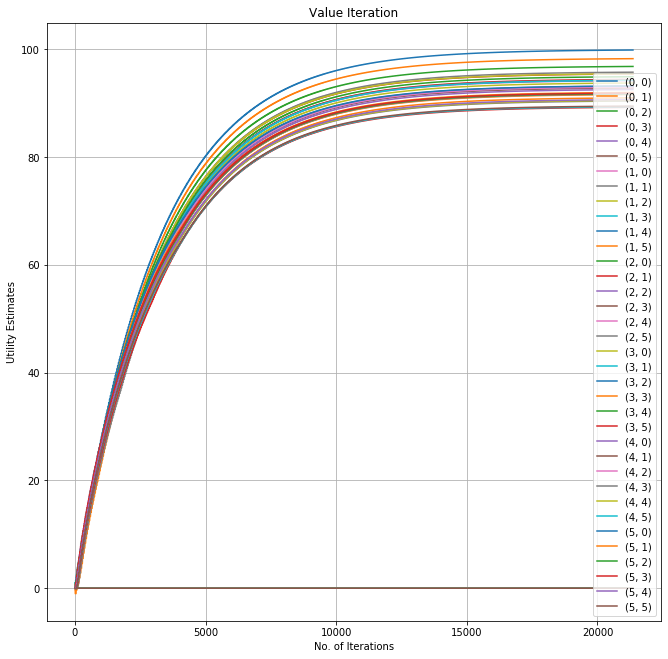

In [11]:
x = [i for i in range(num_iter)]

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)

ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)

ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)

ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)

ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)

ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)

plt.legend(list_of_tuples, loc ="lower right")

ax.set(xlabel='No. of Iterations', ylabel='Utility Estimates', title='Value Iteration')
ax.grid()

fig.savefig("p2-e4-valueIter.png")
plt.show()

### Policy Iteration

In [12]:
SMALL_ENOUGH = 10e-4
GAMMA = 0.99
ALL_POSSIBLE_ACTIONS = ('U', 'D', 'L', 'R')

In [13]:
if __name__ == '__main__':
    
    grid = negative_grid()
    policy = {}
    
    for s in grid.actions.keys():
        policy[s] = np.random.choice(ALL_POSSIBLE_ACTIONS)
        
    hist = []
    
    V = {}
    states = grid.all_states()
    
    for s in states: 
        V[s] = 0
        
        if s in grid.actions:
            V[s] = 0
        
        else:
            V[s] = 0
            
    iter_no = 0
    
    while True:
        iter_no = iter_no + 1
        print("Iteration " + str(iter_no) + " :: ")
        
        # policy evaluation 
        while True:
            biggest_change = 0
            for s in states:
                old_v = V[s]
                
                if s in policy:
                    a = policy[s]
                    grid.set_state(s)
                    
                    try:
                        r = grid.move(a)
                    
                    except KeyError:
                        continue
                    
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    V[s] = v
                    biggest_change = max(biggest_change, np.abs(old_v - V[s]))
                    
            if biggest_change < SMALL_ENOUGH:
                break
        
        print('Utilities:')
        print_values(True, V, grid)
        print('\n')
        
        #policy improvement
        is_policy_converged = True
        
        for s in states:
            
            if s in policy:
                old_a = policy[s]
                new_a = None
                best_value = float('-inf')
                
                for a in ALL_POSSIBLE_ACTIONS:
                    grid.set_state(s)
                    
                    try:
                        r = grid.move(a)
                        
                    except KeyError:
                        continue
                    
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]  
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    if v > best_value:
                        best_value = v
                        new_a = a
            
            policy[s] = new_a
            
            if new_a != old_a:
                is_policy_converged = False
        
        if is_policy_converged:
            break
            
    print('Optimal Utilities:')
    print_values(True, V, grid)
    print('\n')
    print('Optimal Policy:')
    print_policy(policy, grid)
    print('\n')

Iteration 1 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 53.08639  |   0.00000  |  80.52821  |  79.39514  |  73.90339  |  76.28952  | 
+----------+------------+------------+------------+------------+------------+
 52.49524  |  71.07300  |  78.57125  |  78.75526  |   0.00000  |  70.86240  | 
+----------+------------+------------+------------+------------+------------+
 57.61926  |  74.61807  |  76.28320  |  77.45128  |  76.41588  |  73.00586  | 
+----------+------------+------------+------------+------------+------------+
 68.97504  |  72.79296  |  69.76686  |  74.20059  |  70.23441  |  55.65692  | 
+----------+------------+------------+------------+------------+------------+
 57.16818  |   0.00000  |   0.00000  |   0.00000  |  39.82294  |  33.83586  | 
+----------+------------+------------+------------+------------+------------+
 51.54856  |   9.14114  |   9.30797  |  10.82554  |  13.84645  |  15.84395  | 
+----------+------------+------

### Plot of utility estimates as a function of the number of iterations

In [14]:
num_iter = int(len(hist)/36)
print('Number of Iterations: ' + str(num_iter + 1))

Number of Iterations: 10


In [15]:
hist_0_0 = []
hist_0_1 = []
hist_0_2 = []
hist_0_3 = [] 
hist_0_4 = [] 
hist_0_5 = [] 

hist_1_0 = []
hist_1_1 = [] 
hist_1_2 = []
hist_1_3 = [] 
hist_1_4 = [] 
hist_1_5 = [] 

hist_2_0 = []
hist_2_1 = []
hist_2_2 = []
hist_2_3 = []
hist_2_4 = []
hist_2_5 = []

hist_3_0 = []
hist_3_1 = []
hist_3_2 = []
hist_3_3 = []
hist_3_4 = []
hist_3_5 = []

hist_4_0 = []
hist_4_1 = []
hist_4_2 = []
hist_4_3 = []
hist_4_4 = []
hist_4_5 = []

hist_5_0 = []
hist_5_1 = []
hist_5_2 = []
hist_5_3 = []
hist_5_4 = []
hist_5_5 = []

for i in range(num_iter):
    hist_0_0.append(hist[0+i*36])
    hist_1_0.append(hist[1+i*36])
    hist_2_0.append(hist[2+i*36])
    hist_3_0.append(hist[3+i*36]) 
    hist_4_0.append(hist[4+i*36])
    hist_5_0.append(hist[5+i*36]) 

    hist_0_1.append(hist[6+i*36])
    hist_1_1.append(hist[7+i*36]) 
    hist_2_1.append(hist[8+i*36]) 
    hist_3_1.append(hist[9+i*36]) 
    hist_4_1.append(hist[10+i*36]) 
    hist_5_1.append(hist[11+i*36]) 
    
    hist_0_2.append(hist[12+i*36])
    hist_1_2.append(hist[13+i*36]) 
    hist_2_2.append(hist[14+i*36])
    hist_3_2.append(hist[15+i*36])
    hist_4_2.append(hist[16+i*36])
    hist_5_2.append(hist[17+i*36])
    
    hist_0_3.append(hist[18+i*36])
    hist_1_3.append(hist[19+i*36]) 
    hist_2_3.append(hist[20+i*36])
    hist_3_3.append(hist[21+i*36])
    hist_4_3.append(hist[22+i*36])
    hist_5_3.append(hist[23+i*36])
    
    hist_0_4.append(hist[24+i*36])
    hist_1_4.append(hist[25+i*36]) 
    hist_2_4.append(hist[26+i*36])
    hist_3_4.append(hist[27+i*36])
    hist_4_4.append(hist[28+i*36])
    hist_5_4.append(hist[29+i*36])
    
    hist_0_5.append(hist[30+i*36])
    hist_1_5.append(hist[31+i*36]) 
    hist_2_5.append(hist[32+i*36])
    hist_3_5.append(hist[33+i*36])
    hist_4_5.append(hist[34+i*36])
    hist_5_5.append(hist[35+i*36])

In [16]:
list_of_tuples = [str((i,j)) for i in range(7) for j in range (7)]

In [17]:
from matplotlib.pyplot import figure

plt.rcParams["figure.figsize"]=11,11

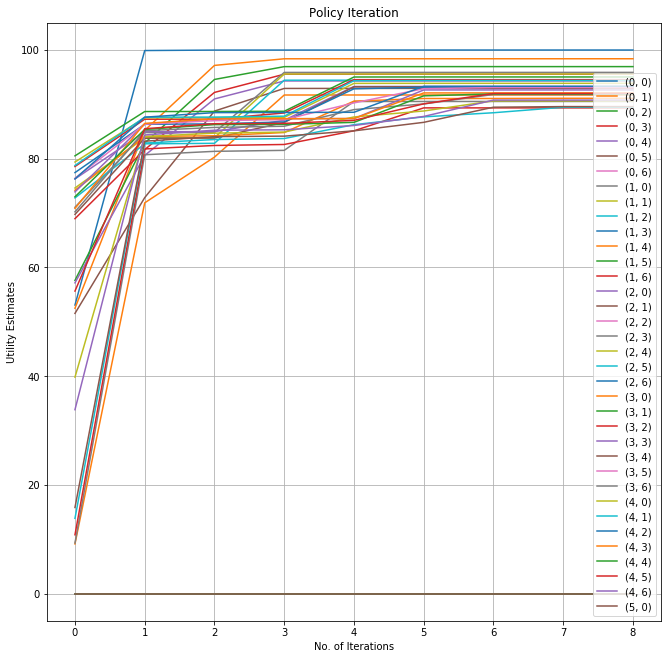

In [18]:
x = [i for i in range(num_iter)]

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)

ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)

ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)

ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)

ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)

ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)

plt.legend(list_of_tuples, loc ="lower right")

ax.set(xlabel='No. of Iterations', ylabel='Utility Estimates', title='Policy Iteration')
ax.grid()

fig.savefig("p2-e4-policyIter.png")
plt.show()